# Import Statements

In [1]:
import pandas as pd
from ast import literal_eval
import os
import joblib

random_state = 42

In [ ]:
# creation of sample datasets

import pandas as pd

def stratified_sample(df, label_col, n, random_state=None):
    frac = n / len(df)
    sampled_df = (
        df.groupby(label_col, group_keys=False)
        .apply(lambda x: x.sample(frac=frac, random_state=random_state)
               if len(x) > 1 else x)
    )

    if len(sampled_df) < n:
        remainder = n - len(sampled_df)
        unsampled_df = df.drop(sampled_df.index)
        additional = unsampled_df.sample(n=remainder, random_state=random_state)
        sampled_df = pd.concat([sampled_df, additional])

    return sampled_df

# Example for cicids17 dataset
df = pd.read_parquet("datasets/cicids17/cicids17-pre-processed.parquet")

df_sample = stratified_sample(df, label_col="Label", n=10000, random_state=42)
df_sample.to_parquet("datasets/cicids17/cicids17-sample.parquet")

del df, df_sample

# for cicids18 dataset
df = pd.read_parquet("datasets/cicids18/cicids18-pre-processed.parquet")

df_sample = stratified_sample(df, label_col="Label", n=10000, random_state=42)
df_sample.to_parquet("datasets/cicids18/cicids18-sample.parquet")


/tmp/ipykernel_9599/134363682.py:9: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(frac=frac, random_state=random_state)


In [ ]:
df = pd.read_parquet("datasets/cicids17/cicids17-sample.parquet")
print(df.columns)

df = pd.read_parquet("datasets/cicids18/cicids18-sample.parquet")
print(df.columns)

# Data

In [5]:
path = 'explanation_data/'
all_entries = os.listdir(path)
data_files = sorted([f for f in all_entries if f.lower().endswith('.csv') and os.path.isfile(os.path.join(path, f))])
for f in data_files:
    print(f)

cicids17_CatBoost_lime_explanations.csv
cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
cicids17_RandomForest_lime_explanations.csv
cicids17_RandomForest_shap_kernel_smoothed_explanations.csv
cicids17_XGBoost_lime_explanations.csv
cicids17_XGBoost_shap_kernel_smoothed_explanations.csv
cicids18_CatBoost_lime_explanations.csv
cicids18_CatBoost_shap_kernel_explanations.csv
cicids18_RandomForest_lime_explanations.csv
cicids18_RandomForest_shap_kernel_explanations.csv
cicids18_XGBoost_lime_explanations.csv
cicids18_XGBoost_shap_kernel_explanations.csv


## Pre-Check

In [6]:
for file in data_files:
    df = pd.read_csv(path + file, index_col=0)
    print("File: ", file, "\nShape: ", df.shape, "\nColumns: ", [col for col in df.columns], "\n")

File:  cicids17_CatBoost_lime_explanations.csv 
Shape:  (27130, 5) 
Columns:  ['explainer', 'sample_set', 'run_nr', 'idx', 'feature_value_pairs'] 

File:  cicids17_CatBoost_shap_kernel_smoothed_explanations.csv 
Shape:  (27130, 5) 
Columns:  ['explainer', 'sample_set', 'run_nr', 'idx', 'feature_value_pairs'] 

File:  cicids17_RandomForest_lime_explanations.csv 
Shape:  (30000, 5) 
Columns:  ['explainer', 'sample_set', 'run_nr', 'idx', 'feature_value_pairs'] 

File:  cicids17_RandomForest_shap_kernel_smoothed_explanations.csv 
Shape:  (30000, 5) 
Columns:  ['explainer', 'sample_set', 'run_nr', 'idx', 'feature_value_pairs'] 

File:  cicids17_XGBoost_lime_explanations.csv 
Shape:  (27980, 5) 
Columns:  ['explainer', 'sample_set', 'run_nr', 'idx', 'feature_value_pairs'] 

File:  cicids17_XGBoost_shap_kernel_smoothed_explanations.csv 
Shape:  (27980, 5) 
Columns:  ['explainer', 'sample_set', 'run_nr', 'idx', 'feature_value_pairs'] 

File:  cicids18_CatBoost_lime_explanations.csv 
Shape:  (3

In [7]:
# lime df
df1 = pd.read_csv(path + data_files[0], index_col=0)
# shap df
df2 = pd.read_csv(path + data_files[1], index_col=0)

In [9]:
df1.head()

,explainer,sample_set,run_nr,idx,feature_value_pairs
classifier,,,,,
CatBoost,lime,general_idx,1,363001,"[('Bwd Packet Length Std', 0.00016406214219530..."
CatBoost,lime,general_idx,1,110929,"[('Bwd Packet Length Std', 0.00012866426238334..."
CatBoost,lime,general_idx,1,150433,"[('Bwd Packet Length Std', 0.00012508262390906..."
CatBoost,lime,general_idx,1,484275,"[('Bwd Packet Length Std', 0.00010191082565202..."
CatBoost,lime,general_idx,1,87398,"[('Bwd Packet Length Std', 0.00011832197391451..."


In [9]:
df2.head()

,explainer,sample_set,run_nr,idx,feature_value_pairs
classifier,,,,,
CatBoost,shap,general_idx,1,609977,"[('Destination Port', 0.06501744153410707), ('..."
CatBoost,shap,general_idx,1,688279,"[('Fwd Header Length', 0.04156209858517877), (..."
CatBoost,shap,general_idx,1,328337,"[('Init_Win_bytes_forward', 0.1338174853704467..."
CatBoost,shap,general_idx,1,555217,"[('Bwd Packet Length Std', 0.03565845978787364..."
CatBoost,shap,general_idx,1,288149,"[('Bwd Packet Length Std', 0.04375005186226918..."


In [10]:
# check shapes of df and explanation data (features)
df = pd.read_parquet("datasets/cicids17/cicids17-pre-processed.parquet")
print("CICIDS17: Number of feature columns (with label): ",df.shape[1]) # with label column

for file in data_files:
    full_path = os.path.join(path, file)
    if "cicids17" in file:
        exp_df = pd.read_csv(path + file, index_col=0)
        pairs = literal_eval(exp_df['feature_value_pairs'].iloc[0])
        print(f"Number of feature_value pairs in explanation file {file}: {len(pairs)}")

df = pd.read_parquet("datasets/cicids18/cicids18-pre-processed.parquet")
print("\nCICIDS18: Number of feature columns (with label): ",df.shape[1]) # with label column

for file in data_files:
    full_path = os.path.join(path, file)
    if "cicids18" in file:
        exp_df = pd.read_csv(path + file, index_col=0)
        pairs = literal_eval(exp_df['feature_value_pairs'].iloc[0])
        print(f"Number of feature_value pairs in explanation file {file}: {len(pairs)}")

print("Done")

CICIDS17: Number of feature columns (with label):  66
Number of feature_value pairs in explanation file cicids17_CatBoost_lime_explanations.csv: 65
Number of feature_value pairs in explanation file cicids17_CatBoost_shap_kernel_smoothed_explanations.csv: 65
Number of feature_value pairs in explanation file cicids17_RandomForest_lime_explanations.csv: 65
Number of feature_value pairs in explanation file cicids17_RandomForest_shap_kernel_smoothed_explanations.csv: 65
Number of feature_value pairs in explanation file cicids17_XGBoost_lime_explanations.csv: 65
Number of feature_value pairs in explanation file cicids17_XGBoost_shap_kernel_smoothed_explanations.csv: 65

CICIDS18: Number of feature columns (with label):  64
Number of feature_value pairs in explanation file cicids18_CatBoost_lime_explanations.csv: 63
Number of feature_value pairs in explanation file cicids18_CatBoost_shap_kernel_smoothed_explanations.csv: 63
Number of feature_value pairs in explanation file cicids18_RandomFore

## Explanation Standardization

In [ ]:
import re
import pandas as pd
from ast import literal_eval

def extract_feature_name(feature_str):
    cleaned = re.sub(r'[\d\.]+', '', feature_str)          # numbers (integers and decimals)
    cleaned = re.sub(r'[<>]=?|<=|>=', '', cleaned)         # comparison operators
    cleaned = re.sub(r'[-]', '', cleaned)                  # hyphens
    cleaned = re.sub(r'\s+', ' ', cleaned)                 # replace multiple spaces with single space
    return cleaned.strip()

def process_feature_value_pairs(row):
    features = literal_eval(row)
    return [(extract_feature_name(f), v) for f, v in features]

for file in data_files:
    if "lime" in file.lower():
        print("Processing " + file)
        df = pd.read_csv(path + file, index_col=0)
        df['feature_value_pairs'] = df['feature_value_pairs'].apply(process_feature_value_pairs)
        print("Processing " + file)
        df.to_csv(path + file)
    if "shap" in file.lower():
        try:
            print("Processing " + file)
            df = pd.read_csv(path + file, index_col=0)
            df = df.rename(columns={'sample_pset': 'sample_set', 
                                    'prediction': 'sample_set'})
            df.to_csv(path + file)
        except:
            pass

print("Done")

## Post-Check

In [ ]:
for file in data_files:
    df = pd.read_csv(path + file, index_col=0)
    print("File: ", file, "\nShape: ", df.shape, "\nColumns: ", df.columns, "\n")

# lime df
df1 = pd.read_csv(path + data_files[0], index_col=0)
# shap df
df2 = pd.read_csv(path + data_files[1], index_col=0)

In [ ]:
df1.head()

In [ ]:
df2.head()

In [ ]:
for file in data_files:
    df = pd.read_csv(path + file, index_col=0)
    unique_idx = df[df['sample_set'] == 'false_idx']['idx'].unique()
    print(f"File {file} has {len(unique_idx)} unique idx")
    print(unique_idx[:10])

In [ ]:
import os
import joblib

directory_path = "models"
all_models = os.listdir(directory_path)

models = []
for model_file in all_models:
    full_path = os.path.join(directory_path, model_file)
    grid_search = joblib.load(full_path)
    print(model_file)
    print(grid_search.best_estimator_)

# Data Distribution

In [23]:
import pandas as pd
import ast

df = pd.read_csv("explanation_data/cicids17_CatBoost_lime_explanations.csv")

value_pairs = df.loc[0, "feature_value_pairs"]

if isinstance(value_pairs, str):
    value_pairs = ast.literal_eval(value_pairs)

for feature, value in value_pairs[:5]:
    print(feature, value)


Bwd Packet Length Std 0.0001640621421953074
Init_Win_bytes_backward 6.168082297911675e-05
Fwd Header Length -5.290154615312145e-05
Packet Length Mean -4.874633294734117e-05
Flow Bytes/s 4.807949361256201e-05


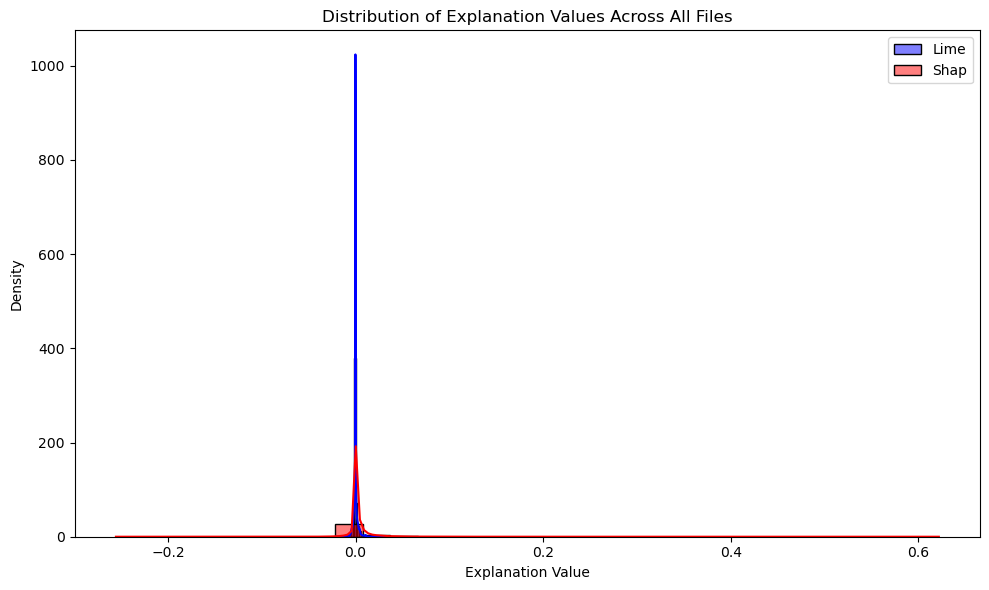

In [2]:
import os
import pandas as pd
import ast
import matplotlib.pyplot as plt
import seaborn as sns

directory = "explanation_data/"  # set your directory path
all_files = sorted([f for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))])

lime_values = []
shap_values = []

for f in all_files:
    df = pd.read_csv(os.path.join(directory, f))

    lower_name = f.lower()
    if 'lime' in lower_name:
        target_list = lime_values
    elif 'shap' in lower_name:
        target_list = shap_values
    
    # Collect explanation values from all rows
    for idx, row in df.iterrows():
        value_pairs = row["feature_value_pairs"]
        if isinstance(value_pairs, str):
            value_pairs = ast.literal_eval(value_pairs)
        target_list.extend([value for _, value in value_pairs])

plt.figure(figsize=(10, 6))
sns.histplot(lime_values, bins=30, kde=True, color='blue', label='Lime', stat="density", alpha=0.5)
sns.histplot(shap_values, bins=30, kde=True, color='red', label='Shap', stat="density", alpha=0.5)
plt.xlabel("Explanation Value")
plt.ylabel("Density")
plt.title("Distribution of Explanation Values Across All Files")
plt.legend()
plt.tight_layout()
plt.show()


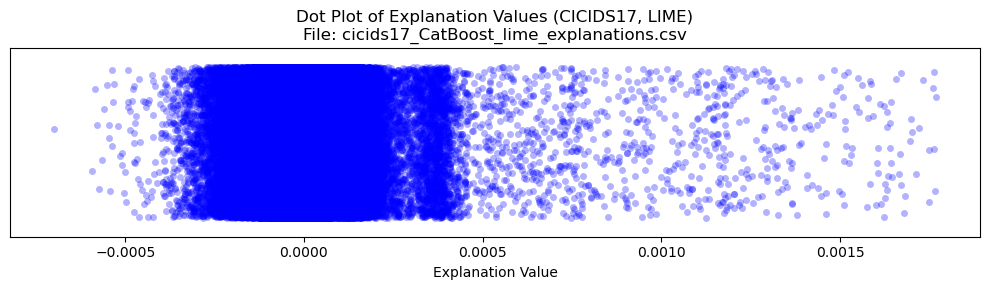

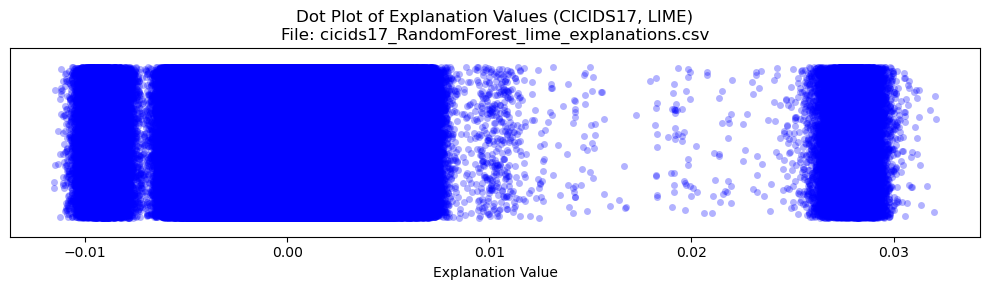

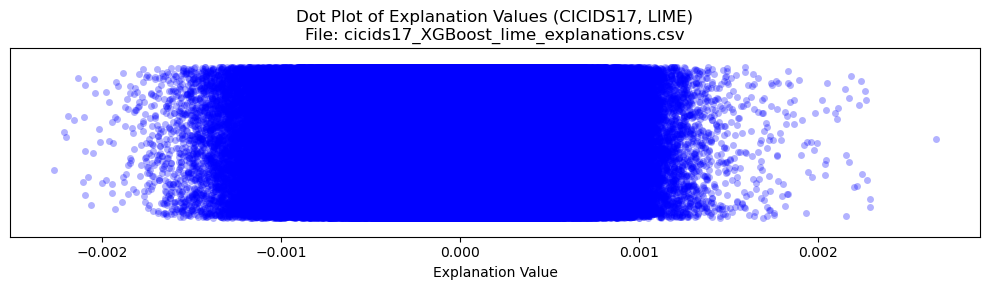

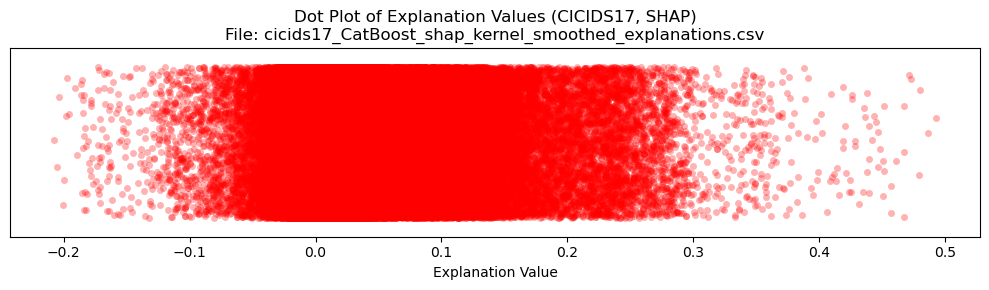

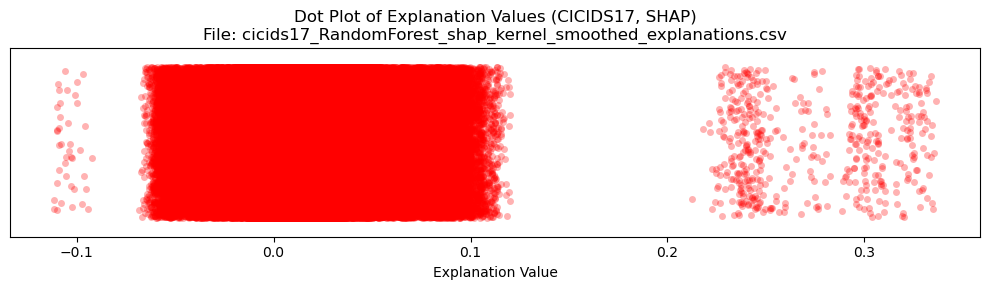

...

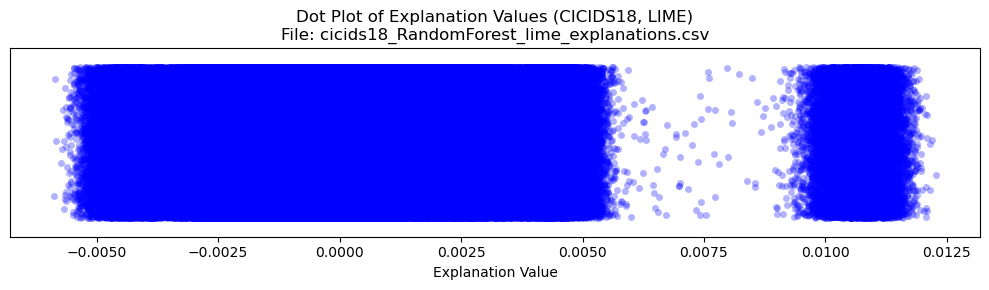

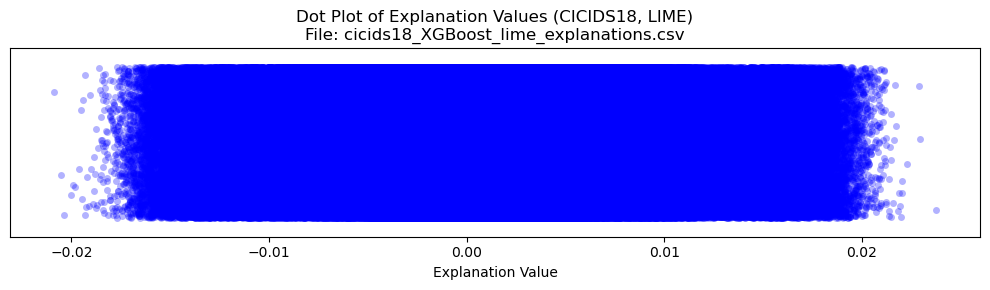

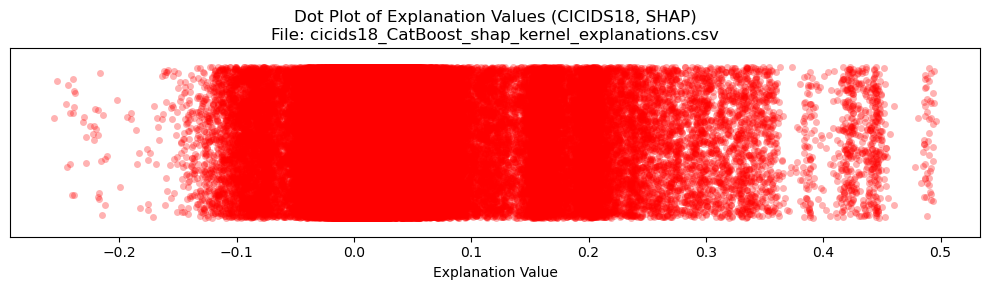

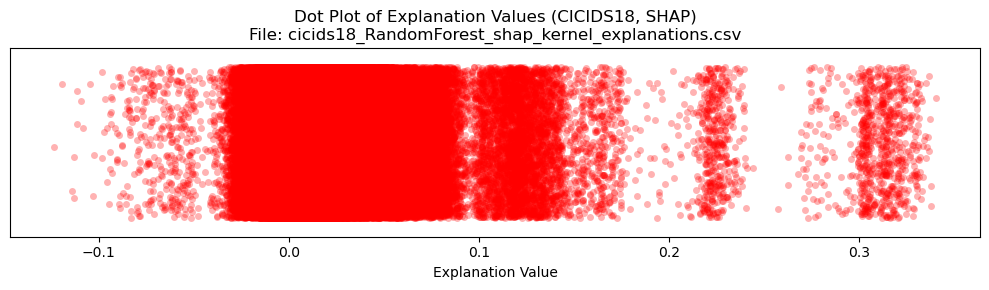

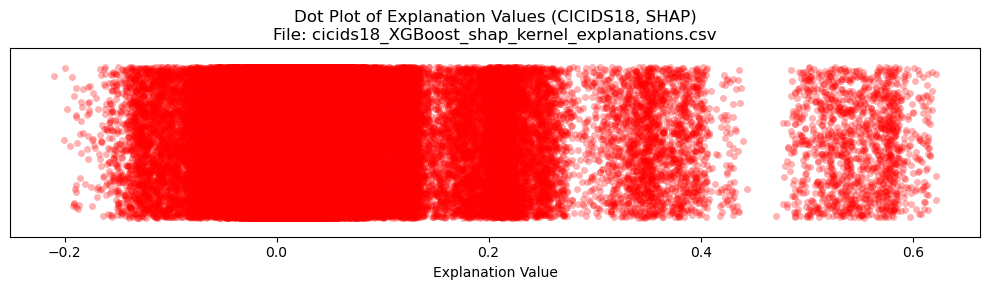

In [2]:
import pandas as pd
import ast
import matplotlib.pyplot as plt
import seaborn as sns
import os

path = 'explanation_data/'

def get_files_by_dataset_and_explainer(path, dataset, explainer):
    all_entries = os.listdir(path)
    return sorted([
        f for f in all_entries
        if f.lower().endswith('.csv')
        and os.path.isfile(os.path.join(path, f))
        and dataset in f and explainer in f
    ])
def get_cicids17_lime_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids17', 'lime')
def get_cicids17_shap_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids17', 'shap')
def get_cicids18_lime_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids18', 'lime')
def get_cicids18_shap_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids18', 'shap')

# Collect all file lists
file_groups = [
    ("cicids17", "lime", get_cicids17_lime_files()),
    ("cicids17", "shap", get_cicids17_shap_files()),
    ("cicids18", "lime", get_cicids18_lime_files()),
    ("cicids18", "shap", get_cicids18_shap_files())
]

for dataset, explainer, files in file_groups:
    for f in files:
        df = pd.read_csv(os.path.join(path, f))
        all_values = []
        for idx, row in df.iterrows():
            value_pairs = row["feature_value_pairs"]
            if isinstance(value_pairs, str):
                value_pairs = ast.literal_eval(value_pairs)
            all_values.extend([value for _, value in value_pairs])
        
        color = "blue" if explainer == "lime" else "red"
        
        fig, ax = plt.subplots(figsize=(10, 3))
        sns.stripplot(x=all_values, color=color, alpha=0.3, jitter=0.4, ax=ax)
        ax.set_xlabel("Explanation Value")
        ax.set_yticks([])
        ax.set_title(f"Dot Plot of Explanation Values ({dataset.upper()}, {explainer.upper()})\nFile: {f}")
        plt.tight_layout()
        
        filename = f"metrics/plots_n_tables/explanation_data_{f[:-4]}.png"
        fig.savefig(filename, bbox_inches='tight')
        plt.show()
        plt.close(fig)


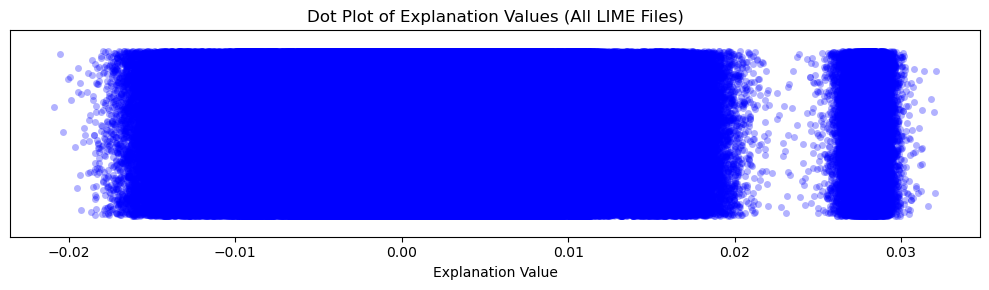

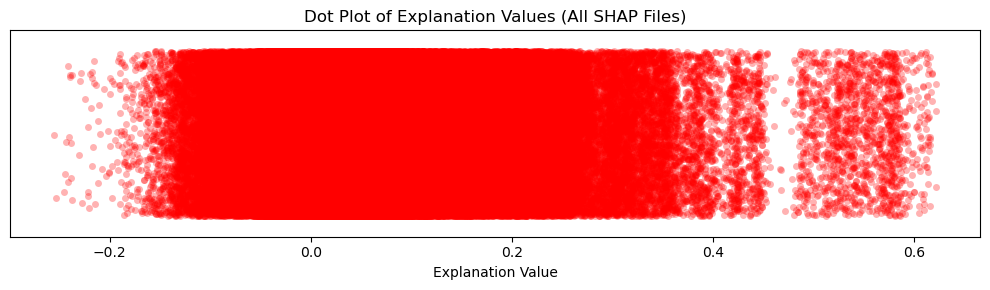

In [3]:
import pandas as pd
import ast
import matplotlib.pyplot as plt
import seaborn as sns
import os

path = 'explanation_data/'
def get_files_by_dataset_and_explainer(path, dataset, explainer):
    all_entries = os.listdir(path)
    return sorted([
        f for f in all_entries
        if f.lower().endswith('.csv')
        and os.path.isfile(os.path.join(path, f))
        and dataset in f and explainer in f
    ])
def get_cicids17_lime_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids17', 'lime')
def get_cicids17_shap_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids17', 'shap')
def get_cicids18_lime_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids18', 'lime')
def get_cicids18_shap_files(path='explanation_data/'):
    return get_files_by_dataset_and_explainer(path, 'cicids18', 'shap')

# Aggregate all LIME values
lime_values = []
for f in get_cicids17_lime_files() + get_cicids18_lime_files():
    df = pd.read_csv(os.path.join(path, f))
    for idx, row in df.iterrows():
        value_pairs = row["feature_value_pairs"]
        if isinstance(value_pairs, str):
            value_pairs = ast.literal_eval(value_pairs)
        lime_values.extend([value for _, value in value_pairs])

# Aggregate all SHAP values
shap_values = []
for f in get_cicids17_shap_files() + get_cicids18_shap_files():
    df = pd.read_csv(os.path.join(path, f))
    for idx, row in df.iterrows():
        value_pairs = row["feature_value_pairs"]
        if isinstance(value_pairs, str):
            value_pairs = ast.literal_eval(value_pairs)
        shap_values.extend([value for _, value in value_pairs])

plt.figure(figsize=(10, 3))
sns.stripplot(x=lime_values, color='blue', alpha=0.3, jitter=0.4)
plt.xlabel("Explanation Value")
plt.yticks([])
plt.title("Dot Plot of Explanation Values (All LIME Files)")
plt.tight_layout()
plt.savefig("metrics/plots_n_tables/explanation_data_dotplot_lime_all.png")
plt.show()
plt.close()

plt.figure(figsize=(10, 3))
sns.stripplot(x=shap_values, color='red', alpha=0.3, jitter=0.4)
plt.xlabel("Explanation Value")
plt.yticks([])
plt.title("Dot Plot of Explanation Values (All SHAP Files)")
plt.tight_layout()
plt.savefig("metrics/plots_n_tables/explanation_data_dotplot_shap_all.png")
plt.show()
plt.close()


# (1) Descriptive Accuracy

## Full Run - All Datasets, All Models

In [ ]:
import os
import time
from datetime import datetime
import pandas as pd
from ast import literal_eval
import gc
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    balanced_accuracy_score
)
from collections import defaultdict
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

random_state = 42
samplesets = ["general_idx", "true_idx", "false_idx"]
runs = range(1,11)

directory = 'explanation_data/'
all_files = os.listdir(directory)

explanations = sorted([f for f in all_files if os.path.isfile(os.path.join(directory, f))])

datasets = [
    'datasets/cicids17/cicids17-pre-processed.parquet',
    'datasets/cicids18/cicids18-pre-processed.parquet'
]

print("Available Explanation Data Files:")
for f in explanations:
    print(f)
print("")

for run in runs:
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Starting Run {run}:")
    for dataset in datasets: 
        dataset_name = "cicids17" if "cicids17" in dataset else "cicids18"
        
        print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Loading dataset: {dataset}")
        df = pd.read_parquet(dataset)
    
        le = LabelEncoder()
        df['Label'] = le.fit_transform(df['Label'])
    
        y = df.pop("Label")
        X = df
    
        # Train/test split
        X_trainval, X_test, y_trainval, y_test = train_test_split(
            X, y, test_size=0.3, random_state=random_state, stratify=y
        )
        X_train, X_val, y_train, y_val = train_test_split(
            X_trainval, y_trainval, test_size=0.2857,
            random_state=random_state, stratify=y_trainval
        )
    
        del X, y, X_trainval, y_trainval
        gc.collect()
    
        for exp_file in explanations:
            
            if dataset_name in exp_file:
                all_classification_rows = []
        
                # Set explainer
                if "lime" in exp_file.lower():
                    explainer = "lime"
                elif "shap" in exp_file.lower():
                    explainer = "shap"
        
                # model type
                if "randomforest" in exp_file.lower():
                    model_name = "RandomForest"
                elif "xgboost" in exp_file.lower():
                    model_name = "XGBoost"
                elif "catboost" in exp_file.lower():
                    model_name = "Catboost"
        
                print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Analyzing: {exp_file}")
                exp_df = pd.read_csv(os.path.join(directory, exp_file), index_col=0)
                last_feature = len(literal_eval(exp_df['feature_value_pairs'].iloc[0])) - 1
                
                for sampleset in samplesets:
                    #print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Processing sampleset: {sampleset} | run: {run}")
    
                    run_rows = exp_df[
                        (exp_df['run_nr'] == run) &
                        (exp_df['sample_set'] == sampleset)
                    ]
                    n_samples = len(run_rows)
                    abs_sums_run = defaultdict(float)
    
                    for idx in range(n_samples):
                        pairs = literal_eval(run_rows['feature_value_pairs'].iloc[idx])
                        for key, value in pairs:
                            abs_sums_run[key] += abs(value)
    
                    sorted_features = sorted(abs_sums_run, key=lambda f: abs_sums_run[f], reverse=True)
    
                    for k in [0, 5, 10, 25, 50, last_feature]:
                        features_to_remove = sorted_features[:k]
                        X_train_reduced = X_train.copy()
                        X_test_reduced = X_test.copy()
                        X_train_reduced.drop(columns=features_to_remove, inplace=True, errors='ignore')
                        X_test_reduced.drop(columns=features_to_remove, inplace=True, errors='ignore')
    
                        if model_name == "RandomForest":
                            if dataset_name == "cicids17":
                                min_samples_split = 10
                            else:
                                min_samples_split = 2
                            clf = RandomForestClassifier(
                                n_estimators=50,
                                min_samples_split=min_samples_split,
                                max_depth=7,
                                class_weight='balanced',
                                random_state=run,
                                n_jobs=-1,
                                verbose=0
                            )
                        elif model_name == "XGBoost":
                            num_class = len(y_train.unique())
                            clf = XGBClassifier(
                                device='cpu',
                                objective='multi:softprob',
                                num_class=num_class,
                                booster='gbtree',
                                random_state=run,
                                max_depth=7,
                                learning_rate=0.1,
                                n_estimators=500,
                                n_jobs=-1
                            )
                        elif model_name == "Catboost":
                            if dataset_name == "cicids17":
                                depth = 5
                            else:
                                depth = 7
                            clf = CatBoostClassifier(
                                loss_function='MultiClass',
                                bootstrap_type='Bayesian',
                                random_seed=run,
                                verbose=False,
                                depth=depth,
                                iterations=500,
                                learning_rate=0.1
                            )
    
                        start = time.perf_counter()
                        clf.fit(X_train_reduced, y_train)
                        elapsed = time.perf_counter() - start
    
                        y_pred = clf.predict(X_test_reduced)
    
                        acc = accuracy_score(y_test, y_pred)
                        prec = precision_score(y_test, y_pred, average='weighted', zero_division=0)
                        rec = recall_score(y_test, y_pred, average='weighted', zero_division=0)
                        f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)
                        bal_acc = balanced_accuracy_score(y_test, y_pred)
    
                        all_classification_rows.append({
                            "dataset": dataset_name,
                            "model": model_name,
                            "explainer": explainer,
                            "sample_set": sampleset,
                            "run": run,
                            "top_k_removed": k,
                            "accuracy": acc,
                            "precision": prec,
                            "recall": rec,
                            "f1_score": f1,
                            "balanced_accuracy": bal_acc,
                            "training_time_sec": elapsed,
                            "features_used": len(X_train_reduced.columns)
                        })
    
                        print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] "
                              f"Model: {model_name} | {sampleset} | run={run}/{len(runs)} | top_k={k} | "
                              f"Acc: {acc:.5f} | Prec: {prec:.5f} | Rec: {rec:.5f} | "
                              f"F1: {f1:.5f} | BalAcc: {bal_acc:.5f} | Time: {elapsed:.2f}s")
    
                results_df = pd.DataFrame(all_classification_rows)
                output_dir = "metrics/descriptive_accuracy/"
                os.makedirs(output_dir, exist_ok=True)
                output_path_csv = os.path.join(output_dir, "descriptive_accuracy_results.csv")
                output_path_parquet = os.path.join(output_dir, "descriptive_accuracy_results.parquet")
        
                if os.path.exists(output_path_csv):
                    results_df.to_csv(output_path_csv, mode="a", header=False, index=False)
                else:
                    results_df.to_csv(output_path_csv, index=False)
        
                if os.path.exists(output_path_parquet):
                    existing_df = pd.read_parquet(output_path_parquet)
                    final_df = pd.concat([existing_df, results_df], ignore_index=True)
                    final_df.to_parquet(output_path_parquet, index=False)
                else:
                    results_df.to_parquet(output_path_parquet, index=False)
        
                print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Results appended for {exp_file} to {output_path_csv} and parquet file.")
            else:
                #print("Skipping")
                continue

print(f"\nDone. All classification results saved to {output_path_parquet}")


In [15]:
import pandas as pd

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

subset = df[
    #(df["dataset"] == "cicids18") &
    (df["sample_set"] == "general_idx")# &
    #(df["model"] == "RandomForest") &
    #(df["explainer"].str.lower() == "lime") &
    #(df["top_k_removed"] == 0)
]
subset.to_csv("metrics/descriptive_accuracy/descriptive_accuracy_general_idx_results.csv", index=False)
subset.head(20)

,dataset,model,explainer,sample_set,run,top_k_removed,accuracy,precision,recall,f1_score,balanced_accuracy,training_time_sec,features_used
0,cicids17,Catboost,lime,general_idx,1,0,0.999093,0.999085,0.999093,0.999074,0.894462,127.059209,65
1,cicids17,Catboost,lime,general_idx,1,5,0.998525,0.998495,0.998525,0.998488,0.841212,121.234284,60
2,cicids17,Catboost,lime,general_idx,1,10,0.998443,0.998409,0.998443,0.998402,0.838761,120.661018,55
3,cicids17,Catboost,lime,general_idx,1,25,0.997809,0.997779,0.997809,0.997479,0.744135,121.869266,40
4,cicids17,Catboost,lime,general_idx,1,50,0.997004,0.997015,0.997004,0.996542,0.678867,94.231627,15
5,cicids17,Catboost,lime,general_idx,1,64,0.882873,0.877388,0.882873,0.878641,0.339222,101.319565,1
18,cicids17,Catboost,shap,general_idx,1,0,0.999093,0.999085,0.999093,0.999074,0.894462,140.277551,65
19,cicids17,Catboost,shap,general_idx,1,5,0.988691,0.989024,0.988691,0.988619,0.777940,128.120358,60
20,cicids17,Catboost,shap,general_idx,1,10,0.986556,0.987155,0.986556,0.986556,0.806676,128.572824,55
21,cicids17,Catboost,shap,general_idx,1,25,0.985718,0.986250,0.985718,0.985407,0.705659,122.277263,40


In [12]:
import pandas as pd

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")
df.to_csv("metrics/descriptive_accuracy/descriptive_accuracy_results.csv", index=False)
print(df.head(40))

     dataset         model explainer   sample_set  run  top_k_removed  accuracy  precision    recall  f1_score  balanced_accuracy  training_time_sec  features_used
0   cicids17      Catboost      lime  general_idx    1              0  0.999093   0.999085  0.999093  0.999074           0.894462         127.059209             65
1   cicids17      Catboost      lime  general_idx    1              5  0.998525   0.998495  0.998525  0.998488           0.841212         121.234284             60
2   cicids17      Catboost      lime  general_idx    1             10  0.998443   0.998409  0.998443  0.998402           0.838761         120.661018             55
3   cicids17      Catboost      lime  general_idx    1             25  0.997809   0.997779  0.997809  0.997479           0.744135         121.869266             40
4   cicids17      Catboost      lime  general_idx    1             50  0.997004   0.997015  0.997004  0.996542           0.678867          94.231627             15
5   cicids17    

In [21]:
filtered_runs = df[
    (df['dataset'] == 'cicids18') &
    (df['model'] == 'XGBoost') &
    (df['explainer'] == 'shap')
]["run"].unique()

print(filtered_runs)


[2 3 4]


## Statistical Analysis Lime vs Shap

### Normality Test (SW)

In [8]:
import pandas as pd
from scipy.stats import shapiro

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

#print(df.head(20))

grouped = df.groupby(['dataset', 'model', 'explainer', 'sample_set', 'top_k_removed'])

results = []
normal_count = 0
not_normal_count = 0

for name, group in grouped:
    bal_acc = group['balanced_accuracy']
    
    # Run test only if sample size >= 3 and data varies
    if len(bal_acc) >= 3 and bal_acc.max() > bal_acc.min():
        stat, p_value = shapiro(bal_acc)
        if p_value > 0.05:
            interpretation = 'True'
            normal_count += 1
        else:
            interpretation = 'False'
            not_normal_count += 1
    else:
        stat, p_value = None, None
        interpretation = 'not enough variation for test'

    results.append({
        'dataset': name[0],
        'model': name[1],
        'explainer': name[2],
        'sample_set': name[3],
        'top_k': name[4],
        'W_stat': stat,
        'p_value': p_value,
        'n_samples': len(bal_acc),
        'normal_dist': interpretation
    })


results_df = pd.DataFrame(results)
print(results_df)
print(f"Number of groups normally distributed: {normal_count}")
print(f"Number of groups NOT normally distributed: {not_normal_count}")
results_df.to_csv('metrics/plots_n_tables/desc_acc_normality_test_results.csv', index=False)


      dataset         model explainer   sample_set  top_k    W_stat       p_value  n_samples                    normal_dist
0    cicids17      Catboost      lime    false_idx      0  0.712215  1.238945e-03         10                          False
1    cicids17      Catboost      lime    false_idx      5  0.883884  1.445573e-01         10                           True
2    cicids17      Catboost      lime    false_idx     10  0.939342  5.457135e-01         10                           True
3    cicids17      Catboost      lime    false_idx     25  0.919898  3.561040e-01         10                           True
4    cicids17      Catboost      lime    false_idx     50  0.880058  1.306946e-01         10                           True
5    cicids17      Catboost      lime    false_idx     64  0.402172  2.642614e-07         10                          False
6    cicids17      Catboost      lime  general_idx      0  0.712215  1.238945e-03         10                          False
7    cic

### Significance Test Lime vs Shap (each sampleset)

King, p. 124

paired data, small sample sizes, normal and not normal distributed data

In [1]:
import pandas as pd
from scipy.stats import shapiro, wilcoxon, ttest_rel

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

results = []

def is_normal(data):
    if len(data) < 3:
        # Shapiro requires at least 3 samples
        return False
    if data.max() == data.min():
        # check variance od data
        return True
    stat, p_value = shapiro(data)
    return p_value > 0.05

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for sample_set in df['sample_set'].unique():
            for k in df[df['dataset'] == dataset]['top_k_removed'].unique():

                if k == 0:
                    continue
                else:

                    lime_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sample_set"] == sample_set) &
                        (df["explainer"].str.lower() == "lime") &
                        (df["top_k_removed"] == k)
                    ]
        
                    shap_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sample_set"] == sample_set) &
                        (df["explainer"].str.lower() == "shap") &
                        (df["top_k_removed"] == k)
                    ]
    
                    if lime_subset.empty or shap_subset.empty:
                        continue
        
                    lime_vals = lime_subset["balanced_accuracy"].values
                    shap_vals = shap_subset["balanced_accuracy"].values

                    # probably obsolete if all data is available
                    min_len = min(len(lime_vals), len(shap_vals))

                    lime_vals = lime_vals[:min_len]
                    shap_vals = shap_vals[:min_len]
            
                    lime_mean = round(lime_vals.mean(), 5)
                    lime_std  = round(lime_vals.std(ddof=1), 5)
                    lime_var  = round(lime_vals.var(ddof=1), 5)
                    
                    shap_mean = round(shap_vals.mean(), 5)
                    shap_std  = round(shap_vals.std(ddof=1), 5)
                    shap_var  = round(shap_vals.var(ddof=1), 5)

                    # normality check
                    normality_lime = is_normal(lime_vals)
                    normality_shap = is_normal(shap_vals)
                    
                    if normality_lime and normality_shap:
                        stat, p = ttest_rel(lime_vals, shap_vals)
                        norm = True
                    else:
                        stat, p = wilcoxon(lime_vals, shap_vals)
                        norm = False
            
                    interpretation = "No significant difference" if p > 0.05 else "Significant difference"
            
                    results.append({
                        "dataset": dataset,
                        "model": model,
                        "sampleset": sample_set,
                        "k": k,
                        "n_samples": min_len,
                        "lime_mean": lime_mean,
                        "lime_std": lime_std,
                        "lime_var": lime_var,
                        "shap_mean": shap_mean,
                        "shap_std": shap_std,
                        "shap_var": shap_var,
                        "normality": norm,
                        "ttest/W": round(stat, 5),
                        "p_value": round(p, 5),
                        "interpretation": interpretation
                    })


results_df = pd.DataFrame(results)
print(results_df[(results_df["sampleset"] == "general_idx")])
results_df.to_csv('metrics/descriptive_accuracy/desc_acc_significance_test_results.csv', index=False)

     dataset         model    sampleset   k  n_samples  lime_mean  lime_std  lime_var  shap_mean  shap_std  shap_var  normality   ttest/W  p_value             interpretation
0   cicids17      Catboost  general_idx   5         10    0.85829   0.01972   0.00039    0.80053   0.02348   0.00055      False   1.00000  0.00391     Significant difference
1   cicids17      Catboost  general_idx  10         10    0.86041   0.01549   0.00024    0.79526   0.01285   0.00017       True  10.74592  0.00000     Significant difference
2   cicids17      Catboost  general_idx  25         10    0.74861   0.01796   0.00032    0.71368   0.01826   0.00033       True   4.64985  0.00120     Significant difference
3   cicids17      Catboost  general_idx  50         10    0.68221   0.01064   0.00011    0.59737   0.08235   0.00678      False   0.00000  0.00195     Significant difference
4   cicids17      Catboost  general_idx  64         10    0.33923   0.00000   0.00000    0.11111   0.00000   0.00000      False   

In [5]:
import pandas as pd

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_csv("metrics/descriptive_accuracy/desc_acc_significance_test_results.csv")
df = df[(df["sampleset"] == "general_idx")]

total_counts = df.groupby(['dataset', 'model']).size().reset_index(name='total_count')
significant_counts = df[df['interpretation'].str.contains('Significant difference')].groupby(['dataset', 'model']).size().reset_index(name='significant_count')

# Merge counts
data_counts = pd.merge(total_counts, significant_counts, on=['dataset', 'model'], how='left')
data_counts['significant_count'] = data_counts['significant_count'].fillna(0)

data_counts['insignificant_count'] = data_counts['total_count'] - data_counts['significant_count']
data_counts['significant_ratio'] = data_counts['significant_count'] / data_counts['total_count']

print(data_counts[['dataset', 'model', 'significant_count', 'insignificant_count', 'significant_ratio']])



    dataset         model  significant_count  insignificant_count  significant_ratio
0  cicids17      Catboost                  5                    0                1.0
1  cicids17  RandomForest                  1                    4                0.2
2  cicids17       XGBoost                  4                    1                0.8
3  cicids18      Catboost                  4                    1                0.8
4  cicids18  RandomForest                  5                    0                1.0
5  cicids18       XGBoost                  4                    1                0.8


### Visualization

#### Lime vs Shap All Samplesets Means

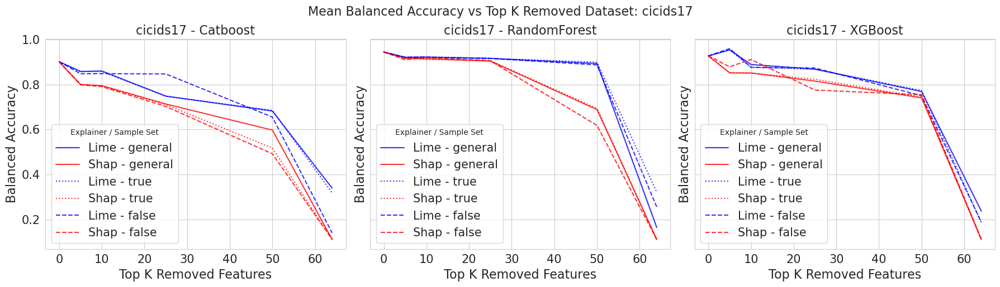

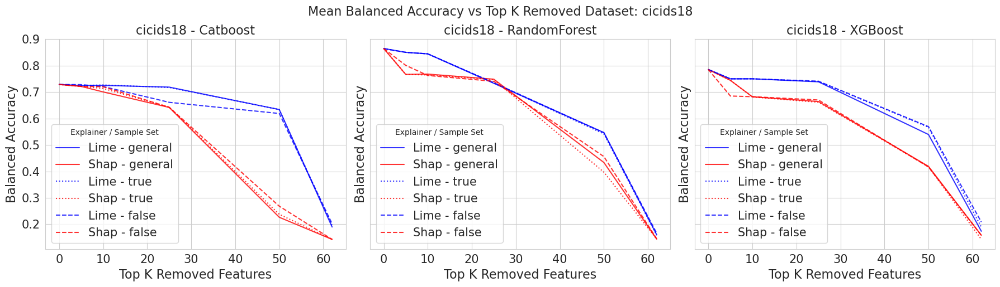

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your DataFrame
df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

sample_sets = ['general_idx', 'true_idx', 'false_idx']
color_palette = {'lime': 'blue', 'shap': 'red'}
line_styles_map = {
    'general_idx': '-',
    'true_idx': ':',
    'false_idx': '--'
}

sns.set_style("whitegrid")

for dataset in df["dataset"].unique():
    df_dataset = df[df['dataset'] == dataset]
    models = df_dataset['model'].unique()
    
    n_models = len(models)
    n_cols = 3
    n_rows = (n_models + n_cols - 1) // n_cols  # Ceiling division
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 5 * n_rows), sharey=True)
    axes = axes.flatten()
    
    for i, model in enumerate(models):
        ax = axes[i]
        df_model = df_dataset[df_dataset['model'] == model]
        
        for sample_set in sample_sets:
            df_ss = df_model[df_model['sample_set'] == sample_set]
            
            # Aggregate mean balanced_accuracy by explainer and top_k_removed
            df_mean = df_ss.groupby(['explainer', 'top_k_removed'])['balanced_accuracy'].mean().reset_index()
            
            for explainer in ['lime', 'shap']:
                df_exp = df_mean[df_mean['explainer'] == explainer]
                if df_exp.empty:
                    continue
                
                df_exp = df_exp.sort_values('top_k_removed')
                
                ax.plot(
                    df_exp['top_k_removed'],
                    df_exp['balanced_accuracy'],
                    label=f"{explainer.capitalize()} - {sample_set.replace('_idx','')}",
                    color=color_palette[explainer],
                    linestyle=line_styles_map[sample_set],
                    alpha=0.8
                )
                
        ax.set_title(f"{dataset} - {model}", fontsize=16)
        ax.set_xlabel('Top K Removed Features', fontsize=16)
        ax.set_ylabel('Balanced Accuracy', fontsize=16)
        ax.legend(fontsize=15, title='Explainer / Sample Set', loc='best')
        ax.tick_params(axis='both', labelsize=15)
    
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle(f"Mean Balanced Accuracy vs Top K Removed Dataset: {dataset}", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)

    filename = f"metrics/final plots/desc_acc_{dataset}_all_samplesets_means.png"
    plt.savefig(filename, bbox_inches='tight')     
    plt.show()     
    plt.close(fig)

#### Lime vs Shap all Samplesets for one run

    dataset         model explainer   sample_set   top_k_0   top_k_5  top_k_10  top_k_25  top_k_50  top_k_64
0  cicids17      Catboost      lime  general_idx  0.895579  0.860769  0.880812  0.731798  0.681473  0.339231
1  cicids17      Catboost      shap  general_idx  0.895579  0.787267  0.808614  0.669580  0.623952  0.111111
2  cicids17  RandomForest      lime  general_idx  0.937561  0.919049  0.904331  0.900897  0.867392  0.111143
3  cicids17  RandomForest      shap  general_idx  0.937561  0.921701  0.919610  0.899036  0.597554  0.111143
4  cicids17       XGBoost      lime  general_idx  0.927505  0.957769  0.920564  0.873431  0.721164  0.111111
5  cicids17       XGBoost      shap  general_idx  0.927505  0.852415  0.851294  0.817251  0.726067  0.111111


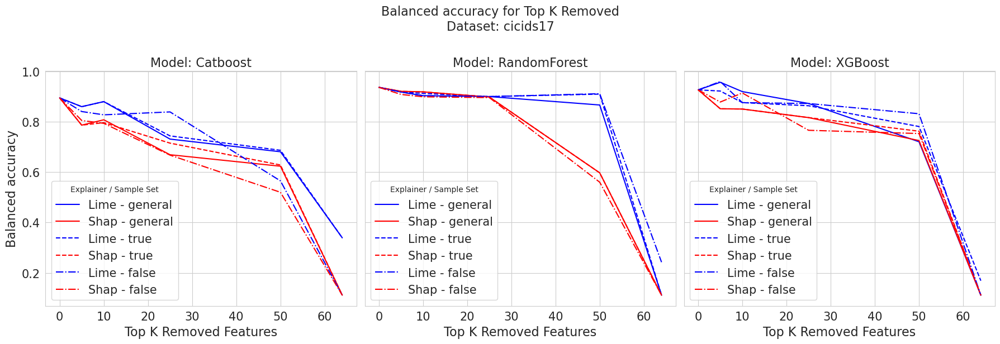

    dataset         model explainer   sample_set   top_k_0   top_k_5  top_k_10  top_k_25  top_k_50  top_k_62
0  cicids18      Catboost      lime  general_idx  0.728384  0.722516  0.722984  0.714128  0.633966  0.142857
1  cicids18      Catboost      shap  general_idx  0.728384  0.720780  0.719727  0.630359  0.184665  0.142857
2  cicids18  RandomForest      lime  general_idx  0.868688  0.849489  0.849046  0.731863  0.529498  0.178168
3  cicids18  RandomForest      shap  general_idx  0.868688  0.753568  0.768076  0.751275  0.456203  0.143919
4  cicids18       XGBoost      lime  general_idx  0.784693  0.749606  0.749784  0.738534  0.395914  0.142877
5  cicids18       XGBoost      shap  general_idx  0.784693  0.744087  0.690317  0.661251  0.416392  0.142857


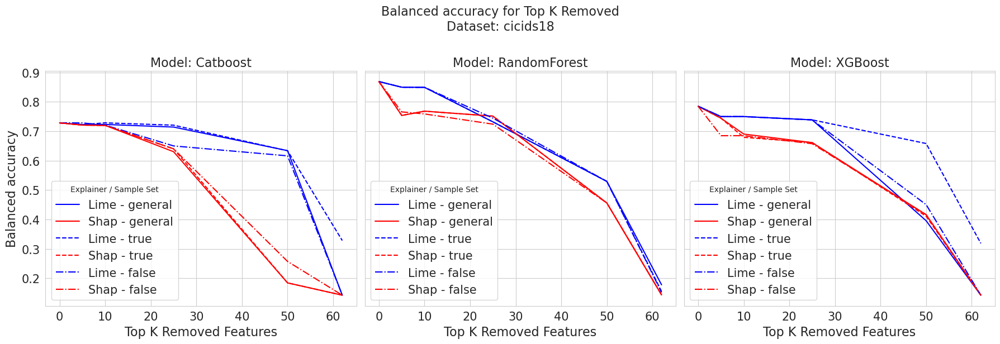

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

run = 10
df = df[df['run'] == run]


sns.set_style("whitegrid")

metric = 'balanced_accuracy'
color_palette = {
    'lime': 'blue',
    'shap': 'red'
}
line_styles = ['-', '--', '-.']

datasets = df['dataset'].unique()

for dataset in datasets:
    df_dataset = df[df['dataset'] == dataset]
    filtered_df = df[
    (df['dataset'] == dataset) &
    (df['run'] == run) &
    (df['sample_set'] == 'general_idx')
    ]
    #print(filtered_df.head())

    pivot_df = filtered_df.pivot_table(
    index=['dataset', 'model', 'explainer', 'sample_set'],
    columns='top_k_removed',
    values='balanced_accuracy'
    ).reset_index()
    
    # Rename columns for a readable format
    pivot_df.columns = ['dataset', 'model', 'explainer', 'sample_set'] + [f'top_k_{int(col)}' for col in pivot_df.columns[4:]]
    print(pivot_df)
    
    results_df = pd.DataFrame(pivot_df)
    results_df.to_csv(f'metrics/plots_n_tables/desc_acc_lime_vs_shap_one_run_{run}_{dataset}.csv', index=False)

    
    models = df_dataset['model'].unique()

    n_models = len(models)
    fig, axes = plt.subplots(nrows=1, ncols=n_models, figsize=(6 * n_models, 6), sharey=True)
    
    if n_models == 1:
        axes = [axes]

    for ax, model in zip(axes, models):
        df_model = df_dataset[df_dataset['model'] == model]
        sample_sets = df_model['sample_set'].unique()

        for si, sample_set in enumerate(sample_sets):
            df_ss = df_model[df_model['sample_set'] == sample_set]

            for explainer in ['lime', 'shap']:
                df_plot = df_ss[df_ss['explainer'] == explainer]

                if not df_plot.empty:
                    sns.lineplot(
                        data=df_plot.sort_values('top_k_removed'),
                        x='top_k_removed',
                        y=metric,
                        ax=ax,
                        label=f"{explainer.capitalize()} - {sample_set.replace('_idx', '')}",
                        color=color_palette[explainer],
                        linestyle=line_styles[si % len(line_styles)],
                        errorbar=None
                    )
        ax.set_title(f"Model: {model}", fontsize=16)
        ax.set_xlabel('Top K Removed Features', fontsize=16)
        ax.set_ylabel(metric.replace('_', ' ').capitalize(), fontsize=16)
        ax.legend(title='Explainer / Sample Set', fontsize=15, loc='best')
        ax.tick_params(axis='both', labelsize=15)
                  
    plt.suptitle(f"{metric.replace('_', ' ').capitalize()} for Top K Removed\nDataset: {dataset}", fontsize=16, y=1.02)
    plt.tight_layout()
    
    filename = f"metrics/plots_n_tables/desc_acc_{dataset}_run_{run}.png"
    plt.savefig(filename, bbox_inches='tight')     
    plt.show()     
    plt.close(fig)

#### Lime vs Shap all runs

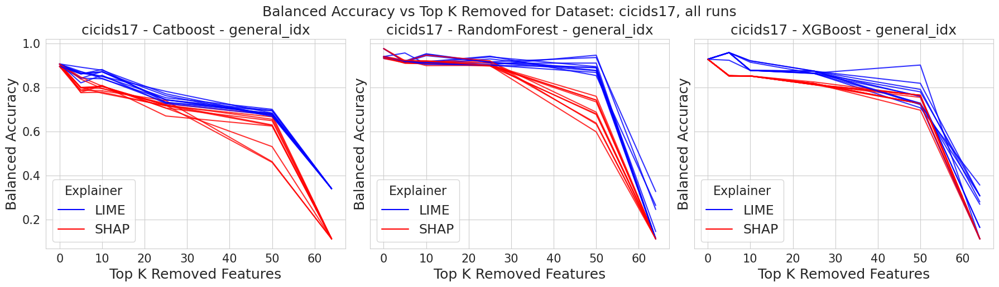

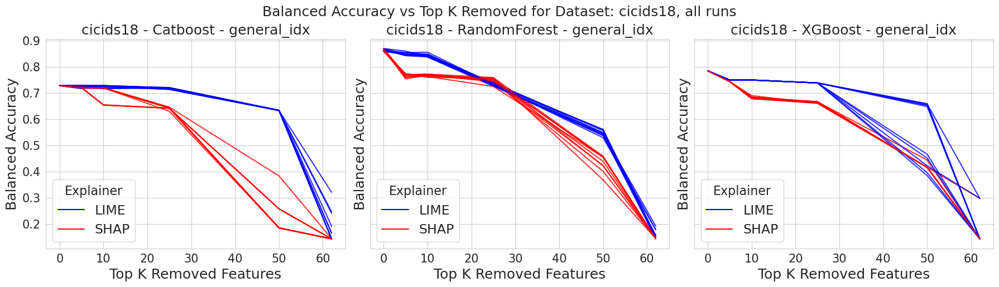

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns

# Load your DataFrame
df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

# Parameters
sample_set = 'general_idx'
color_palette = {'lime': 'blue', 'shap': 'red'}
max_lines_per_explainer = 10
line_styles = {'lime': '-', 'shap': '-'}

sns.set_style("whitegrid")

for dataset in df["dataset"].unique():
    df_dataset = df[df['dataset'] == dataset]
    models = df_dataset['model'].unique()
    
    n_models = len(models)
    n_cols = 3
    n_rows = (n_models + n_cols - 1) // n_cols  # Ceiling division
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 5 * n_rows), sharey=True)
    axes = axes.flatten()  # Flatten for easy iteration
    
    for i, model in enumerate(models):
        ax = axes[i]
        df_model = df_dataset[
            (df_dataset['model'] == model) &
            (df_dataset['sample_set'] == sample_set)
        ]
        
        lines_per_explainer = {'lime': 0, 'shap': 0}
        runs = sorted(df_model['run'].unique())
        
        for run in runs:
            df_run = df_model[df_model['run'] == run]
            
            for explainer in ['lime', 'shap']:
                if lines_per_explainer[explainer] >= max_lines_per_explainer:
                    continue
                
                df_exp = df_run[df_run['explainer'].str.lower() == explainer]
                if df_exp.empty:
                    continue
                
                df_exp = df_exp.sort_values('top_k_removed')
                
                ax.plot(
                    df_exp['top_k_removed'],
                    df_exp['balanced_accuracy'],
                    label=f"{explainer.capitalize()} Run {run}",
                    color=color_palette[explainer],
                    linestyle=line_styles[explainer],
                    alpha=0.8
                )
                lines_per_explainer[explainer] += 1
        
        ax.set_title(f"{dataset} - {model} - {sample_set}", fontsize=18)
        ax.set_xlabel('Top K Removed Features', fontsize=18)
        ax.set_ylabel('Balanced Accuracy', fontsize=18)
        handles = [
            Line2D([0], [0], color='blue', linestyle='-', label='LIME'),
            Line2D([0], [0], color='red', linestyle='-', label='SHAP')
        ]
        ax.legend(handles=handles, fontsize=17, title='Explainer', loc='lower left', title_fontsize=16)
        ax.tick_params(axis='both', labelsize=15)
    
    # Remove unused subplots if any
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle(f"Balanced Accuracy vs Top K Removed for Dataset: {dataset}, all runs", fontsize=18, y=1.02)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)  # To leave room for suptitle
    filename = f"metrics/final plots/desc_acc_{dataset}_all_runs.png"
    plt.savefig(filename, bbox_inches='tight')     
    plt.show()     
    plt.close(fig)

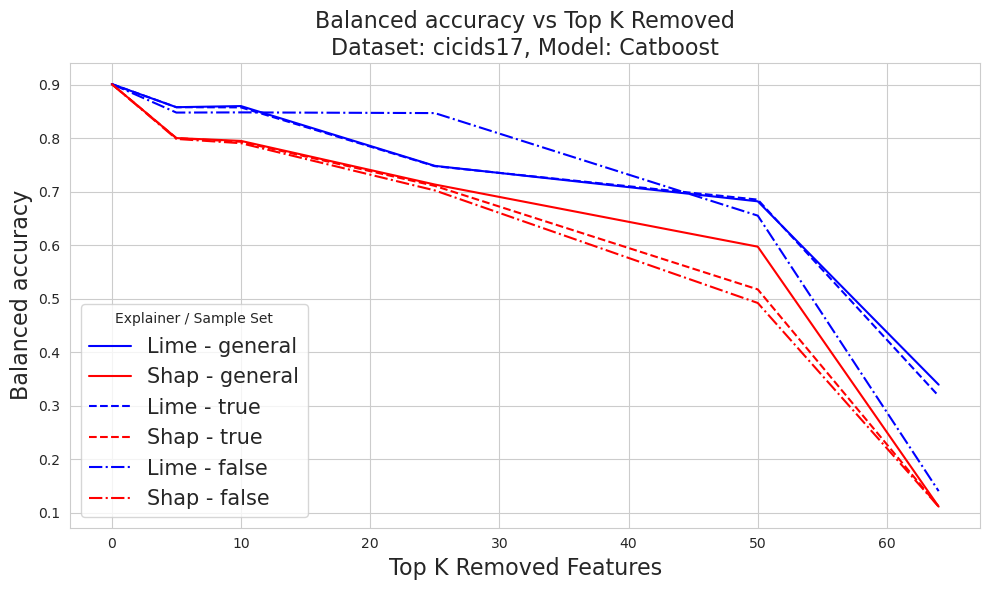

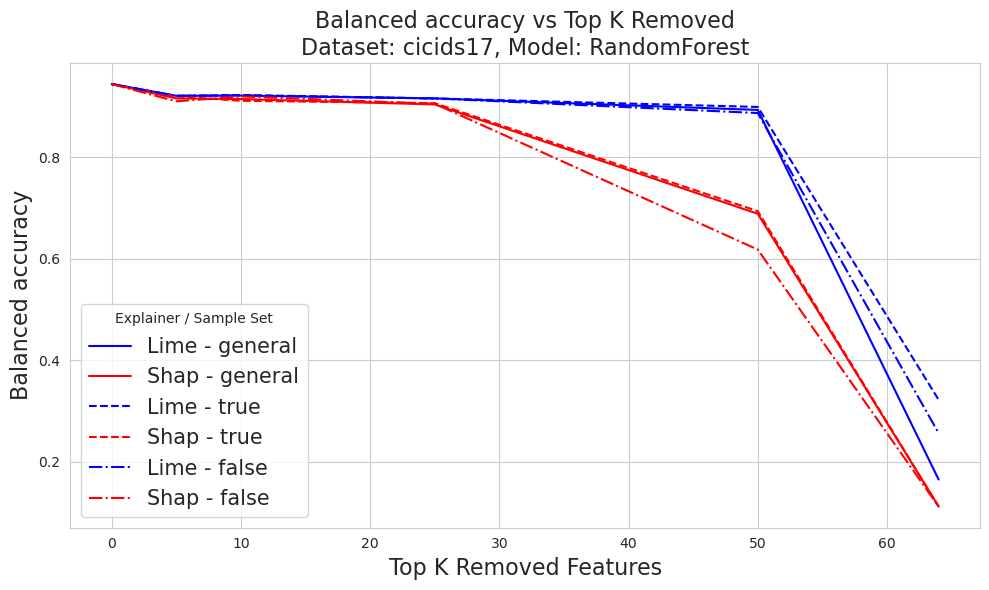

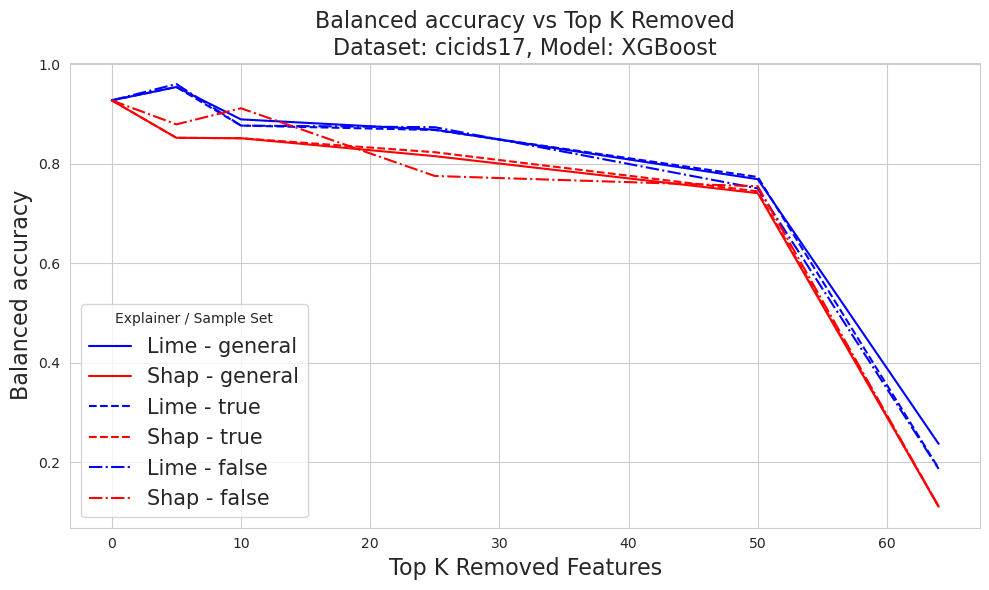

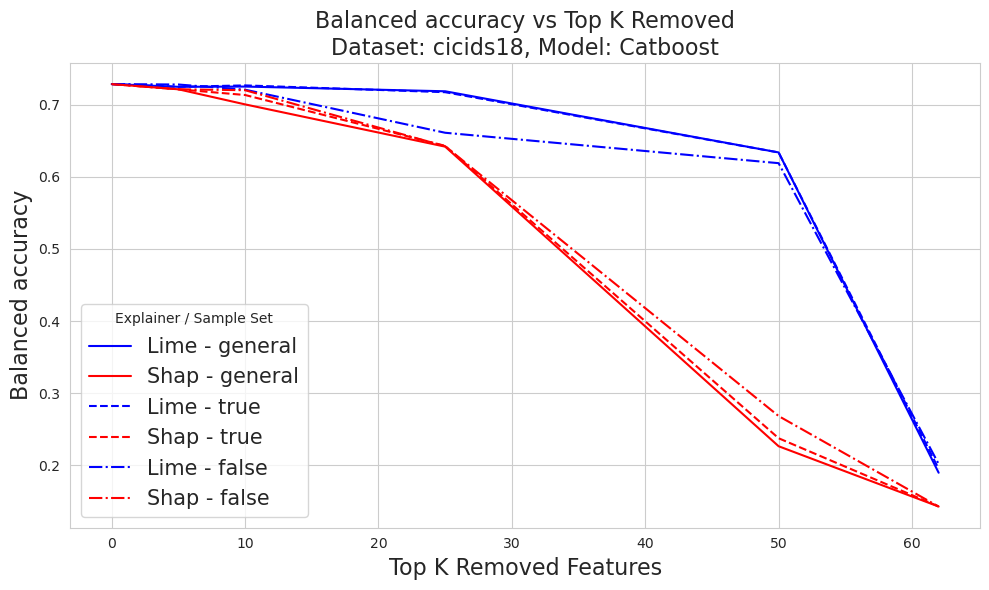

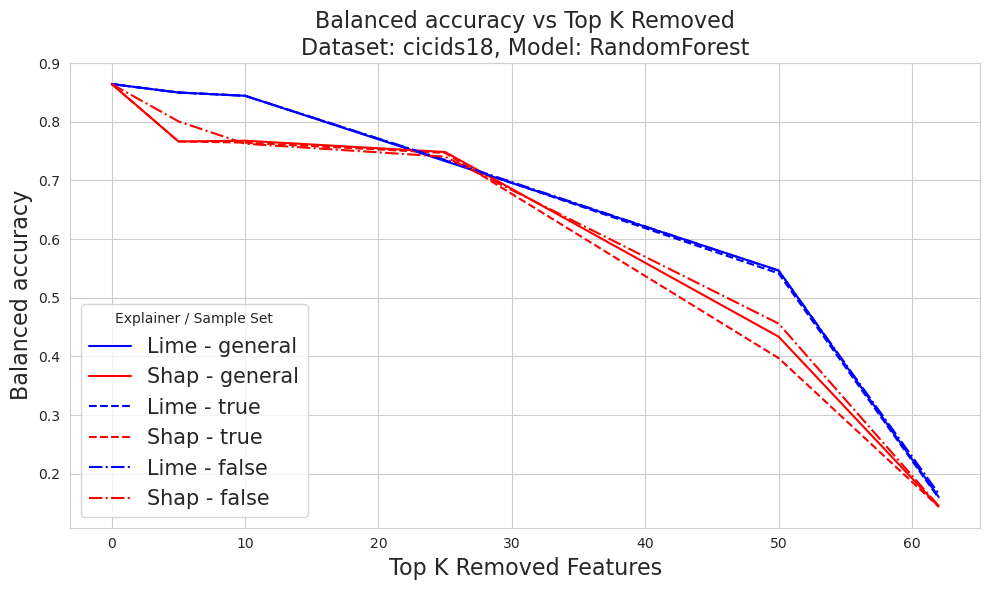

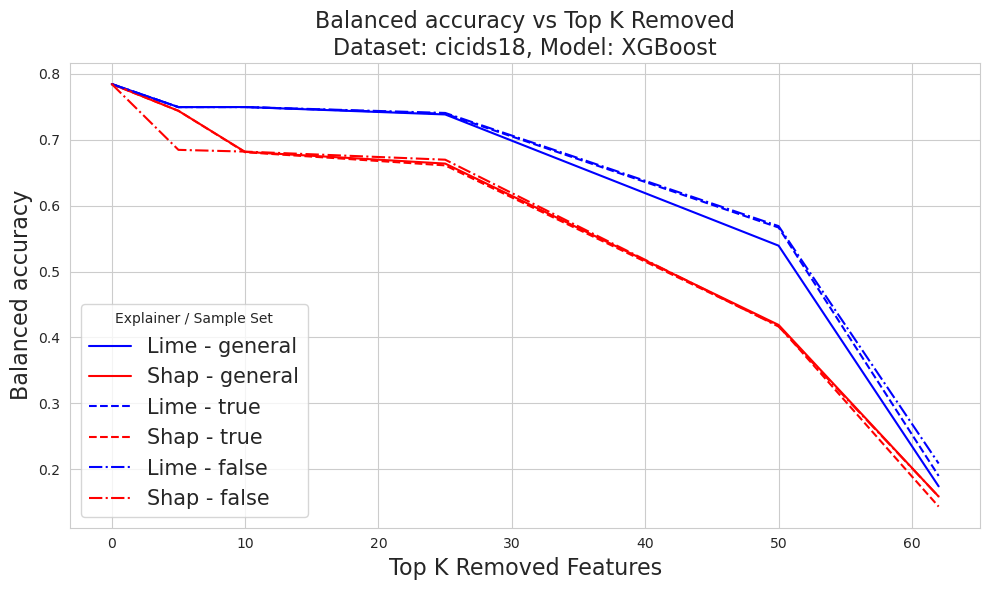

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")
#print(df.head(36))

sns.set_style("whitegrid")

metric = 'balanced_accuracy'
color_palette = {
    'lime': 'blue',
    'shap': 'red'
}
line_styles = ['-', '--', '-.']

datasets = df['dataset'].unique()

for dataset in datasets:
    df_dataset = df[df['dataset'] == dataset]
    models = df_dataset['model'].unique()
    
    for model in models:
        df_model = df_dataset[df_dataset['model'] == model]
        sample_sets = df_model['sample_set'].unique()

        plt.figure(figsize=(10, 6))
        
        for si, sample_set in enumerate(sample_sets):
            df_ss = df_model[df_model['sample_set'] == sample_set]
            
            for explainer in ['lime', 'shap']:
                df_plot = df_ss[df_ss['explainer'] == explainer]
                if not df_plot.empty:
                    sns.lineplot(
                        data=df_plot.sort_values('top_k_removed'),
                        x='top_k_removed',
                        y=metric,
                        label=f"{explainer.capitalize()} - {sample_set.replace('_idx', '')}",
                        color=color_palette[explainer],
                        linestyle=line_styles[si % len(line_styles)],
                        errorbar=None
                    )
        
        plt.title(f"{metric.replace('_', ' ').capitalize()} vs Top K Removed\nDataset: {dataset}, Model: {model}", fontsize=16)
        plt.xlabel('Top K Removed Features', fontsize=16)
        plt.ylabel(metric.replace('_', ' ').capitalize(), fontsize=16)
        plt.legend(title='Explainer / Sample Set', fontsize=15)
        plt.tight_layout()
        ax.tick_params(axis='both', labelsize=15)

        # Save figure to disk before showing
        filename = f"metrics/plots_n_tables/desc_acc_{dataset}_{model}_means.png"
        #plt.savefig(filename, bbox_inches='tight')
        
        plt.show()
        plt.close()


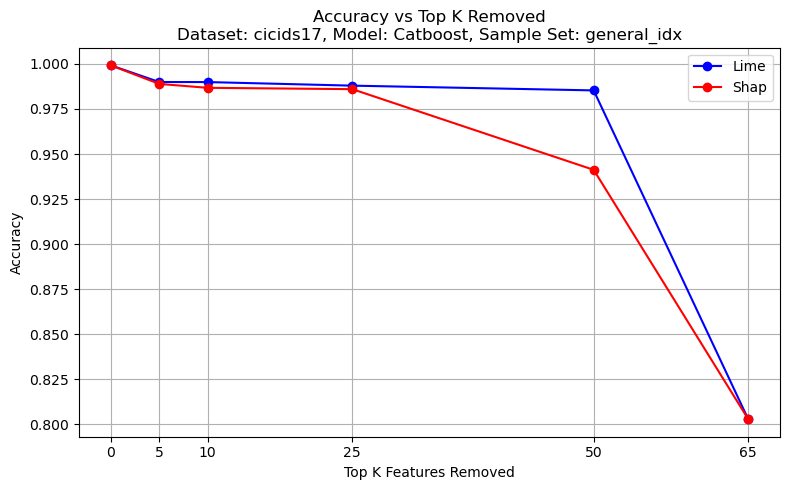

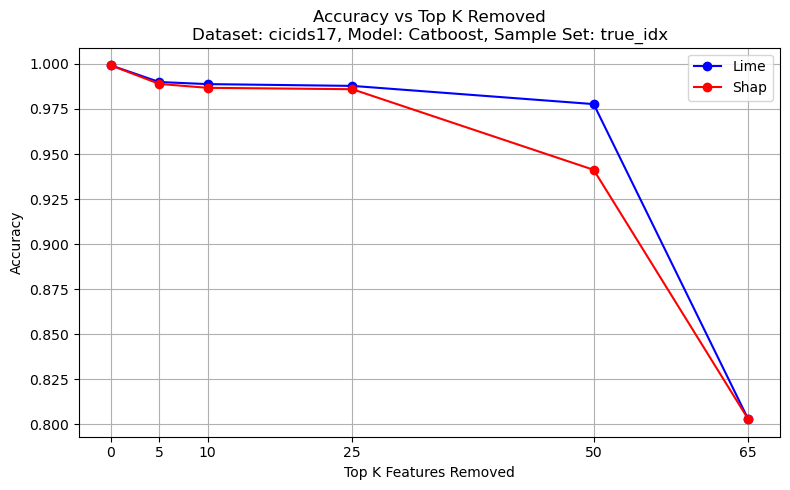

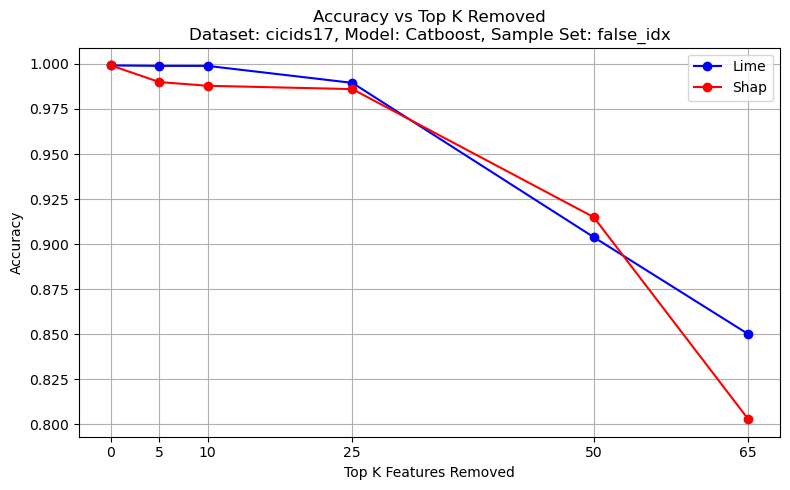

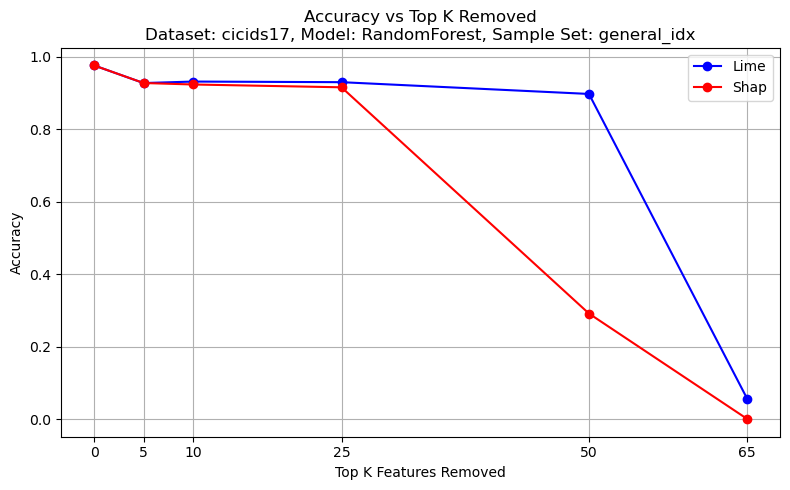

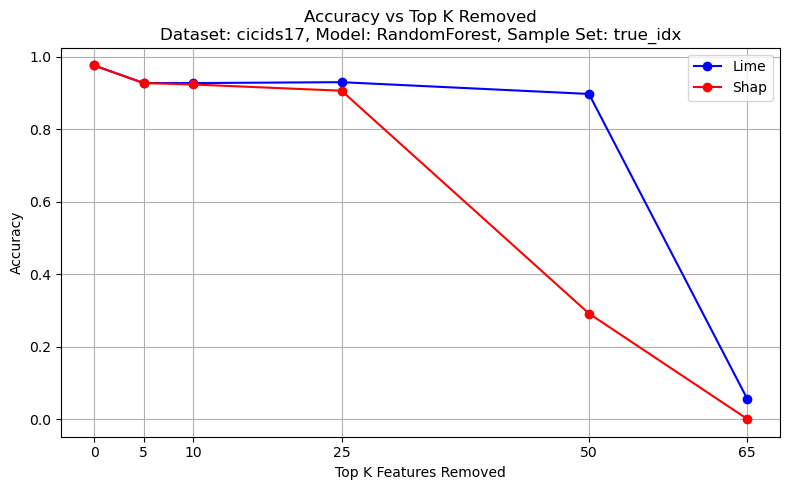

...

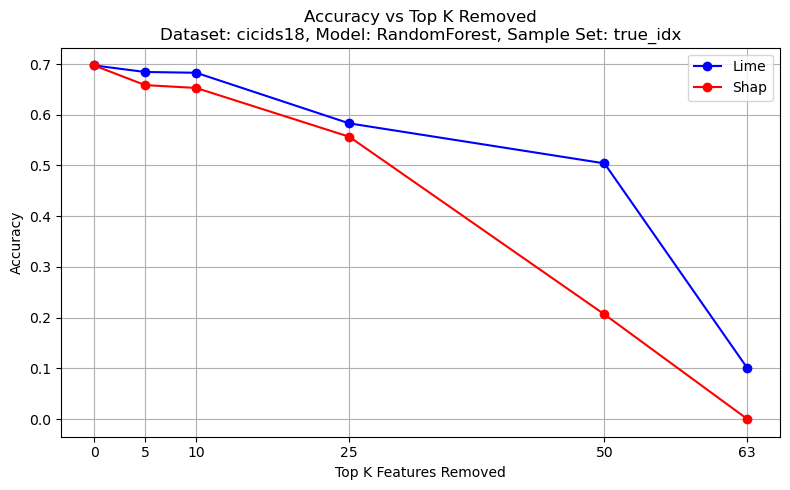

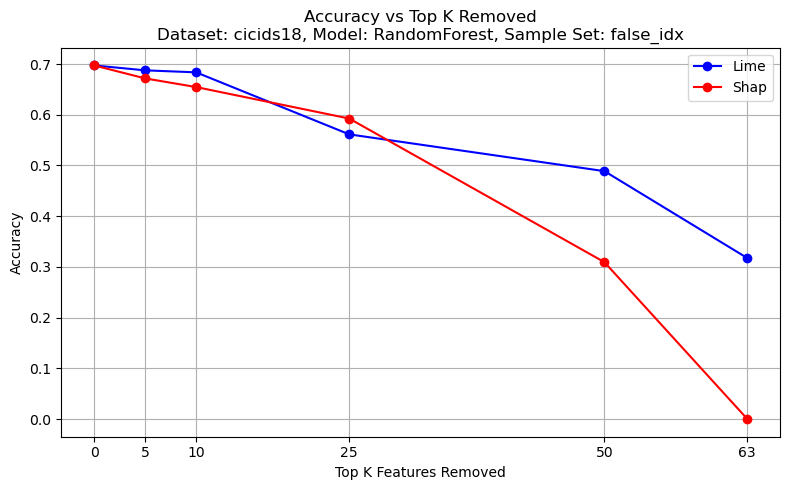

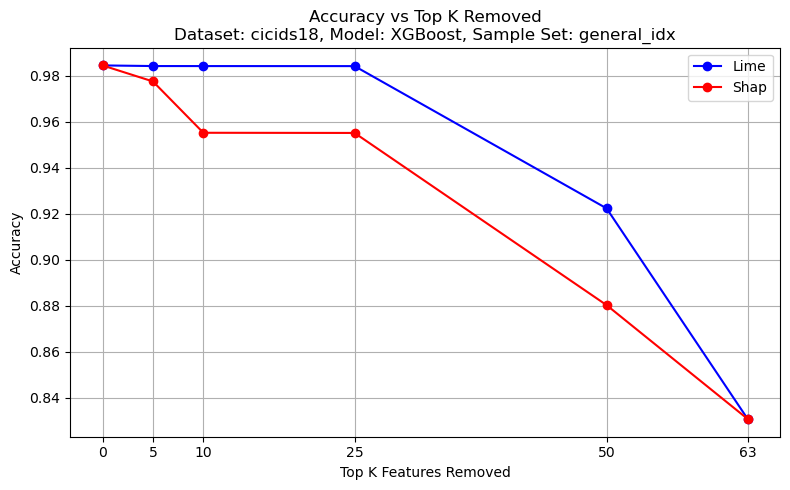

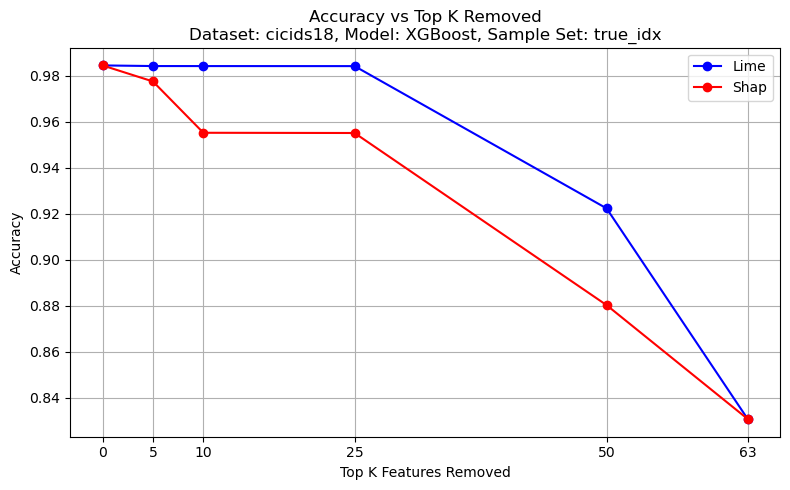

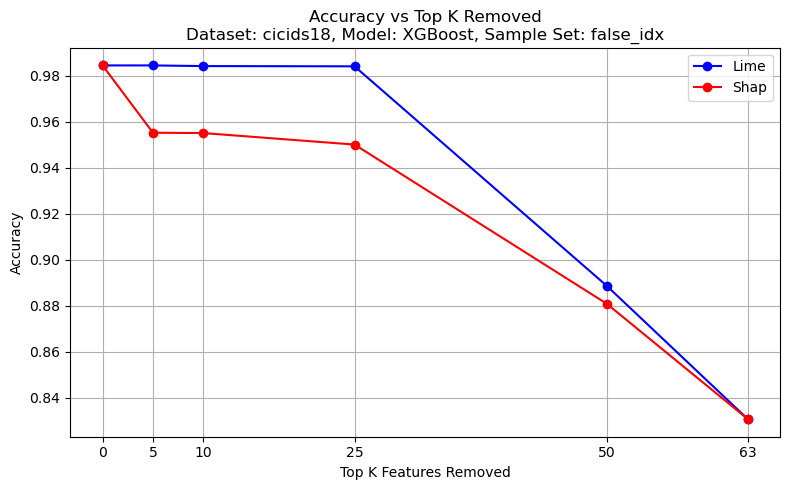

In [34]:
import matplotlib.pyplot as plt
import pandas as pd

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Load the results DataFrame
df = pd.read_parquet("metrics/descriptive_accuracy/all_models_all_explainer_descriptive_accuracy_results.parquet")

# Remove duplicates in place
df.drop_duplicates(inplace=True)

# Columns to group by for unique plots
group_cols = ['dataset', 'model', 'sample_set']
unique_groups = df[group_cols].drop_duplicates()

for _, group in unique_groups.iterrows():
    dataset = group['dataset']
    model = group['model']
    sample_set = group['sample_set']

    plt.figure(figsize=(8, 5))

    # Colors for explainers
    colors = {'lime': 'blue', 'shap': 'red'}

    for explainer in ['lime', 'shap']:
        # Filter subset for explainer
        subset = df[
            (df['dataset'] == dataset) &
            (df['model'] == model) &
            (df['explainer'] == explainer) &
            (df['sample_set'] == sample_set)
        ]

        if subset.empty:
            continue

        # Determine max_k as features_used where top_k_removed == 0
        max_k = subset[subset['top_k_removed'] == 0]['features_used'].max()

        # Map -1 to max_k + 1 for plotting so it appears at the right end
        subset = subset.copy()
        subset['top_k_mapped'] = subset['top_k_removed'].apply(lambda x: max_k + 1 if x == -1 else x)

        # Sort by mapped column
        subset = subset.sort_values('top_k_mapped')

        # Plot with color and label per explainer
        plt.plot(
            subset['top_k_mapped'],
            subset['accuracy'],
            marker='o',
            linestyle='-',
            color=colors[explainer],
            label=explainer.capitalize()
        )

    # Prepare x-tick labels for the union of both explainers' top_k_mapped values
    # Collect unique mapping values from both explainers
    combined_subset = df[
        (df['dataset'] == dataset) &
        (df['model'] == model) &
        (df['sample_set'] == sample_set)
    ]
    max_k_global = combined_subset[combined_subset['top_k_removed'] == 0]['features_used'].max()
    # Unique values including mapping
    unique_top_k = combined_subset['top_k_removed'].apply(lambda x: max_k_global + 1 if x == -1 else x).unique()
    unique_top_k_sorted = sorted(unique_top_k)

    # Create x-axis labels
    xtick_labels = [str(max_k_global) if v == max_k_global + 1 else str(int(v)) for v in unique_top_k_sorted]

    plt.xticks(unique_top_k_sorted, labels=xtick_labels)
    plt.title(f'Accuracy vs Top K Removed\nDataset: {dataset}, Model: {model}, Sample Set: {sample_set}')
    plt.xlabel('Top K Features Removed')
    plt.ylabel('Accuracy')
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


## Statistical Analysis True vs False

un-paired data, small sample sizes, normal and not normal distributed data

### Normality test for XAI true vs false (SW)

In [14]:
import pandas as pd
from scipy.stats import shapiro

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

group_keys = ['dataset', 'model', 'explainer', 'top_k_removed']
results = []
normal_count = 0
not_normal_count = 0

grouped = df.groupby(group_keys)

for (dataset, model, explainer, top_k), group in grouped:
    for sample_set in ['true_idx', 'false_idx']:
        subset = group[group['sample_set'] == sample_set]
        bal_acc = subset['balanced_accuracy']
        #print(bal_acc)
        
        if len(bal_acc) >= 3 and bal_acc.max() > bal_acc.min():
            stat, p_value = shapiro(bal_acc)
            if p_value > 0.05:
                interpretation = 'normally distributed'
                normal_count += 1
            else:
                interpretation = 'not normally distributed'
                not_normal_count += 1
        else:
            stat, p_value = None, None
            interpretation = 'test not possible'
        
        results.append({
            'dataset': dataset,
            'model': model,
            'explainer': explainer,
            'top_k_removed': top_k,
            'sample_set': sample_set,
            'W_statistic': stat,
            'p_value': p_value,
            'n_samples': len(bal_acc),
            'normality_result': interpretation
        })

results_df = pd.DataFrame(results)

print(results_df)
print(f"Number of groups normally distributed: {normal_count}")
print(f"Number of groups NOT normally distributed: {not_normal_count}")

results_df.to_csv('metrics/plots_n_tables/desc_acc_true_vs_false_normality_test_results.csv', index=False)


      dataset         model explainer  top_k_removed sample_set  W_statistic       p_value  n_samples          normality_result
0    cicids17      Catboost      lime              0   true_idx     0.712215  1.238945e-03         10  not normally distributed
1    cicids17      Catboost      lime              0  false_idx     0.712215  1.238945e-03         10  not normally distributed
2    cicids17      Catboost      lime              5   true_idx     0.943146  5.885171e-01         10      normally distributed
3    cicids17      Catboost      lime              5  false_idx     0.883884  1.445573e-01         10      normally distributed
4    cicids17      Catboost      lime             10   true_idx     0.833042  3.640400e-02         10  not normally distributed
5    cicids17      Catboost      lime             10  false_idx     0.939342  5.457135e-01         10      normally distributed
6    cicids17      Catboost      lime             25   true_idx     0.906026  2.547926e-01         10   

### Significance True vs False

King, p. 128

In [28]:
import pandas as pd
import warnings
from scipy.stats import shapiro, mannwhitneyu, ttest_ind

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

results = []

def is_normal(data, tol=1e-8, context_info=""):
    if len(data) < 3:
        return False
    if data.max() - data.min() < tol:
        # Almost constant data, treat as normal but log
        print(f"Warning: near-constant data detected (treated as normal) at {context_info}")
        return True
    try:
        with warnings.catch_warnings():
            warnings.simplefilter("error")  # Turn warnings into errors
            stat, p_value = shapiro(data)
        return p_value > 0.05
    except Warning as w:
        print(f"Warning treated as error during Shapiro test at {context_info}: {w}")
        return False
    except Exception as e:
        print(f"Exception during Shapiro test at {context_info}: {e}")
        return False

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for explainer in df['explainer'].unique():
            for k in df[df['dataset'] == dataset]['top_k_removed'].unique():

                if k == 0:
                    continue

                true_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sample_set"] == "true_idx") &
                    (df["explainer"].str.lower() == explainer.lower()) &
                    (df["top_k_removed"] == k)
                ]

                false_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sample_set"] == "false_idx") &
                    (df["explainer"].str.lower() == explainer.lower()) &
                    (df["top_k_removed"] == k)
                ]

                if true_subset.empty or false_subset.empty:
                    continue

                true_vals = true_subset["balanced_accuracy"].values
                false_vals = false_subset["balanced_accuracy"].values

                true_mean = round(true_vals.mean(), 5)
                true_std  = round(true_vals.std(ddof=1), 5)
                true_var  = round(true_vals.var(ddof=1), 5)
                
                false_mean = round(false_vals.mean(), 5)
                false_std  = round(false_vals.std(ddof=1), 5)
                false_var  = round(false_vals.var(ddof=1), 5)

                context_info_true = f"dataset={dataset}, model={model}, explainer={explainer}, sample_set=true_idx, k={k}"
                context_info_false = f"dataset={dataset}, model={model}, explainer={explainer}, sample_set=false_idx, k={k}"

                normality_true = is_normal(true_vals, context_info=context_info_true)
                normality_false = is_normal(false_vals, context_info=context_info_false)

                if normality_true and normality_false:
                    # idependent ttest
                    stat, p = ttest_ind(true_vals, false_vals, equal_var=False)
                    norm = True
                else:
                    # mann-whitney u test
                    stat, p = mannwhitneyu(true_vals, false_vals, alternative='two-sided')
                    norm = False

                interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                results.append({
                    "dataset": dataset,
                    "model": model,
                    "explainer": explainer,
                    "k": k,
                    #"n_samples_true": len(true_vals),
                    #"n_samples_false": len(false_vals),
                    "true_mean": true_mean,
                    "true_std": true_std,
                    "true_var": true_var,
                    "false_mean": false_mean,
                    "false_std": false_std,
                    "false_var": false_var,
                    "normality": norm,
                    "ttest/W": round(stat, 5),
                    "p_value": round(p, 5),
                    "interpretation": interpretation
                })

results_df = pd.DataFrame(results)
print(results_df)
results_df.to_csv('metrics/plots_n_tables/desc_acc_true_vs_false_significance_results.csv', index=False)



/home/maui/miniconda3/envs/ai_env/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:586: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/home/maui/miniconda3/envs/ai_env/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:586: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/home/maui/miniconda3/envs/ai_env/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:586: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


     dataset         model explainer   k  true_mean  true_std  true_var  false_mean  false_std  false_var  normality    ttest/W  p_value             interpretation
0   cicids17      Catboost      lime   5    0.85829   0.01972   0.00039     0.84827    0.00536    0.00003       True    1.55144  0.15090  No significant difference
1   cicids17      Catboost      lime  10    0.85796   0.01719   0.00030     0.84858    0.01752    0.00031      False   65.00000  0.27304  No significant difference
2   cicids17      Catboost      lime  25    0.74800   0.01344   0.00018     0.84730    0.00624    0.00004       True  -21.19032  0.00000     Significant difference
3   cicids17      Catboost      lime  50    0.68539   0.00873   0.00008     0.65543    0.04223    0.00178       True    2.19732  0.05330  No significant difference
4   cicids17      Catboost      lime  64    0.31800   0.06712   0.00450     0.14003    0.08463    0.00716      False   89.00000  0.00249     Significant difference
5   cicids17    

/home/maui/miniconda3/envs/ai_env/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:586: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


In [10]:
import pandas as pd

df = pd.read_csv("metrics/plots_n_tables/desc_acc_true_vs_false_significance_results.csv")

total_counts = df.groupby(['dataset', 'model', 'explainer']).size().reset_index(name='total_count')
significant_counts = df[df['interpretation'].str.contains('Significant difference')].groupby(['dataset', 'model', 'explainer']).size().reset_index(name='significant_count')

# Merge counts
data_counts = pd.merge(total_counts, significant_counts, on=['dataset', 'model', 'explainer'], how='left')

# Fill missing significant counts with 0
data_counts['significant_count'] = data_counts['significant_count'].fillna(0)

# Calculate insignificant counts and ratio
data_counts['insignificant_count'] = data_counts['total_count'] - data_counts['significant_count']
data_counts['significant_ratio'] = data_counts['significant_count'] / data_counts['total_count']

# Output the summary table
print(data_counts[['dataset', 'model', 'explainer', 'significant_count', 'insignificant_count', 'significant_ratio']])


     dataset         model explainer  significant_count  insignificant_count  significant_ratio
0   cicids17      Catboost      lime                2.0                  3.0                0.4
1   cicids17      Catboost      shap                0.0                  5.0                0.0
2   cicids17  RandomForest      lime                0.0                  5.0                0.0
3   cicids17  RandomForest      shap                3.0                  2.0                0.6
4   cicids17       XGBoost      lime                2.0                  3.0                0.4
5   cicids17       XGBoost      shap                3.0                  2.0                0.6
6   cicids18      Catboost      lime                3.0                  2.0                0.6
7   cicids18      Catboost      shap                0.0                  5.0                0.0
8   cicids18  RandomForest      lime                0.0                  5.0                0.0
9   cicids18  RandomForest      shap    

## Visualizations

#### True vs False Means

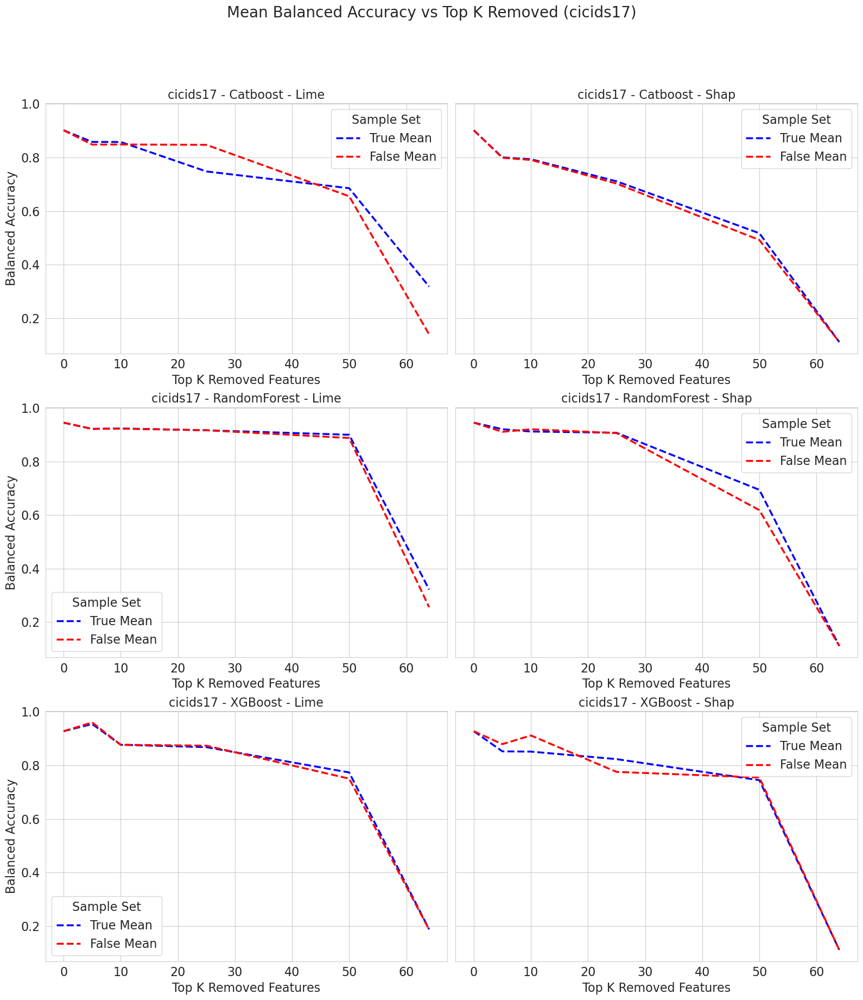

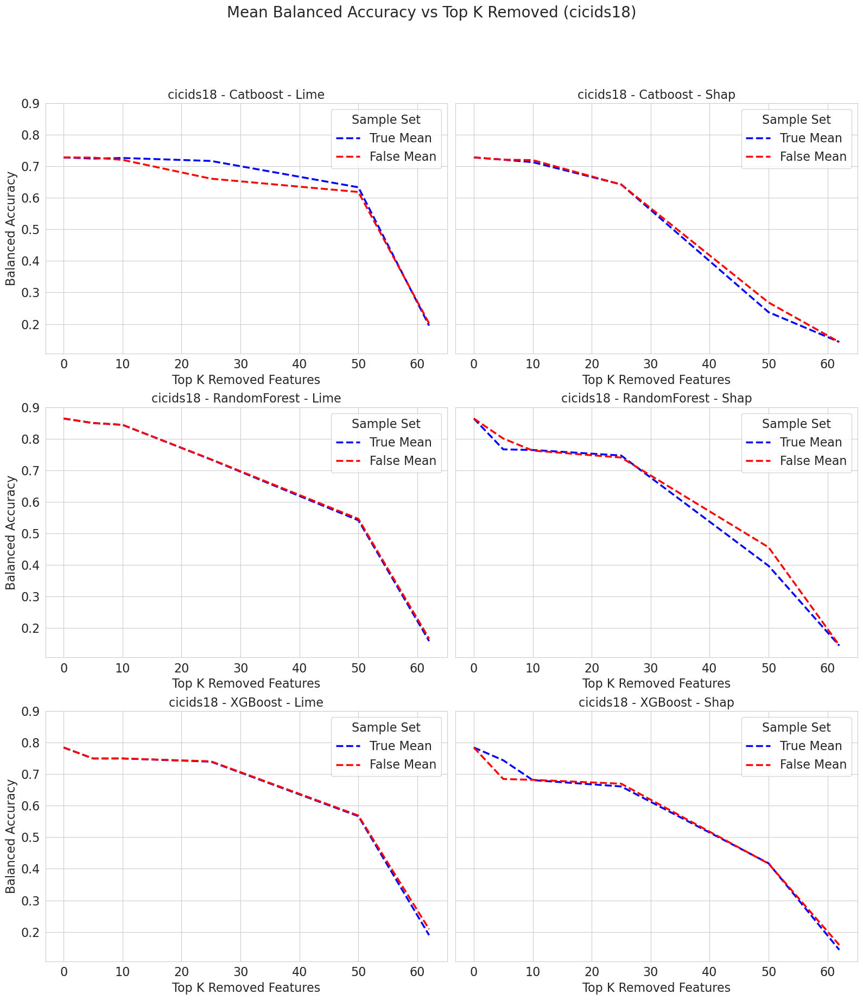

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")

color_palette = {'true_idx': 'blue', 'false_idx': 'red'}
line_styles = {'true_idx': '--', 'false_idx': '--'}

sns.set_style("whitegrid")

# Define global font size
FS = 16

for dataset in df["dataset"].unique():
    df_dataset = df[df['dataset'] == dataset]
    models = df_dataset['model'].unique()
    n_models = len(models)
    n_cols = 2  # one for lime, one for shap
    n_rows = n_models

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(8 * n_cols, 6 * n_rows), sharey=True)
    if n_models == 1:
        axes = axes.reshape(1, -1)

    for i, model in enumerate(models):
        df_model = df_dataset[df_dataset['model'] == model]
        
        for j, explainer in enumerate(['lime', 'shap']):
            ax = axes[i, j]

            for sample_set in ['true_idx', 'false_idx']:
                # Group by top_k_removed, take mean over all runs
                df_ss = df_model[
                    (df_model['sample_set'] == sample_set) &
                    (df_model['explainer'].str.lower() == explainer)
                ]
                if df_ss.empty:
                    continue

                df_mean = (
                    df_ss.groupby('top_k_removed')['balanced_accuracy']
                    .mean()
                    .reset_index()
                    .sort_values('top_k_removed')
                )

                ax.plot(
                    df_mean['top_k_removed'],
                    df_mean['balanced_accuracy'],
                    label=f"{sample_set.replace('_idx','').capitalize()} Mean",
                    color=color_palette[sample_set],
                    linestyle=line_styles[sample_set],
                    alpha=1.0,
                    linewidth=2.5
                )

            ax.set_title(f"{dataset} - {model} - {explainer.capitalize()}", fontsize=FS)
            ax.set_xlabel('Top K Removed Features', fontsize=FS)
            
            # Tick parameters (axis numbers)
            ax.tick_params(axis='both', which='major', labelsize=FS)

            if j == 0:
                ax.set_ylabel('Balanced Accuracy', fontsize=FS)
            else:
                ax.set_ylabel('')
            
            # Legend settings
            ax.legend(fontsize=FS, title='Sample Set', title_fontsize=FS, loc='best')

    # Main Title
    plt.suptitle(f'Mean Balanced Accuracy vs Top K Removed ({dataset})', fontsize=FS+4, y=1.02)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92) # Adjust based on number of rows
    
    # Updated filename to be more generic since plot contains ALL models for the dataset
    filename = f"metrics/final plots/balanced_accuracy_vs_top_k_{dataset}_all_models.png"
    plt.savefig(filename, bbox_inches='tight')
    plt.show()
    plt.close(fig)

#### True vs False all runs

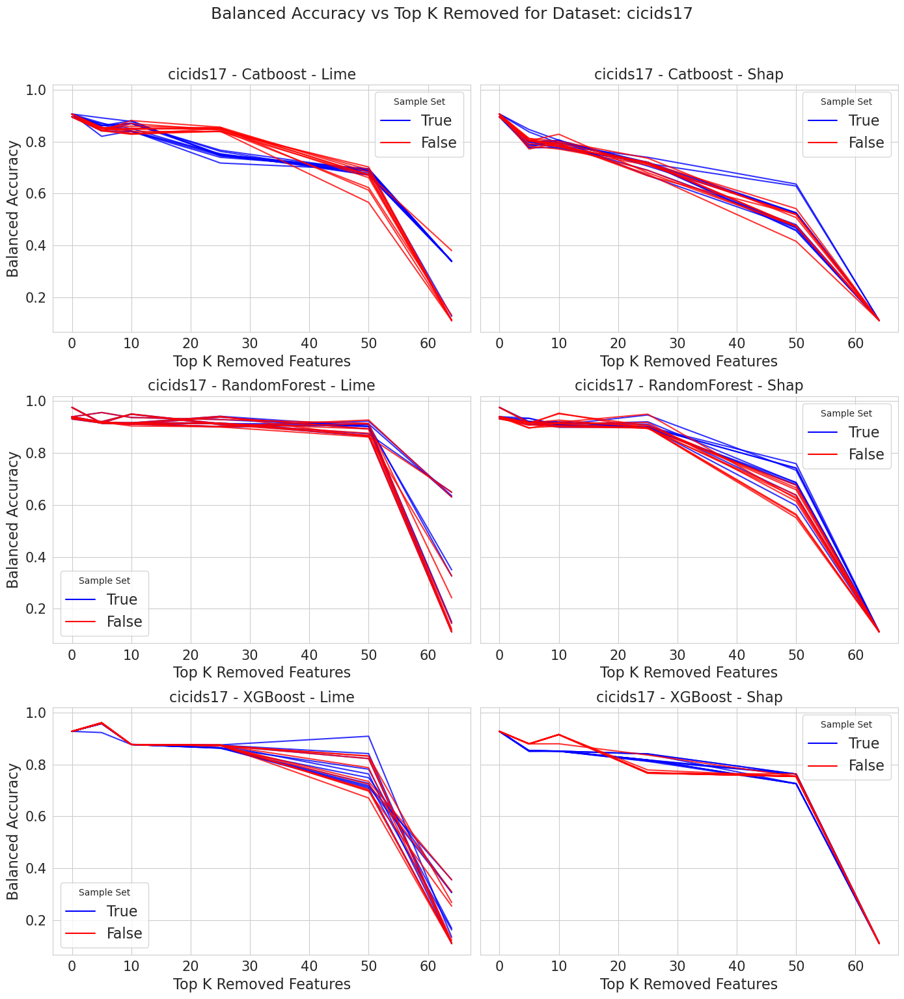

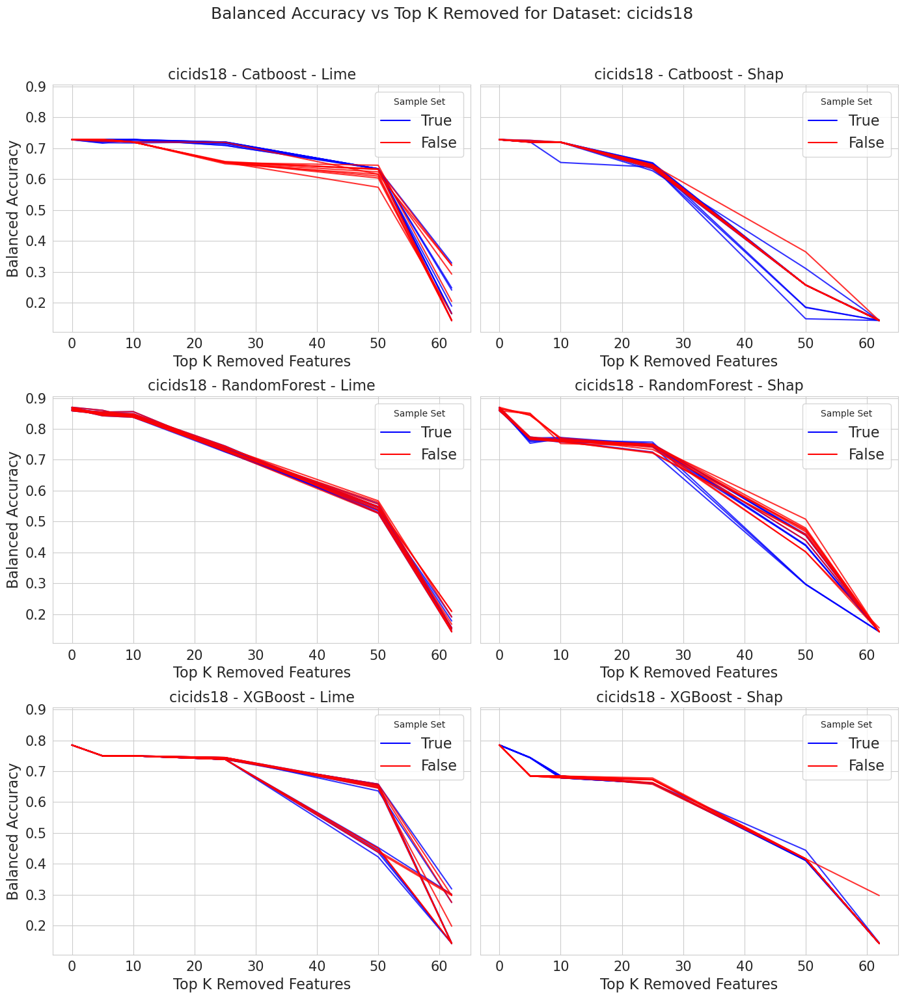

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_parquet("metrics/descriptive_accuracy/descriptive_accuracy_results.parquet")
color_palette = {'true_idx': 'blue', 'false_idx': 'red'}
line_styles = {'true_idx': '-', 'false_idx': '-'}
sns.set_style("whitegrid")

for dataset in df["dataset"].unique():
    df_dataset = df[df['dataset'] == dataset]
    models = df_dataset['model'].unique()
    n_models = len(models)
    n_cols = 2  # two plots per model: lime and shap
    n_rows = n_models  # one row per model
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(7 * n_cols, 5 * n_rows), sharey=True)
    
    if n_models == 1:
        axes = axes.reshape(1, -1)
        
    for i, model in enumerate(models):
        df_model = df_dataset[df_dataset['model'] == model]
        for j, explainer in enumerate(['lime', 'shap']):
            ax = axes[i, j]
            
            # Plot all runs without labels to avoid clutter
            for sample_set in ['true_idx', 'false_idx']:
                df_ss = df_model[
                    (df_model['sample_set'] == sample_set) &
                    (df_model['explainer'].str.lower() == explainer)
                ]
                
                if df_ss.empty:
                    continue
                
                runs = sorted(df_ss['run'].unique())
                max_lines = 10
                
                for run in runs[:max_lines]:
                    df_run = df_ss[df_ss['run'] == run].sort_values('top_k_removed')
                    
                    ax.plot(
                        df_run['top_k_removed'],
                        df_run['balanced_accuracy'],
                        color=color_palette[sample_set],
                        linestyle=line_styles[sample_set],
                        alpha=0.8
                    )
            
            ax.set_title(f"{dataset} - {model} - {explainer.capitalize()}", fontsize=16)
            ax.set_xlabel('Top K Removed Features', fontsize=16)
            if j == 0:
                ax.set_ylabel('Balanced Accuracy', fontsize=16)
            else:
                ax.set_ylabel('')

            ax.tick_params(labelsize=15)
            
            from matplotlib.lines import Line2D
            legend_handles = [
                Line2D([0], [0], color=color_palette['true_idx'], label='True', linestyle=line_styles['true_idx']),
                Line2D([0], [0], color=color_palette['false_idx'], label='False', linestyle=line_styles['false_idx'])
            ]
            ax.legend(handles=legend_handles, fontsize=16, title='Sample Set', loc='best')
    
    plt.suptitle(f'Balanced Accuracy vs Top K Removed for Dataset: {dataset}', fontsize=18, y=1.02)
    plt.tight_layout()
    plt.subplots_adjust(top=0.94)
    filename = f"metrics/plots_n_tables/balanced_accuracy_vs_top_k_{dataset}_{model}_{explainer}_true_vs_false_all_runs.png"
    plt.savefig(filename, bbox_inches='tight')  
    plt.show() 
    plt.close(fig)


### Global Feature Importance

In [3]:
import os
import pandas as pd
from collections import defaultdict
from ast import literal_eval

directory = 'explanation_data/'
all_files = os.listdir(directory)
explanations = sorted([f for f in all_files if os.path.isfile(os.path.join(directory, f))])

samplesets = ['general_idx']  # adjust as needed

for file in explanations:
    file_lower = file.lower()
    if "lime" in file_lower:
        explainer = "lime"
    elif "shap" in file_lower:
        explainer = "shap"
    if "cicids17" in file:
        dataset_name = "CICIDS17"
    elif "cicids18" in file:
        dataset_name = "CICIDS18"
    
    if "randomforest" in file_lower or "rf" in file_lower:
        model_name = "RandomForest"
    elif "xgboost" in file_lower or "xgb" in file_lower:
        model_name = "XGBoost"
    elif "catboost" in file_lower:
        model_name = "Catboost"

    print("Analyzing:\n" + file)
    exp_df = pd.read_csv(os.path.join(directory, file), index_col=0)

    feature_importances_per_sampleset = {}

    for sampleset in samplesets:
        print("Collecting data for:", sampleset)
        runs = exp_df['run_nr'].unique()
        per_run_means = defaultdict(list)
        feature_importances_per_sampleset[sampleset] = {}

        for run in runs[:2]:  # limit runs as in original code
            run_rows = exp_df[(exp_df['run_nr'] == run) & (exp_df['sample_set'] == sampleset)]
            n_samples = len(run_rows)
            abs_sums_run = defaultdict(float)

            for idx in range(n_samples):
                pairs = literal_eval(run_rows['feature_value_pairs'].iloc[idx])
                for key, value in pairs:
                    abs_sums_run[key] += abs(value)

            for key, total_abs in abs_sums_run.items():
                mean_per_run = total_abs / n_samples
                per_run_means[key].append(mean_per_run)

            abs_means = {key: sum(values) / len(values) for key, values in per_run_means.items()}
            sorted_features = dict(sorted(abs_means.items(), key=lambda item: item[0]))
            feature_importances_per_sampleset[sampleset][f'run_{run}'] = sorted_features

        tot_abs_mean_ranked = defaultdict(float)
        run_count = 0
        for run_key, feature_dict in feature_importances_per_sampleset[sampleset].items():
            if not run_key.startswith("run_"):
                continue
            for feature, value in feature_dict.items():
                tot_abs_mean_ranked[feature] += value
            run_count += 1

        abs_mean_ranked = {key: value / run_count for key, value in tot_abs_mean_ranked.items()}
        sorted_abs_mean_ranked = dict(sorted(abs_mean_ranked.items(), key=lambda item: item[1], reverse=True))
        feature_importances_per_sampleset[sampleset]['abs_mean_ranked'] = sorted_abs_mean_ranked

        csv_output_path = f'metrics/descriptive_accuracy/{file[:-4]}_feature_importances.csv'
        df_features = pd.DataFrame(list(sorted_abs_mean_ranked.items()), columns=['feature', 'importance'])
        df_features.to_csv(csv_output_path, index=False)
        print(f"Feature importances saved to {csv_output_path}\n")


Analyzing:
cicids17_CatBoost_lime_explanations.csv
Feature importances saved to metrics/descriptive_accuracy/cicids17_CatBoost_lime_explanations_feature_importances.csv

Analyzing:
cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
Feature importances saved to metrics/descriptive_accuracy/cicids17_CatBoost_shap_kernel_smoothed_explanations_feature_importances.csv

Analyzing:
cicids17_RandomForest_lime_explanations.csv
Feature importances saved to metrics/descriptive_accuracy/cicids17_RandomForest_lime_explanations_feature_importances.csv

Analyzing:
cicids17_RandomForest_shap_kernel_smoothed_explanations.csv
Feature importances saved to metrics/descriptive_accuracy/cicids17_RandomForest_shap_kernel_smoothed_explanations_feature_importances.csv

Analyzing:
cicids17_XGBoost_lime_explanations.csv
Feature importances saved to metrics/descriptive_accuracy/cicids17_XGBoost_lime_explanations_feature_importances.csv

Analyzing:
cicids17_XGBoost_shap_kernel_smoothed_explanations.csv
Featur

cicids17_CatBoost_lime_explanations_feature_importances.csv


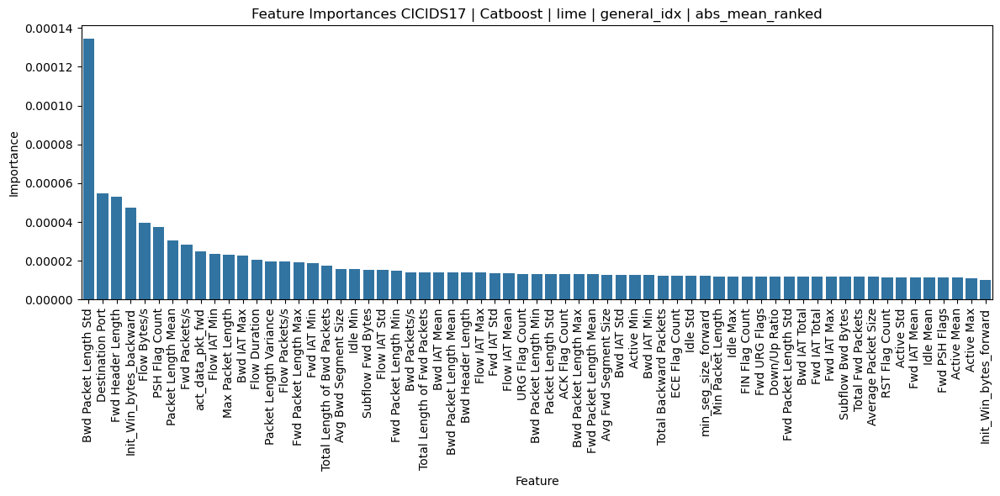

cicids17_CatBoost_shap_kernel_smoothed_explanations_feature_importances.csv


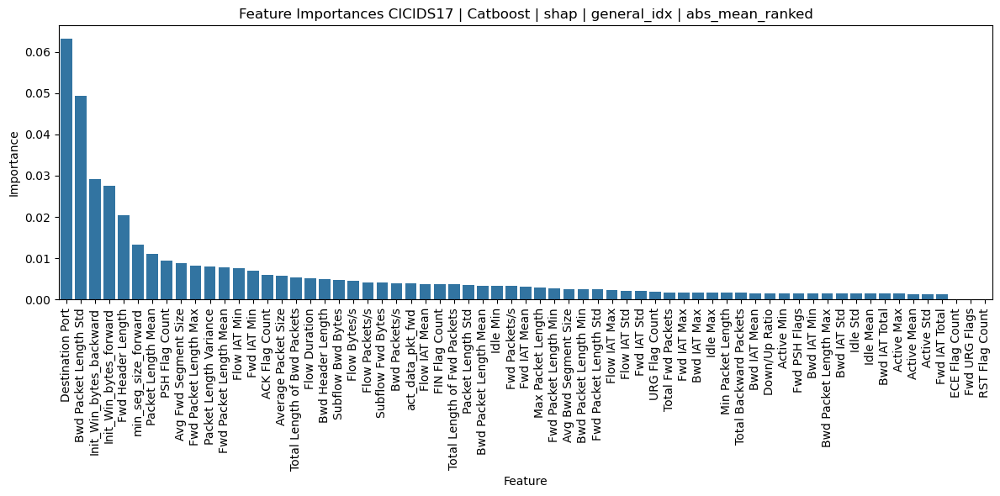

cicids17_RandomForest_lime_explanations_feature_importances.csv


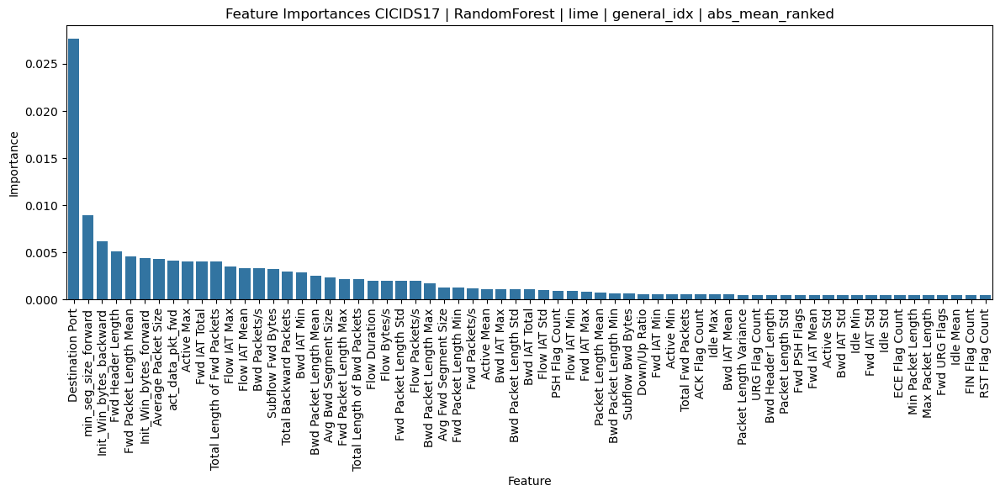

cicids17_RandomForest_shap_kernel_smoothed_explanations_feature_importances.csv


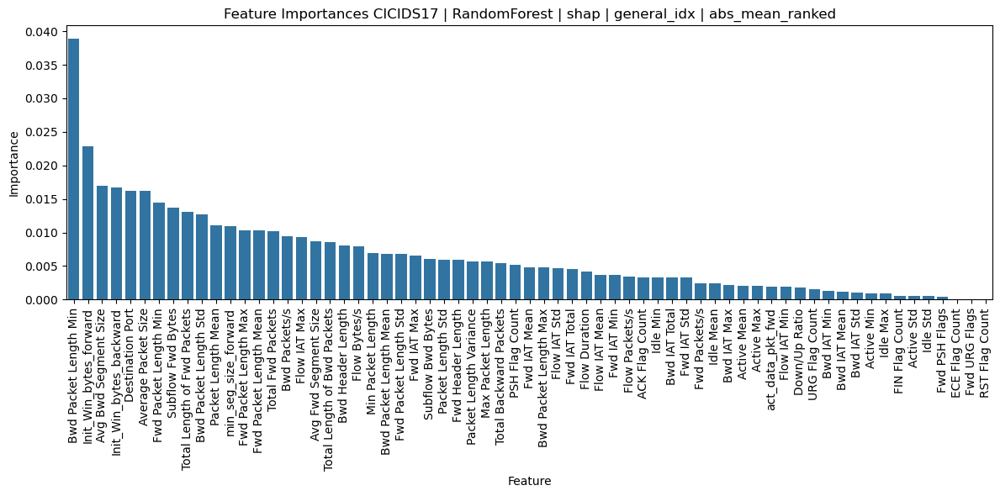

cicids17_XGBoost_lime_explanations_feature_importances.csv


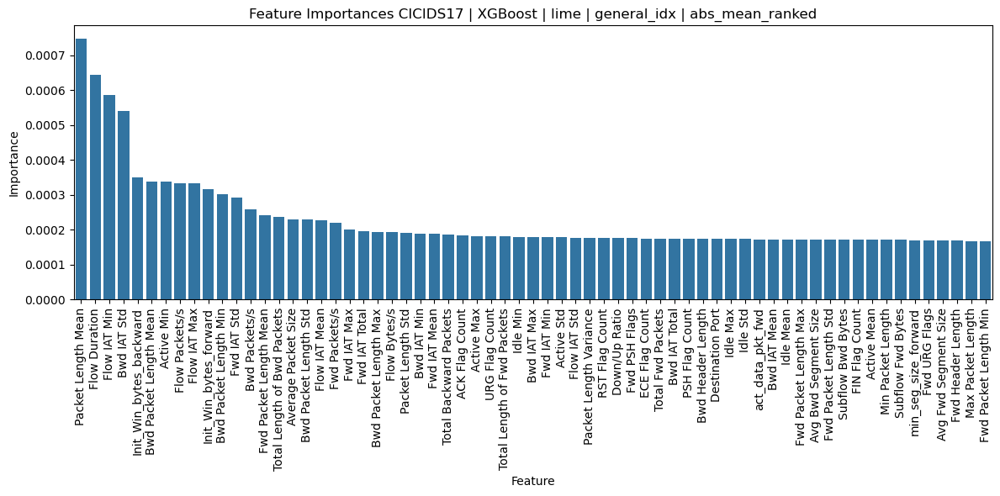

cicids17_XGBoost_shap_kernel_smoothed_explanations_feature_importances.csv


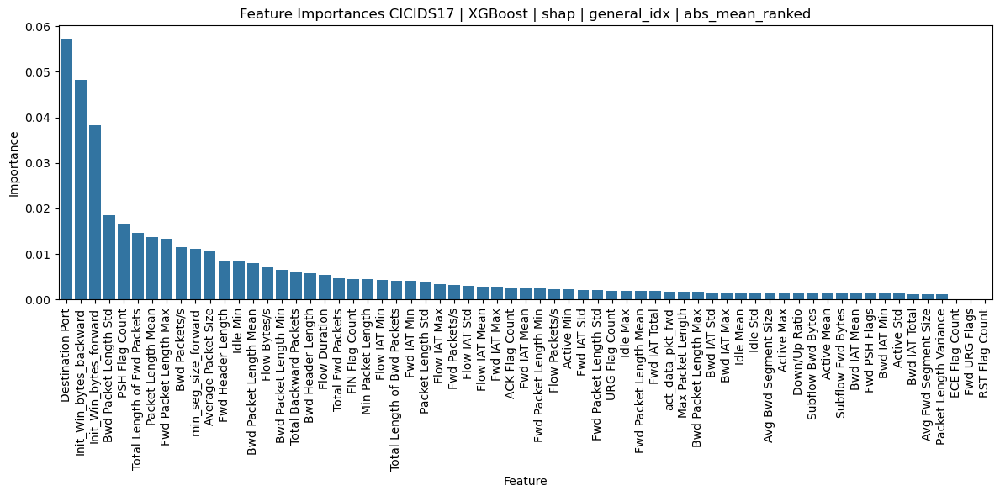

cicids18_CatBoost_lime_explanations_feature_importances.csv


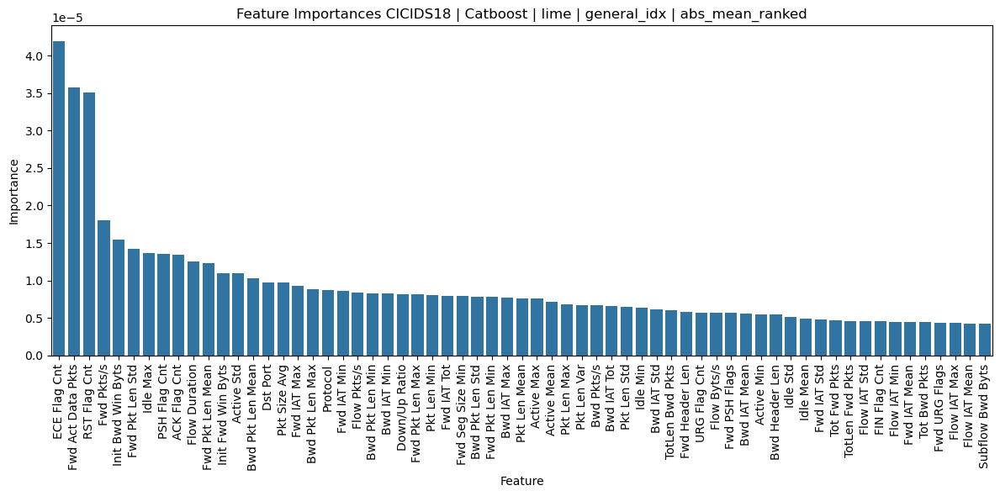

cicids18_CatBoost_shap_kernel_explanations_feature_importances.csv


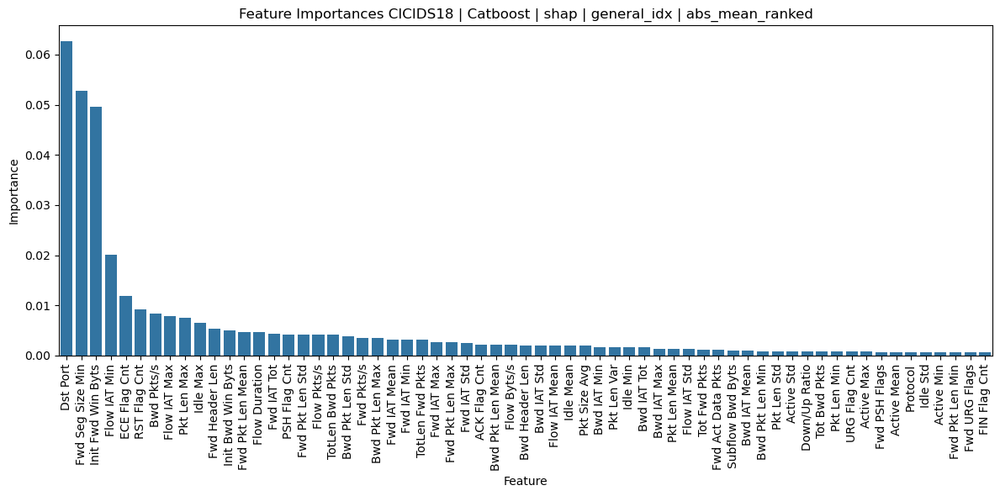

cicids18_RandomForest_lime_explanations_feature_importances.csv


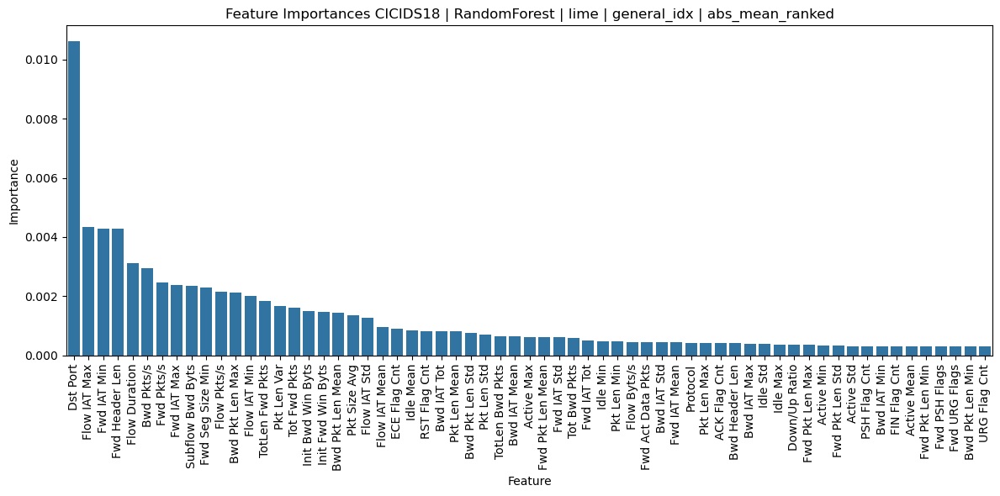

cicids18_RandomForest_shap_kernel_explanations_feature_importances.csv


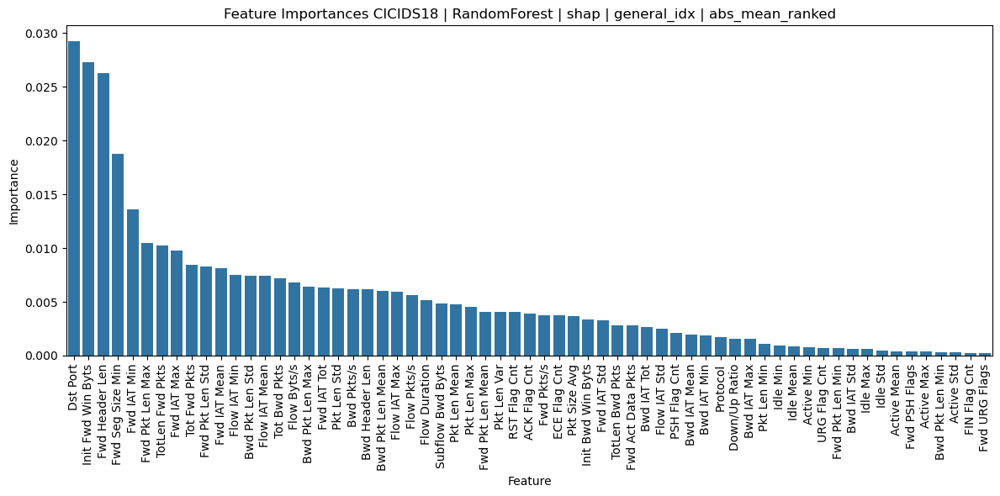

cicids18_XGBoost_lime_explanations_feature_importances.csv


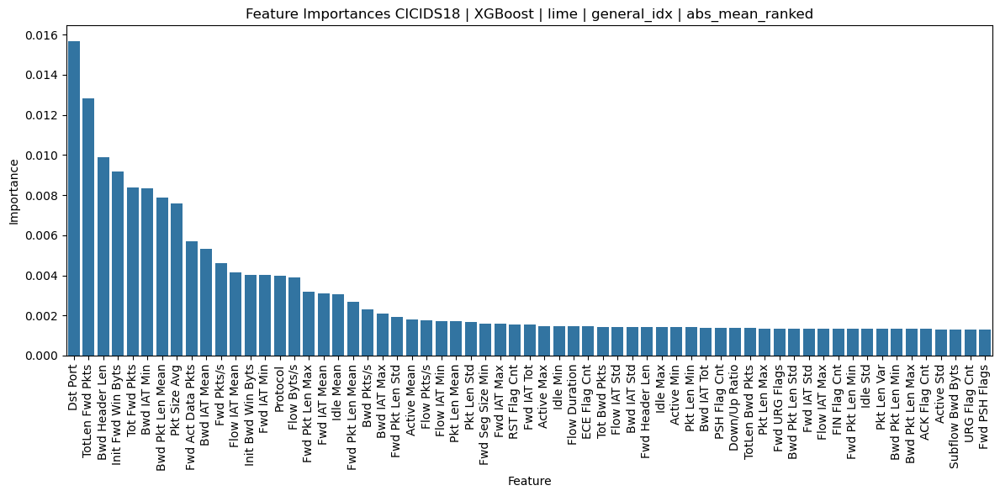

cicids18_XGBoost_shap_kernel_explanations_feature_importances.csv


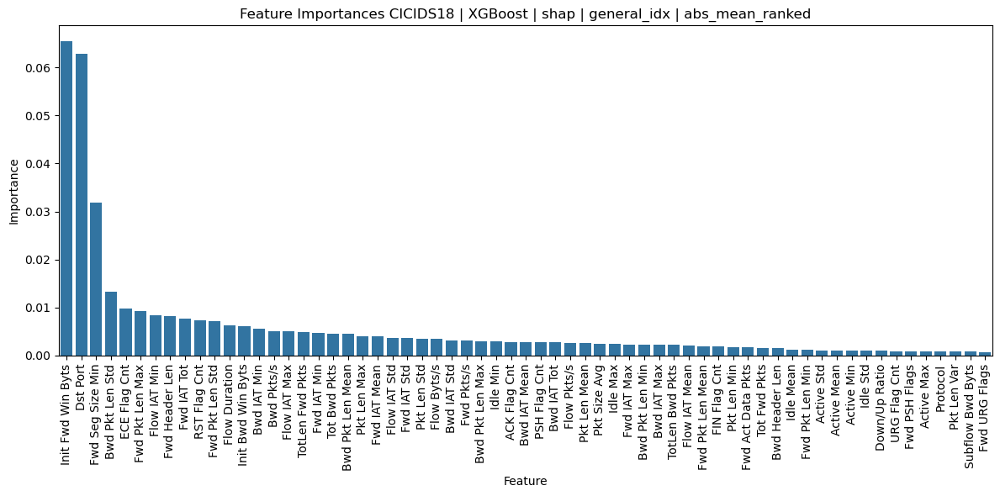

In [9]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

directory = 'metrics/descriptive_accuracy/'
all_files = os.listdir(directory)

explanations = sorted([
    f for f in all_files
    if os.path.isfile(os.path.join(directory, f)) and "feature_importances" in f
])

for file in explanations:
    print(file)
    # Read CSV using full path
    df = pd.read_csv(os.path.join(directory, file))

    if "lime" in file.lower():
        explainer = "lime"
    elif "shap" in file.lower():
        explainer = "shap"

    if "cicids17" in file.lower():
        dataset_name = "CICIDS17"
    elif "cicids18" in file.lower():
        dataset_name = "CICIDS18"

    if "randomforest" in file.lower() or "rf" in file.lower():
        model_name = "RandomForest"
    elif "xgboost" in file.lower() or "xgb" in file.lower():
        model_name = "XGBoost"
    elif "catboost" in file.lower():
        model_name = "Catboost"

    plt.figure(figsize=(12, 6))
    sns.barplot(
        x='feature',
        y='importance',
        data=df,
        #color='skyblue'
    )

    plt.xlabel('Feature')
    plt.ylabel('Importance')
    plt.title(f'Feature Importances {dataset_name} | {model_name} | {explainer} | general_idx | abs_mean_ranked')
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()


In [8]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

directory = 'metrics/descriptive_accuracy/'
all_files = os.listdir(directory)
explanations = sorted([
    f for f in all_files
    if os.path.isfile(os.path.join(directory, f)) and "feature_importances" in f
])

def parse_dataset(f):
    f = f.lower()
    if "cicids17" in f:
        return "cicids17"
    elif "cicids18" in f:
        return "cicids18"
    return None

def parse_model(f):
    f = f.lower()
    if "randomforest" in f or "rf" in f:
        return "RandomForest"
    elif "catboost" in f:
        return "CatBoost"
    elif "xgboost" in f or "xgb" in f:
        return "XGBoost"
    return None

def parse_explainer(f):
    f = f.lower()
    if "_lime_" in f:
        return "lime"
    elif "_shap_" in f:
        return "shap"
    return None

print(explanations)

for file in explanations:
        
    df = pd.read_csv(directory + file)

    dataset_name = parse_dataset(file)
    model_name = parse_model(file)
    explainer = parse_explainer(file)
    
    subset = df[
        (df['sample_set'] == "general_idx") &
        (df['run'] == "abs_mean_ranked")
    ]
    
    #print(subset)
    
    plot_df = subset.sort_values('importance', ascending=False)
    
    plt.figure(figsize=(12, 6))
    sns.barplot(
        x='feature',
        y='importance',
        data=plot_df,
        #color='skyblue'
    )
    
    plt.xlabel('Feature')
    plt.ylabel('Importance')
    plt.title(f'Feature Importances {dataset_name} | {model_name} | {explainer} | general_idx | abs_mean_ranked)')
    plt.xticks(rotation=90)
    plt.tight_layout()

    #filename = f"{directory}feature_importances_{dataset_name}_{model_name}_{explainer}_general_idx_abs_mean_ranked.png"
    #plt.savefig(filename, bbox_inches='tight')
    plt.show()
    plt.close()



['Catboost_lime_feature_importances_general_idx.csv', 'Catboost_shap_feature_importances_general_idx.csv', 'RandomForest_lime_feature_importances_general_idx.csv', 'RandomForest_shap_feature_importances_general_idx.csv', 'XGBoost_lime_feature_importances_general_idx.csv', 'XGBoost_shap_feature_importances_general_idx.csv', 'cicids17_Catboost_lime_feature_importances.csv', 'cicids17_RandomForest_lime_feature_importances.csv']


KeyError: 'sample_set'

In [23]:
df1 = pd.read_csv(directory + "cicids17_RandomForest_shap_feature_importances.csv")
df2 = pd.read_csv(directory + "cicids17_RandomForest_lime_feature_importances.csv")
print(df1.info())
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2145 entries, 0 to 2144
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   dataset     2145 non-null   object 
 1   model       2145 non-null   object 
 2   explainer   2145 non-null   object 
 3   sample_set  2145 non-null   object 
 4   run         2145 non-null   object 
 5   feature     2145 non-null   object 
 6   importance  2145 non-null   float64
dtypes: float64(1), object(6)
memory usage: 117.4+ KB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2145 entries, 0 to 2144
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   dataset     2145 non-null   object 
 1   model       2145 non-null   object 
 2   explainer   2145 non-null   object 
 3   sample_set  2145 non-null   object 
 4   run         2145 non-null   object 
 5   feature     2145 non-null   object 
 6   importance  2145 non-null  

# (2) Sparsity

Keep in mind that variables must be normalized (Arreche 0,1/ Warnecke-1,1)

Sparsity= (No. of Features s.t {Feature Score ≤t})/(Total Number of Features)

A fast increase of the sparsity curve at low threshold levels indicates, that most of the features are considered less important by the XAI methods.

## Dataframe Generation

In [7]:
import pandas as pd
from ast import literal_eval
from sklearn.preprocessing import MinMaxScaler
from collections import defaultdict
import numpy as np
import os
from datetime import datetime

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

directory = 'explanation_data/'
all_files = os.listdir(directory)
explanations = sorted([f for f in all_files if os.path.isfile(os.path.join(directory, f))])
random_state = 42

samplesets = ["general_idx", "true_idx", "false_idx"]
thresholds = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

def parse_dataset(f):
    f = f.lower()
    if "cicids17" in f:
        return "cicids17"
    elif "cicids18" in f:
        return "cicids18"
    return None

def parse_model(f):
    f = f.lower()
    if "randomforest" in f or "rf" in f:
        return "RandomForest"
    elif "catboost" in f:
        return "CatBoost"
    elif "xgboost" in f or "xgb" in f:
        return "XGBoost"
    return None

def parse_explainer(f):
    f = f.lower()
    if "lime" in f:
        return "lime"
    elif "shap" in f:
        return "shap"
    return None

result_rows = []

print("Available explanation files:")
for f in explanations:
    print(directory + f)
print("\nStarting Analysis")

for f in explanations[:1]:
    if "ind" in f:
        continue
    else:
        print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Processing file: {f}")
        df = pd.read_csv(os.path.join(directory, f), index_col=0)
        dataset = parse_dataset(f)
        model = parse_model(f)
        explainer_ = parse_explainer(f)
        
        for sampleset in samplesets[:1]:
            
            for run in df['run_nr'].unique()[:1]:
                run_df = df[(df['run_nr'] == run) & (df['sample_set'] == sampleset)]
                #print(run_df.head())
                
                for i in range(len(run_df))[:1]:
                    idx = run_df.iloc[i]['idx']
                    feature_tuples = literal_eval(run_df.iloc[i]['feature_value_pairs'])
                    features = [ft[0] for ft in feature_tuples]
                    #[print(_) for _ in feature_tuples]
    
                    
                    # Absolute values 
                    abs_values = [abs(ft[1]) for ft in feature_tuples]                
                    #print(abs_values)
                    
    
                    # Normalize with MinMaxScaler
                    abs_values = np.array(abs_values).reshape(-1, 1)
                    scaler = MinMaxScaler(feature_range=(0, 1))
                    norm_values = scaler.fit_transform(abs_values).flatten()
                    print(sorted(norm_values, reverse=True))
                    
                    # Calculate sparsity per threshold
                    threshold_results = {}
                    for t in thresholds:
                        sparsity = np.sum(norm_values <= t) / len(norm_values)
                        print(t)
                        print(norm_values <= t)
                        #print(sparsity)
                        threshold_results[f't_{t:.1f}'] = sparsity
    
                    row_dict = {
                        "dataset": dataset,
                        "classifier": model,
                        "explainer": explainer_,
                        "sample_set": sampleset,
                        "run_nr": run,
                        "idx": idx
                    }
                    row_dict.update(threshold_results)
                    result_rows.append(row_dict)

result_df = pd.DataFrame(result_rows)
print("Final result DataFrame shape:", result_df.shape)

# Save
#result_df.to_csv("metrics/sparsity/sparsity_over_all_idx_all_runs.csv", index=False)
#result_df.to_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
#print("DF saved to metrics/sparsity_over_all_idx_all_runs.parquet\n")

print(result_df)

Available explanation files:
explanation_data/cicids17_CatBoost_lime_explanations.csv
explanation_data/cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
explanation_data/cicids17_RandomForest_lime_explanations.csv
explanation_data/cicids17_RandomForest_shap_kernel_smoothed_explanations.csv
explanation_data/cicids17_XGBoost_lime_explanations.csv
explanation_data/cicids17_XGBoost_shap_kernel_smoothed_explanations.csv
explanation_data/cicids18_CatBoost_lime_explanations.csv
explanation_data/cicids18_CatBoost_shap_kernel_explanations.csv
explanation_data/cicids18_RandomForest_lime_explanations.csv
explanation_data/cicids18_RandomForest_shap_kernel_explanations.csv
explanation_data/cicids18_XGBoost_lime_explanations.csv
explanation_data/cicids18_XGBoost_shap_kernel_explanations.csv

Starting Analysis
[2025-08-28 09:46:30] Processing file: cicids17_CatBoost_lime_explanations.csv
[1.0, 0.37537423068678544, 0.3218120908019559, 0.2964612429598772, 0.2923928734986945, 0.27713758001330324, 

In [17]:
import pandas as pd
from ast import literal_eval
from sklearn.preprocessing import MinMaxScaler
from collections import defaultdict
import numpy as np
import os
from datetime import datetime

directory = 'explanation_data/'
all_files = os.listdir(directory)
explanations = sorted([f for f in all_files if os.path.isfile(os.path.join(directory, f))])
random_state = 42

samplesets = ["general_idx", "true_idx", "false_idx"]
thresholds = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

def parse_dataset(f):
    f = f.lower()
    if "cicids17" in f:
        return "cicids17"
    elif "cicids18" in f:
        return "cicids18"
    return None

def parse_model(f):
    f = f.lower()
    if "randomforest" in f or "rf" in f:
        return "RandomForest"
    elif "catboost" in f:
        return "CatBoost"
    elif "xgboost" in f or "xgb" in f:
        return "XGBoost"
    return None

def parse_explainer(f):
    f = f.lower()
    if "lime" in f:
        return "lime"
    elif "shap" in f:
        return "shap"
    return None

result_rows = []

print("Available explanation files:")
for f in explanations:
    print(directory + f)
print("\nStarting Analysis")

for f in explanations:
    if "ind" in f:
        continue
    else:
        print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Processing file: {f}")
        df = pd.read_csv(os.path.join(directory, f), index_col=0)
        dataset = parse_dataset(f)
        model = parse_model(f)
        explainer_ = parse_explainer(f)
        
        for sampleset in samplesets:
            
            for run in df['run_nr'].unique():
                run_df = df[(df['run_nr'] == run) & (df['sample_set'] == sampleset)]
                #print(run_df.head())
                
                for i in range(len(run_df)):
                    idx = run_df.iloc[i]['idx']
                    feature_tuples = literal_eval(run_df.iloc[i]['feature_value_pairs'])
                    features = [ft[0] for ft in feature_tuples]
                    #[print(_) for _ in feature_tuples[:5]]
    
                    
                    # Absolute values 
                    abs_values = [abs(ft[1]) for ft in feature_tuples]                
                    #print(abs_values)
                    
    
                    # Normalize with MinMaxScaler
                    abs_values = np.array(abs_values).reshape(-1, 1)
                    scaler = MinMaxScaler(feature_range=(0, 1))
                    norm_values = scaler.fit_transform(abs_values).flatten()
                    #print(norm_values)
                    
                    # Calculate sparsity per threshold
                    threshold_results = {}
                    for t in thresholds:
                        sparsity = np.sum(norm_values <= t) / len(norm_values)
                        #print(t)
                        #print(norm_values <= t)
                        #print(sparsity)
                        threshold_results[f't_{t:.1f}'] = sparsity
    
                    row_dict = {
                        "dataset": dataset,
                        "classifier": model,
                        "explainer": explainer_,
                        "sample_set": sampleset,
                        "run_nr": run,
                        "idx": idx
                    }
                    row_dict.update(threshold_results)
                    result_rows.append(row_dict)

result_df = pd.DataFrame(result_rows)
print("Final result DataFrame shape:", result_df.shape)

# Save
#result_df.to_csv("metrics/sparsity/sparsity_over_all_idx_all_runs.csv", index=False)
#result_df.to_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
print("DF saved to metrics/sparsity_over_all_idx_all_runs.parquet\n")

print(result_df.head(10))

Available explanation files:
explanation_data/cicids17_CatBoost_lime_explanations.csv
explanation_data/cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
explanation_data/cicids17_RandomForest_lime_explanations.csv
explanation_data/cicids17_RandomForest_shap_kernel_smoothed_explanations.csv
explanation_data/cicids17_XGBoost_lime_explanations.csv
explanation_data/cicids17_XGBoost_shap_kernel_smoothed_explanations.csv
explanation_data/cicids18_CatBoost_lime_explanations.csv
explanation_data/cicids18_CatBoost_shap_kernel_explanations.csv
explanation_data/cicids18_RandomForest_lime_explanations.csv
explanation_data/cicids18_RandomForest_shap_kernel_explanations.csv
explanation_data/cicids18_XGBoost_lime_explanations.csv
explanation_data/cicids18_XGBoost_shap_kernel_explanations.csv

Starting Analysis
[2025-08-27 19:23:44] Processing file: cicids17_CatBoost_lime_explanations.csv
[2025-08-27 19:24:28] Processing file: cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
[2025-08-27 1

In [11]:
import pandas as pd

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
df[(df['sample_set'] == 'general_idx')]

,dataset,classifier,explainer,sample_set,run_nr,idx,t_0.0,t_0.1,t_0.2,t_0.3,t_0.4,t_0.5,t_0.6,t_0.7,t_0.8,t_0.9,t_1.0
0,cicids17,CatBoost,lime,general_idx,1,363001,0.015385,0.630769,0.861538,0.953846,0.984615,0.984615,0.984615,0.984615,0.984615,0.984615,1.0
1,cicids17,CatBoost,lime,general_idx,1,110929,0.015385,0.584615,0.846154,0.923077,0.953846,0.984615,0.984615,0.984615,0.984615,0.984615,1.0
2,cicids17,CatBoost,lime,general_idx,1,150433,0.015385,0.630769,0.861538,0.938462,0.984615,0.984615,0.984615,0.984615,0.984615,0.984615,1.0
3,cicids17,CatBoost,lime,general_idx,1,484275,0.015385,0.630769,0.876923,0.953846,0.969231,0.984615,0.984615,0.984615,0.984615,0.984615,1.0
4,cicids17,CatBoost,lime,general_idx,1,87398,0.015385,0.538462,0.830769,0.923077,0.969231,0.984615,0.984615,0.984615,0.984615,0.984615,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
328695,cicids18,XGBoost,shap,general_idx,10,652841,0.571429,0.873016,0.920635,0.936508,0.952381,0.968254,0.968254,0.968254,0.968254,0.984127,1.0
328696,cicids18,XGBoost,shap,general_idx,10,4173862,0.841270,0.952381,0.952381,0.952381,0.952381,0.952381,0.952381,0.968254,0.968254,0.968254,1.0
328697,cicids18,XGBoost,shap,general_idx,10,3824901,0.190476,0.888889,0.952381,0.952381,0.968254,0.984127,0.984127,0.984127,0.984127,0.984127,1.0
328698,cicids18,XGBoost,shap,general_idx,10,3138884,0.111111,0.571429,0.809524,0.904762,0.936508,0.952381,0.968254,0.968254,0.984127,0.984127,1.0


### Compute Means

In [20]:
import pandas as pd
from functools import reduce

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")

runs = sorted(df['run_nr'].unique())
datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()
explainers = df['explainer'].unique()
sample_sets = ['general_idx', 'true_idx', 'false_idx']
threshold_cols = [col for col in df.columns if col.startswith('t_')]

all_dfs = []

for classifier in classifiers:
    for dataset in datasets:
        for explainer in explainers:
            mean_dfs_by_sample_set = {}

            for sample_set in sample_sets:
                mean_dfs = []
                for run in runs:
                    df_subset = df[
                        (df['dataset'] == dataset) &
                        (df['classifier'] == classifier) &
                        (df['explainer'] == explainer) &
                        (df['sample_set'] == sample_set) &
                        (df['run_nr'] == run)
                    ]

                    mean_values = df_subset[threshold_cols].mean().reset_index()
                    mean_values.columns = ['threshold_col', f'{sample_set}_run_{run}']
                    mean_values['threshold'] = mean_values['threshold_col'].str.removeprefix('t_')
                    mean_dfs.append(mean_values[[f'{sample_set}_run_{run}', 'threshold']])

                if mean_dfs:
                    df_sample_merged = reduce(lambda left, right: pd.merge(left, right, on='threshold'), mean_dfs)
                    mean_dfs_by_sample_set[sample_set] = df_sample_merged
                else:
                    mean_dfs_by_sample_set[sample_set] = pd.DataFrame()

            dfs_to_merge = [df_ for df_ in mean_dfs_by_sample_set.values() if not df_.empty]
            if not dfs_to_merge:
                continue
            df_final = reduce(lambda left, right: pd.merge(left, right, on='threshold'), dfs_to_merge)

            df_final['dataset'] = dataset
            df_final['classifier'] = classifier
            df_final['explainer'] = explainer

            id_cols = ['dataset', 'classifier', 'explainer', 'threshold']
            run_cols = []
            for sset in sample_sets:
                run_cols.extend([col for col in df_final.columns if col.startswith(f'{sset}_run_')])

            for sset in sample_sets:
                cols_for_mean = [col for col in df_final.columns if col.startswith(f'{sset}_run_')]
                if cols_for_mean:
                    df_final[f'{sset.split("_")[0]}_mean'] = df_final[cols_for_mean].mean(axis=1)
                else:
                    df_final[f'{sset.split("_")[0]}_mean'] = pd.NA

            cols = id_cols + run_cols + [f'{sset.split("_")[0]}_mean' for sset in sample_sets]
            df_final = df_final[cols]

            all_dfs.append(df_final)

df_all = pd.concat(all_dfs, ignore_index=True)
df_all.to_csv("metrics/sparsity/sparsity_means_all_runs.csv", index=False)
df_all.head(30)


,dataset,classifier,explainer,threshold,general_idx_run_1,general_idx_run_2,general_idx_run_3,general_idx_run_4,general_idx_run_5,general_idx_run_6,general_idx_run_7,general_idx_run_8,general_idx_run_9,general_idx_run_10,true_idx_run_1,true_idx_run_2,true_idx_run_3,true_idx_run_4,true_idx_run_5,true_idx_run_6,true_idx_run_7,true_idx_run_8,true_idx_run_9,true_idx_run_10,false_idx_run_1,false_idx_run_2,false_idx_run_3,false_idx_run_4,false_idx_run_5,false_idx_run_6,false_idx_run_7,false_idx_run_8,false_idx_run_9,false_idx_run_10,general_mean,true_mean,false_mean
0,cicids17,CatBoost,lime,0.0,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385
1,cicids17,CatBoost,lime,0.1,0.548985,0.544985,0.548908,0.544492,0.546662,0.544769,0.551862,0.542754,0.548985,0.541908,0.545154,0.542877,0.545908,0.543000,0.543923,0.548354,0.547108,0.542062,0.542462,0.542646,0.508255,0.506285,0.520221,0.512539,0.501900,0.509502,0.511574,0.515636,0.513826,0.511594,0.546431,0.544349,0.511133
2,cicids17,CatBoost,lime,0.2,0.807123,0.807246,0.804415,0.800385,0.806446,0.800477,0.807985,0.803508,0.805200,0.800585,0.803185,0.802523,0.804631,0.798646,0.800231,0.804846,0.805246,0.804015,0.800738,0.802092,0.776491,0.776792,0.786043,0.783047,0.773112,0.778824,0.777838,0.783389,0.784032,0.779708,0.804337,0.802615,0.779928
3,cicids17,CatBoost,lime,0.3,0.902415,0.902508,0.901015,0.897708,0.902123,0.899554,0.904185,0.899538,0.901492,0.897723,0.900338,0.899108,0.901277,0.898200,0.898631,0.900938,0.901738,0.899615,0.898015,0.897754,0.895063,0.893776,0.900372,0.900995,0.894299,0.895686,0.896812,0.899105,0.900593,0.896853,0.900826,0.899562,0.897355
4,cicids17,CatBoost,lime,0.4,0.951969,0.951662,0.950846,0.948031,0.950892,0.949138,0.951708,0.950108,0.951338,0.948338,0.949769,0.949169,0.950954,0.947523,0.947815,0.950492,0.950215,0.949292,0.948123,0.948031,0.948999,0.948195,0.953444,0.953484,0.947069,0.950126,0.949422,0.950789,0.953283,0.951574,0.950403,0.949138,0.950639
5,cicids17,CatBoost,lime,0.5,0.974585,0.975385,0.974585,0.972708,0.974585,0.973231,0.974846,0.973862,0.973985,0.972262,0.973785,0.972908,0.974492,0.971308,0.972585,0.974538,0.974000,0.973554,0.972062,0.972523,0.973233,0.972650,0.976652,0.976672,0.972187,0.974178,0.973072,0.974962,0.975747,0.975244,0.974003,0.973175,0.974460
6,cicids17,CatBoost,lime,0.6,0.981031,0.981246,0.980554,0.979738,0.980400,0.980292,0.980938,0.980123,0.980631,0.979738,0.980462,0.980123,0.981077,0.979231,0.979815,0.981031,0.980692,0.979908,0.979508,0.979846,0.979930,0.979165,0.981277,0.981699,0.978743,0.980332,0.979467,0.981056,0.981056,0.980935,0.980469,0.980169,0.980366
7,cicids17,CatBoost,lime,0.7,0.982969,0.983292,0.982908,0.982154,0.982708,0.982615,0.982892,0.982585,0.982892,0.982308,0.982585,0.982277,0.982908,0.981985,0.982446,0.983123,0.982738,0.982323,0.982200,0.982415,0.982162,0.981699,0.983007,0.983107,0.981579,0.982423,0.981961,0.982805,0.982966,0.982765,0.982732,0.982500,0.982447
8,cicids17,CatBoost,lime,0.8,0.983923,0.983923,0.983785,0.983508,0.983785,0.983646,0.983785,0.983569,0.983985,0.983400,0.983600,0.983554,0.983862,0.983554,0.983477,0.983923,0.983677,0.983492,0.983477,0.983554,0.983188,0.982886,0.983771,0.983791,0.983067,0.983369,0.983429,0.983610,0.983690,0.983831,0.983731,0.983617,0.983463
9,cicids17,CatBoost,lime,0.9,0.984431,0.984415,0.984354,0.984108,0.984308,0.984246,0.984308,0.984200,0.984385,0.984154,0.984277,0.984292,0.984385,0.984231,0.984231,0.984354,0.984215,0.984262,0.984215,0.984292,0.984113,0.983992,0.984294,0.984294,0.984173,0.984213,0.984173,0.984274,0.984233,0.984334,0.984291,0.984275,0.984209


In [21]:
import pandas as pd

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df_all = pd.read_csv("metrics/sparsity/sparsity_means_all_runs.csv")
columns = ["dataset", "classifier", "explainer", "threshold", "general_mean", "true_mean", "false_mean"]
mean_sparsity = df_all[columns]
print(mean_sparsity.shape)
print(mean_sparsity.head())

df_all['t_threshold'] = 't_' + df_all['threshold'].astype(str)

df_pivot = df_all.pivot_table(
    index=['dataset', 'classifier', 'explainer'],
    columns='t_threshold',
    values='general_mean'
).reset_index()

df_pivot.columns.name = None

df_pivot

(132, 7)
    dataset classifier explainer  threshold  general_mean  true_mean  false_mean
0  cicids17   CatBoost      lime        0.0      0.015385   0.015385    0.015385
1  cicids17   CatBoost      lime        0.1      0.546431   0.544349    0.511133
2  cicids17   CatBoost      lime        0.2      0.804337   0.802615    0.779928
3  cicids17   CatBoost      lime        0.3      0.900826   0.899562    0.897355
4  cicids17   CatBoost      lime        0.4      0.950403   0.949138    0.950639


,dataset,classifier,explainer,t_0.0,t_0.1,t_0.2,t_0.3,t_0.4,t_0.5,t_0.6,t_0.7,t_0.8,t_0.9,t_1.0
0,cicids17,CatBoost,lime,0.015385,0.546431,0.804337,0.900826,0.950403,0.974003,0.980469,0.982732,0.983731,0.984291,0.998029
1,cicids17,CatBoost,shap,0.293597,0.831663,0.918529,0.947572,0.962277,0.970809,0.975920,0.978846,0.981031,0.982942,1.000000
2,cicids17,RandomForest,lime,0.015385,0.743843,0.950094,0.971211,0.984372,0.984455,0.984526,0.984551,0.984594,0.984609,0.997958
3,cicids17,RandomForest,shap,0.167026,0.665728,0.817325,0.881363,0.918412,0.941503,0.959208,0.971006,0.977842,0.981714,1.000000
4,cicids17,XGBoost,lime,0.015385,0.258915,0.474420,0.645077,0.768349,0.850728,0.904291,0.938572,0.961008,0.975352,0.998038
5,cicids17,XGBoost,shap,0.357515,0.810300,0.905788,0.941895,0.958735,0.968845,0.974994,0.978774,0.980671,0.982640,1.000000
6,cicids18,CatBoost,lime,0.015873,0.417010,0.688857,0.836160,0.905868,0.938560,0.955581,0.966143,0.973916,0.979632,0.998027
7,cicids18,CatBoost,shap,0.296092,0.832932,0.918078,0.945237,0.958452,0.966559,0.972513,0.977300,0.980608,0.982705,1.000000
8,cicids18,RandomForest,lime,0.015873,0.631549,0.826859,0.923641,0.957265,0.983416,0.984029,0.984063,0.984079,0.984121,0.998090
9,cicids18,RandomForest,shap,0.211010,0.646484,0.805914,0.880279,0.919413,0.941446,0.955837,0.966671,0.974929,0.980308,1.000000


In [22]:
df_all.head(20)

,dataset,classifier,explainer,threshold,general_idx_run_1,general_idx_run_2,general_idx_run_3,general_idx_run_4,general_idx_run_5,general_idx_run_6,general_idx_run_7,general_idx_run_8,general_idx_run_9,general_idx_run_10,true_idx_run_1,true_idx_run_2,true_idx_run_3,true_idx_run_4,true_idx_run_5,true_idx_run_6,true_idx_run_7,true_idx_run_8,true_idx_run_9,true_idx_run_10,false_idx_run_1,false_idx_run_2,false_idx_run_3,false_idx_run_4,false_idx_run_5,false_idx_run_6,false_idx_run_7,false_idx_run_8,false_idx_run_9,false_idx_run_10,general_mean,true_mean,false_mean,t_threshold
0,cicids17,CatBoost,lime,0.0,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,t_0.0
1,cicids17,CatBoost,lime,0.1,0.548985,0.544985,0.548908,0.544492,0.546662,0.544769,0.551862,0.542754,0.548985,0.541908,0.545154,0.542877,0.545908,0.543000,0.543923,0.548354,0.547108,0.542062,0.542462,0.542646,0.508255,0.506285,0.520221,0.512539,0.501900,0.509502,0.511574,0.515636,0.513826,0.511594,0.546431,0.544349,0.511133,t_0.1
2,cicids17,CatBoost,lime,0.2,0.807123,0.807246,0.804415,0.800385,0.806446,0.800477,0.807985,0.803508,0.805200,0.800585,0.803185,0.802523,0.804631,0.798646,0.800231,0.804846,0.805246,0.804015,0.800738,0.802092,0.776491,0.776792,0.786043,0.783047,0.773112,0.778824,0.777838,0.783389,0.784032,0.779708,0.804337,0.802615,0.779928,t_0.2
3,cicids17,CatBoost,lime,0.3,0.902415,0.902508,0.901015,0.897708,0.902123,0.899554,0.904185,0.899538,0.901492,0.897723,0.900338,0.899108,0.901277,0.898200,0.898631,0.900938,0.901738,0.899615,0.898015,0.897754,0.895063,0.893776,0.900372,0.900995,0.894299,0.895686,0.896812,0.899105,0.900593,0.896853,0.900826,0.899562,0.897355,t_0.3
4,cicids17,CatBoost,lime,0.4,0.951969,0.951662,0.950846,0.948031,0.950892,0.949138,0.951708,0.950108,0.951338,0.948338,0.949769,0.949169,0.950954,0.947523,0.947815,0.950492,0.950215,0.949292,0.948123,0.948031,0.948999,0.948195,0.953444,0.953484,0.947069,0.950126,0.949422,0.950789,0.953283,0.951574,0.950403,0.949138,0.950639,t_0.4
5,cicids17,CatBoost,lime,0.5,0.974585,0.975385,0.974585,0.972708,0.974585,0.973231,0.974846,0.973862,0.973985,0.972262,0.973785,0.972908,0.974492,0.971308,0.972585,0.974538,0.974000,0.973554,0.972062,0.972523,0.973233,0.972650,0.976652,0.976672,0.972187,0.974178,0.973072,0.974962,0.975747,0.975244,0.974003,0.973175,0.974460,t_0.5
6,cicids17,CatBoost,lime,0.6,0.981031,0.981246,0.980554,0.979738,0.980400,0.980292,0.980938,0.980123,0.980631,0.979738,0.980462,0.980123,0.981077,0.979231,0.979815,0.981031,0.980692,0.979908,0.979508,0.979846,0.979930,0.979165,0.981277,0.981699,0.978743,0.980332,0.979467,0.981056,0.981056,0.980935,0.980469,0.980169,0.980366,t_0.6
7,cicids17,CatBoost,lime,0.7,0.982969,0.983292,0.982908,0.982154,0.982708,0.982615,0.982892,0.982585,0.982892,0.982308,0.982585,0.982277,0.982908,0.981985,0.982446,0.983123,0.982738,0.982323,0.982200,0.982415,0.982162,0.981699,0.983007,0.983107,0.981579,0.982423,0.981961,0.982805,0.982966,0.982765,0.982732,0.982500,0.982447,t_0.7
8,cicids17,CatBoost,lime,0.8,0.983923,0.983923,0.983785,0.983508,0.983785,0.983646,0.983785,0.983569,0.983985,0.983400,0.983600,0.983554,0.983862,0.983554,0.983477,0.983923,0.983677,0.983492,0.983477,0.983554,0.983188,0.982886,0.983771,0.983791,0.983067,0.983369,0.983429,0.983610,0.983690,0.983831,0.983731,0.983617,0.983463,t_0.8
9,cicids17,CatBoost,lime,0.9,0.984431,0.984415,0.984354,0.984108,0.984308,0.984246,0.984308,0.984200,0.984385,0.984154,0.984277,0.984292,0.984385,0.984231,0.984231,0.984354,0.984215,0.984262,0.984215,0.984292,0.984113,0.983992,0.984294,0.984294,0.984173,0.984213,0.984173,0.984274,0.984233,0.984334,0.984291,0.984275,0.984209,t_0.9


## Analysis

compare lime vs shap 
analyze if there is a difference between explanations of true vs false metrics

### Comparison LIME vs SHAP general samples

#### Statistical Analysis

In [3]:
import pandas as pd

df = pd.read_csv("metrics/sparsity/sparsity_means_all_runs.csv")
df

,dataset,classifier,explainer,threshold,general_idx_run_1,general_idx_run_2,general_idx_run_3,general_idx_run_4,general_idx_run_5,general_idx_run_6,general_idx_run_7,general_idx_run_8,general_idx_run_9,general_idx_run_10,true_idx_run_1,true_idx_run_2,true_idx_run_3,true_idx_run_4,true_idx_run_5,true_idx_run_6,true_idx_run_7,true_idx_run_8,true_idx_run_9,true_idx_run_10,false_idx_run_1,false_idx_run_2,false_idx_run_3,false_idx_run_4,false_idx_run_5,false_idx_run_6,false_idx_run_7,false_idx_run_8,false_idx_run_9,false_idx_run_10,general_mean,true_mean,false_mean
0,cicids17,CatBoost,lime,0.0,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385,0.015385
1,cicids17,CatBoost,lime,0.1,0.548985,0.544985,0.548908,0.544492,0.546662,0.544769,0.551862,0.542754,0.548985,0.541908,0.545154,0.542877,0.545908,0.543000,0.543923,0.548354,0.547108,0.542062,0.542462,0.542646,0.508255,0.506285,0.520221,0.512539,0.501900,0.509502,0.511574,0.515636,0.513826,0.511594,0.546431,0.544349,0.511133
2,cicids17,CatBoost,lime,0.2,0.807123,0.807246,0.804415,0.800385,0.806446,0.800477,0.807985,0.803508,0.805200,0.800585,0.803185,0.802523,0.804631,0.798646,0.800231,0.804846,0.805246,0.804015,0.800738,0.802092,0.776491,0.776792,0.786043,0.783047,0.773112,0.778824,0.777838,0.783389,0.784032,0.779708,0.804337,0.802615,0.779928
3,cicids17,CatBoost,lime,0.3,0.902415,0.902508,0.901015,0.897708,0.902123,0.899554,0.904185,0.899538,0.901492,0.897723,0.900338,0.899108,0.901277,0.898200,0.898631,0.900938,0.901738,0.899615,0.898015,0.897754,0.895063,0.893776,0.900372,0.900995,0.894299,0.895686,0.896812,0.899105,0.900593,0.896853,0.900826,0.899562,0.897355
4,cicids17,CatBoost,lime,0.4,0.951969,0.951662,0.950846,0.948031,0.950892,0.949138,0.951708,0.950108,0.951338,0.948338,0.949769,0.949169,0.950954,0.947523,0.947815,0.950492,0.950215,0.949292,0.948123,0.948031,0.948999,0.948195,0.953444,0.953484,0.947069,0.950126,0.949422,0.950789,0.953283,0.951574,0.950403,0.949138,0.950639
5,cicids17,CatBoost,lime,0.5,0.974585,0.975385,0.974585,0.972708,0.974585,0.973231,0.974846,0.973862,0.973985,0.972262,0.973785,0.972908,0.974492,0.971308,0.972585,0.974538,0.974000,0.973554,0.972062,0.972523,0.973233,0.972650,0.976652,0.976672,0.972187,0.974178,0.973072,0.974962,0.975747,0.975244,0.974003,0.973175,0.974460
6,cicids17,CatBoost,lime,0.6,0.981031,0.981246,0.980554,0.979738,0.980400,0.980292,0.980938,0.980123,0.980631,0.979738,0.980462,0.980123,0.981077,0.979231,0.979815,0.981031,0.980692,0.979908,0.979508,0.979846,0.979930,0.979165,0.981277,0.981699,0.978743,0.980332,0.979467,0.981056,0.981056,0.980935,0.980469,0.980169,0.980366
7,cicids17,CatBoost,lime,0.7,0.982969,0.983292,0.982908,0.982154,0.982708,0.982615,0.982892,0.982585,0.982892,0.982308,0.982585,0.982277,0.982908,0.981985,0.982446,0.983123,0.982738,0.982323,0.982200,0.982415,0.982162,0.981699,0.983007,0.983107,0.981579,0.982423,0.981961,0.982805,0.982966,0.982765,0.982732,0.982500,0.982447
8,cicids17,CatBoost,lime,0.8,0.983923,0.983923,0.983785,0.983508,0.983785,0.983646,0.983785,0.983569,0.983985,0.983400,0.983600,0.983554,0.983862,0.983554,0.983477,0.983923,0.983677,0.983492,0.983477,0.983554,0.983188,0.982886,0.983771,0.983791,0.983067,0.983369,0.983429,0.983610,0.983690,0.983831,0.983731,0.983617,0.983463
9,cicids17,CatBoost,lime,0.9,0.984431,0.984415,0.984354,0.984108,0.984308,0.984246,0.984308,0.984200,0.984385,0.984154,0.984277,0.984292,0.984385,0.984231,0.984231,0.984354,0.984215,0.984262,0.984215,0.984292,0.984113,0.983992,0.984294,0.984294,0.984173,0.984213,0.984173,0.984274,0.984233,0.984334,0.984291,0.984275,0.984209


In [14]:
# calculation using mean values of runs

import pandas as pd
from scipy.stats import ttest_rel
import numpy as np

df = pd.read_csv("metrics/sparsity/sparsity_means_all_runs.csv")

# Define the columns that contain the run data
run_cols = [f"general_idx_run_{i}" for i in range(1, 11)]

results = []

datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()
thresholds = df['threshold'].unique()

for dataset in datasets:
    for classifier in classifiers:
        for t in thresholds:

            lime_row = df[
                (df['dataset'] == dataset) &
                (df['classifier'] == classifier) &
                (df['threshold'] == t) &
                (df['explainer'].str.lower() == 'lime')
            ]
            
            shap_row = df[
                (df['dataset'] == dataset) &
                (df['classifier'] == classifier) &
                (df['threshold'] == t) &
                (df['explainer'].str.lower() == 'shap')
            ]
            

            if lime_row.empty or shap_row.empty:
                continue

            lime_vals = lime_row[run_cols].values.flatten()
            shap_vals = shap_row[run_cols].values.flatten()
                        
            lime_mean = round(lime_vals.mean(), 5)
            lime_std = round(lime_vals.std(ddof=1), 5) # ddof=1 for sample standard deviation
            lime_var = round(lime_vals.var(ddof=1), 5)
            
            shap_mean = round(shap_vals.mean(), 5)
            shap_std = round(shap_vals.std(ddof=1), 5)
            shap_var = round(shap_vals.var(ddof=1), 5)

            stat, p = ttest_rel(lime_vals, shap_vals)
            
            interpretation = "No significant difference" if p > 0.05 else "Significant difference"
            
            results.append({
                "dataset": dataset,
                "classifier": classifier,
                "sample_set": "general_idx",
                "threshold": t,
                "lime_mean": lime_mean,
                "lime_std": lime_std,
                "lime_var": lime_var,
                "shap_mean": shap_mean,
                "shap_std": shap_std,
                "shap_var": shap_var,
                "ttest_statistic": round(stat, 5),
                "p_value": round(p, 5),
                "interpretation": interpretation
            })


results_df = pd.DataFrame(results)
results_df

#results_df.to_csv("metrics/sparsity/sparsity_ttest_all_idx_all_runs_mean_based.csv", index=False)

,dataset,classifier,sample_set,threshold,lime_mean,lime_std,lime_var,shap_mean,shap_std,shap_var,ttest_statistic,p_value,interpretation
0,cicids17,CatBoost,general_idx,0.0,0.01538,0.00000,0.00000,0.29360,0.01648,0.00027,-53.37153,0.00000,Significant difference
1,cicids17,CatBoost,general_idx,0.1,0.54643,0.00319,0.00001,0.83166,0.04702,0.00221,-19.91488,0.00000,Significant difference
2,cicids17,CatBoost,general_idx,0.2,0.80434,0.00298,0.00001,0.91853,0.02409,0.00058,-15.45381,0.00000,Significant difference
3,cicids17,CatBoost,general_idx,0.3,0.90083,0.00215,0.00000,0.94757,0.01329,0.00018,-11.50386,0.00000,Significant difference
4,cicids17,CatBoost,general_idx,0.4,0.95040,0.00144,0.00000,0.96228,0.00749,0.00006,-5.13539,0.00062,Significant difference
5,cicids17,CatBoost,general_idx,0.5,0.97400,0.00100,0.00000,0.97081,0.00617,0.00004,1.73147,0.11741,No significant difference
6,cicids17,CatBoost,general_idx,0.6,0.98047,0.00052,0.00000,0.97592,0.00490,0.00002,3.03765,0.01407,Significant difference
7,cicids17,CatBoost,general_idx,0.7,0.98273,0.00033,0.00000,0.97885,0.00379,0.00001,3.28967,0.00938,Significant difference
8,cicids17,CatBoost,general_idx,0.8,0.98373,0.00019,0.00000,0.98103,0.00275,0.00001,3.12145,0.01229,Significant difference
9,cicids17,CatBoost,general_idx,0.9,0.98429,0.00011,0.00000,0.98294,0.00136,0.00000,3.17676,0.01124,Significant difference


In [4]:
# sparsity combined over all runs and individual idx
import pandas as pd
from scipy.stats import ttest_rel

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
print(df.head())
thresholds = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
results = []

for dataset in df['dataset'].unique():
    for classifier in df['classifier'].unique():
        for sample_set in df['sample_set'].unique()[:1]: # general_idx
            for t in thresholds:
                col = f"t_{t:.1f}"

                lime_subset = df[
                    (df["dataset"] == dataset) &
                    (df["classifier"] == classifier) &
                    (df["sample_set"] == "general_idx") &
                    #(df["run_nr"] == run) &
                    (df["explainer"].str.lower() == "lime")
                ][['idx', col]].sort_values('idx')

                shap_subset = df[
                    (df["dataset"] == dataset) &
                    (df["classifier"] == classifier) &
                    (df["sample_set"] == "general_idx") &
                    #(df["run_nr"] == run) &
                    (df["explainer"].str.lower() == "shap")
                ][['idx', col]].sort_values('idx')


                lime_vals = lime_subset[col].values
                shap_vals = shap_subset[col].values

                if len(lime_vals) < 2:
                    continue  # Need at least 2 samples for paired test

                lime_mean = round(lime_vals.mean(), 5)
                lime_std = round(lime_vals.std(ddof=1), 5) # Bessel’s correction for sample sizes
                lime_var  = round(lime_vals.var(ddof=1), 5)
                
                shap_mean = round(shap_vals.mean(), 5)
                shap_std = round(shap_vals.std(ddof=1), 5)
                shap_var  = round(shap_vals.var(ddof=1), 5)

                stat, p = ttest_rel(lime_vals, shap_vals)
                interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                results.append({
                    "dataset": dataset,
                    "classifier": classifier,
                    "sample_set": sample_set,
                    #"run_nr": run,
                    "threshold": t,
                    "lime_mean": lime_mean,
                    "lime_std": lime_std,
                    "lime_var": lime_var,
                    "shap_mean": shap_mean,
                    "shap_std": shap_std,
                    "shap_var": shap_var,
                    "ttest_statistic": round(stat, 5),
                    "p_value": round(p, 5),
                    "interpretation": interpretation
                })

results_df = pd.DataFrame(results)
#print(results_df)

#results_df.to_csv("metrics/sparsity/sparsity_ttest_all_idx_all_runs.csv", index=False)
results_df

    dataset classifier explainer   sample_set  run_nr     idx     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9  t_1.0
0  cicids17   CatBoost      lime  general_idx       1  363001  0.015385  0.630769  0.861538  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
1  cicids17   CatBoost      lime  general_idx       1  110929  0.015385  0.584615  0.846154  0.923077  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
2  cicids17   CatBoost      lime  general_idx       1  150433  0.015385  0.630769  0.861538  0.938462  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
3  cicids17   CatBoost      lime  general_idx       1  484275  0.015385  0.630769  0.876923  0.953846  0.969231  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
4  cicids17   CatBoost      lime  general_idx       1   87398  0.015385  0.538462  0.830769  0.923077  0.969231  0.984615  0.984615  0.984615  0.984615  0.

,dataset,classifier,sample_set,threshold,lime_mean,lime_std,lime_var,shap_mean,shap_std,shap_var,ttest_statistic,p_value,interpretation
0,cicids17,CatBoost,general_idx,0.0,0.01538,0.00000,0.00000,0.29360,0.11765,0.01384,-236.48103,0.0,Significant difference
1,cicids17,CatBoost,general_idx,0.1,0.54643,0.11155,0.01244,0.83166,0.10793,0.01165,-183.12923,0.0,Significant difference
2,cicids17,CatBoost,general_idx,0.2,0.80434,0.10135,0.01027,0.91853,0.05917,0.00350,-97.39019,0.0,Significant difference
3,cicids17,CatBoost,general_idx,0.3,0.90083,0.07061,0.00499,0.94757,0.03637,0.00132,-58.98580,0.0,Significant difference
4,cicids17,CatBoost,general_idx,0.4,0.95040,0.04965,0.00247,0.96228,0.02393,0.00057,-21.63833,0.0,Significant difference
5,cicids17,CatBoost,general_idx,0.5,0.97400,0.03190,0.00102,0.97081,0.01795,0.00032,8.76843,0.0,Significant difference
6,cicids17,CatBoost,general_idx,0.6,0.98047,0.01925,0.00037,0.97592,0.01387,0.00019,19.23581,0.0,Significant difference
7,cicids17,CatBoost,general_idx,0.7,0.98273,0.01113,0.00012,0.97885,0.01099,0.00012,24.77307,0.0,Significant difference
8,cicids17,CatBoost,general_idx,0.8,0.98373,0.00610,0.00004,0.98103,0.00837,0.00007,25.95673,0.0,Significant difference
9,cicids17,CatBoost,general_idx,0.9,0.98429,0.00295,0.00001,0.98294,0.00547,0.00003,21.72063,0.0,Significant difference


In [10]:
# sparsity per run and individual idx
import pandas as pd
from scipy.stats import ttest_rel

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
thresholds = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
results = []

for dataset in df['dataset'].unique():
    for classifier in df['classifier'].unique():
        for sample_set in df['sample_set'].unique()[:1]:  # general_idx
            for run in df['run_nr'].unique():
                for t in thresholds:
                    col = f"t_{t:.1f}"
                    lime_subset = df[
                        (df["dataset"] == dataset) &
                        (df["classifier"] == classifier) &
                        (df["sample_set"] == sample_set) &
                        (df["run_nr"] == run) &
                        (df["explainer"].str.lower() == "lime")
                    ][['idx', col]].sort_values('idx')
                    shap_subset = df[
                        (df["dataset"] == dataset) &
                        (df["classifier"] == classifier) &
                        (df["sample_set"] == sample_set) &
                        (df["run_nr"] == run) &
                        (df["explainer"].str.lower() == "shap")
                    ][['idx', col]].sort_values('idx')
                    
                    lime_vals = lime_subset[col].values
                    shap_vals = shap_subset[col].values
                    if len(lime_vals) < 2:
                        continue  # Need at least 2 samples for paired test
                    
                    lime_mean = round(lime_vals.mean(), 5)
                    lime_std = round(lime_vals.std(ddof=1), 5)  # Bessel’s correction for sample sizes
                    lime_var = round(lime_vals.var(ddof=1), 5)
                    
                    shap_mean = round(shap_vals.mean(), 5)
                    shap_std = round(shap_vals.std(ddof=1), 5)
                    shap_var = round(shap_vals.var(ddof=1), 5)
                    
                    stat, p = ttest_rel(lime_vals, shap_vals)
                    interpretation = "No significant difference" if p > 0.05 else "Significant difference"
                    
                    results.append({
                        "dataset": dataset,
                        "classifier": classifier,
                        "sample_set": sample_set,
                        "run_nr": run,
                        "threshold": t,
                        "lime_mean": lime_mean,
                        "lime_std": lime_std,
                        "lime_var": lime_var,
                        "shap_mean": shap_mean,
                        "shap_std": shap_std,
                        "shap_var": shap_var,
                        "ttest_statistic": round(stat, 5),
                        "p_value": round(p, 5),
                        "interpretation": interpretation
                    })

results_df = pd.DataFrame(results)
results_df.to_csv("metrics/sparsity/sparsity_ttest_metrics_all_runs.csv", index=False)
results_df


,dataset,classifier,sample_set,run_nr,threshold,lime_mean,lime_std,lime_var,shap_mean,shap_std,shap_var,ttest_statistic,p_value,interpretation
0,cicids17,CatBoost,general_idx,1,0.0,0.01538,0.00000,0.00000,0.27149,0.11449,0.01311,-70.73669,0.00000,Significant difference
1,cicids17,CatBoost,general_idx,1,0.1,0.54898,0.11138,0.01241,0.85046,0.08611,0.00742,-66.21768,0.00000,Significant difference
2,cicids17,CatBoost,general_idx,1,0.2,0.80712,0.09735,0.00948,0.93460,0.04099,0.00168,-37.85017,0.00000,Significant difference
3,cicids17,CatBoost,general_idx,1,0.3,0.90242,0.06671,0.00445,0.95478,0.02620,0.00069,-23.17290,0.00000,Significant difference
4,cicids17,CatBoost,general_idx,1,0.4,0.95197,0.04565,0.00208,0.96900,0.01981,0.00039,-10.84775,0.00000,Significant difference
5,cicids17,CatBoost,general_idx,1,0.5,0.97458,0.02961,0.00088,0.97683,0.01444,0.00021,-2.16083,0.03095,Significant difference
6,cicids17,CatBoost,general_idx,1,0.6,0.98103,0.01741,0.00030,0.97985,0.01075,0.00012,1.84022,0.06603,No significant difference
7,cicids17,CatBoost,general_idx,1,0.7,0.98297,0.00990,0.00010,0.98152,0.00812,0.00007,3.55830,0.00039,Significant difference
8,cicids17,CatBoost,general_idx,1,0.8,0.98392,0.00540,0.00003,0.98302,0.00527,0.00003,3.77893,0.00017,Significant difference
9,cicids17,CatBoost,general_idx,1,0.9,0.98443,0.00217,0.00000,0.98398,0.00305,0.00001,3.73706,0.00020,Significant difference


In [10]:
#sparsity for a single run

import pandas as pd
from scipy.stats import ttest_rel

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
thresholds = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
results = []

for dataset in df['dataset'].unique():
    for classifier in df['classifier'].unique():
        for sample_set in df['sample_set'].unique()[:1]: # general_idx
            for run in df['run_nr'].unique()[:1]: # only first run
                for t in thresholds:
                    col = f"t_{t:.1f}"

                    lime_subset = df[
                        (df["dataset"] == dataset) &
                        (df["classifier"] == classifier) &
                        (df["sample_set"] == "general_idx") &
                        (df["run_nr"] == run) &
                        (df["explainer"].str.lower() == "lime")
                    ][['idx', col]].sort_values('idx')

                    shap_subset = df[
                        (df["dataset"] == dataset) &
                        (df["classifier"] == classifier) &
                        (df["sample_set"] == "general_idx") &
                        (df["run_nr"] == run) &
                        (df["explainer"].str.lower() == "shap")
                    ][['idx', col]].sort_values('idx')


                    lime_vals = lime_subset[col].values
                    shap_vals = shap_subset[col].values

                    if len(lime_vals) < 2:
                        continue  # Need at least 2 samples for paired test

                    lime_mean = round(lime_vals.mean(), 5)
                    lime_std = round(lime_vals.std(ddof=1), 5)
                    shap_mean = round(shap_vals.mean(), 5)
                    shap_std = round(shap_vals.std(ddof=1), 5)

                    stat, p = ttest_rel(lime_vals, shap_vals)
                    interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                    results.append({
                        "dataset": dataset,
                        "classifier": classifier,
                        "sample_set": sample_set,
                        "run_nr": run,
                        "threshold": t,
                        "lime_mean": lime_mean,
                        "lime_std": lime_std,
                        "shap_mean": shap_mean,
                        "shap_std": shap_std,
                        "ttest_statistic": round(stat, 5),
                        "p_value": round(p, 5),
                        "interpretation": interpretation
                    })

results_df = pd.DataFrame(results)
#print(results_df)
# To save results
results_df.to_csv("metrics/sparsity/sparsity_ttest_all_idx_single_run.csv", index=False)
results_df

,dataset,classifier,sample_set,run_nr,threshold,lime_mean,lime_std,shap_mean,shap_std,ttest_statistic,p_value,interpretation
0,cicids17,CatBoost,general_idx,1,0.0,0.01538,0.00000,0.27149,0.11449,-70.73669,0.00000,Significant difference
1,cicids17,CatBoost,general_idx,1,0.1,0.54898,0.11138,0.85046,0.08611,-66.21768,0.00000,Significant difference
2,cicids17,CatBoost,general_idx,1,0.2,0.80712,0.09735,0.93460,0.04099,-37.85017,0.00000,Significant difference
3,cicids17,CatBoost,general_idx,1,0.3,0.90242,0.06671,0.95478,0.02620,-23.17290,0.00000,Significant difference
4,cicids17,CatBoost,general_idx,1,0.4,0.95197,0.04565,0.96900,0.01981,-10.84775,0.00000,Significant difference
5,cicids17,CatBoost,general_idx,1,0.5,0.97458,0.02961,0.97683,0.01444,-2.16083,0.03095,Significant difference
6,cicids17,CatBoost,general_idx,1,0.6,0.98103,0.01741,0.97985,0.01075,1.84022,0.06603,No significant difference
7,cicids17,CatBoost,general_idx,1,0.7,0.98297,0.00990,0.98152,0.00812,3.55830,0.00039,Significant difference
8,cicids17,CatBoost,general_idx,1,0.8,0.98392,0.00540,0.98302,0.00527,3.77893,0.00017,Significant difference
9,cicids17,CatBoost,general_idx,1,0.9,0.98443,0.00217,0.98398,0.00305,3.73706,0.00020,Significant difference


#### Visualizations

    dataset    classifier   sample_set explainer     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
0  cicids17      CatBoost  general_idx      lime  0.015385  0.546431  0.804337  0.900826  0.950403  0.974003  0.980469  0.982732  0.983731  0.984291  0.998029
1  cicids17      CatBoost  general_idx      shap  0.293597  0.831663  0.918529  0.947572  0.962277  0.970809  0.975920  0.978846  0.981031  0.982942  1.000000
2  cicids17  RandomForest  general_idx      lime  0.015385  0.743843  0.950094  0.971211  0.984372  0.984455  0.984526  0.984551  0.984594  0.984609  0.997958
3  cicids17  RandomForest  general_idx      shap  0.167026  0.665728  0.817325  0.881363  0.918412  0.941503  0.959208  0.971006  0.977842  0.981714  1.000000
4  cicids17       XGBoost  general_idx      lime  0.015385  0.258915  0.474420  0.645077  0.768349  0.850728  0.904291  0.938572  0.961008  0.975352  0.998038
5  cicids17       XGBoost  general_idx      sh

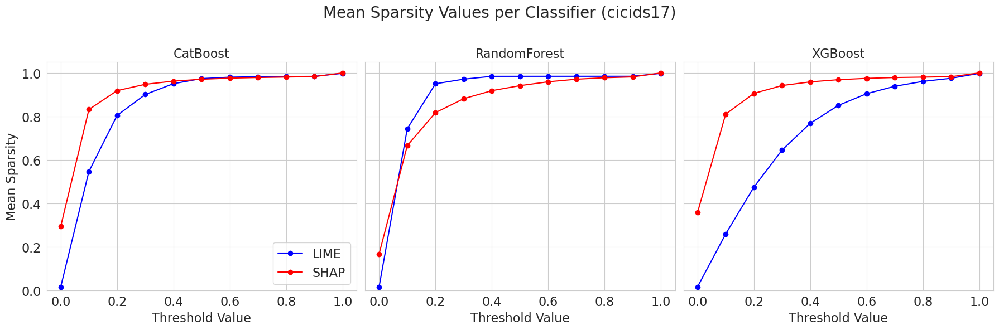

     dataset    classifier   sample_set explainer     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
6   cicids18      CatBoost  general_idx      lime  0.015873  0.417010  0.688857  0.836160  0.905868  0.938560  0.955581  0.966143  0.973916  0.979632  0.998027
7   cicids18      CatBoost  general_idx      shap  0.296092  0.832932  0.918078  0.945237  0.958452  0.966559  0.972513  0.977300  0.980608  0.982705  1.000000
8   cicids18  RandomForest  general_idx      lime  0.015873  0.631549  0.826859  0.923641  0.957265  0.983416  0.984029  0.984063  0.984079  0.984121  0.998090
9   cicids18  RandomForest  general_idx      shap  0.211010  0.646484  0.805914  0.880279  0.919413  0.941446  0.955837  0.966671  0.974929  0.980308  1.000000
10  cicids18       XGBoost  general_idx      lime  0.015873  0.441246  0.687421  0.802957  0.862687  0.903044  0.936700  0.959792  0.972843  0.980290  0.997970
11  cicids18       XGBoost  general_idx 

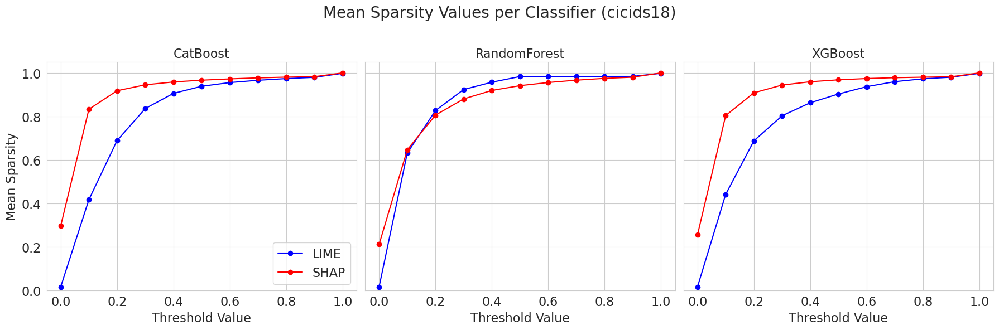

In [13]:
import pandas as pd
import matplotlib.pyplot as plt

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
thresholds = [f"t_{t:.1f}" for t in [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]]
xai_palette = {"lime": "blue", "shap": "red"}
datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()
mean_rows = []

# Define standard font size for all plot elements
FS = 16

for dataset in datasets:
    # Prepare subplots: one row per dataset, three columns (one per classifier)
    fig, axs = plt.subplots(1, len(classifiers), figsize=(18, 6), sharey=True)
    if len(classifiers) == 1:
        axs = [axs]  # Ensure axs iterable

    for ax, classifier in zip(axs, classifiers):
        # Filter for general_idx
        subset = df[
            (df['dataset'] == dataset) &
            (df['classifier'] == classifier) &
            (df['sample_set'] == 'general_idx')
        ]
        if subset.empty or subset['explainer'].nunique() < 2:
            print(f"No data for dataset {dataset}, classifier {classifier}.")
            ax.set_visible(False)
            continue

        # Prepare result rows for both explainers
        for explainer in ['lime', 'shap']:
            explainer_means = subset[subset['explainer'].str.lower() == explainer][thresholds].mean()
            result_row = {
                "dataset": dataset,
                "classifier": classifier,
                "sample_set": 'general_idx',
                "explainer": explainer
            }
            for thr in thresholds:
                result_row[thr] = explainer_means[thr]
            mean_rows.append(result_row)

        lime_means = subset[subset['explainer'].str.lower() == 'lime'][thresholds].mean()
        shap_means = subset[subset['explainer'].str.lower() == 'shap'][thresholds].mean()
        
        # Plotting
        x_values = [float(thr.split('_')[1]) for thr in thresholds]
        
        ax.plot(x_values, lime_means, label='LIME', color=xai_palette['lime'], marker='o')
        ax.plot(x_values, shap_means, label='SHAP', color=xai_palette['shap'], marker='o')
        
        # Apply Font Sizes
        ax.set_title(f"{classifier}", fontsize=FS)
        ax.set_xlabel("Threshold Value", fontsize=FS)
        ax.tick_params(axis='both', which='major', labelsize=FS)
        
        ax.set_ylim(0, 1.05)
        ax.grid(True)
        
        if ax == axs[0]:
            ax.set_ylabel("Mean Sparsity", fontsize=FS)
            ax.legend(fontsize=FS)

    means_df = pd.DataFrame(mean_rows)
    print(means_df[means_df['dataset'] == dataset])    
    
    # Suptitle increased to be larger than axis labels
    plt.suptitle(f"Mean Sparsity Values per Classifier ({dataset})", fontsize=FS+4)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    
    filename = f"metrics/final plots/sparsity_{dataset}_general_idx_all_runs_means.png"
    plt.savefig(filename, bbox_inches='tight')    
    plt.show()    
    #means_df.to_csv("metrics/sparsity/sparsity_all_datasets_general_idx_all_runs.csv", index=False)

    dataset classifier explainer   sample_set  run_nr     idx     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9  t_1.0
0  cicids17   CatBoost      lime  general_idx       1  363001  0.015385  0.630769  0.861538  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
1  cicids17   CatBoost      lime  general_idx       1  110929  0.015385  0.584615  0.846154  0.923077  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
2  cicids17   CatBoost      lime  general_idx       1  150433  0.015385  0.630769  0.861538  0.938462  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
3  cicids17   CatBoost      lime  general_idx       1  484275  0.015385  0.630769  0.876923  0.953846  0.969231  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
4  cicids17   CatBoost      lime  general_idx       1   87398  0.015385  0.538462  0.830769  0.923077  0.969231  0.984615  0.984615  0.984615  0.984615  0.

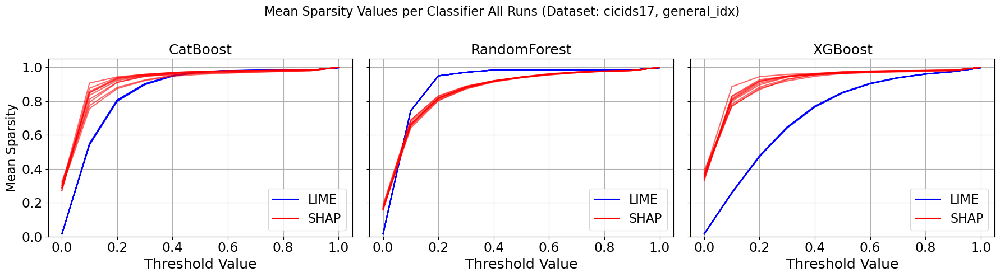

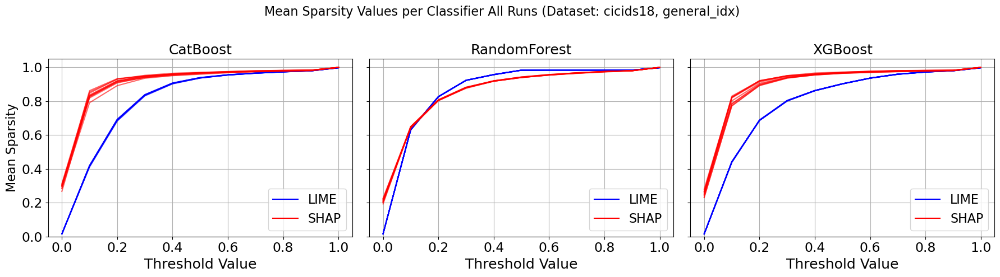

In [2]:
# all runs based on individual idx

import pandas as pd
import matplotlib.pyplot as plt

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
print(df.head())
thresholds = [f"t_{t:.1f}" for t in [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]]
xai_palette = {"lime": "blue", "shap": "red"}
datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()

for dataset in datasets:
    fig, axs = plt.subplots(1, len(classifiers), figsize=(18, 5), sharey=True)
    if len(classifiers) == 1:
        axs = [axs]
    for ax, classifier in zip(axs, classifiers):
        subset = df[
            (df['dataset'] == dataset) &
            (df['classifier'] == classifier) &
            (df['sample_set'] == 'general_idx')
        ]
        if subset.empty or subset['explainer'].nunique() < 2:
            print(f"No data for dataset {dataset}, classifier {classifier}.")
            ax.set_visible(False)
            continue

        for explainer in ['lime', 'shap']:
            for run_nr in subset['run_nr'].unique():
                run_data = subset[
                    (subset['explainer'].str.lower() == explainer) &
                    (subset['run_nr'] == run_nr)
                ]
                if run_data.empty:
                    continue
            
                run_means = run_data[thresholds].mean()                                
                #print(explainer, run_nr, [f for f in run_means])
                
                ax.plot(
                    [float(thr.split('_')[1]) for thr in thresholds], run_means,
                    color=xai_palette[explainer],
                    alpha=0.6,
                    linestyle='-'
                )
        # Add explainer legend with colored dummy lines
        for explainer in ['lime', 'shap']:
            ax.plot([], [], color=xai_palette[explainer], label=explainer.upper())
        ax.set_title(f"{classifier}", fontsize=18)
        ax.set_xlabel("Threshold Value", fontsize=18)
        ax.set_ylim(0, 1.05)
        ax.grid(True)
        ax.tick_params(axis='both', which='major', labelsize=17)
        if ax == axs[0]:
            ax.set_ylabel("Mean Sparsity", fontsize=16)
        ax.legend(fontsize=16, loc='lower right')

    plt.suptitle(f"Mean Sparsity Values per Classifier All Runs (Dataset: {dataset}, general_idx)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    filename = f"metrics/final plots/sparsity_{dataset}_general_idx_all_runs.png"
    plt.savefig(filename, bbox_inches='tight')
    plt.show()


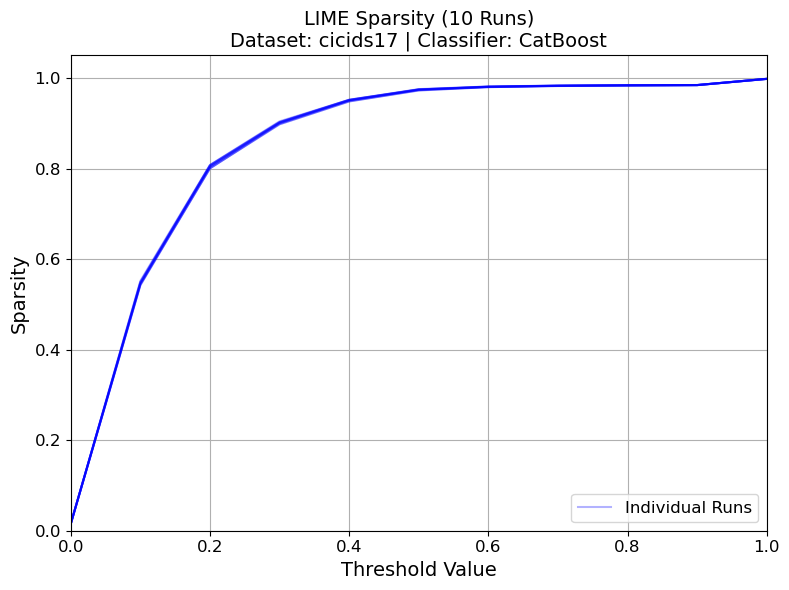

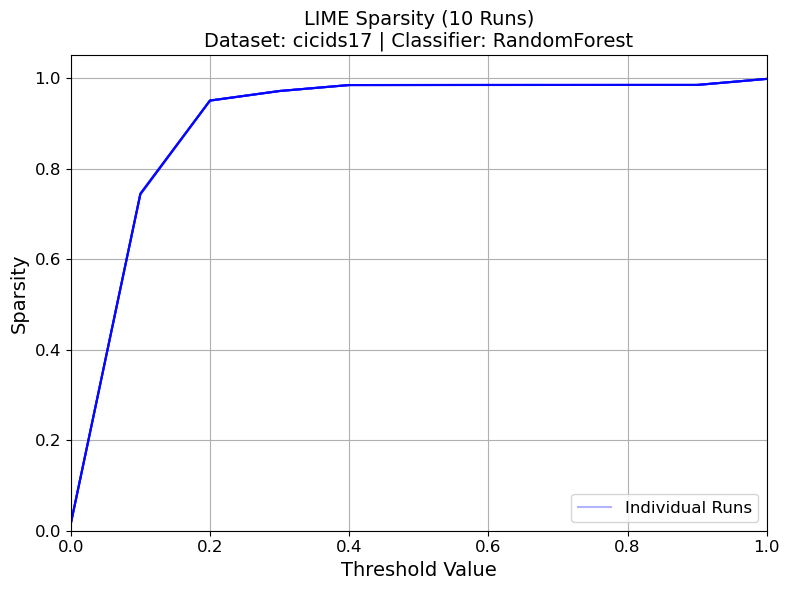

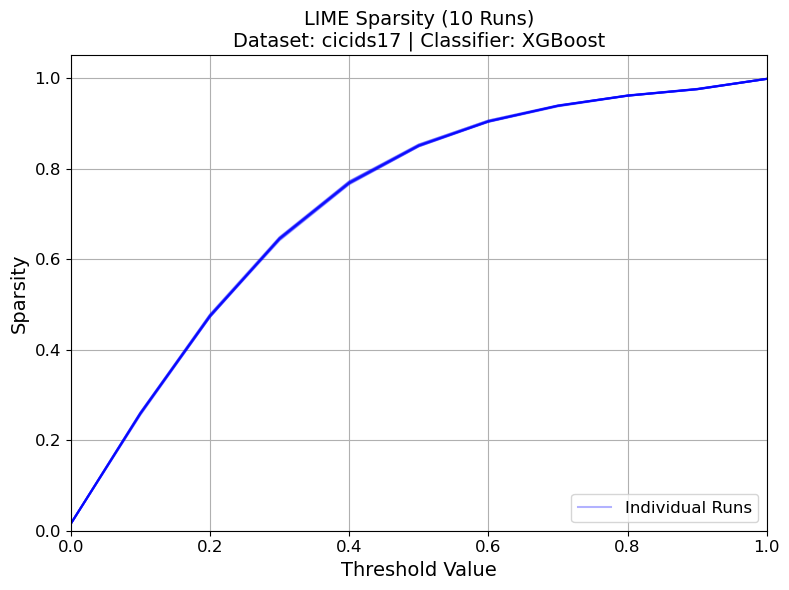

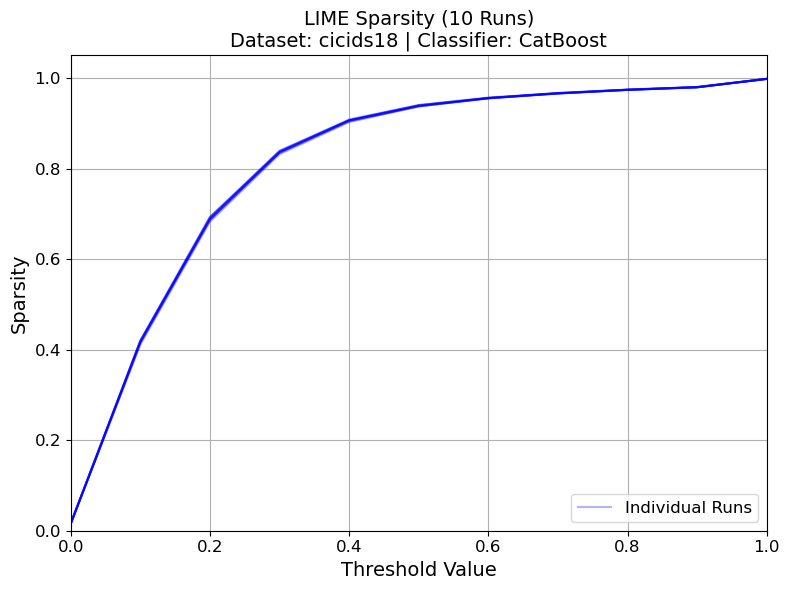

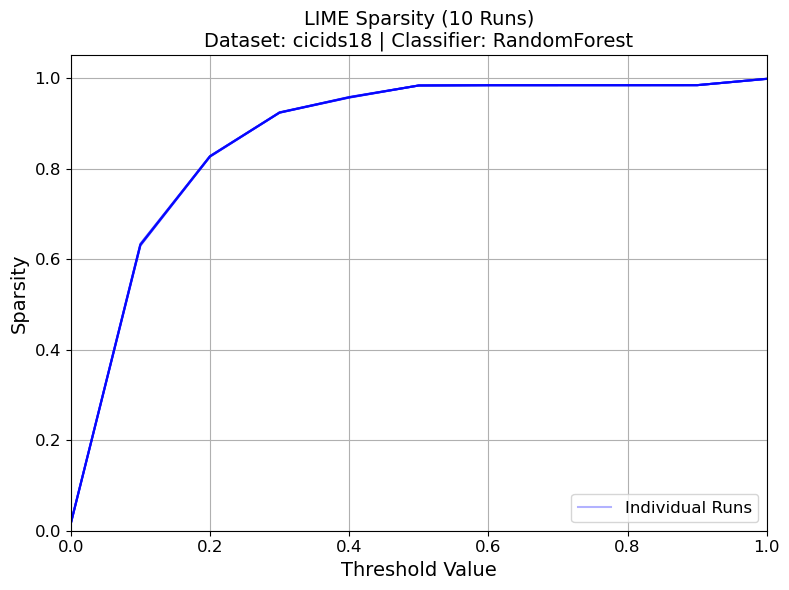

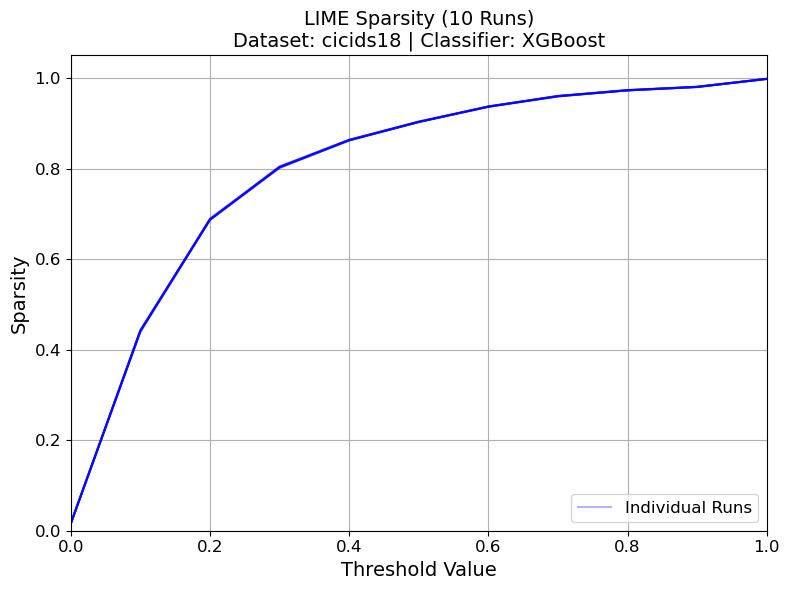

In [28]:
# Delete
import pandas as pd
import matplotlib.pyplot as plt

# Options
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Load Data
all_data = pd.read_csv("metrics/sparsity/sparsity_means_all_runs.csv")

# 1. Filter: Keep only 'lime' rows
df = all_data[all_data['explainer'] == 'lime']

# 2. Identify the run columns (general_idx_run_1 to 10)
run_columns = [f"general_idx_run_{i}" for i in range(1, 11)]

# 3. Iterate over each Dataset + Classifier combination
datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()

for dataset in datasets:
    for classifier in classifiers:
        
        # Select data for this specific pair
        subset = df[
            (df['dataset'] == dataset) & 
            (df['classifier'] == classifier)
        ].sort_values('threshold') # Important: Sort by threshold for correct line plotting
        
        if subset.empty:
            continue
            
        # Create a new figure for this pair
        fig, ax = plt.subplots(figsize=(8, 6))
        
        # Plot a line for each of the 10 runs
        for run_col in run_columns:
            ax.plot(
                subset['threshold'], 
                subset[run_col], 
                color='blue', 
                alpha=0.3,       # Semi-transparent to show density/overlap
                linewidth=1.5,
                label='Run' if run_col == run_columns[0] else "" # Label only once for legend
            )

        # Formatting
        ax.set_title(f"LIME Sparsity (10 Runs)\nDataset: {dataset} | Classifier: {classifier}", fontsize=14)
        ax.set_xlabel("Threshold Value", fontsize=14)
        ax.set_ylabel("Sparsity", fontsize=14)
        ax.set_ylim(0, 1.05)
        ax.set_xlim(0, 1.0)
        ax.grid(True)
        ax.tick_params(axis='both', which='major', labelsize=12)
        
        # Optional: Add a simple legend (since all lines are 'Runs', one entry is enough)
        ax.legend(["Individual Runs"], loc='lower right', fontsize=12)

        plt.tight_layout()
        
        # Save filename (unique for each combination)
        filename = f"metrics/sparsity/sparsity_{dataset}_{classifier}_lime_10runs.png"
        # plt.savefig(filename)
        
        plt.show()

    dataset classifier explainer   sample_set  run_nr     idx     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9  t_1.0
0  cicids17   CatBoost      lime  general_idx       1  363001  0.015385  0.630769  0.861538  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
1  cicids17   CatBoost      lime  general_idx       1  110929  0.015385  0.584615  0.846154  0.923077  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
2  cicids17   CatBoost      lime  general_idx       1  150433  0.015385  0.630769  0.861538  0.938462  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
3  cicids17   CatBoost      lime  general_idx       1  484275  0.015385  0.630769  0.876923  0.953846  0.969231  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
4  cicids17   CatBoost      lime  general_idx       1   87398  0.015385  0.538462  0.830769  0.923077  0.969231  0.984615  0.984615  0.984615  0.984615  0.

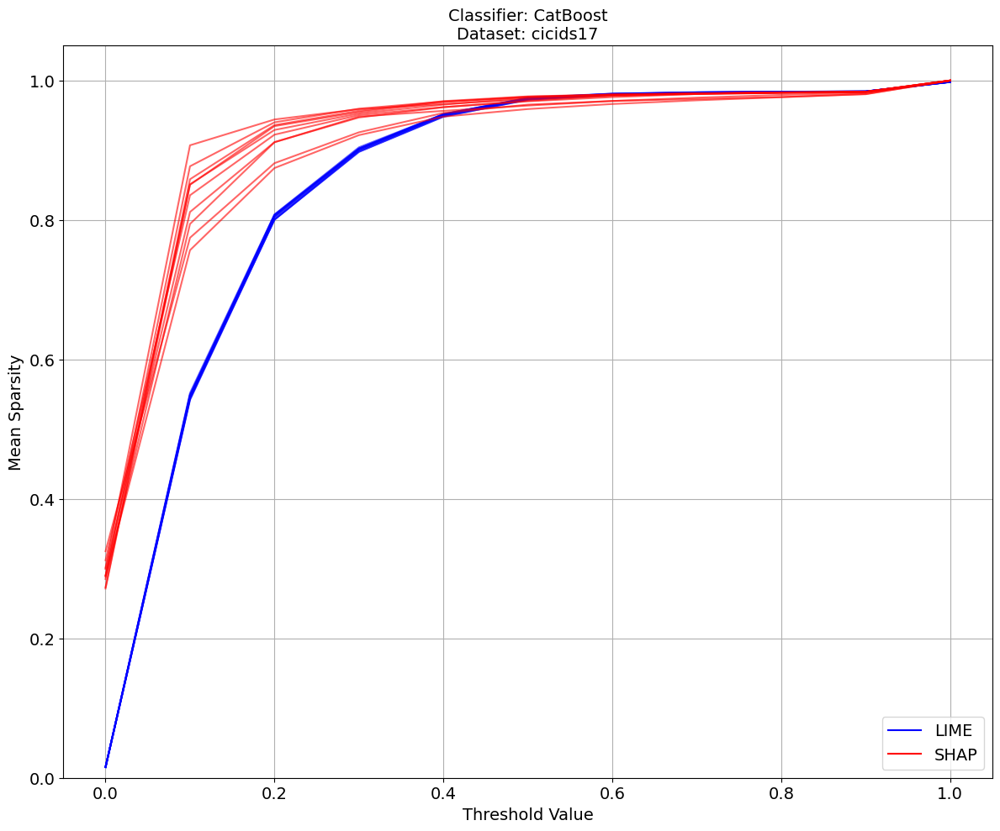

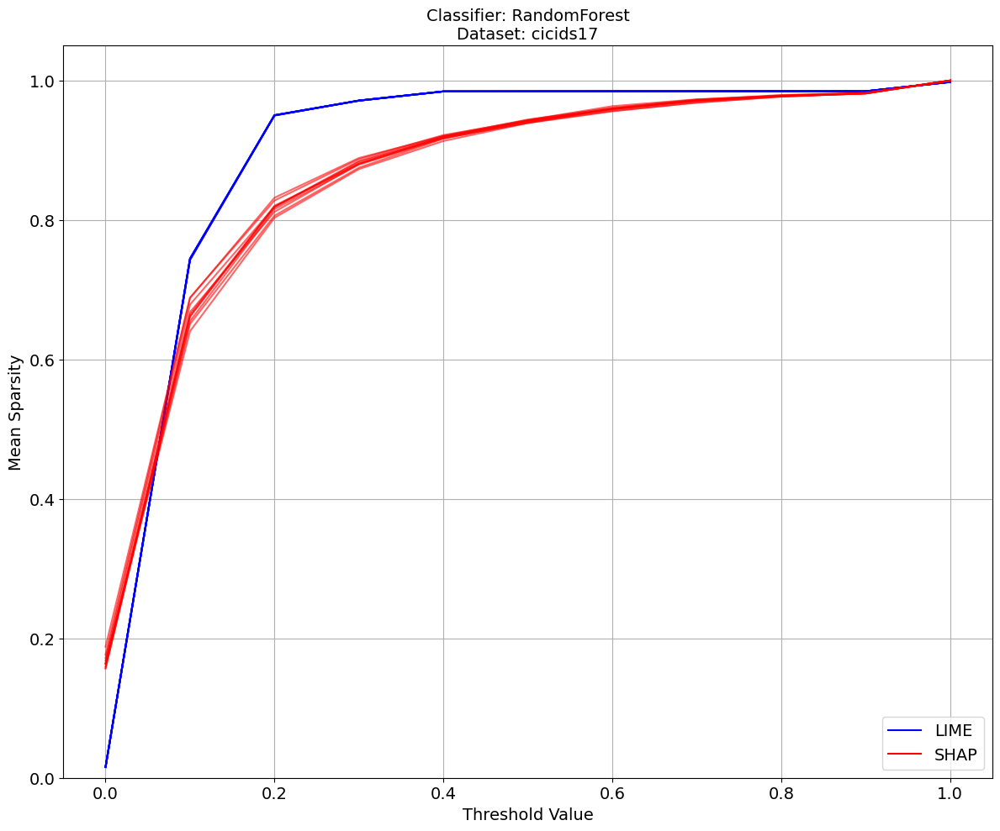

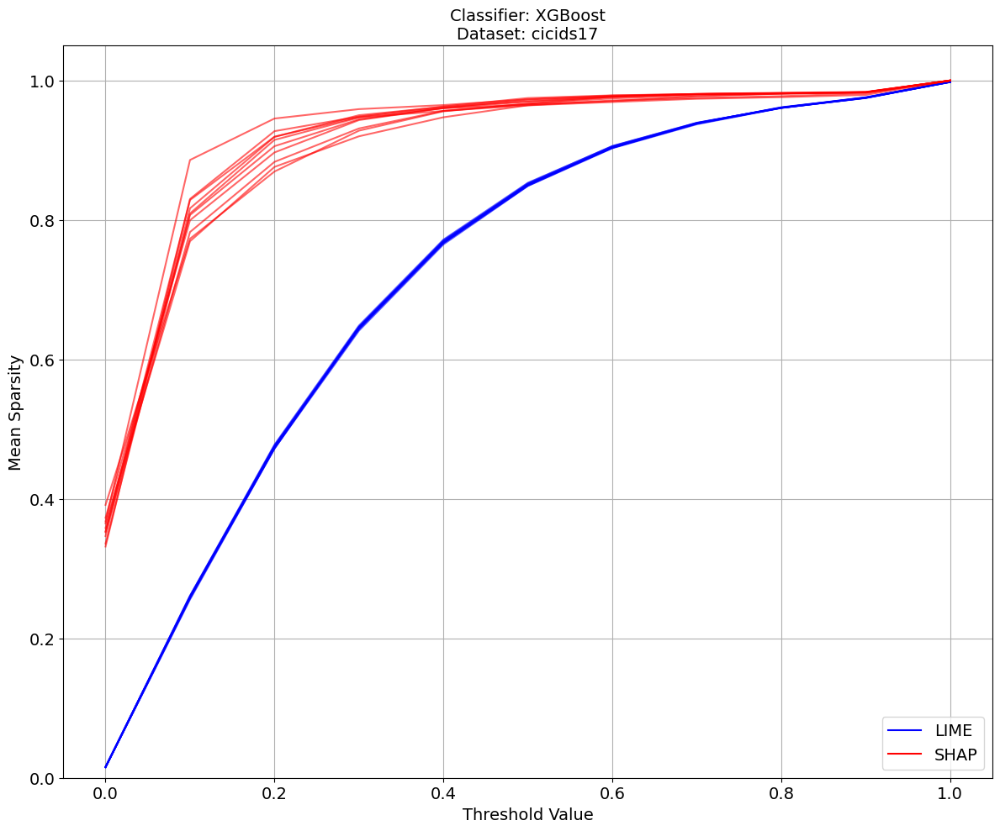

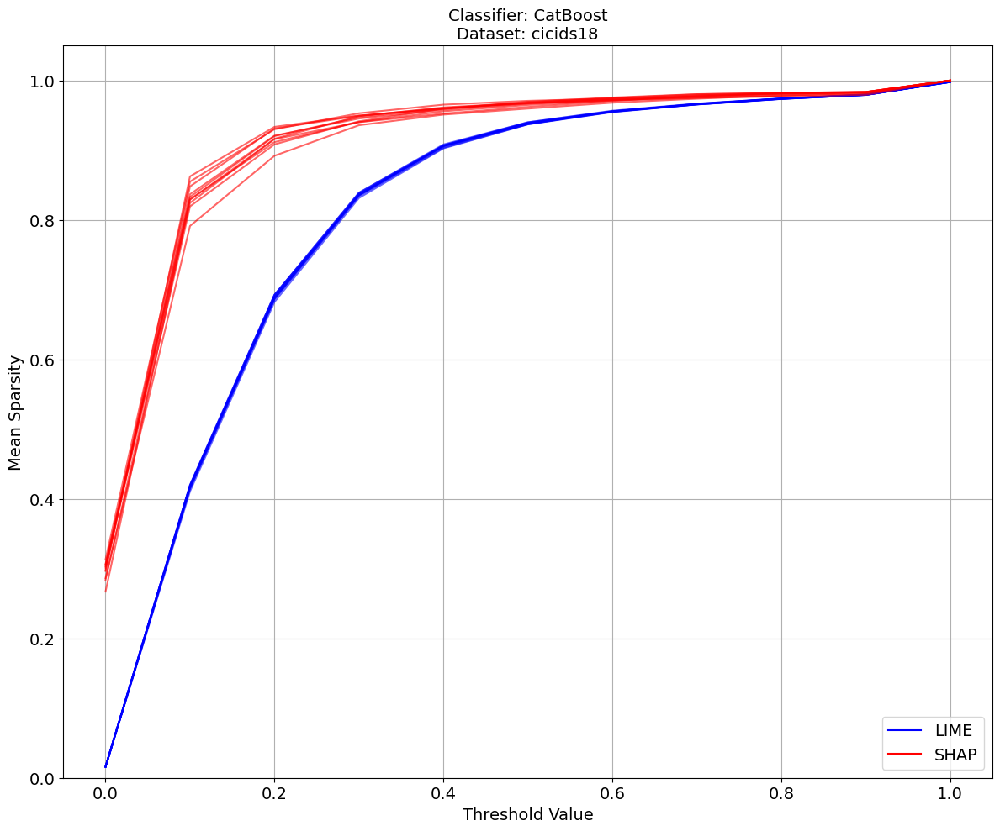

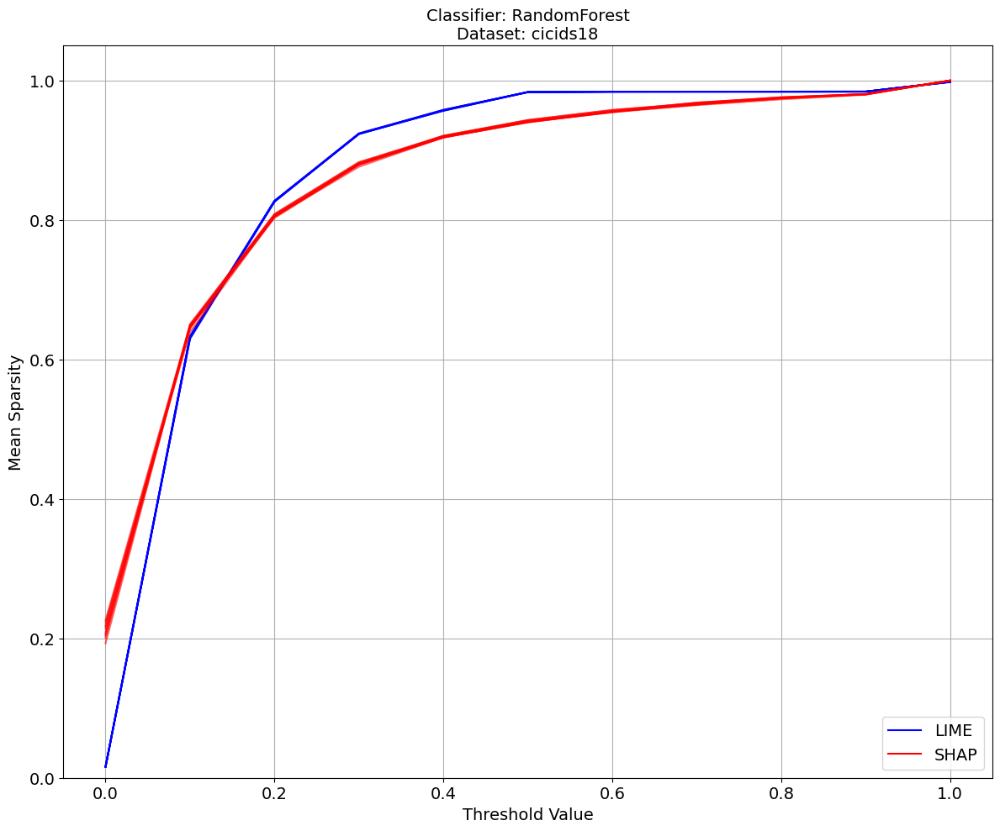

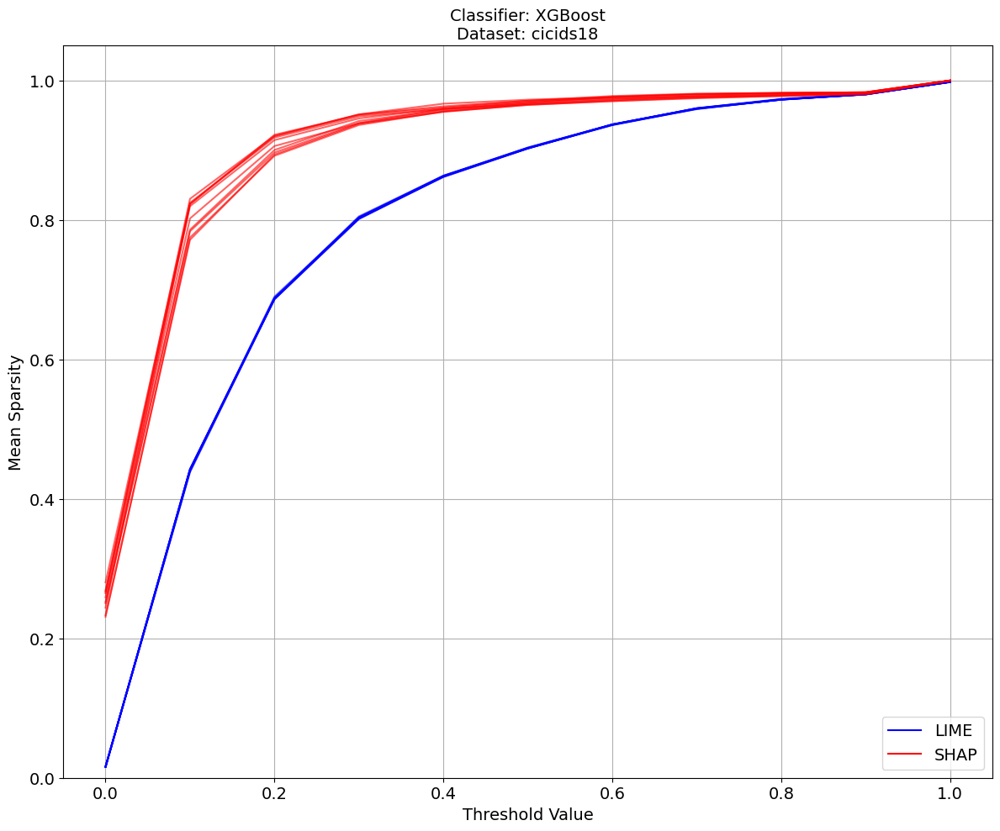

In [7]:
import pandas as pd
import matplotlib.pyplot as plt

# Options
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Load Data
df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
print(df.head())

# Configuration
thresholds = [f"t_{t:.1f}" for t in [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]]
xai_palette = {"lime": "blue", "shap": "red"}
datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()

# --- Main Loop ---
for dataset in datasets:
    # Now we iterate through classifiers individually to create separate plots
    for classifier in classifiers:
        
        # Filter the data
        subset = df[
            (df['dataset'] == dataset) &
            (df['classifier'] == classifier) &
            (df['sample_set'] == 'general_idx')
        ]
        
        # Skip if empty or insufficient explainers
        if subset.empty or subset['explainer'].nunique() < 2:
            print(f"No data for dataset {dataset}, classifier {classifier}.")
            continue


        fig, ax = plt.subplots(figsize=(12, 10))

        for explainer in ['lime', 'shap']:
            for run_nr in subset['run_nr'].unique():
                run_data = subset[
                    (subset['explainer'].str.lower() == explainer) &
                    (subset['run_nr'] == run_nr)
                ]
                if run_data.empty:
                    continue
                
                run_means = run_data[thresholds].mean()
                
                ax.plot(
                    [float(thr.split('_')[1]) for thr in thresholds], run_means,
                    color=xai_palette[explainer],
                    alpha=0.6,
                    linestyle='-'
                )
        
        # Add explainer legend with colored dummy lines
        for explainer in ['lime', 'shap']:
            ax.plot([], [], color=xai_palette[explainer], label=explainer.upper())
            
        # Formatting
        ax.set_title(f"Classifier: {classifier}\nDataset: {dataset}", fontsize=14)
        ax.set_xlabel("Threshold Value", fontsize=14)
        ax.set_ylabel("Mean Sparsity", fontsize=14) # Always show label now
        ax.set_ylim(0, 1.05)
        ax.grid(True)
        ax.tick_params(axis='both', which='major', labelsize=14)
        ax.legend(fontsize=14, loc='lower right')

        plt.tight_layout()
        
        # Updated filename to include the classifier, otherwise they overwrite each other
        filename = f"metrics/sparsity/sparsity_{dataset}_{classifier}_general_idx_all_runs.png"
        # plt.savefig(filename, bbox_inches='tight')
        
        plt.show()

    dataset    classifier   sample_set  run_nr explainer     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
0  cicids17      CatBoost  general_idx       1      lime  0.015385  0.548985  0.807123  0.902415  0.951969  0.974585  0.981031  0.982969  0.983923  0.984431  0.998354
1  cicids17      CatBoost  general_idx       1      shap  0.271492  0.850462  0.934600  0.954785  0.969000  0.976831  0.979846  0.981523  0.983015  0.983985  1.000000
2  cicids17  RandomForest  general_idx       1      lime  0.015385  0.743092  0.949892  0.971338  0.984385  0.984446  0.984523  0.984554  0.984600  0.984615  0.997785
3  cicids17  RandomForest  general_idx       1      shap  0.156631  0.661831  0.818277  0.883508  0.918369  0.942508  0.959031  0.971723  0.978738  0.982077  1.000000
4  cicids17       XGBoost  general_idx       1      lime  0.015385  0.260846  0.477677  0.648554  0.771815  0.853323  0.905800  0.939292  0.960938  0.975246  0.99806

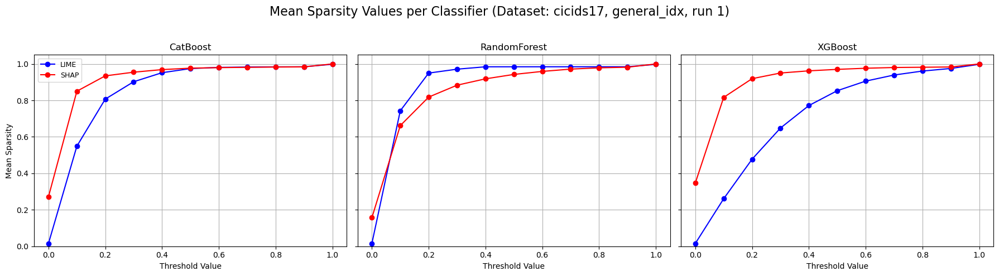

     dataset    classifier   sample_set  run_nr explainer     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
6   cicids18      CatBoost  general_idx       1      lime  0.015873  0.418286  0.689460  0.836889  0.906714  0.939175  0.955810  0.966397  0.973921  0.979397  0.997857
7   cicids18      CatBoost  general_idx       1      shap  0.267095  0.829111  0.915889  0.940254  0.952635  0.962159  0.970603  0.978095  0.981032  0.983016  1.000000
8   cicids18  RandomForest  general_idx       1      lime  0.015873  0.631524  0.827397  0.923667  0.958048  0.983508  0.984032  0.984063  0.984079  0.984127  0.997968
9   cicids18  RandomForest  general_idx       1      shap  0.213937  0.645873  0.807159  0.880127  0.920079  0.943429  0.957635  0.967746  0.976206  0.980444  1.000000
10  cicids18       XGBoost  general_idx       1      lime  0.015873  0.441635  0.687190  0.802873  0.862476  0.903095  0.936794  0.960444  0.972905  0.980302  0

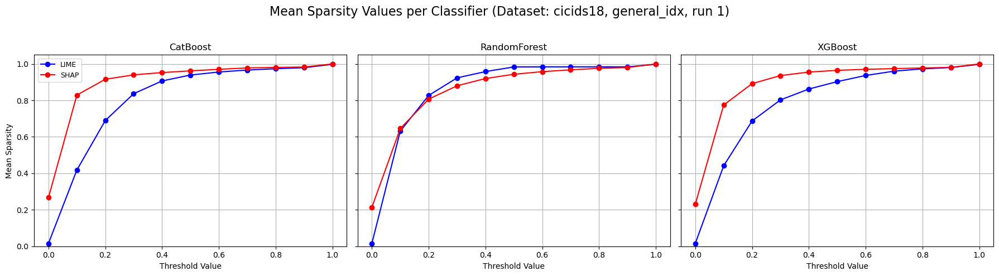

In [17]:
# one run

import pandas as pd
import matplotlib.pyplot as plt

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
thresholds = [f"t_{t:.1f}" for t in [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]]
xai_palette = {"lime": "blue", "shap": "red"}
datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()
mean_rows = []

for dataset in datasets:
    # Prepare subplots: one row per dataset, three columns (one per classifier)
    fig, axs = plt.subplots(1, len(classifiers), figsize=(18, 5), sharey=True)
    if len(classifiers) == 1:
        axs = [axs]  # Ensure axs iterable

    for ax, classifier in zip(axs, classifiers):
        # Filter for general_idx and run 1
        subset = df[
            (df['dataset'] == dataset) &
            (df['classifier'] == classifier) &
            (df['sample_set'] == 'general_idx') &
            (df['run_nr'] == 1)
        ]
        if subset.empty or subset['explainer'].nunique() < 2:
            print(f"No data for dataset {dataset}, classifier {classifier}.")
            ax.set_visible(False)
            continue

        # Prepare result rows for both explainers
        for explainer in ['lime', 'shap']:
            explainer_means = subset[subset['explainer'].str.lower() == explainer][thresholds].mean()
            result_row = {
                "dataset": dataset,
                "classifier": classifier,
                "sample_set": 'general_idx',
                "run_nr": 1,
                "explainer": explainer
            }
            for thr in thresholds:
                result_row[thr] = explainer_means[thr]
            mean_rows.append(result_row)

        lime_means = subset[subset['explainer'].str.lower() == 'lime'][thresholds].mean()
        shap_means = subset[subset['explainer'].str.lower() == 'shap'][thresholds].mean()
        ax.plot(
            [float(thr.split('_')[1]) for thr in thresholds], lime_means,
            label='LIME', color=xai_palette['lime'], marker='o'
        )
        ax.plot(
            [float(thr.split('_')[1]) for thr in thresholds], shap_means,
            label='SHAP', color=xai_palette['shap'], marker='o'
        )
        ax.set_title(f"{classifier}")
        ax.set_xlabel("Threshold Value")
        ax.set_ylim(0, 1.05)
        ax.grid(True)
        if ax == axs[0]:
            ax.set_ylabel("Mean Sparsity")
            ax.legend(fontsize=9)

    means_df = pd.DataFrame(mean_rows)
    print(means_df[means_df['dataset'] == dataset])    
    plt.suptitle(f"Mean Sparsity Values per Classifier (Dataset: {dataset}, general_idx, run 1)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    
    # Save plot to disk
    filename = f"metrics/sparsity/sparsity_{dataset}_general_idx_single_run.png"
    plt.savefig(filename, bbox_inches='tight')    
    plt.show()
    means_df.to_csv("metrics/sparsity/sparsity_all_datasets_general_idx_single_run.csv", index=False)

### Comparison True vs False for each XAI

#### Statistical Analysis

In [3]:
import pandas as pd
import numpy as np
from scipy.stats import ttest_ind

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
print(df.head())
thresholds = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
results = []

for dataset in df['dataset'].unique():
    for classifier in df['classifier'].unique():
        for explainer in ['lime', 'shap']:
            for run in df['run_nr'].unique()[:1]:  # only first run
                for t in thresholds:
                    col = f"t_{t:.1f}"
                    false_subset = df[
                        (df["dataset"] == dataset) &
                        (df["classifier"] == classifier) &
                        (df["explainer"].str.lower() == explainer) &
                        (df["sample_set"] == "false_idx") &
                        (df["run_nr"] == run)
                    ][col]
                    #print(false_subset.head())
                    true_subset = df[
                        (df["dataset"] == dataset) &
                        (df["classifier"] == classifier) &
                        (df["explainer"].str.lower() == explainer) &
                        (df["sample_set"] == "true_idx") &
                        (df["run_nr"] == run)
                    ][col]

                    false_vals_all = false_subset.values
                    true_vals_all = true_subset.values
                
                    min_len = min(len(false_vals_all), len(true_vals_all))
                
                    if min_len > 1:
                        false_vals = false_vals_all[:min_len] #first group
                        true_vals = true_vals_all[:min_len] #second group

                    false_var = np.var(false_vals)
                    true_var = np.var(true_vals)
                    false_mean = round(false_vals.mean(), 5)
                    false_std = round(false_vals.std(ddof=1), 5)
                    true_mean = round(true_vals.mean(), 5)
                    true_std = round(true_vals.std(ddof=1), 5)

                    stat, p = ttest_ind(false_vals, true_vals)#, equal_var=False)

                    interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                    results.append({
                        "dataset": dataset,
                        "classifier": classifier,
                        "explainer": explainer,
                        #"run_nr": run,
                        "threshold": t,
                        "false_mean": false_mean,
                        "false_std": false_std,
                        "false_var": false_var,
                        "true_mean": true_mean,
                        "true_std": true_std,
                        "true_var": true_var,
                        "ttest_statistic": round(stat, 5),
                        "p_value": round(p, 5),
                        "interpretation": interpretation
                    })

results_df = pd.DataFrame(results)
print(results_df)

results_df.to_csv("metrics/sparsity/sparsity_ind_ttest_true_vs_false.csv", index=False)


    dataset classifier explainer   sample_set  run_nr     idx     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9  t_1.0
0  cicids17   CatBoost      lime  general_idx       1  363001  0.015385  0.630769  0.861538  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
1  cicids17   CatBoost      lime  general_idx       1  110929  0.015385  0.584615  0.846154  0.923077  0.953846  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
2  cicids17   CatBoost      lime  general_idx       1  150433  0.015385  0.630769  0.861538  0.938462  0.984615  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
3  cicids17   CatBoost      lime  general_idx       1  484275  0.015385  0.630769  0.876923  0.953846  0.969231  0.984615  0.984615  0.984615  0.984615  0.984615    1.0
4  cicids17   CatBoost      lime  general_idx       1   87398  0.015385  0.538462  0.830769  0.923077  0.969231  0.984615  0.984615  0.984615  0.984615  0.

/home/maui/miniconda3/envs/ai_env/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:586: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


      dataset    classifier explainer  threshold  false_mean  false_std     false_var  true_mean  true_std      true_var  ttest_statistic  p_value             interpretation
0    cicids17      CatBoost      lime        0.0     0.01538    0.00000  0.000000e+00    0.01538   0.00000  0.000000e+00              NaN      NaN     Significant difference
1    cicids17      CatBoost      lime        0.1     0.50826    0.12854  1.650214e-02    0.54456   0.11227  1.258893e-02         -5.88260  0.00000     Significant difference
2    cicids17      CatBoost      lime        0.2     0.77649    0.11491  1.318781e-02    0.80350   0.10260  1.051272e-02         -4.84919  0.00000     Significant difference
3    cicids17      CatBoost      lime        0.3     0.89506    0.07264  5.269123e-03    0.89965   0.07145  5.097838e-03         -1.24475  0.21342  No significant difference
4    cicids17      CatBoost      lime        0.4     0.94900    0.05122  2.619663e-03    0.95015   0.04951  2.447846e-03         -

### Visualization

#### Mean Sparsity - True vs False all runs

     dataset    classifier explainer sample_set     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
0   cicids17      CatBoost      lime  false_idx  0.015385  0.511133  0.779928  0.897355  0.950639  0.974460  0.980366  0.982447  0.983463  0.984209  0.998083
1   cicids17      CatBoost      lime   true_idx  0.015385  0.544349  0.802615  0.899562  0.949138  0.973175  0.980169  0.982500  0.983617  0.984275  0.998086
2   cicids17      CatBoost      shap  false_idx  0.345677  0.639023  0.782807  0.862560  0.906972  0.932090  0.946777  0.958832  0.970136  0.978840  1.000000
3   cicids17      CatBoost      shap   true_idx  0.292448  0.828888  0.917751  0.946720  0.961472  0.970023  0.975186  0.978291  0.980897  0.982889  1.000000
4   cicids17  RandomForest      lime  false_idx  0.015385  0.742226  0.949178  0.970157  0.984298  0.984395  0.984431  0.984486  0.984598  0.984615  0.998043
5   cicids17  RandomForest      lime   true_idx  0.0

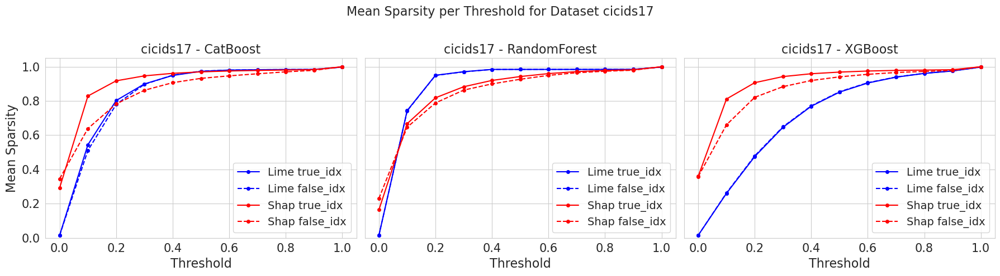

     dataset    classifier explainer sample_set     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
12  cicids18      CatBoost      lime  false_idx  0.015873  0.420440  0.692005  0.838624  0.907616  0.939737  0.955921  0.966233  0.973940  0.979878  0.997997
13  cicids18      CatBoost      lime   true_idx  0.015873  0.415681  0.687192  0.835240  0.905271  0.937978  0.955422  0.965838  0.973710  0.979619  0.998040
14  cicids18      CatBoost      shap  false_idx  0.356819  0.823054  0.906240  0.939303  0.955683  0.962690  0.967714  0.972489  0.977224  0.982346  1.000000
15  cicids18      CatBoost      shap   true_idx  0.291005  0.831719  0.918203  0.945668  0.959149  0.967214  0.972840  0.977381  0.980649  0.982673  1.000000
16  cicids18  RandomForest      lime  false_idx  0.015873  0.633816  0.827205  0.922975  0.956938  0.983048  0.983900  0.984044  0.984111  0.984119  0.998108
17  cicids18  RandomForest      lime   true_idx  0.0

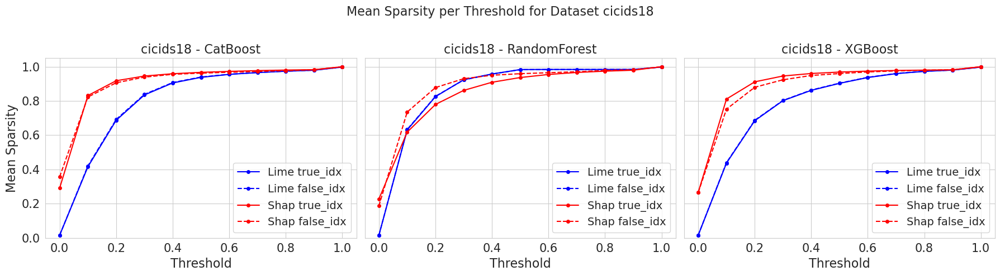

In [17]:
# comparison 1 run

import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")

threshold_cols = [col for col in df.columns if col.startswith('t_')]

df_run1 = df[(df['sample_set'] != "general_idx")]


group_columns = ['dataset', 'classifier', 'explainer', 'sample_set']
mean_values_all_runs = (
    df_run1.groupby(group_columns)[threshold_cols]
    .mean()
    .reset_index()
)
#print(mean_values_all_runs.head())

datasets = mean_values_all_runs['dataset'].unique()
classifiers = mean_values_all_runs['classifier'].unique()
xais = ['lime', 'shap']
colors = {'lime': 'blue', 'shap': 'red'}
linestyles = {'true_idx': '-', 'false_idx': '--'} 

for dataset in datasets:
    print(mean_values_all_runs[mean_values_all_runs["dataset"] == dataset])
    fig, axes = plt.subplots(1, len(classifiers), figsize=(18, 5), sharey=True)
    if len(classifiers) == 1:
        axes = [axes]

    for ax, classifier in zip(axes, classifiers):
        subset = mean_values_all_runs[
            (mean_values_all_runs['dataset'] == dataset) &
            (mean_values_all_runs['classifier'] == classifier)
        ]

        for xai in xais:
            for sample_set in ['true_idx', 'false_idx']:
                data = subset[(subset['explainer'] == xai) & (subset['sample_set'] == sample_set)]

                if data.empty:
                    continue

                means = data[threshold_cols].iloc[0]
                thresholds = [float(c.split('_')[1]) for c in threshold_cols]

                label = f"{xai.capitalize()} {sample_set}"
                ax.plot(
                    thresholds,
                    means,
                    color=colors[xai],
                    linestyle=linestyles[sample_set],
                    marker='o',
                    markersize=4,
                    label=label
                )

        ax.set_title(f"{dataset} - {classifier}", fontsize=16)
        ax.set_xlabel("Threshold", fontsize=16)
        ax.set_ylim([0, 1.05])
        ax.grid(True)
        ax.tick_params(axis='both', labelsize=15)
        if ax == axes[0]:
            ax.set_ylabel("Mean Sparsity", fontsize=16)
        ax.legend(fontsize=14)

    plt.suptitle(f"Mean Sparsity per Threshold for Dataset {dataset}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    filename = f"metrics/sparsity/sparsity_means_true_vs_false_{dataset}.png"
    #plt.savefig(filename, bbox_inches='tight')

    plt.show()

     dataset    classifier sample_set  run_nr explainer     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
0   cicids17      CatBoost   true_idx       1      lime  0.015385  0.545154  0.803185  0.900338  0.949769  0.973785  0.980462  0.982585  0.983600  0.984277  0.998062
1   cicids17      CatBoost  false_idx       1      lime  0.015385  0.508255  0.776491  0.895063  0.948999  0.973233  0.979930  0.982162  0.983188  0.984113  0.998331
2   cicids17      CatBoost   true_idx       1      shap  0.264754  0.846831  0.933846  0.954554  0.968369  0.975677  0.979154  0.981262  0.982646  0.983846  1.000000
3   cicids17      CatBoost  false_idx       1      shap  0.344334  0.632680  0.773233  0.855887  0.901599  0.926898  0.942464  0.956883  0.970216  0.979206  1.000000
4   cicids17  RandomForest   true_idx       1      lime  0.015385  0.743338  0.949877  0.971108  0.984231  0.984354  0.984369  0.984431  0.984477  0.984538  0.998092
5   

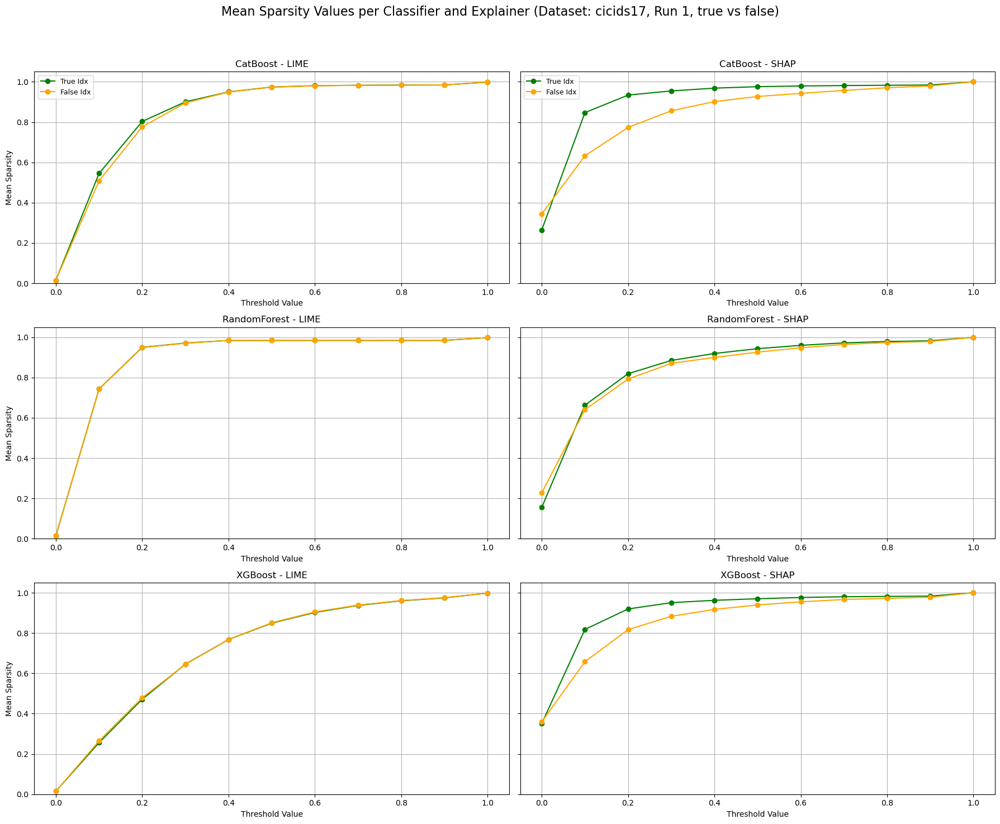

     dataset    classifier sample_set  run_nr explainer     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
12  cicids18      CatBoost   true_idx       1      lime  0.015873  0.417921  0.691222  0.838016  0.907079  0.939095  0.956159  0.965889  0.974349  0.979889  0.998238
13  cicids18      CatBoost  false_idx       1      lime  0.015873  0.422143  0.696413  0.841952  0.910397  0.941349  0.957111  0.966698  0.974286  0.979746  0.997889
14  cicids18      CatBoost   true_idx       1      shap  0.263683  0.829429  0.917079  0.940667  0.953968  0.962603  0.971857  0.978714  0.981365  0.983095  1.000000
15  cicids18      CatBoost  false_idx       1      shap  0.330619  0.814746  0.902762  0.935444  0.952984  0.959841  0.966000  0.972032  0.975095  0.982063  1.000000
16  cicids18  RandomForest   true_idx       1      lime  0.015873  0.629905  0.826333  0.924286  0.957270  0.983492  0.984111  0.984111  0.984111  0.984143  0.998095
17  

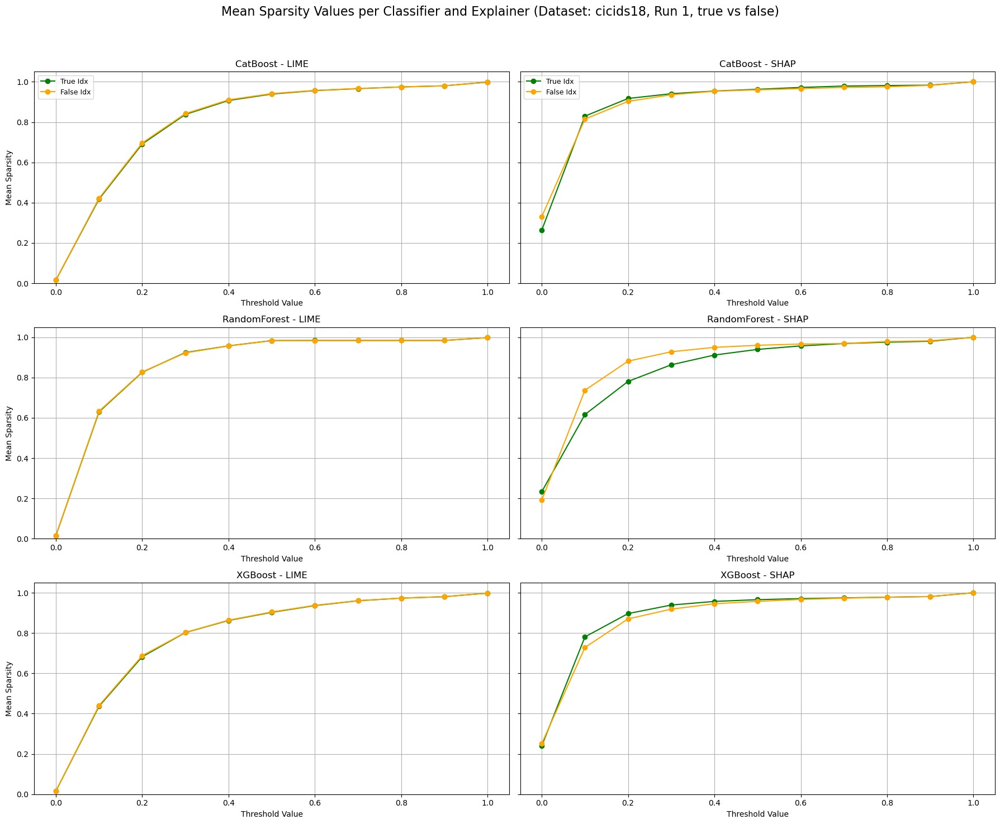

In [4]:
import pandas as pd
import matplotlib.pyplot as plt

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")
thresholds = [f"t_{t:.1f}" for t in [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]]
xai_palette = {"true_idx": "green", "false_idx": "orange"}  # Colors for true vs false explanations
datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()
explainer_list = ['lime', 'shap']  # Explainers to iterate over
mean_rows = []

for dataset in datasets:
    # Prepare subplots: one row per dataset, one col per classifier * explainer
    fig, axs = plt.subplots(len(classifiers), len(explainer_list), figsize=(18, 5*len(classifiers)), sharey=True)
    
    # Ensure axs is 2D array for easy iteration
    if len(classifiers) == 1 and len(explainer_list) == 1:
        axs = [[axs]]
    elif len(classifiers) == 1:
        axs = [axs]
    elif len(explainer_list) == 1:
        axs = [[ax] for ax in axs]

    for i_cls, classifier in enumerate(classifiers):
        for i_exp, explainer in enumerate(explainer_list):
            ax = axs[i_cls][i_exp]

            # Filter for run 1, specific dataset, classifier, explainer
            subset = df[
                (df['dataset'] == dataset) &
                (df['classifier'] == classifier) &
                (df['explainer'].str.lower() == explainer) &
                (df['run_nr'] == 1)
            ]

            # Check if both 'true_idx' and 'false_idx' samples exist
            sample_sets_present = subset['sample_set'].unique()
            if not ('true_idx' in sample_sets_present and 'false_idx' in sample_sets_present):
                print(f"No both true_idx and false_idx data for dataset {dataset}, classifier {classifier}, explainer {explainer}.")
                ax.set_visible(False)
                continue
            
            for sample_set in ['true_idx', 'false_idx']:
                sample_subset = subset[subset['sample_set'] == sample_set]
                means = sample_subset[thresholds].mean()
                
                # Store means for potential output DataFrame or analysis
                result_row = {
                    "dataset": dataset,
                    "classifier": classifier,
                    "sample_set": sample_set,
                    "run_nr": 1,
                    "explainer": explainer
                }
                for thr in thresholds:
                    result_row[thr] = means[thr]
                mean_rows.append(result_row)
                
                # Plotting
                ax.plot(
                    [float(thr.split('_')[1]) for thr in thresholds], means,
                    label=sample_set.replace('_', ' ').title(),
                    color=xai_palette[sample_set], marker='o'
                )
            
            ax.set_title(f"{classifier} - {explainer.upper()}")
            ax.set_xlabel("Threshold Value")
            ax.set_ylim(0, 1.05)
            ax.grid(True)
            if i_exp == 0:
                ax.set_ylabel("Mean Sparsity")
            if i_cls == 0:
                ax.legend(fontsize=9)

    means_df = pd.DataFrame(mean_rows)
    print(means_df[means_df['dataset'] == dataset])    
    plt.suptitle(f"Mean Sparsity Values per Classifier and Explainer (Dataset: {dataset}, Run 1, true vs false)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    
    # Save plot to disk
    filename = f"metrics/sparsity/sparsity_{dataset}_true_vs_false_single_run.png"
    plt.savefig(filename, bbox_inches='tight')    
    plt.show()

#means_df.to_csv("metrics/sparsity/sparsity_all_datasets_true_vs_false_single_run.csv", index=False)


#### Mean Sparsity - True vs False 1 run

     dataset    classifier explainer sample_set  run_nr     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
0   cicids17      CatBoost      lime  false_idx       1  0.015385  0.508255  0.776491  0.895063  0.948999  0.973233  0.979930  0.982162  0.983188  0.984113  0.998331
1   cicids17      CatBoost      lime   true_idx       1  0.015385  0.545154  0.803185  0.900338  0.949769  0.973785  0.980462  0.982585  0.983600  0.984277  0.998062
2   cicids17      CatBoost      shap  false_idx       1  0.344334  0.632680  0.773233  0.855887  0.901599  0.926898  0.942464  0.956883  0.970216  0.979206  1.000000
3   cicids17      CatBoost      shap   true_idx       1  0.264754  0.846831  0.933846  0.954554  0.968369  0.975677  0.979154  0.981262  0.982646  0.983846  1.000000
4   cicids17  RandomForest      lime  false_idx       1  0.015385  0.742938  0.948846  0.970262  0.984338  0.984400  0.984431  0.984477  0.984585  0.984615  0.998185
5   

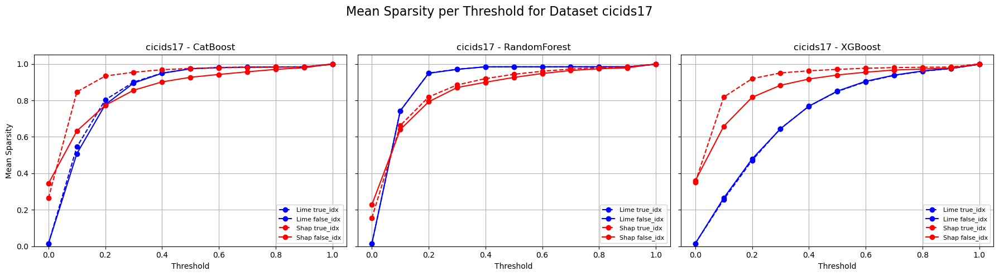

     dataset    classifier explainer sample_set  run_nr     t_0.0     t_0.1     t_0.2     t_0.3     t_0.4     t_0.5     t_0.6     t_0.7     t_0.8     t_0.9     t_1.0
12  cicids18      CatBoost      lime  false_idx       1  0.015873  0.422143  0.696413  0.841952  0.910397  0.941349  0.957111  0.966698  0.974286  0.979746  0.997889
13  cicids18      CatBoost      lime   true_idx       1  0.015873  0.417921  0.691222  0.838016  0.907079  0.939095  0.956159  0.965889  0.974349  0.979889  0.998238
14  cicids18      CatBoost      shap  false_idx       1  0.330619  0.814746  0.902762  0.935444  0.952984  0.959841  0.966000  0.972032  0.975095  0.982063  1.000000
15  cicids18      CatBoost      shap   true_idx       1  0.263683  0.829429  0.917079  0.940667  0.953968  0.962603  0.971857  0.978714  0.981365  0.983095  1.000000
16  cicids18  RandomForest      lime  false_idx       1  0.015873  0.633127  0.827762  0.922524  0.956857  0.982968  0.983889  0.984032  0.984111  0.984127  0.998190
17  

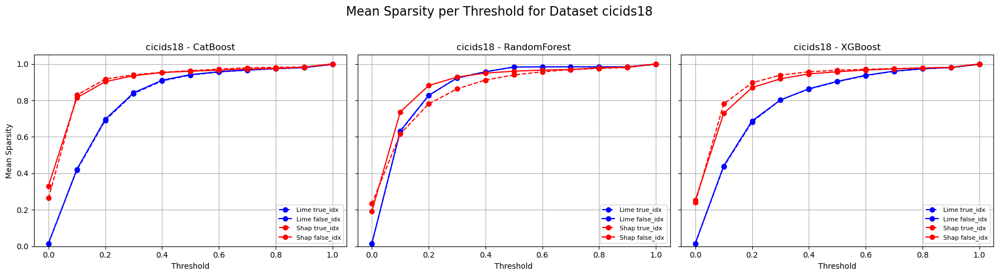

In [76]:
# comparison 1 run

import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_parquet("metrics/sparsity/sparsity_over_all_idx_all_runs.parquet")

threshold_cols = [col for col in df.columns if col.startswith('t_')]

# Filter run 1 and exclude general_idx sample_set
df_run1 = df[(df['run_nr'] == 1) & (df['sample_set'] != "general_idx")]


group_columns = ['dataset', 'classifier', 'explainer', 'sample_set', 'run_nr']
mean_values_all_runs = (
    df_run1.groupby(group_columns)[threshold_cols]
    .mean()
    .reset_index()
)
#print(mean_values_all_runs.head())

datasets = mean_values_all_runs['dataset'].unique()
classifiers = mean_values_all_runs['classifier'].unique()
xais = ['lime', 'shap']
colors = {'lime': 'blue', 'shap': 'red'}
linestyles = {'true_idx': '--', 'false_idx': '-'}  # dash true, solid false

for dataset in datasets:
    print(mean_values_all_runs[mean_values_all_runs["dataset"] == dataset])
    fig, axes = plt.subplots(1, len(classifiers), figsize=(18, 5), sharey=True)
    if len(classifiers) == 1:
        axes = [axes]

    for ax, classifier in zip(axes, classifiers):
        subset = mean_values_all_runs[
            (mean_values_all_runs['dataset'] == dataset) &
            (mean_values_all_runs['classifier'] == classifier)
        ]

        for xai in xais:
            for sample_set in ['true_idx', 'false_idx']:
                data = subset[(subset['explainer'] == xai) & (subset['sample_set'] == sample_set)]

                if data.empty:
                    continue

                means = data[threshold_cols].iloc[0]  # single row per group (run_nr=1)

                thresholds = [float(c.split('_')[1]) for c in threshold_cols]

                label = f"{xai.capitalize()} {sample_set}"
                ax.plot(
                    thresholds,
                    means,
                    color=colors[xai],
                    linestyle=linestyles[sample_set],
                    marker='o',
                    label=label
                )

        ax.set_title(f"{dataset} - {classifier}")
        ax.set_xlabel("Threshold")
        ax.set_ylim([0, 1.05])
        ax.grid(True)
        if ax == axes[0]:
            ax.set_ylabel("Mean Sparsity")
        ax.legend(fontsize=8)

    plt.suptitle(f"Mean Sparsity per Threshold for Dataset {dataset}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


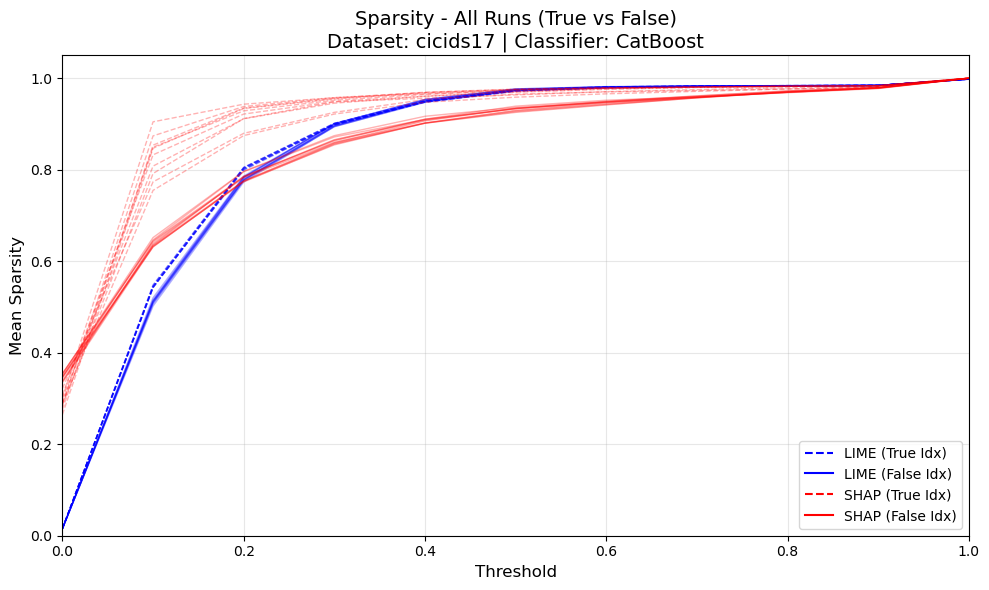

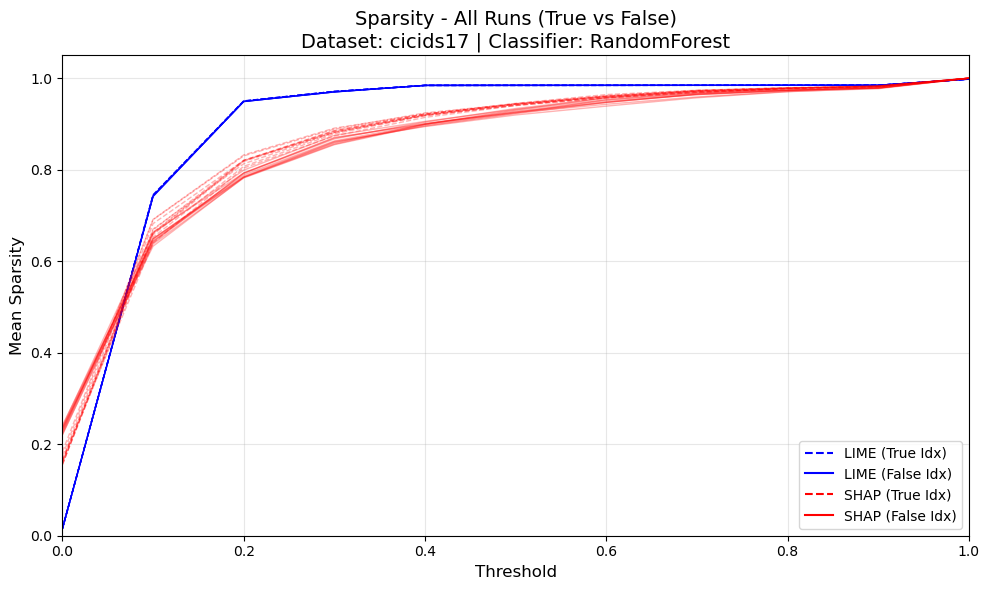

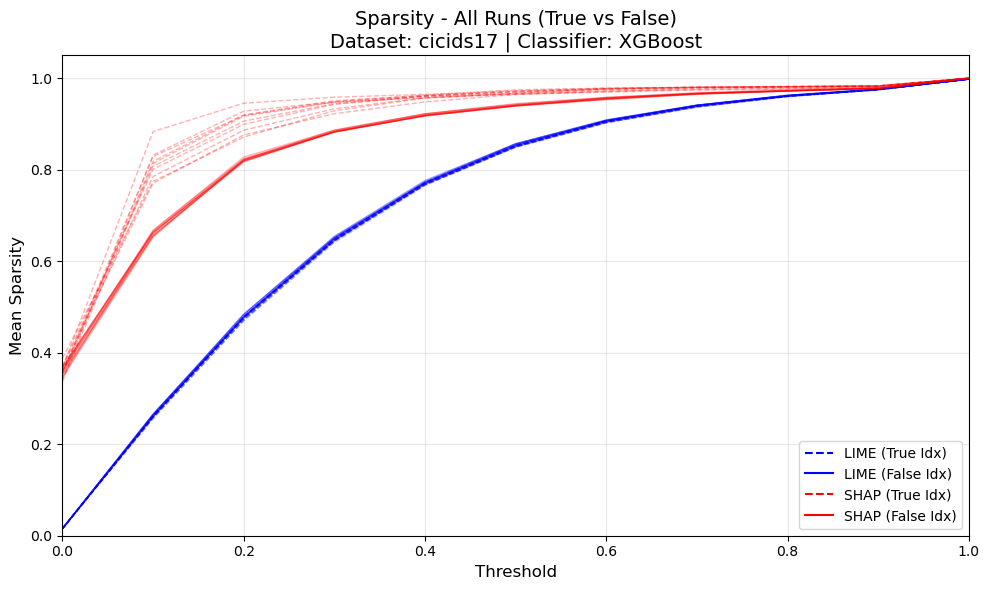

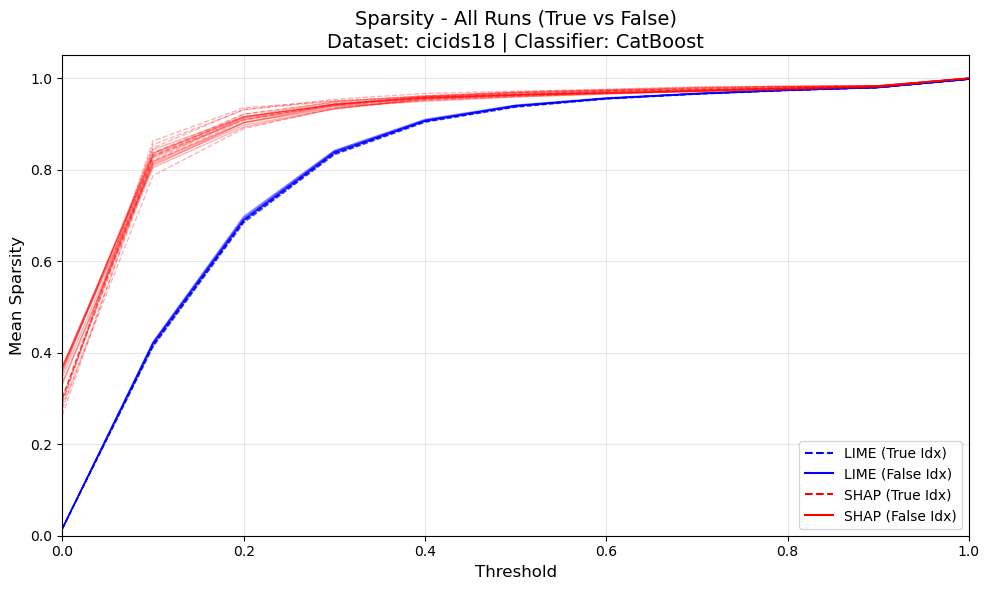

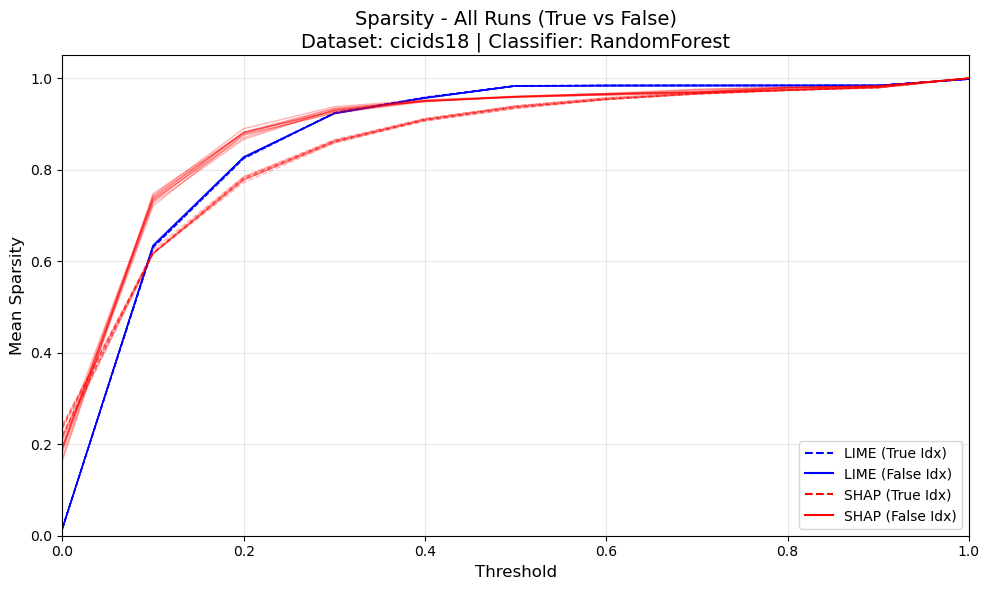

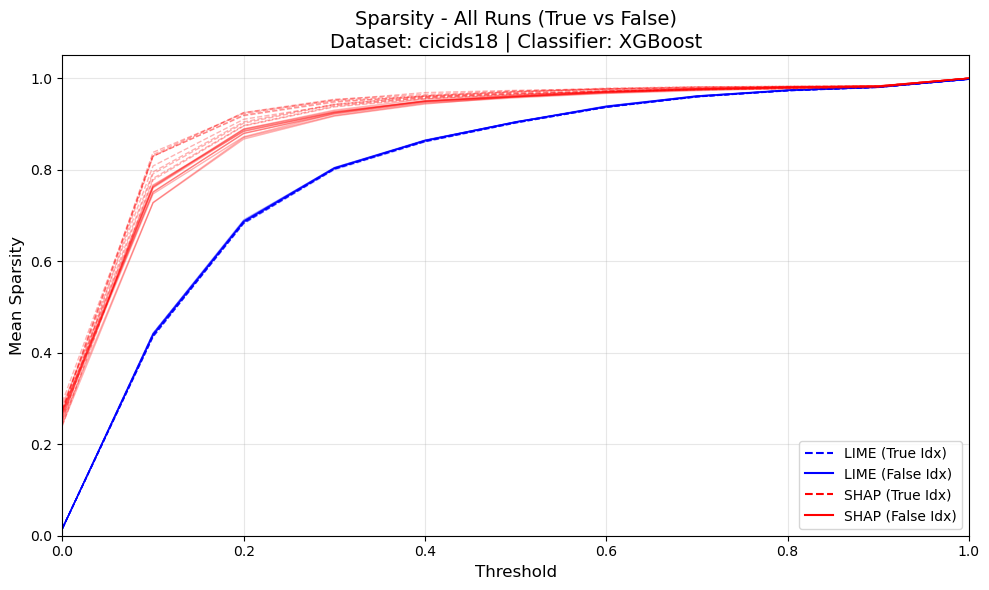

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# Options
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Load the CSV data
# Assuming the file is in the current directory or 'metrics/sparsity/'
try:
    df = pd.read_csv("metrics/sparsity/sparsity_means_all_runs.csv")
except FileNotFoundError:
    df = pd.read_csv("sparsity_means_all_runs.csv")

# Configuration
xai_colors = {'lime': 'blue', 'shap': 'red'}
# Mapping sample sets to line styles: True=Dashed, False=Solid
line_styles = {'true_idx': '--', 'false_idx': '-'} 

datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()

# Generate column names for the 10 runs
# We will look for columns like 'true_idx_run_1' ... 'true_idx_run_10'
run_indices = range(1, 11)

# --- Main Loop ---
for dataset in datasets:
    for classifier in classifiers:
        
        # Filter for the specific dataset and classifier
        subset = df[
            (df['dataset'] == dataset) &
            (df['classifier'] == classifier)
        ].sort_values('threshold') # Important: Sort by threshold for correct plotting
        
        if subset.empty:
            continue

        # Create a single figure for this combination
        fig, ax = plt.subplots(figsize=(10, 6))

        # Plot Loop
        for explainer in ['lime', 'shap']:
            # Filter by explainer
            explainer_data = subset[subset['explainer'].str.lower() == explainer]
            
            if explainer_data.empty:
                continue
                
            for sample_type in ['true_idx', 'false_idx']:
                style = line_styles[sample_type]
                color = xai_colors[explainer]
                
                # Iterate through all 10 runs for this sample type
                for i in run_indices:
                    col_name = f"{sample_type}_run_{i}"
                    
                    if col_name in explainer_data.columns:
                        ax.plot(
                            explainer_data['threshold'],
                            explainer_data[col_name],
                            color=color,
                            linestyle=style,
                            alpha=0.3,  # Transparency to handle overlapping lines
                            linewidth=1
                        )

        # Custom Legend Handles
        # We manually create legend entries because we have 40 lines but only 4 logical groups
        legend_elements = [
            Line2D([0], [0], color='blue', linestyle='--', label='LIME (True Idx)'),
            Line2D([0], [0], color='blue', linestyle='-',  label='LIME (False Idx)'),
            Line2D([0], [0], color='red',  linestyle='--', label='SHAP (True Idx)'),
            Line2D([0], [0], color='red',  linestyle='-',  label='SHAP (False Idx)')
        ]

        # Formatting
        ax.set_title(f"Sparsity - All Runs (True vs False)\nDataset: {dataset} | Classifier: {classifier}", fontsize=14)
        ax.set_xlabel("Threshold", fontsize=12)
        ax.set_ylabel("Mean Sparsity", fontsize=12)
        ax.set_ylim(0, 1.05)
        ax.set_xlim(0, 1.0)
        ax.grid(True, alpha=0.3)
        ax.legend(handles=legend_elements, fontsize=10, loc='lower right')

        plt.tight_layout()
        
        # Optional: Save the figure
        # filename = f"metrics/sparsity/sparsity_runs_{dataset}_{classifier}.png"
        # plt.savefig(filename, bbox_inches='tight')
        
        plt.show()

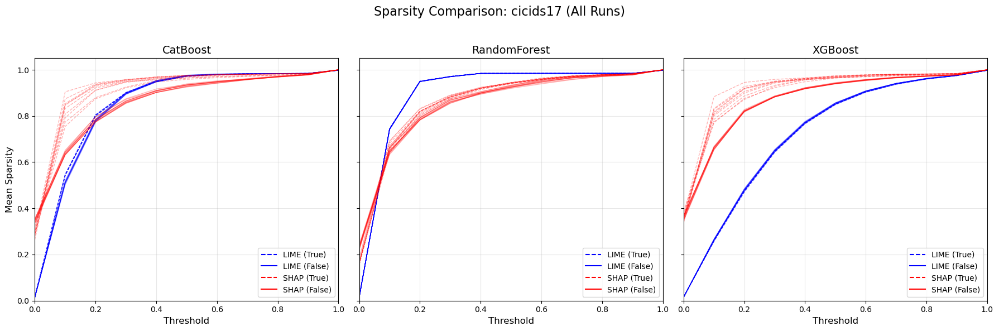

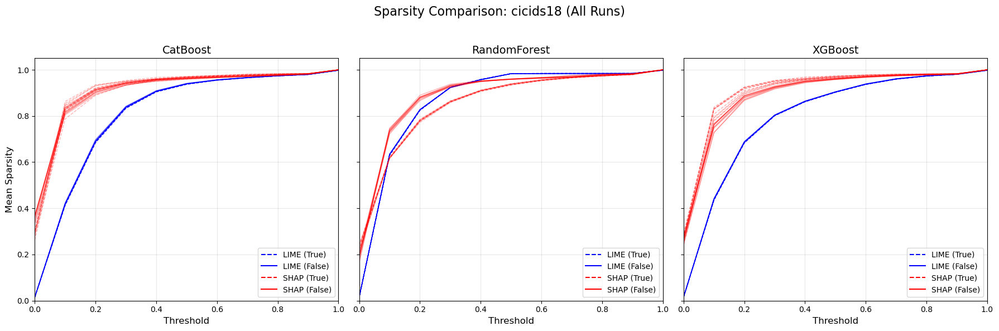

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# Options
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Load Data
try:
    df = pd.read_csv("metrics/sparsity/sparsity_means_all_runs.csv")
except FileNotFoundError:
    df = pd.read_csv("sparsity_means_all_runs.csv")

# Configuration
xai_colors = {'lime': 'blue', 'shap': 'red'}
line_styles = {'true_idx': '--', 'false_idx': '-'} 
run_indices = range(1, 11)

datasets = df['dataset'].unique()
classifiers = df['classifier'].unique()

# --- Main Loop ---
for dataset in datasets:
    # Create a figure with a row of subplots, one for each classifier
    # figsize=(18, 5) makes it wide enough for 3 plots
    fig, axes = plt.subplots(1, len(classifiers), figsize=(18, 6), sharey=True)
    
    # Ensure axes is iterable even if there's only one classifier
    if len(classifiers) == 1:
        axes = [axes]

    # Iterate through each classifier and its corresponding axis
    for ax, classifier in zip(axes, classifiers):
        
        # Filter for the specific dataset and classifier
        subset = df[
            (df['dataset'] == dataset) &
            (df['classifier'] == classifier)
        ].sort_values('threshold')
        
        # Formatting the subplot
        ax.set_title(f"{classifier}", fontsize=14)
        ax.set_xlabel("Threshold", fontsize=12)
        ax.set_ylim(0, 1.05)
        ax.set_xlim(0, 1.0)
        ax.grid(True, alpha=0.3)
        
        # If no data, skip plotting but keep the axis
        if subset.empty:
            continue

        # Plot Loop: Iterate Explainers -> Sample Sets -> Runs
        for explainer in ['lime', 'shap']:
            explainer_data = subset[subset['explainer'].str.lower() == explainer]
            
            if explainer_data.empty:
                continue
                
            for sample_type in ['true_idx', 'false_idx']:
                style = line_styles[sample_type]
                color = xai_colors[explainer]
                
                # Plot all 10 runs
                for i in run_indices:
                    col_name = f"{sample_type}_run_{i}"
                    
                    if col_name in explainer_data.columns:
                        ax.plot(
                            explainer_data['threshold'],
                            explainer_data[col_name],
                            color=color,
                            linestyle=style,
                            alpha=0.3,  # Transparency
                            linewidth=1
                        )
        
        # Only add Y-label to the first plot
        if ax == axes[0]:
            ax.set_ylabel("Mean Sparsity", fontsize=12)

        # Add legend to every plot (or you can move this outside the loop to have just one)
        legend_elements = [
            Line2D([0], [0], color='blue', linestyle='--', label='LIME (True)'),
            Line2D([0], [0], color='blue', linestyle='-',  label='LIME (False)'),
            Line2D([0], [0], color='red',  linestyle='--', label='SHAP (True)'),
            Line2D([0], [0], color='red',  linestyle='-',  label='SHAP (False)')
        ]
        ax.legend(handles=legend_elements, fontsize=10, loc='lower right')

    # Overall Figure formatting
    plt.suptitle(f"Sparsity Comparison: {dataset} (All Runs)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    
    # Optional: Save
    filename = f"metrics/sparsity/sparsity_all_runs_{dataset}_row.png"
    # plt.savefig(filename, bbox_inches='tight')
    
    plt.show()

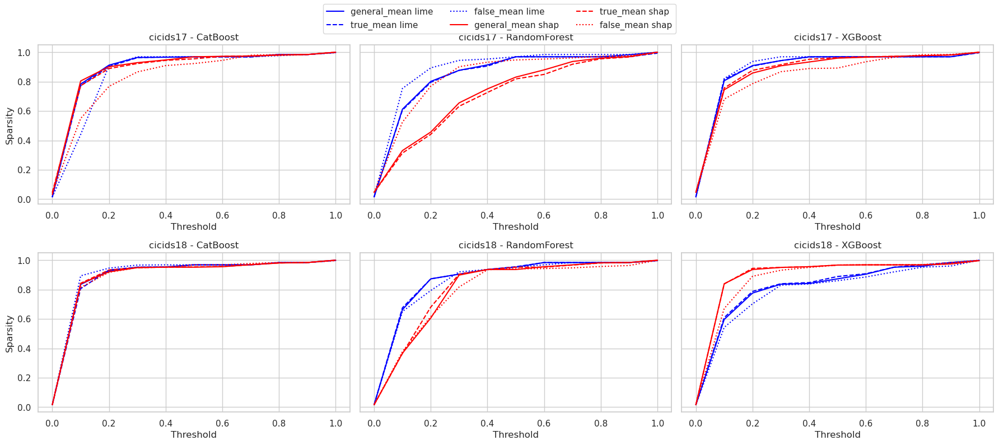

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

sparsity_df = pd.read_parquet("metrics/sparsity/all_models_all_explainers_sparsity.parquet")
columns = ["dataset", "model", "xai", "threshold", "general_mean", "true_mean", "false_mean"]
mean_sparsity = sparsity_df[columns]

datasets = mean_sparsity['dataset'].unique()
models = mean_sparsity['model'].unique()
xais = ['lime', 'shap']
colors = {'lime': 'blue', 'shap': 'red'}
linestyles = {'general_mean': '-', 'true_mean': '--', 'false_mean': ':'}

fig, axes = plt.subplots(len(datasets), len(models), figsize=(18, 8), sharey=True)

for i, dataset in enumerate(datasets):
    for j, model in enumerate(models):
        ax = axes[i, j] if len(datasets) > 1 else axes[j]
        for xai in xais:
            subset = mean_sparsity[
                (mean_sparsity['dataset'] == dataset) &
                (mean_sparsity['model'] == model) &
                (mean_sparsity['xai'] == xai)
            ]
            for mean_col in ['general_mean', 'true_mean', 'false_mean']:
                # Assign the label only for the first subplot to avoid duplicate legend entries
                label = f'{mean_col} {xai}' if (i == 0 and j == 0) else None
                ax.plot(
                    subset['threshold'],
                    subset[mean_col],
                    color=colors[xai],
                    linestyle=linestyles[mean_col],
                    label=label
                )
        ax.set_title(f'{dataset} - {model}')
        ax.set_xlabel('Threshold')
        if j == 0:
            ax.set_ylabel('Sparsity')
        ax.grid(True)


handles, labels = axes[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', ncol=3)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


#### Mean Sparsity - For Each Dataset | Model

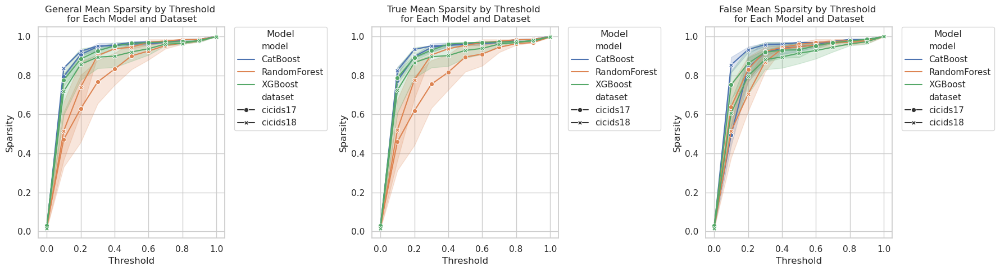

In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sparsity_df = pd.read_parquet("metrics/sparsity/all_models_all_explainers_sparsity.parquet")
columns = ["dataset", "model", "xai", "threshold", "general_mean", "true_mean", "false_mean"]
mean_sparsity = sparsity_df[columns]

mean_types = ["general_mean", "true_mean", "false_mean"]
titles = ["General Mean", "True Mean", "False Mean"]

sns.set(style="whitegrid")
plt.figure(figsize=(18, 5))

for idx, (mean_type, title) in enumerate(zip(mean_types, titles), 1):
    plt.subplot(1, 3, idx)
    sns.lineplot(
        data=mean_sparsity,
        x="threshold",
        y=mean_type,
        hue="model",
        style="dataset",
        markers=True,
        dashes=False
    )
    plt.title(f"{title} Sparsity by Threshold \nfor Each Model and Dataset")
    plt.xlabel("Threshold")
    plt.ylabel("Sparsity")
    plt.legend(title="Model", bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.tight_layout()
plt.show()


#### General Mean Sparsity - For Each Dataset | Model

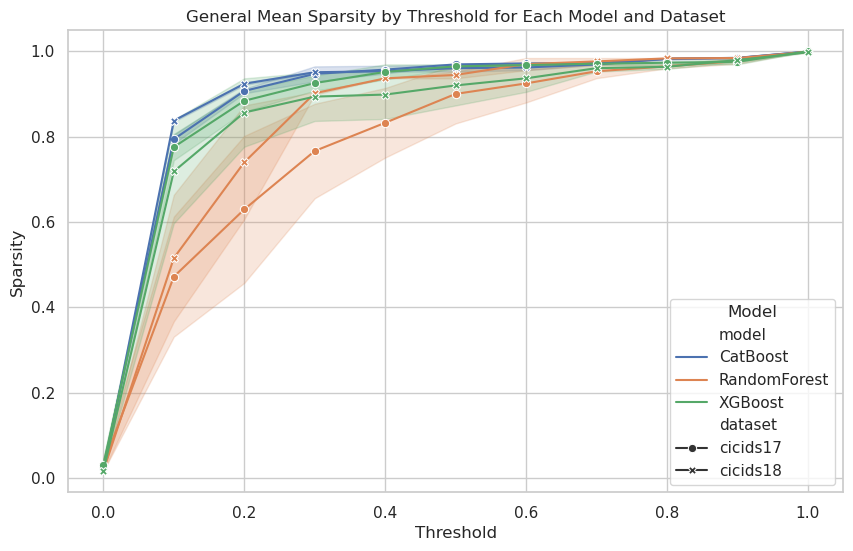

In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sparsity_df = pd.read_parquet("metrics/sparsity/all_models_all_explainers_sparsity.parquet")
columns = ["dataset", "model", "xai", "threshold", "general_mean", "true_mean", "false_mean"]
mean_sparsity = sparsity_df[columns]

plt.figure(figsize=(10, 6))
sns.set(style="whitegrid")

sns.lineplot(
    data=mean_sparsity,
    x="threshold",
    y="general_mean",
    hue="model",
    style="dataset",
    markers=True,
    dashes=False
)

plt.title("General Mean Sparsity by Threshold for Each Model and Dataset")
plt.xlabel("Threshold")
plt.ylabel("Sparsity")
plt.legend(title="Model")
plt.show()


#### Mean Sparsity - For each Dataset | Model | Sampleset | XAI

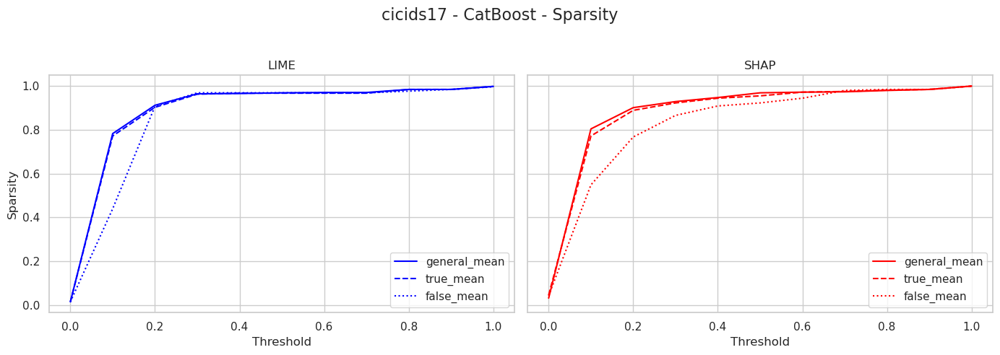

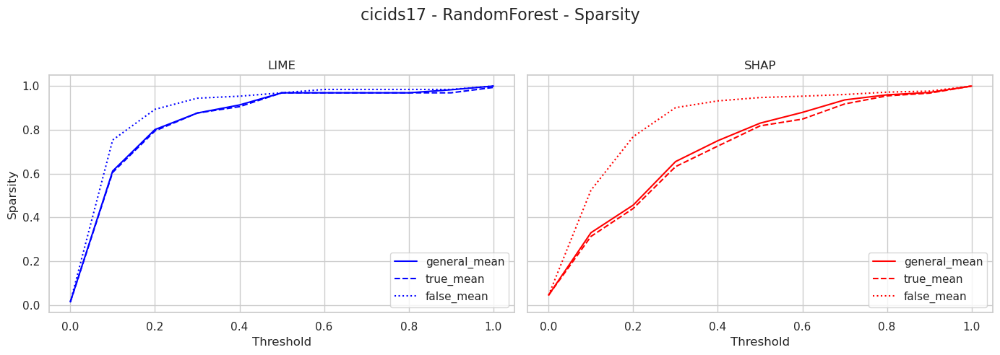

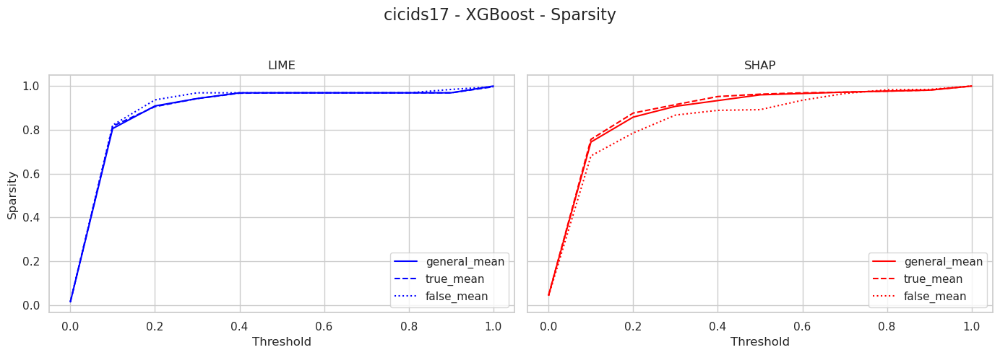

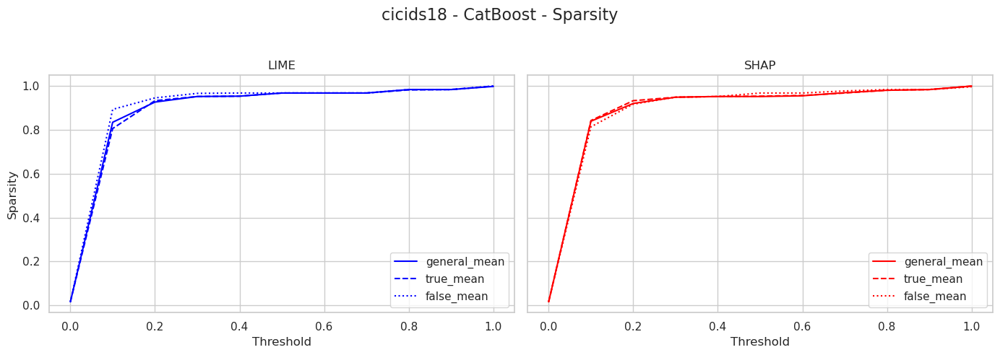

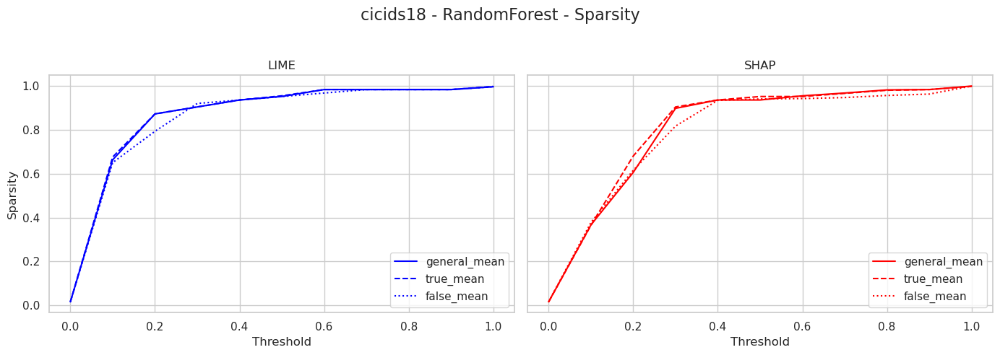

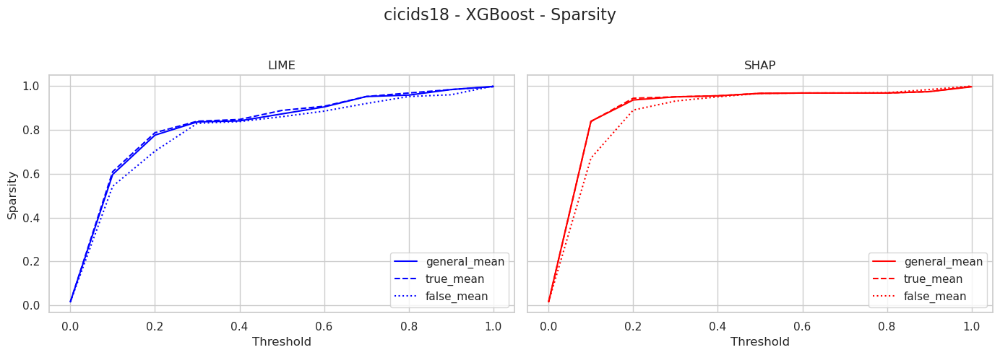

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import pandas as pd

sparsity_df = pd.read_parquet("metrics/sparsity/all_models_all_explainers_sparsity.parquet")
columns = ["dataset", "model", "xai", "threshold", "general_mean", "true_mean", "false_mean"]
mean_sparsity = sparsity_df[columns]


def plot_mean_sparsity(df):
    combos = df[['dataset', 'model']].drop_duplicates()
    for _, row in combos.iterrows():
        dat = row['dataset']
        model = row['model']
        subset = df[(df['dataset'] == dat) & (df['model'] == model)]
        
        fig, axes = plt.subplots(1, 2, figsize=(14, 5), sharey=True)
        fig.suptitle(f'{dat} - {model} - Sparsity', fontsize=16)
        
        for i, xai in enumerate(['lime', 'shap']):
            sub = subset[subset['xai'] == xai]
            c = 'blue' if xai == 'lime' else 'red'
            axes[i].plot(sub['threshold'], sub['general_mean'], label='general_mean', color=c)
            axes[i].plot(sub['threshold'], sub['true_mean'], label='true_mean', color=c, linestyle='--')
            axes[i].plot(sub['threshold'], sub['false_mean'], label='false_mean', color=c, linestyle=':')
            axes[i].set_title(xai.upper())
            axes[i].set_xlabel('Threshold')
            axes[i].legend()
            axes[i].grid(True)
        axes[0].set_ylabel('Sparsity')
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

plot_mean_sparsity(mean_sparsity)


# (3) Stability

## Stability (global)
Usage of VSI for both lime and shap, alternative local Lipschitz

n the context of evaluating explanation methods for deep learning in security, stability is a crucial, security-specific criterion for ensuring the reliability of an explanation. A method is considered stable if it consistently identifies the same set of relevant features for a specific input across multiple runs. It ensures that the generated explanations do not vary. This consistency is vital in security systems, as experts require dependable insights that remain unaffected by fluctuations over time. It is likely, that stability creates the trust needed by the analyst when making an assessment (Arreche et al., 2024, p. 23955; Warnecke et al, 2020, p. 164).

Arreche et al. ​(2024, p. 23969)​ used three runs to compare the overlap of features for the given samples. A stability of 1 within the top k features, would indicate perfect stability for the given explanation, and otherwise if the values approach 0. However, this work will expand the number of runs per explanation sample to 3, 5, and 10, as three runs appear to be insufficient for robust quantitative results. The number of top k features is set to 20 in the reference experiment, for this work k will be set to 5, 10 and 20. To calculate the stability score the following formula will be applied:

### Full Run - Store as Parquet

In [12]:
import pandas as pd
from collections import defaultdict
from ast import literal_eval
import json
import os
from datetime import datetime

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

random_state = 42
directory = 'explanation_data/'
all_files = os.listdir(directory)
explanations = sorted([f for f in all_files if os.path.isfile(os.path.join(directory, f))])

#datasets = ["cicids18"]
datasets = ["cicids17", "cicids18"]
model_names = ["CatBoost", "RandomForest", "XGBoost"]
xai_methods = ["lime", "shap"]
#samplesets = ["general_idx"]
samplesets = ["general_idx", "true_idx", "false_idx"]

run_bases = [3, 5, 10]

def parse_dataset(f):
    f = f.lower()
    if "cicids17" in f:
        return "cicids17"
    elif "cicids18" in f:
        return "cicids18"
    return None

def parse_model(f):
    f = f.lower()
    if "randomforest" in f or "rf" in f:
        return "RandomForest"
    elif "catboost" in f:
        return "CatBoost"
    elif "xgboost" in f or "xgb" in f:
        return "XGBoost"
    return None

def parse_explainer(f):
    f = f.lower()
    if "_lime_" in f:
        return "lime"
    elif "_shap_" in f:
        return "shap"
    return None

def compute_stability(feature_sets, k):
    #if not feature_sets:
    #    return 0.0
    intersection = set.intersection(*feature_sets)
    return round(len(intersection) / k, 4)


print("Available explanation files:")
for i in explanations:
    print(i)

rows = []

print("\nStarting Analysis")
for f in explanations:

    df = pd.read_csv(os.path.join(directory, f), index_col=0)
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Processing file: {f}")
    #print(df.info())
    #print(df.head())
    #print(len(df["sample_set"]))

    k_values = [5, 10, 20, 50, len(literal_eval(df["feature_value_pairs"].iloc[0]))]
    f = f.lower()
    #print(df.columns)

    dataset = parse_dataset(f)
    model = parse_model(f)
    explainer = parse_explainer(f)

    for sampleset in samplesets:
        list_of_idx = df[(df["explainer"] == explainer) &
                         (df["sample_set"] == sampleset)]["idx"].unique()
        #print(len(list_of_idx))
        #print(list_of_idx[:5])
        for idx in list_of_idx:
            sample_df = df[(df["explainer"] == explainer) &
                             (df["sample_set"] == sampleset) &
                             (df["idx"] == idx)]
            #print(sample_df.head(10))

            # stability logic
            for m in run_bases:
                run_ids = sample_df['run_nr'].unique()[:m]
                #print(run_ids)

                for k in k_values:
                    top_k_feature_sets = []
                    feature_sets_per_run = {}

                    for run in run_ids:
                        sample_row = sample_df[sample_df['run_nr'] == run]
                        features = literal_eval(sample_row['feature_value_pairs'].iloc[0])
                        sorted_features = sorted(features, key=lambda x: abs(x[1]), reverse=True)

                        top_k_list = [f for f, _ in sorted_features[:k]]
                        top_k_feature_sets.append(set(top_k_list))

                        run_label = f"run_{run}"

                        # additionally store feature names as semicolon-separated string for control
                        feature_sets_per_run[run_label] = ";".join(top_k_list)

                    stability_score = compute_stability(top_k_feature_sets, k)

                    rows.append({
                        "dataset": dataset,
                        "model": model,
                        "xai": explainer,
                        "sample_set": sampleset,
                        "idx": idx,
                        "runs_base": m,
                        "top_k": k,
                        "stability_score": stability_score,
                        **feature_sets_per_run
                    })
                #print(top_k_feature_sets)
                #print("")
#for r in rows:
#    print(r)

# create and store dataframe
df_results = pd.DataFrame(rows)

def rename_run_columns(df):
    run_cols = [c for c in df.columns if c.startswith("run_")]
    sorted_run_cols = sorted(run_cols, key=lambda x: int(x.split("_")[1]))
    # Rename to feature_set_run_X for clarity
    rename_map = {old: f"feature_set_{old}" for old in sorted_run_cols}
    return df.rename(columns=rename_map)

df_results = rename_run_columns(df_results)
#print(df_results)

output_path = "metrics/stability/"
os.makedirs(output_path, exist_ok=True)

parquet_file = os.path.join(output_path, "all_datasets_models_xai_stability.parquet")
df_results.to_parquet(parquet_file, index=False)
df_results.to_csv(output_path + "all_datasets_models_xai_stability.csv", index=False)
print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Saved results table to Parquet: {parquet_file}")


Available explanation files:
cicids17_CatBoost_lime_explanations.csv
cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
cicids17_RandomForest_lime_explanations.csv
cicids17_RandomForest_shap_kernel_smoothed_explanations.csv
cicids17_XGBoost_lime_explanations.csv
cicids17_XGBoost_shap_kernel_smoothed_explanations.csv
cicids18_CatBoost_lime_explanations.csv
cicids18_CatBoost_shap_kernel_explanations.csv
cicids18_RandomForest_lime_explanations.csv
cicids18_RandomForest_shap_kernel_explanations.csv
cicids18_XGBoost_lime_explanations.csv
cicids18_XGBoost_shap_kernel_explanations.csv

Starting Analysis
[2025-12-25 12:46:23] Processing file: cicids17_CatBoost_lime_explanations.csv
[2025-12-25 12:51:13] Processing file: cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
[2025-12-25 12:56:37] Processing file: cicids17_RandomForest_lime_explanations.csv


KeyboardInterrupt: 

In [ ]:
import pandas as pd

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")
print(df["idx"].unique())
print(df.head())

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 540 entries, 0 to 539
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   dataset             540 non-null    object 
 1   model               540 non-null    object 
 2   xai                 540 non-null    object 
 3   sample_set          540 non-null    object 
 4   idx                 540 non-null    int64  
 5   runs_base           540 non-null    int64  
 6   top_k               540 non-null    int64  
 7   stability_score     540 non-null    float64
 8   feature_set_run_1   540 non-null    object 
 9   feature_set_run_2   540 non-null    object 
 10  feature_set_run_3   540 non-null    object 
 11  feature_set_run_4   360 non-null    object 
 12  feature_set_run_5   360 non-null    object 
 13  feature_set_run_6   180 non-null    object 
 14  feature_set_run_7   180 non-null    object 
 15  feature_set_run_8   180 non-null    object 
 16  feature_

In [8]:
test = df[
    (df["dataset"] == "cicids17") &
    (df["model"] == "CatBoost") &
    (df["xai"] == "lime") &
    (df["sample_set"] == "general_idx") &
    (df["runs_base"] == 3) &
    (df["top_k"] == 5)
]

test.head()

,dataset,model,xai,sample_set,idx,runs_base,top_k,stability_score,feature_set_run_1,feature_set_run_2,feature_set_run_3,feature_set_run_4,feature_set_run_5,feature_set_run_6,feature_set_run_7,feature_set_run_8,feature_set_run_9,feature_set_run_10
0,cicids17,CatBoost,lime,general_idx,363001,3,5,0.4,Bwd Packet Length Std;Init_Win_bytes_backward;...,Bwd Packet Length Std;Destination Port;Flow Pa...,Bwd Packet Length Std;Destination Port;PSH Fla...,None,None,None,None,None,None,None


In [7]:
global_means = (df.groupby(['dataset', 
                     'model', 
                     'xai', 
                     'sample_set', 
                     'runs_base', 
                     'top_k'], as_index=False)['stability_score'].mean())
global_means.head(30)
#global_means.to_csv("/metrics/stability/stability_means_all_samplesets.csv", index=False)

,dataset,model,xai,sample_set,runs_base,top_k,stability_score
0,cicids17,CatBoost,lime,false_idx,3,5,0.80
1,cicids17,CatBoost,lime,false_idx,3,10,0.50
2,cicids17,CatBoost,lime,false_idx,3,20,0.40
3,cicids17,CatBoost,lime,false_idx,3,50,0.60
4,cicids17,CatBoost,lime,false_idx,3,65,1.00
5,cicids17,CatBoost,lime,false_idx,5,5,0.60
6,cicids17,CatBoost,lime,false_idx,5,10,0.50
7,cicids17,CatBoost,lime,false_idx,5,20,0.30
8,cicids17,CatBoost,lime,false_idx,5,50,0.44
9,cicids17,CatBoost,lime,false_idx,5,65,1.00


In [50]:
print(global_means[
    #(global_means['dataset'] == 'cicids17') &
    #(global_means['model'] == 'CatBoost') &
    #(global_means['xai'] == 'shap') &
    (global_means['sample_set'] == 'false_idx') &
    (global_means['runs_base'] == 3)
])

      dataset         model   xai sample_set  runs_base  top_k  stability_score
0    cicids17      CatBoost  lime  false_idx          3      5             0.80
1    cicids17      CatBoost  lime  false_idx          3     10             0.50
2    cicids17      CatBoost  lime  false_idx          3     20             0.40
3    cicids17      CatBoost  lime  false_idx          3     50             0.60
4    cicids17      CatBoost  lime  false_idx          3     65             1.00
45   cicids17      CatBoost  shap  false_idx          3      5             0.80
46   cicids17      CatBoost  shap  false_idx          3     10             0.80
47   cicids17      CatBoost  shap  false_idx          3     20             0.80
48   cicids17      CatBoost  shap  false_idx          3     50             0.86
49   cicids17      CatBoost  shap  false_idx          3     65             1.00
90   cicids17  RandomForest  lime  false_idx          3      5             0.60
91   cicids17  RandomForest  lime  false

#### Significance Lime vs Shap

Compares e.g. false_idx explanations of LIME vs SHAP. For the thesis, only a comparison of general_idx is used


Processing dataset: cicids17, sample_set: false_idx
     dataset         model   xai sample_set  runs_base     top_5    top_10    top_20    top_50  top_65
0   cicids17      CatBoost  lime  false_idx          3  0.474053  0.374614  0.315568  0.693492     1.0
1   cicids17      CatBoost  lime  false_idx          5  0.418513  0.311360  0.219144  0.526283     1.0
2   cicids17      CatBoost  lime  false_idx         10  0.365778  0.263394  0.166690  0.352763     1.0
3   cicids17      CatBoost  shap  false_idx          3  0.725105  0.701262  0.660168  0.782440     1.0
4   cicids17      CatBoost  shap  false_idx          5  0.663955  0.607714  0.584362  0.689481     1.0
5   cicids17      CatBoost  shap  false_idx         10  0.579523  0.500281  0.502034  0.579832     1.0
6   cicids17  RandomForest  lime  false_idx          3  0.668200  0.690600  0.611650  0.708960     1.0
7   cicids17  RandomForest  lime  false_idx          5  0.598800  0.624100  0.533950  0.580600     1.0
8   cicids17  Random

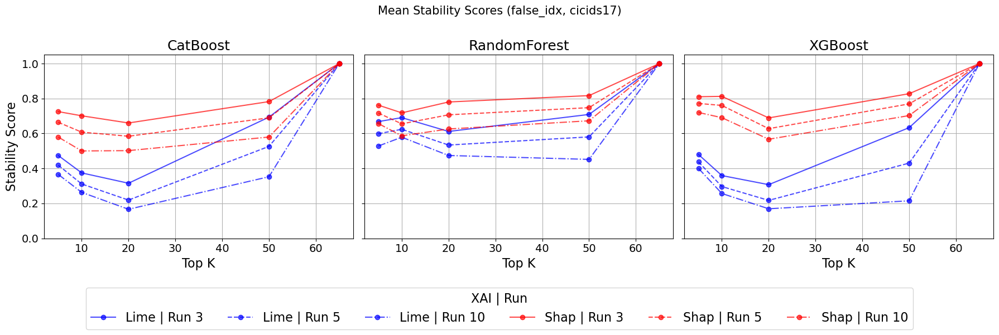


Processing dataset: cicids17, sample_set: general_idx
     dataset         model   xai   sample_set  runs_base   top_5  top_10   top_20   top_50  top_65
0   cicids17      CatBoost  lime  general_idx          3  0.3186  0.2578  0.25590  0.61528     1.0
1   cicids17      CatBoost  lime  general_idx          5  0.2628  0.1860  0.16015  0.39786     1.0
2   cicids17      CatBoost  lime  general_idx         10  0.2192  0.1426  0.10975  0.16890     1.0
3   cicids17      CatBoost  shap  general_idx          3  0.7720  0.6694  0.56460  0.75630     1.0
4   cicids17      CatBoost  shap  general_idx          5  0.6908  0.6060  0.49465  0.64268     1.0
5   cicids17      CatBoost  shap  general_idx         10  0.4996  0.4715  0.38285  0.51002     1.0
6   cicids17  RandomForest  lime  general_idx          3  0.5964  0.6563  0.57565  0.69634     1.0
7   cicids17  RandomForest  lime  general_idx          5  0.5182  0.5837  0.48835  0.56002     1.0
8   cicids17  RandomForest  lime  general_idx         

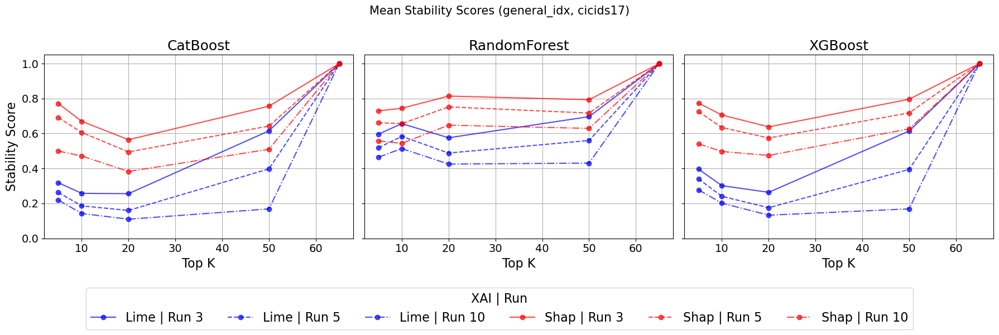


Processing dataset: cicids17, sample_set: true_idx
     dataset         model   xai sample_set  runs_base   top_5  top_10   top_20   top_50  top_65
0   cicids17      CatBoost  lime   true_idx          3  0.3222  0.2644  0.25315  0.61586     1.0
1   cicids17      CatBoost  lime   true_idx          5  0.2664  0.1900  0.15670  0.39438     1.0
2   cicids17      CatBoost  lime   true_idx         10  0.2190  0.1423  0.10785  0.16630     1.0
3   cicids17      CatBoost  shap   true_idx          3  0.7756  0.6678  0.56765  0.75682     1.0
4   cicids17      CatBoost  shap   true_idx          5  0.6886  0.6122  0.50040  0.64616     1.0
5   cicids17      CatBoost  shap   true_idx         10  0.4958  0.4769  0.39090  0.51570     1.0
6   cicids17  RandomForest  lime   true_idx          3  0.5856  0.6609  0.57385  0.69346     1.0
7   cicids17  RandomForest  lime   true_idx          5  0.5130  0.5844  0.48535  0.55610     1.0
8   cicids17  RandomForest  lime   true_idx         10  0.4634  0.5111  0.4

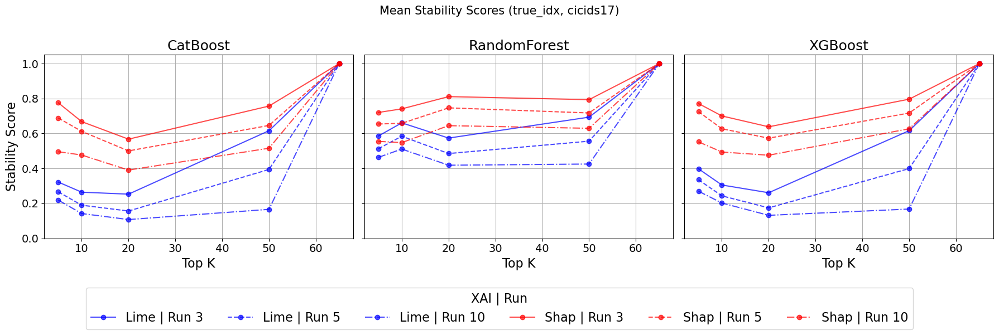


Processing dataset: cicids18, sample_set: false_idx
     dataset         model   xai sample_set  runs_base   top_5  top_10   top_20   top_50  top_63
0   cicids18      CatBoost  lime  false_idx          3  0.4370  0.2927  0.24360  0.64852     1.0
1   cicids18      CatBoost  lime  false_idx          5  0.3864  0.2427  0.16125  0.43596     1.0
2   cicids18      CatBoost  lime  false_idx         10  0.3288  0.2048  0.13320  0.19378     1.0
3   cicids18      CatBoost  shap  false_idx          3  0.7564  0.7294  0.66010  0.79384     1.0
4   cicids18      CatBoost  shap  false_idx          5  0.7162  0.6791  0.58370  0.71134     1.0
5   cicids18      CatBoost  shap  false_idx         10  0.6572  0.5995  0.51180  0.61440     1.0
6   cicids18  RandomForest  lime  false_idx          3  0.6784  0.6928  0.63815  0.71512     1.0
7   cicids18  RandomForest  lime  false_idx          5  0.6114  0.6095  0.56150  0.57884     1.0
8   cicids18  RandomForest  lime  false_idx         10  0.5522  0.5368  0.

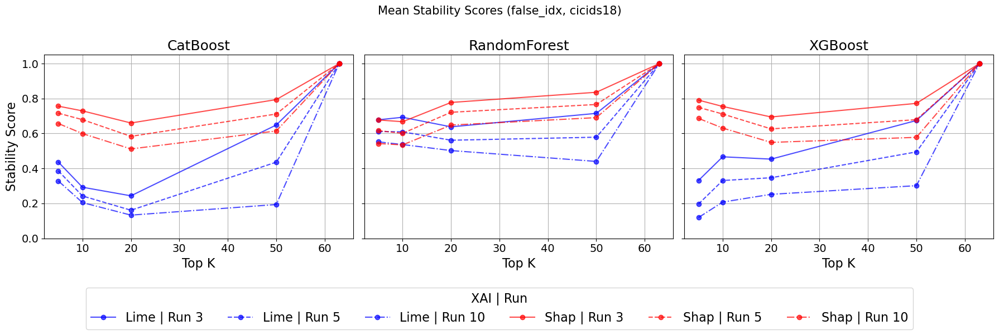


Processing dataset: cicids18, sample_set: general_idx
     dataset         model   xai   sample_set  runs_base   top_5  top_10   top_20   top_50  top_63
0   cicids18      CatBoost  lime  general_idx          3  0.4550  0.2978  0.25315  0.65164     1.0
1   cicids18      CatBoost  lime  general_idx          5  0.4054  0.2510  0.17215  0.44168     1.0
2   cicids18      CatBoost  lime  general_idx         10  0.3424  0.2134  0.14135  0.20220     1.0
3   cicids18      CatBoost  shap  general_idx          3  0.7254  0.7004  0.63730  0.76014     1.0
4   cicids18      CatBoost  shap  general_idx          5  0.6808  0.6513  0.55950  0.65402     1.0
5   cicids18      CatBoost  shap  general_idx         10  0.5988  0.5645  0.47885  0.53662     1.0
6   cicids18  RandomForest  lime  general_idx          3  0.6838  0.6746  0.61710  0.71534     1.0
7   cicids18  RandomForest  lime  general_idx          5  0.6200  0.5934  0.54125  0.57840     1.0
8   cicids18  RandomForest  lime  general_idx         

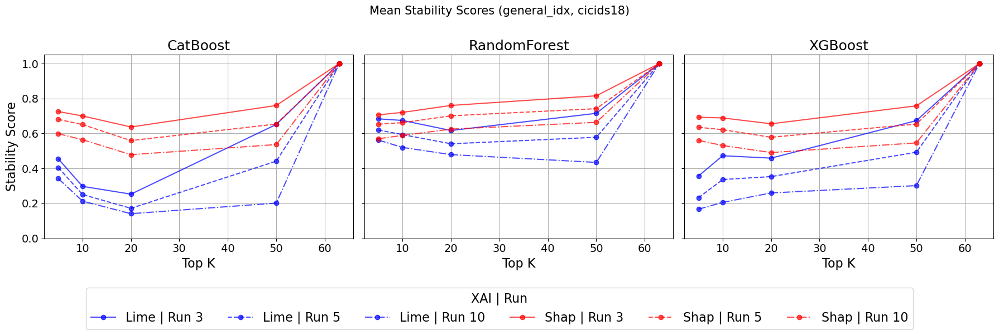


Processing dataset: cicids18, sample_set: true_idx
     dataset         model   xai sample_set  runs_base   top_5  top_10   top_20   top_50  top_63
0   cicids18      CatBoost  lime   true_idx          3  0.4478  0.2966  0.25295  0.65272     1.0
1   cicids18      CatBoost  lime   true_idx          5  0.3992  0.2509  0.17055  0.44292     1.0
2   cicids18      CatBoost  lime   true_idx         10  0.3428  0.2172  0.14295  0.20512     1.0
3   cicids18      CatBoost  shap   true_idx          3  0.7300  0.6962  0.63785  0.76140     1.0
4   cicids18      CatBoost  shap   true_idx          5  0.6806  0.6459  0.56000  0.66190     1.0
5   cicids18      CatBoost  shap   true_idx         10  0.6060  0.5625  0.47480  0.54316     1.0
6   cicids18  RandomForest  lime   true_idx          3  0.6828  0.6661  0.60775  0.71242     1.0
7   cicids18  RandomForest  lime   true_idx          5  0.6198  0.5804  0.52875  0.57150     1.0
8   cicids18  RandomForest  lime   true_idx         10  0.5530  0.5072  0.4

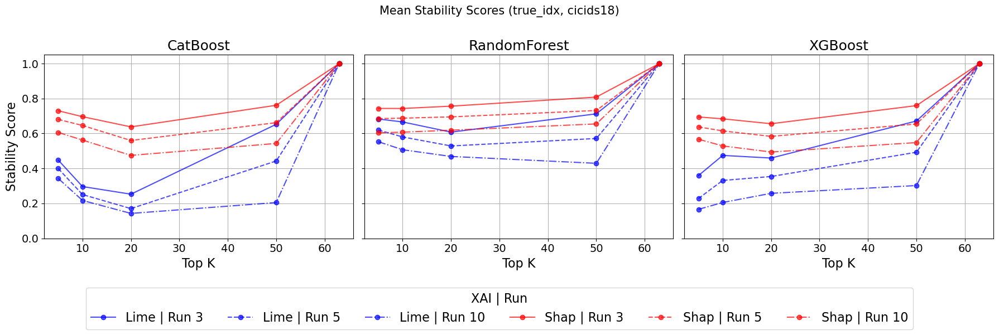

Merged wide table saved to: metrics/stability/stability_all_tables_merged.csv


In [33]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Display options
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")

df_melted = df.melt(
    id_vars=['dataset', 'model', 'explainer', 'sampleset', 'idx', 'k'],
    value_vars=['runs_3', 'runs_5', 'runs_10'],
    var_name='runs_str',
    value_name='stability_score'
)

# Extract the numeric value for runs (e.g., 'runs_3' -> 3)
df_melted['runs_base'] = df_melted['runs_str'].str.extract(r'(\d+)').astype(int)

# Rename columns to match plotting logic
df_melted = df_melted.rename(columns={
    'explainer': 'xai',
    'sampleset': 'sample_set',
    'k': 'top_k'
})

# -----------------------------------------------------------------------------
# 3. Calculate global means (aggregating over all 'idx')
# -----------------------------------------------------------------------------
global_means = df_melted.groupby(
    ['dataset', 'model', 'xai', 'sample_set', 'runs_base', 'top_k'],
    as_index=False
)['stability_score'].mean()

# (Optional) save global means as a single CSV
os.makedirs("metrics/stability", exist_ok=True)
global_means.to_csv("metrics/stability/stability_global_means_all.csv", index=False)

# -----------------------------------------------------------------------------
# 4. Plotting setup
# -----------------------------------------------------------------------------
xai_palette = {"lime": "blue", "shap": "red"}
run_styles = ['-', '--', '-.', ':']
datasets = global_means['dataset'].unique()
sample_sets = global_means['sample_set'].unique()

os.makedirs("metrics/stability/plots", exist_ok=True)

# Collect all wide tables to merge later
all_tables = []

# -----------------------------------------------------------------------------
# 5. Loop over dataset × sample_set, build wide tables, plot, and collect
# -----------------------------------------------------------------------------
for target_dataset in datasets:
    for sample_set in sample_sets:
        print(f"\nProcessing dataset: {target_dataset}, sample_set: {sample_set}")
        
        # Filter data
        df_filtered = global_means[
            (global_means["dataset"] == target_dataset) &
            (global_means["sample_set"] == sample_set)
        ]
        
        if df_filtered.empty:
            print("No data found.")
            continue

        # Pivot for table view (and to identify Top K columns easily)
        df_wide = df_filtered.pivot_table(
            index=["dataset", "model", "xai", "sample_set", "runs_base"],
            columns="top_k",
            values="stability_score"
        ).reset_index()
        
        df_wide.columns.name = None
        # Rename integer columns to 'top_X'
        df_wide = df_wide.rename(columns=lambda c: f"top_{c}" if isinstance(c, int) else c)

        print(df_wide)
        
        # Identify top_k columns and sort them numerically
        topk_cols = sorted(
            [col for col in df_wide.columns if col.startswith("top_")],
            key=lambda x: int(x.split("_")[1])
        )
        
        # Append this wide table to the list for later merging
        all_tables.append(df_wide)

        # (Optional) per-dataset/sample_set CSV if you still want it:
        # table_filename = f"metrics/stability/plots/stability_{target_dataset}_{sample_set}_table.csv"
        # df_wide.to_csv(table_filename, index=False)
        # print(f"Table saved to: {table_filename}")

        # Setup plot
        models = df_wide["model"].unique()
        fig, axs = plt.subplots(1, len(models), figsize=(6 * len(models), 5), sharey=True)
        
        # Handle case if there is only one model (axs is not a list)
        if len(models) == 1:
            axs = [axs]

        for m_idx, model in enumerate(models):
            ax = axs[m_idx]
            
            # Iterate through XAI methods (Lime, Shap)
            for xai in ['lime', 'shap']:
                subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
                if subset.empty:
                    continue
                
                # Sort by runs so line styles are consistent
                subset = subset.sort_values('runs_base')
                
                for r_idx, (_, row) in enumerate(subset.iterrows()):
                    run = row["runs_base"]
                    label = f"{xai.capitalize()} | Run {run}"
                    style = run_styles[r_idx % len(run_styles)]
                    color = xai_palette.get(xai, "black")
                    
                    # Plot line
                    ax.plot(
                        [int(col.split("_")[1]) for col in topk_cols],  # x: K values
                        [row[col] for col in topk_cols],               # y: stability scores
                        label=label,
                        color=color,
                        linestyle=style,
                        marker='o',
                        markersize=6,
                        alpha=0.7,
                        linewidth=1.5
                    )

            # Subplot formatting
            ax.set_title(model, fontsize=18)
            ax.set_xlabel("Top K", fontsize=16)
            
            if m_idx == 0:
                ax.set_ylabel("Stability Score", fontsize=16)
            
            ax.set_ylim(0, 1.05)
            ax.tick_params(axis='both', which='major', labelsize=14)
            ax.grid(True)

        # Global legend (take handles from first axis)
        handles, labels = axs[0].get_legend_handles_labels()
        fig.legend(
            handles, labels,
            loc='upper center',
            bbox_to_anchor=(0.5, -0.01),
            fancybox=True,
            shadow=False,
            ncol=max(1, len(labels)),
            fontsize=16,
            title="XAI | Run",
            title_fontsize=16
        )

        # Global figure formatting
        plt.suptitle(f"Mean Stability Scores ({sample_set}, {target_dataset})", fontsize=15)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        
        # Save plot
        plot_filename = f"metrics/stability/plots/stability_{target_dataset}_all_models_{sample_set}.png"
        plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
        print(f"Plot saved to: {plot_filename}")
        plt.show()

# -----------------------------------------------------------------------------
# 6. Merge all wide tables into a single CSV
# -----------------------------------------------------------------------------
if all_tables:
    merged_tables = pd.concat(all_tables, ignore_index=True)
    merged_csv_path = "metrics/stability/stability_all_tables_merged.csv"
    merged_tables.to_csv(merged_csv_path, index=False)
    print(f"Merged wide table saved to: {merged_csv_path}")
else:
    print("No wide tables were created; nothing to merge.")



Processing dataset: cicids17, sample_set: false_idx
Table saved to: metrics/stability/plots/stability_cicids17_false_idx_table.csv


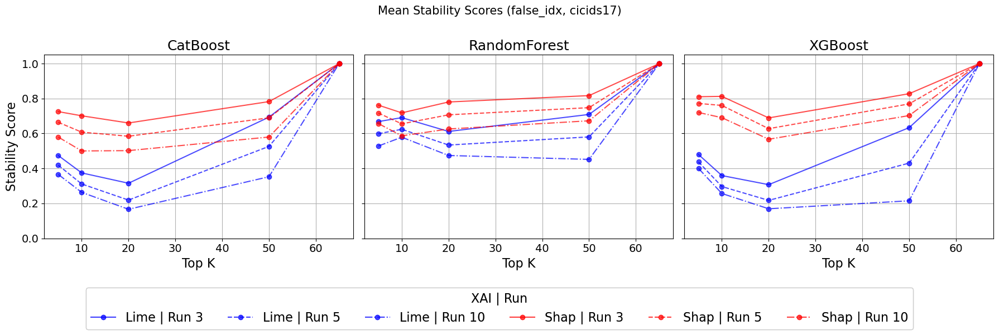


Processing dataset: cicids17, sample_set: general_idx
Table saved to: metrics/stability/plots/stability_cicids17_general_idx_table.csv


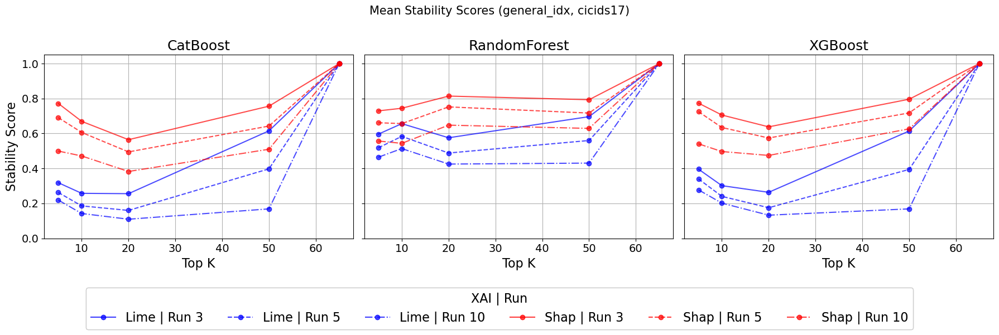


Processing dataset: cicids17, sample_set: true_idx
Table saved to: metrics/stability/plots/stability_cicids17_true_idx_table.csv


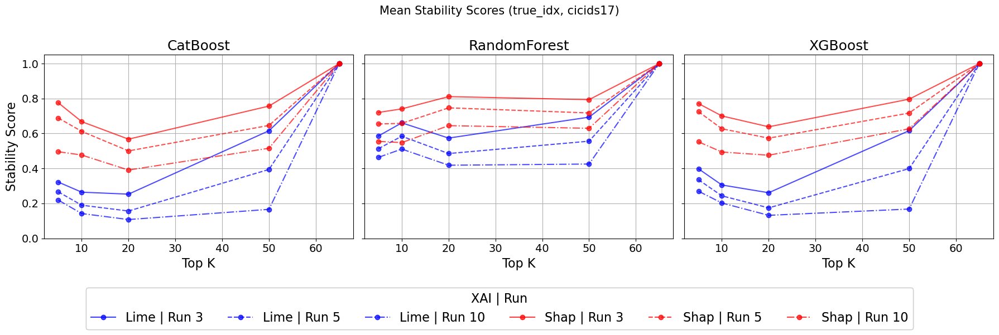


Processing dataset: cicids18, sample_set: false_idx
Table saved to: metrics/stability/plots/stability_cicids18_false_idx_table.csv


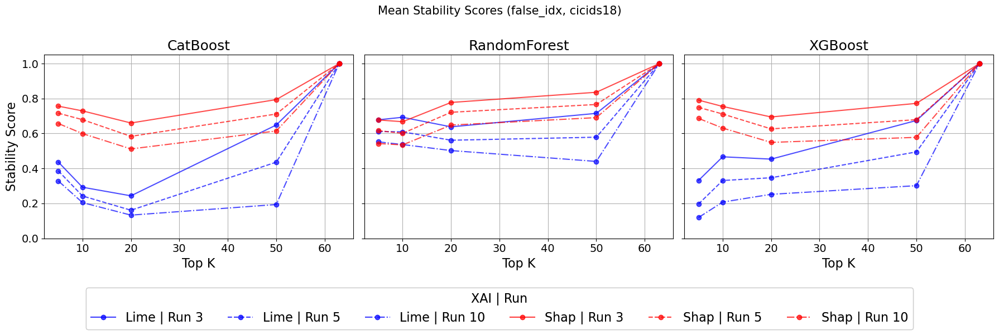


Processing dataset: cicids18, sample_set: general_idx
Table saved to: metrics/stability/plots/stability_cicids18_general_idx_table.csv


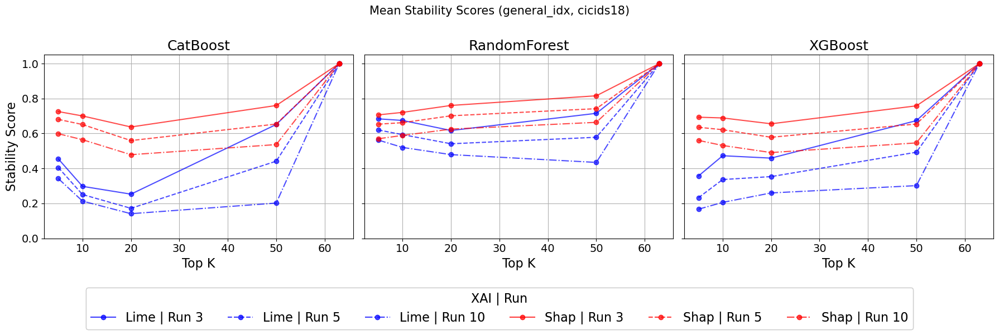


Processing dataset: cicids18, sample_set: true_idx
Table saved to: metrics/stability/plots/stability_cicids18_true_idx_table.csv


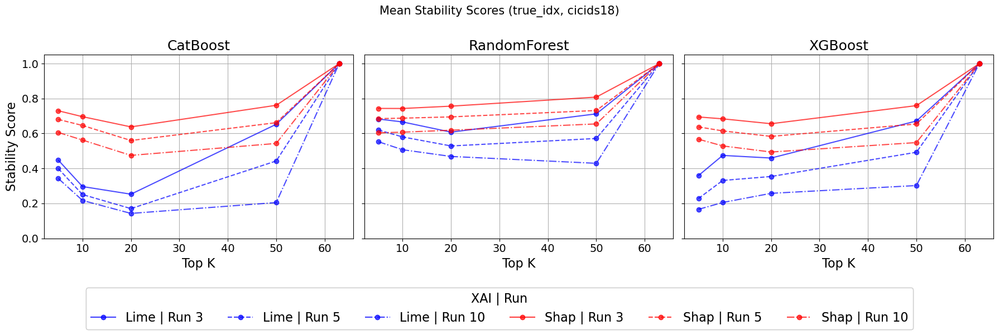

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Load data
df = pd.read_parquet("metrics/stability/stability_reduced.parquet")

df_melted = df.melt(
    id_vars=['dataset', 'model', 'explainer', 'sampleset', 'idx', 'k'], 
    value_vars=['runs_3', 'runs_5', 'runs_10'],
    var_name='runs_str', 
    value_name='stability_score'
)

# Extract the numeric value for runs (e.g., 'runs_3' -> 3)
df_melted['runs_base'] = df_melted['runs_str'].str.extract(r'(\d+)').astype(int)

# Rename columns to match the plotting script's logic
df_melted = df_melted.rename(columns={
    'explainer': 'xai',
    'sampleset': 'sample_set',
    'k': 'top_k'
})

# Calculate Global Means (aggregating over all 'idx')
global_means = df_melted.groupby(
    ['dataset', 'model', 'xai', 'sample_set', 'runs_base', 'top_k'], 
    as_index=False
)['stability_score'].mean()

xai_palette = {"lime": "blue", "shap": "red"}
run_styles = ['-', '--', '-.', ':']
datasets = global_means['dataset'].unique()
sample_sets = global_means['sample_set'].unique()

os.makedirs("metrics/stability/plots", exist_ok=True)

for target_dataset in datasets:
    for sample_set in sample_sets:
        print(f"\nProcessing dataset: {target_dataset}, sample_set: {sample_set}")
        
        # Filter data
        df_filtered = global_means[
            (global_means["dataset"] == target_dataset) &
            (global_means["sample_set"] == sample_set)
        ]
        
        if df_filtered.empty:
            print("No data found.")
            continue

        # Pivot for Table View (and to identify Top K columns easily)
        df_wide = df_filtered.pivot_table(
            index=["dataset", "model", "xai", "sample_set", "runs_base"],
            columns="top_k",
            values="stability_score"
        ).reset_index()
        
        df_wide.columns.name = None
        # Rename integer columns to 'top_X'
        df_wide = df_wide.rename(columns=lambda c: f"top_{c}" if isinstance(c, int) else c)
        
        # Identify top_k columns and sort them numerically
        topk_cols = sorted(
            [col for col in df_wide.columns if col.startswith("top_")],
            key=lambda x: int(x.split("_")[1])
        )
        
        # Save CSV Table
        table_filename = f"metrics/stability/plots/stability_{target_dataset}_{sample_set}_table.csv"
        #df_wide.to_csv(table_filename, index=False)
        print(f"Table saved to: {table_filename}")

        # Setup Plot
        models = df_wide["model"].unique()
        fig, axs = plt.subplots(1, len(models), figsize=(6 * len(models), 5), sharey=True)
        
        # Handle case if there is only one model (axs is not a list)
        if len(models) == 1:
            axs = [axs]

        for m_idx, model in enumerate(models):
            ax = axs[m_idx]
            
            # Iterate through XAI methods (Lime, Shap)
            for xai in ['lime', 'shap']:
                subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
                if subset.empty:
                    continue
                
                # Sort by runs so line styles are consistent
                subset = subset.sort_values('runs_base')
                
                for r_idx, (_, row) in enumerate(subset.iterrows()):
                    run = row["runs_base"]
                    label = f"{xai.capitalize()} | Run {run}"
                    style = run_styles[r_idx % len(run_styles)]
                    color = xai_palette.get(xai, "black")
                    
                    # Plot line
                    ax.plot(
                        [int(col.split("_")[1]) for col in topk_cols], 
                        [row[col] for col in topk_cols],               
                        label=label,
                        color=color,
                        linestyle=style,
                        marker='o',
                        markersize=6, # Slightly larger markers
                        alpha=0.7,
                        linewidth=1.5   # Slightly thicker lines
                    )

            # Subplot Formatting
            ax.set_title(model, fontsize=18)#, fontweight='bold')
            ax.set_xlabel("Top K", fontsize=16)
            
            if m_idx == 0:
                ax.set_ylabel("Stability Score", fontsize=16)
            
            ax.set_ylim(0, 1.05)
            #ax.legend(fontsize=7, title="XAI | Run", loc="lower right")
            ax.tick_params(axis='both', which='major', labelsize=14)
            
            
            ax.grid(True)

            handles, labels = axs[0].get_legend_handles_labels()
            fig.legend(
                handles, labels,
                loc='upper center',
                bbox_to_anchor=(0.5, -0.01),
                fancybox=True,
                shadow=False,
                ncol=len(labels),
                fontsize=16,
                title="XAI | Run",
                title_fontsize=16
            )

        # Global Figure Formatting
        plt.suptitle(f"Mean Stability Scores ({sample_set}, {target_dataset})", fontsize=15)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        
        # Save Plot
        plot_filename = f"metrics/stability/plots/stability_{target_dataset}_all_models_{sample_set}.png"
        #plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
        plt.show()

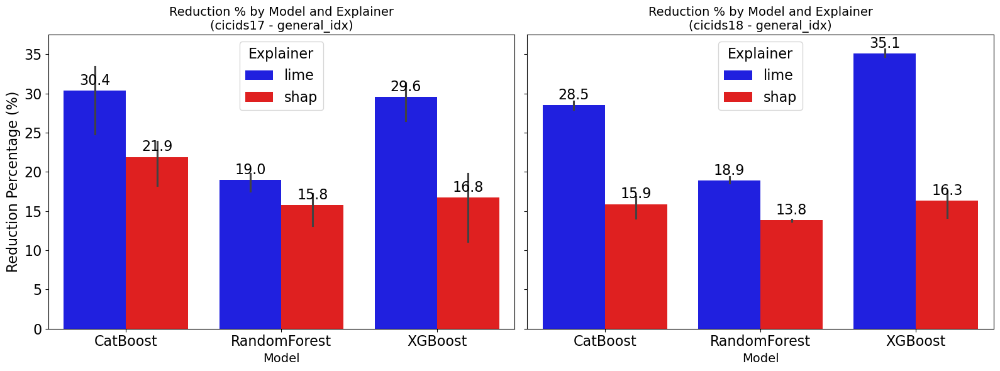

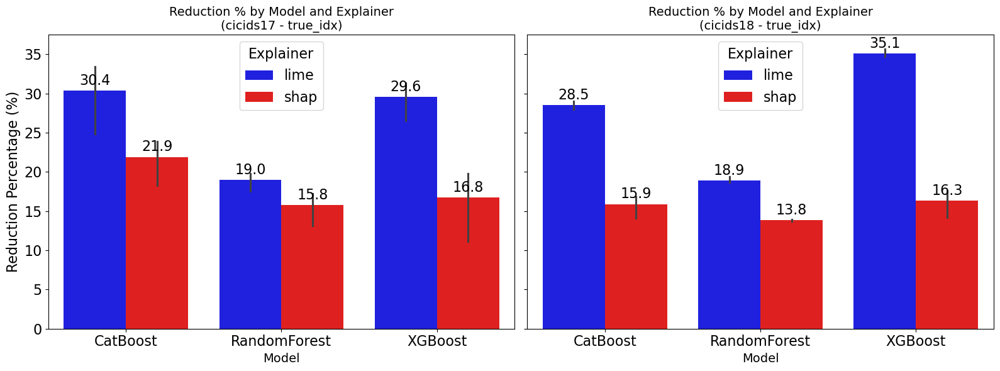

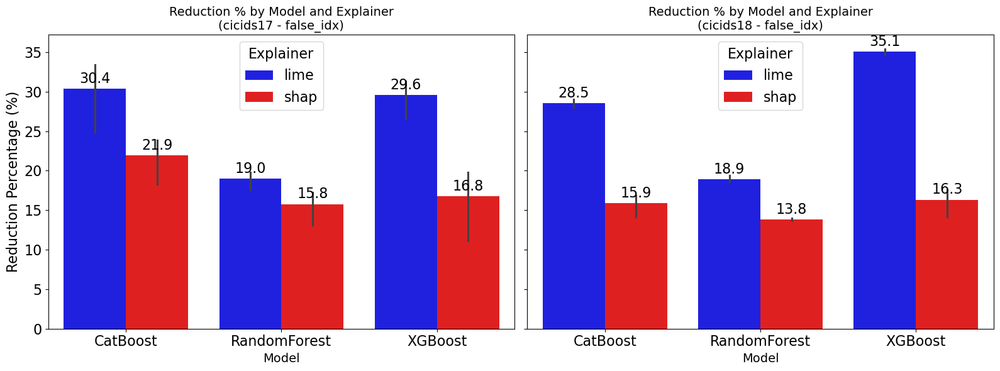

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Load data
df = pd.read_parquet("metrics/stability/stability_reduced.parquet")
group_columns = ['dataset', 'model', 'explainer', 'sampleset', 'k']

# Define Font Size
FS = 16

for sampleset in ["general_idx", "true_idx", "false_idx"]:
    
    # Calculate mean over all idx for each group
    mean_df = df.groupby(group_columns)[['runs_3', 'runs_5', 'runs_10']].mean().reset_index()
    mean_df = mean_df[mean_df["sampleset"] == sampleset]
    
    #if sampleset == "general_idx":
    #    mean_df.to_csv("metrics/sparsity/sparsity_means_all_samplesets_reduced.csv", index=False)
    
    # Calculate difference percentage
    grouped_means = df.groupby(['dataset', 'model', 'explainer', 'sampleset'])[['runs_3', 'runs_10']].mean().reset_index()
    grouped_means['difference_%'] = ((grouped_means['runs_3'] - grouped_means['runs_10']) / grouped_means['runs_3']) * 100
    
    palette_colors = {'lime': 'blue', 'shap': 'red'}
    
    fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)
    
    # --- Plot for cicids17 ---
    df_cicids17 = grouped_means[grouped_means['dataset'] == 'cicids17']
    sns.barplot(data=df_cicids17, x='model', y='difference_%', hue='explainer',
                palette=palette_colors, ax=axes[0])
    
    axes[0].set_title(f'Reduction % by Model and Explainer\n(cicids17 - {sampleset})', fontsize=14)
    axes[0].set_xlabel('Model', fontsize=14)
    axes[0].set_ylabel('Reduction Percentage (%)', fontsize=FS)
    axes[0].tick_params(axis='both', which='major', labelsize=FS)
    axes[0].legend(title='Explainer', fontsize=FS, title_fontsize=FS)

    for container in axes[0].containers:
        axes[0].bar_label(container, fmt='%.1f', fontsize=FS, padding=3)

    # --- Plot for cicids18 ---
    df_cicids18 = grouped_means[grouped_means['dataset'] == 'cicids18']
    sns.barplot(data=df_cicids18, x='model', y='difference_%', hue='explainer',
                palette=palette_colors, ax=axes[1])
    
    axes[1].set_title(f'Reduction % by Model and Explainer\n(cicids18 - {sampleset})', fontsize=14)
    axes[1].set_xlabel('Model', fontsize=14)
    axes[1].set_ylabel('')  # Y-label handled by shared axis
    axes[1].tick_params(axis='both', which='major', labelsize=FS)
    axes[1].legend(title='Explainer', fontsize=FS, title_fontsize=FS)
    
    for container in axes[1].containers:
        axes[1].bar_label(container, fmt='%.1f', fontsize=FS, padding=3)
    
    plt.tight_layout()
    
    filename = f"metrics/final plots/sparsity_reduction_diff_by_model_explainer_{sampleset}.png"
    plt.savefig(filename, bbox_inches='tight')
    plt.show()

In [4]:
import pandas as pd
from scipy.stats import ttest_rel

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")
run_bases = ["runs_3", "runs_5", "runs_10"]

#print(df.head(10))

results = []

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for sample_set in df['sampleset'].unique():
            for k in df['k'].unique():
                if k == 63 or k == 65:
                    continue
                else:
                    lime_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sampleset"] == sample_set) &
                        (df["k"] == k) &
                        (df["explainer"].str.lower() == "lime")
                    ]
    
                    shap_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sampleset"] == sample_set) &
                        (df["k"] == k) &
                        (df["explainer"].str.lower() == "shap")
                    ]
    
                    if lime_subset.empty or shap_subset.empty:
                        continue
                        
                    # remove invalid rows
                    #if (dataset == "cicids17" and k == 65) or (dataset == "cicids18" and k == 63):
                    #    continue
    
                    lime_subset = lime_subset.sort_values("idx")
                    shap_subset = shap_subset.sort_values("idx")
    
                    for run_base in run_bases:
                        lime_vals = lime_subset[run_base].values
                        shap_vals = shap_subset[run_base].values
                    
                        min_len = min(len(lime_vals), len(shap_vals))
                    
                        if min_len > 1:
                            lime_vals = lime_vals[:min_len] #first group
                            shap_vals = shap_vals[:min_len] #second group
                    
                            # Calculate statistics
                            lime_mean = round(lime_vals.mean(), 5)
                            lime_std = round(lime_vals.std(ddof=1), 5)
                            lime_var  = round(lime_vals.var(ddof=1), 5)
                            
                            shap_mean = round(shap_vals.mean(), 5)
                            shap_std = round(shap_vals.std(ddof=1), 5)
                            shap_var  = round(shap_vals.var(ddof=1), 5)
                    
                            # Perform paired t-test
                            stat, p = ttest_rel(lime_vals, shap_vals)
                    
                            interpretation = "No significant difference" if p > 0.05 else "Significant difference"
                    
                            results.append({
                                "dataset": dataset,
                                "model": model,
                                "sampleset": sample_set,
                                "k": k,
                                "run_base": run_base,
                                "lime_mean": lime_mean,
                                "lime_std": lime_std,
                                "lime_var": lime_var,
                                "shap_mean": shap_mean,
                                "shap_std": shap_std,
                                "shap_var": shap_var,
                                "ttest_statistic": round(stat, 5),
                                "p_value": round(p, 5),
                                "interpretation": interpretation
                            })
                        else:
                            pass

results_df = pd.DataFrame(results)
print(results_df[results_df["sampleset"] == "general_idx"])

results_df.to_csv("metrics/stability/stability_ttest_all_idx.csv", index=False)

      dataset         model    sampleset   k run_base  lime_mean  lime_std  lime_var  shap_mean  shap_std  shap_var  ttest_statistic  p_value             interpretation
0    cicids17      CatBoost  general_idx   5   runs_3    0.31860   0.13796   0.01903    0.77200   0.14155   0.02004        -72.17046  0.00000     Significant difference
1    cicids17      CatBoost  general_idx   5   runs_5    0.26280   0.12029   0.01447    0.69080   0.16255   0.02642        -68.10359  0.00000     Significant difference
2    cicids17      CatBoost  general_idx   5  runs_10    0.21920   0.11885   0.01413    0.49960   0.20602   0.04244        -36.51896  0.00000     Significant difference
3    cicids17      CatBoost  general_idx  10   runs_3    0.25780   0.10054   0.01011    0.66940   0.13320   0.01774        -77.93368  0.00000     Significant difference
4    cicids17      CatBoost  general_idx  10   runs_5    0.18600   0.07804   0.00609    0.60600   0.13886   0.01928        -84.09265  0.00000     Significa

In [9]:
import pandas as pd

df = pd.read_csv("metrics/stability/stability_ttest_all_idx.csv")

count_false_greater = (df['shap_mean'] >= df['lime_mean']).sum()
total_entries = len(df)

ratio_false_greater = count_false_greater / total_entries
percentage_false_greater = ratio_false_greater * 100

print(f"SHAP mean is greater than LIME mean in {count_false_greater} out of {total_entries} rows.")
print(f"Ratio: {ratio_false_greater:.2f} ({percentage_false_greater:.2f}%)")

SHAP mean is greater than LIME mean in 211 out of 216 rows.
Ratio: 0.98 (97.69%)


In [6]:
import pandas as pd

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

ttest_df = pd.read_parquet("metrics/stability/stability_ttest_all_idx.parquet")

#print(ttest_ttest_df.head())

dataset = "cicids18"
model = "RandomForest"
sample_set = "general_idx"
k = 5

selected = ttest_df[
    (ttest_df["dataset"] == dataset) &
    (ttest_df["model"] == model) &
    (ttest_df["sampleset"] == sample_set)]# &
    #(ttest_df["k"] == k)]

print(selected)

      dataset         model    sampleset   k run_base  lime_mean  lime_std  shap_mean  shap_std  ttest_statistic  p_value             interpretation
144  cicids18  RandomForest  general_idx   5   runs_3    0.68380   0.14226    0.70660   0.18218         -3.04852  0.00236     Significant difference
145  cicids18  RandomForest  general_idx   5   runs_5    0.62000   0.14650    0.65340   0.18271         -4.43089  0.00001     Significant difference
146  cicids18  RandomForest  general_idx   5  runs_10    0.56220   0.15308    0.57000   0.20636         -0.93570  0.34965  No significant difference
147  cicids18  RandomForest  general_idx  10   runs_3    0.67460   0.10661    0.72080   0.13299         -8.31166  0.00000     Significant difference
148  cicids18  RandomForest  general_idx  10   runs_5    0.59340   0.10690    0.66200   0.13804        -12.05059  0.00000     Significant difference
149  cicids18  RandomForest  general_idx  10  runs_10    0.52030   0.11104    0.58910   0.15177        -11

#### Visualization of Stability Lime vs Shap


Results for dataset: cicids17, sample_set: general_idx
     dataset         model   xai   sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids17      CatBoost  lime  general_idx    runs_3  0.3186  0.2578  0.25590  0.61528
1   cicids17      CatBoost  lime  general_idx    runs_5  0.2628  0.1860  0.16015  0.39786
2   cicids17      CatBoost  lime  general_idx   runs_10  0.2192  0.1426  0.10975  0.16890
3   cicids17      CatBoost  shap  general_idx    runs_3  0.7720  0.6694  0.56460  0.75630
4   cicids17      CatBoost  shap  general_idx    runs_5  0.6908  0.6060  0.49465  0.64268
5   cicids17      CatBoost  shap  general_idx   runs_10  0.4996  0.4715  0.38285  0.51002
6   cicids17  RandomForest  lime  general_idx    runs_3  0.5964  0.6563  0.57565  0.69634
7   cicids17  RandomForest  lime  general_idx    runs_5  0.5182  0.5837  0.48835  0.56002
8   cicids17  RandomForest  lime  general_idx   runs_10  0.4644  0.5138  0.42515  0.43072
9   cicids17  RandomForest  shap  general_id

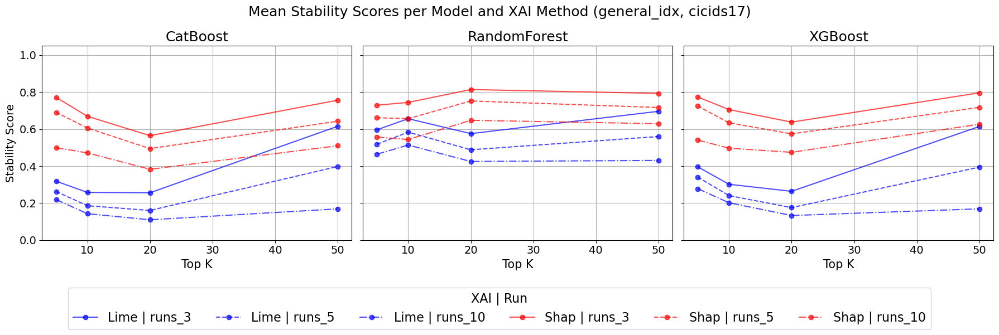


Results for dataset: cicids17, sample_set: true_idx
     dataset         model   xai sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids17      CatBoost  lime   true_idx    runs_3  0.3222  0.2644  0.25315  0.61586
1   cicids17      CatBoost  lime   true_idx    runs_5  0.2664  0.1900  0.15670  0.39438
2   cicids17      CatBoost  lime   true_idx   runs_10  0.2190  0.1423  0.10785  0.16630
3   cicids17      CatBoost  shap   true_idx    runs_3  0.7756  0.6678  0.56765  0.75682
4   cicids17      CatBoost  shap   true_idx    runs_5  0.6886  0.6122  0.50040  0.64616
5   cicids17      CatBoost  shap   true_idx   runs_10  0.4958  0.4769  0.39090  0.51570
6   cicids17  RandomForest  lime   true_idx    runs_3  0.5856  0.6609  0.57385  0.69346
7   cicids17  RandomForest  lime   true_idx    runs_5  0.5130  0.5844  0.48535  0.55610
8   cicids17  RandomForest  lime   true_idx   runs_10  0.4634  0.5111  0.41855  0.42532
9   cicids17  RandomForest  shap   true_idx    runs_3  0.7204  0.74

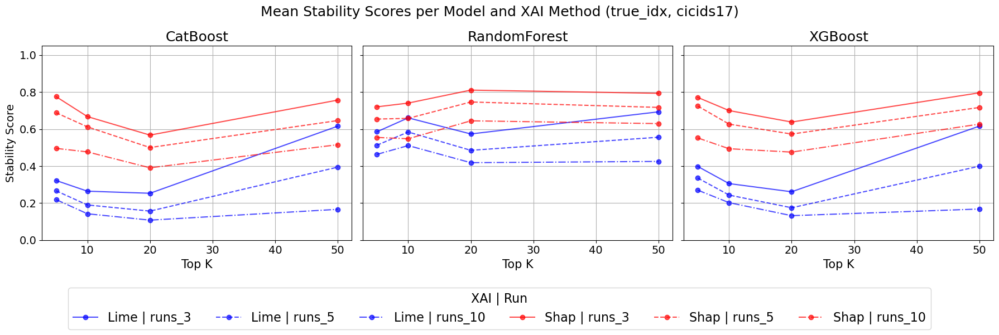


Results for dataset: cicids17, sample_set: false_idx
     dataset         model   xai sample_set runs_base    top_5   top_10   top_20   top_50
0   cicids17      CatBoost  lime  false_idx    runs_3  0.47405  0.37461  0.31557  0.69349
1   cicids17      CatBoost  lime  false_idx    runs_5  0.41851  0.31136  0.21914  0.52628
2   cicids17      CatBoost  lime  false_idx   runs_10  0.36578  0.26339  0.16669  0.35276
3   cicids17      CatBoost  shap  false_idx    runs_3  0.72511  0.70126  0.66017  0.78244
4   cicids17      CatBoost  shap  false_idx    runs_5  0.66396  0.60771  0.58436  0.68948
5   cicids17      CatBoost  shap  false_idx   runs_10  0.57952  0.50028  0.50203  0.57983
6   cicids17  RandomForest  lime  false_idx    runs_3  0.66820  0.69060  0.61165  0.70896
7   cicids17  RandomForest  lime  false_idx    runs_5  0.59880  0.62410  0.53395  0.58060
8   cicids17  RandomForest  lime  false_idx   runs_10  0.52840  0.57880  0.47430  0.45190
9   cicids17  RandomForest  shap  false_idx   

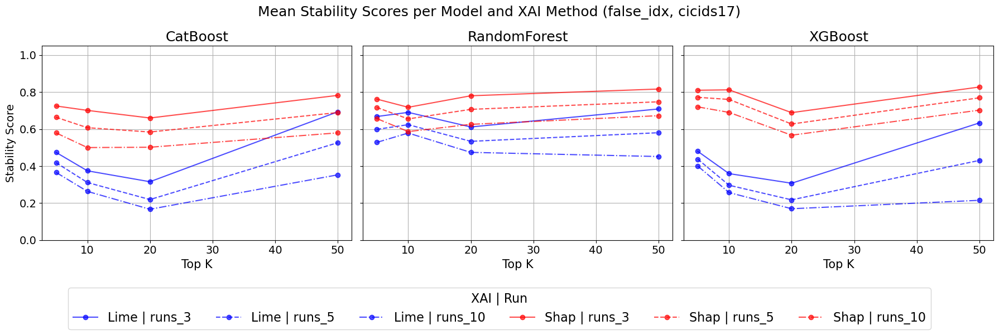


Results for dataset: cicids18, sample_set: general_idx
     dataset         model   xai   sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids18      CatBoost  lime  general_idx    runs_3  0.4550  0.2978  0.25315  0.65164
1   cicids18      CatBoost  lime  general_idx    runs_5  0.4054  0.2510  0.17215  0.44168
2   cicids18      CatBoost  lime  general_idx   runs_10  0.3424  0.2134  0.14135  0.20220
3   cicids18      CatBoost  shap  general_idx    runs_3  0.7254  0.7004  0.63730  0.76014
4   cicids18      CatBoost  shap  general_idx    runs_5  0.6808  0.6513  0.55950  0.65402
5   cicids18      CatBoost  shap  general_idx   runs_10  0.5988  0.5645  0.47885  0.53662
6   cicids18  RandomForest  lime  general_idx    runs_3  0.6838  0.6746  0.61710  0.71534
7   cicids18  RandomForest  lime  general_idx    runs_5  0.6200  0.5934  0.54125  0.57840
8   cicids18  RandomForest  lime  general_idx   runs_10  0.5622  0.5203  0.47920  0.43466
9   cicids18  RandomForest  shap  general_id

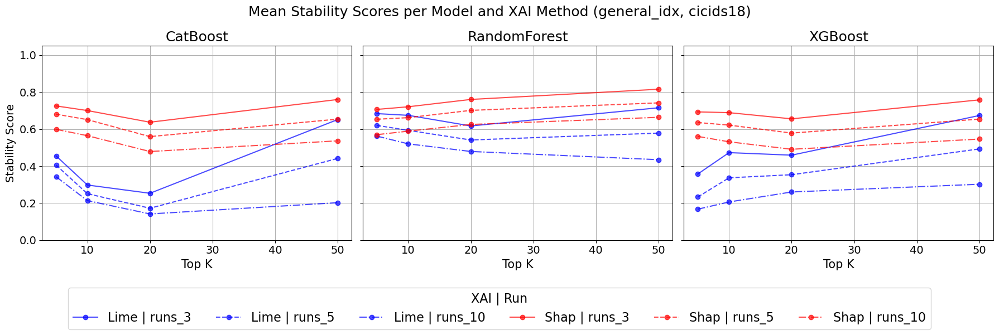


Results for dataset: cicids18, sample_set: true_idx
     dataset         model   xai sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids18      CatBoost  lime   true_idx    runs_3  0.4478  0.2966  0.25295  0.65272
1   cicids18      CatBoost  lime   true_idx    runs_5  0.3992  0.2509  0.17055  0.44292
2   cicids18      CatBoost  lime   true_idx   runs_10  0.3428  0.2172  0.14295  0.20512
3   cicids18      CatBoost  shap   true_idx    runs_3  0.7300  0.6962  0.63785  0.76140
4   cicids18      CatBoost  shap   true_idx    runs_5  0.6806  0.6459  0.56000  0.66190
5   cicids18      CatBoost  shap   true_idx   runs_10  0.6060  0.5625  0.47480  0.54316
6   cicids18  RandomForest  lime   true_idx    runs_3  0.6828  0.6661  0.60775  0.71242
7   cicids18  RandomForest  lime   true_idx    runs_5  0.6198  0.5804  0.52875  0.57150
8   cicids18  RandomForest  lime   true_idx   runs_10  0.5530  0.5072  0.46875  0.42946
9   cicids18  RandomForest  shap   true_idx    runs_3  0.7434  0.74

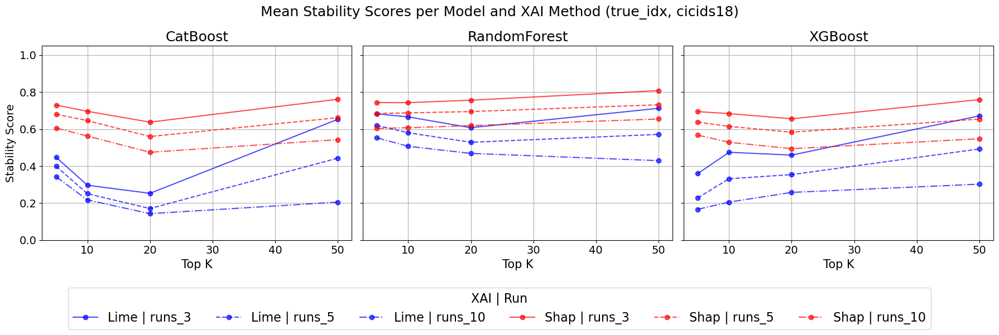


Results for dataset: cicids18, sample_set: false_idx
     dataset         model   xai sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids18      CatBoost  lime  false_idx    runs_3  0.4370  0.2927  0.24360  0.64852
1   cicids18      CatBoost  lime  false_idx    runs_5  0.3864  0.2427  0.16125  0.43596
2   cicids18      CatBoost  lime  false_idx   runs_10  0.3288  0.2048  0.13320  0.19378
3   cicids18      CatBoost  shap  false_idx    runs_3  0.7564  0.7294  0.66010  0.79384
4   cicids18      CatBoost  shap  false_idx    runs_5  0.7162  0.6791  0.58370  0.71134
5   cicids18      CatBoost  shap  false_idx   runs_10  0.6572  0.5995  0.51180  0.61440
6   cicids18  RandomForest  lime  false_idx    runs_3  0.6784  0.6928  0.63815  0.71512
7   cicids18  RandomForest  lime  false_idx    runs_5  0.6114  0.6095  0.56150  0.57884
8   cicids18  RandomForest  lime  false_idx   runs_10  0.5522  0.5368  0.50245  0.44034
9   cicids18  RandomForest  shap  false_idx    runs_3  0.6774  0.6

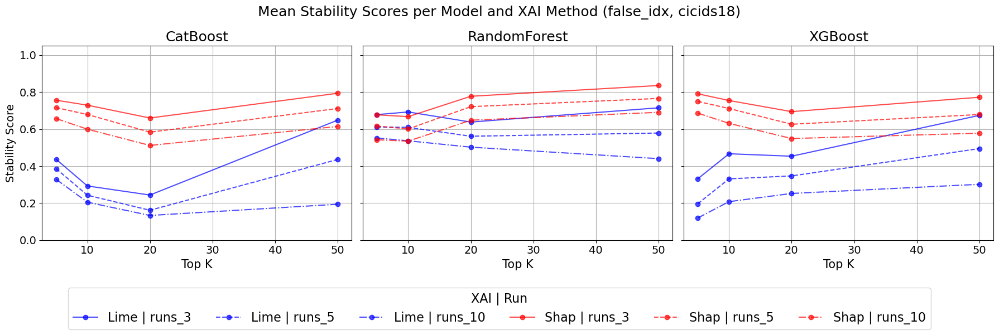

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Configuration
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# 1. Load the new DataFrame
df = pd.read_parquet("metrics/stability/stability_ttest_all_idx.parquet")

# 2. Preprocess: Rename and Reshape
df = df.rename(columns={
    "sampleset": "sample_set",
    "k": "top_k",
    "run_base": "runs_base"
})

# --- CRITICAL FIX: Enforce custom sort order for runs_base ---
custom_run_order = ["runs_3", "runs_5", "runs_10"]
df["runs_base"] = pd.Categorical(
    df["runs_base"], 
    categories=custom_run_order, 
    ordered=True
)
# -------------------------------------------------------------

# Reshape from wide (lime/shap columns) to long (xai column)
df_long = df.melt(
    id_vars=["dataset", "model", "sample_set", "top_k", "runs_base"],
    value_vars=["lime_mean", "shap_mean"],
    var_name="xai",
    value_name="stability_score"
)

# Clean 'xai' values
df_long["xai"] = df_long["xai"].str.replace("_mean", "")

# 3. Setup Plotting Configuration
xai_palette = {"lime": "blue", "shap": "red"}
run_styles = ['-', '--', '-.', ':']

datasets = df_long["dataset"].unique()
sample_sets = df_long["sample_set"].unique()

os.makedirs("metrics/stability/plots", exist_ok=True)
os.makedirs("metrics/final plots", exist_ok=True)

# 4. Visualization Loop
for target_dataset in datasets:
    for sample_set in sample_sets:
        print(f"\nResults for dataset: {target_dataset}, sample_set: {sample_set}")
        
        df_filtered = df_long[
            (df_long["dataset"] == target_dataset) &
            (df_long["sample_set"] == sample_set)
        ]
        
        if df_filtered.empty:
            print("No data for this sample set and dataset.")
            continue
        
        # Pivot table
        df_wide = df_filtered.pivot_table(
            index=["dataset", "model", "xai", "sample_set", "runs_base"],
            columns="top_k",
            values="stability_score",
            observed=False 
        ).reset_index()
        
        df_wide.columns.name = None
        
        # Rename top_k columns
        df_wide = df_wide.rename(columns=lambda c: f"top_{c}" if isinstance(c, int) else c)
        
        # Identify top_k columns
        topk_cols = sorted(
            [col for col in df_wide.columns if col.startswith("top_")],
            key=lambda x: int(x.split("_")[1])
        )
        
        # Reorder columns and sort rows by the custom runs_base order
        df_wide = df_wide[["dataset", "model", "xai", "sample_set", "runs_base"] + topk_cols]
        df_wide = df_wide.sort_values(by=["model", "xai", "runs_base"]) # Sort ensures table is ordered
        
        print(df_wide)

        table_filename = f"metrics/stability/plots/stability_{target_dataset}_{sample_set}_table.csv"
        df_wide.to_csv(table_filename, index=False)
        
        # Plotting
        models = df_wide["model"].unique()
        
        fig, axs = plt.subplots(1, len(models), figsize=(6 * len(models), 5), sharey=True)
        if len(models) == 1:
            axs = [axs]
        
        for m_idx, model in enumerate(models):
            ax = axs[m_idx]
            
            for xai in ['lime', 'shap']:
                # Filter and explicitly sort by runs_base again to ensure plot legend order
                subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
                subset = subset.sort_values(by="runs_base") 
                
                if subset.empty:
                    continue
                
                for r_idx, (_, row) in enumerate(subset.iterrows()):
                    run = row["runs_base"]
                    label = f"{xai.capitalize()} | {run}"
                    # Assign style based on index (0=runs_3, 1=runs_5, 2=runs_10)
                    style = run_styles[r_idx % len(run_styles)]
                    
                    ax.plot(
                        [int(col.split("_")[1]) for col in topk_cols],
                        [row[col] for col in topk_cols],
                        label=label,
                        color=xai_palette.get(xai, "black"),
                        linestyle=style,
                        marker='o',
                        markersize=6,
                        alpha=0.7
                    )
            
            ax.set_title(model, fontsize=18)
            ax.set_xlabel("Top K", fontsize=15)
            if m_idx == 0:
                ax.set_ylabel("Stability Score", fontsize=14)
            ax.set_ylim(0, 1.05)
            ax.tick_params(labelsize=14)
            ax.grid(True)
        
        handles, labels = axs[0].get_legend_handles_labels()
        
        fig.legend(
            handles, labels,
            loc='upper center',
            bbox_to_anchor=(0.5, -0.01),
            fancybox=True,
            shadow=False,
            ncol=len(labels),
            fontsize=16,
            title="XAI | Run",
            title_fontsize=16
        )
        
        plt.suptitle(f"Mean Stability Scores per Model and XAI Method ({sample_set}, {target_dataset})", fontsize=18)
        plt.tight_layout(rect=[0, 0, 1, 1])
        
        filename = f"metrics/final plots/stability_{target_dataset}_all_models_{sample_set}.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()


Results for dataset: cicids17, sample_set: general_idx
     dataset         model   xai   sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids17      CatBoost  lime  general_idx   runs_10  0.2192  0.1426  0.10975  0.16890
1   cicids17      CatBoost  lime  general_idx    runs_3  0.3186  0.2578  0.25590  0.61528
2   cicids17      CatBoost  lime  general_idx    runs_5  0.2628  0.1860  0.16015  0.39786
3   cicids17      CatBoost  shap  general_idx   runs_10  0.4996  0.4715  0.38285  0.51002
4   cicids17      CatBoost  shap  general_idx    runs_3  0.7720  0.6694  0.56460  0.75630
5   cicids17      CatBoost  shap  general_idx    runs_5  0.6908  0.6060  0.49465  0.64268
6   cicids17  RandomForest  lime  general_idx   runs_10  0.4644  0.5138  0.42515  0.43072
7   cicids17  RandomForest  lime  general_idx    runs_3  0.5964  0.6563  0.57565  0.69634
8   cicids17  RandomForest  lime  general_idx    runs_5  0.5182  0.5837  0.48835  0.56002
9   cicids17  RandomForest  shap  general_id

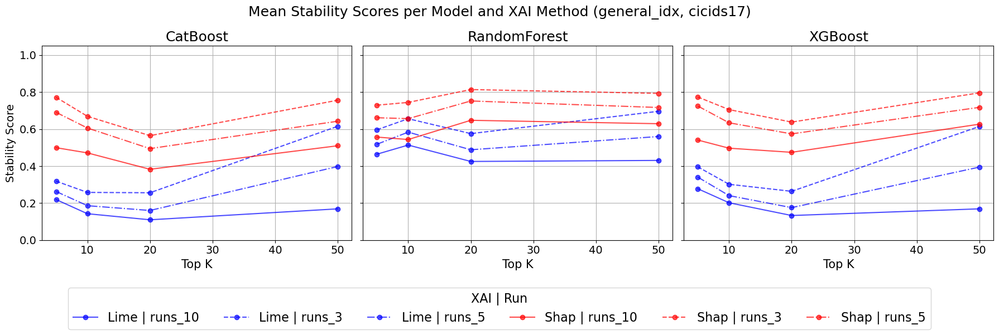


Results for dataset: cicids17, sample_set: true_idx
     dataset         model   xai sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids17      CatBoost  lime   true_idx   runs_10  0.2190  0.1423  0.10785  0.16630
1   cicids17      CatBoost  lime   true_idx    runs_3  0.3222  0.2644  0.25315  0.61586
2   cicids17      CatBoost  lime   true_idx    runs_5  0.2664  0.1900  0.15670  0.39438
3   cicids17      CatBoost  shap   true_idx   runs_10  0.4958  0.4769  0.39090  0.51570
4   cicids17      CatBoost  shap   true_idx    runs_3  0.7756  0.6678  0.56765  0.75682
5   cicids17      CatBoost  shap   true_idx    runs_5  0.6886  0.6122  0.50040  0.64616
6   cicids17  RandomForest  lime   true_idx   runs_10  0.4634  0.5111  0.41855  0.42532
7   cicids17  RandomForest  lime   true_idx    runs_3  0.5856  0.6609  0.57385  0.69346
8   cicids17  RandomForest  lime   true_idx    runs_5  0.5130  0.5844  0.48535  0.55610
9   cicids17  RandomForest  shap   true_idx   runs_10  0.5550  0.54

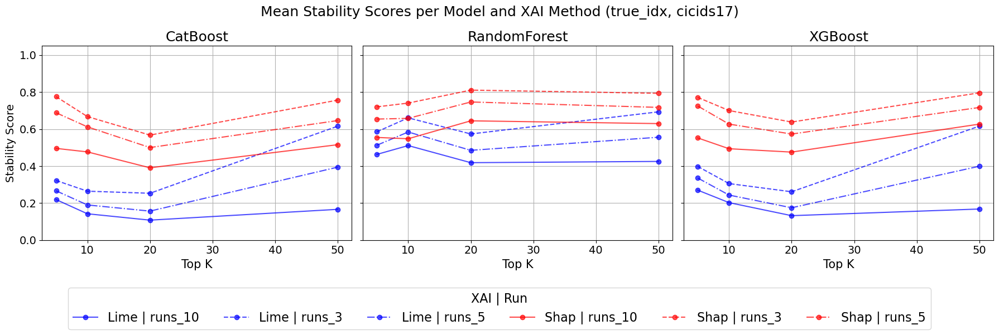


Results for dataset: cicids17, sample_set: false_idx
     dataset         model   xai sample_set runs_base    top_5   top_10   top_20   top_50
0   cicids17      CatBoost  lime  false_idx   runs_10  0.36578  0.26339  0.16669  0.35276
1   cicids17      CatBoost  lime  false_idx    runs_3  0.47405  0.37461  0.31557  0.69349
2   cicids17      CatBoost  lime  false_idx    runs_5  0.41851  0.31136  0.21914  0.52628
3   cicids17      CatBoost  shap  false_idx   runs_10  0.57952  0.50028  0.50203  0.57983
4   cicids17      CatBoost  shap  false_idx    runs_3  0.72511  0.70126  0.66017  0.78244
5   cicids17      CatBoost  shap  false_idx    runs_5  0.66396  0.60771  0.58436  0.68948
6   cicids17  RandomForest  lime  false_idx   runs_10  0.52840  0.57880  0.47430  0.45190
7   cicids17  RandomForest  lime  false_idx    runs_3  0.66820  0.69060  0.61165  0.70896
8   cicids17  RandomForest  lime  false_idx    runs_5  0.59880  0.62410  0.53395  0.58060
9   cicids17  RandomForest  shap  false_idx   

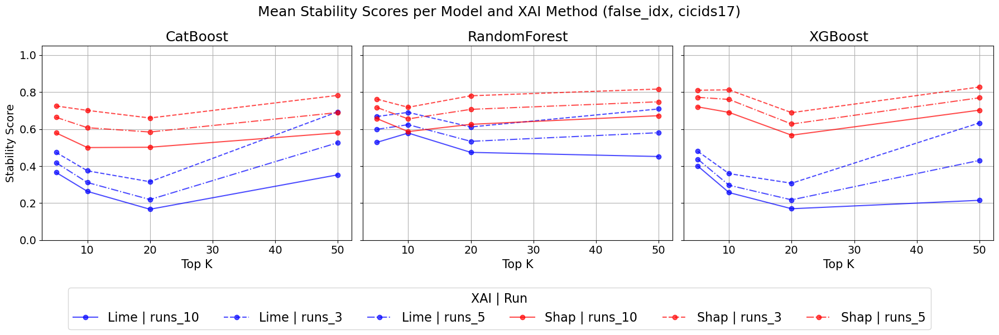


Results for dataset: cicids18, sample_set: general_idx
     dataset         model   xai   sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids18      CatBoost  lime  general_idx   runs_10  0.3424  0.2134  0.14135  0.20220
1   cicids18      CatBoost  lime  general_idx    runs_3  0.4550  0.2978  0.25315  0.65164
2   cicids18      CatBoost  lime  general_idx    runs_5  0.4054  0.2510  0.17215  0.44168
3   cicids18      CatBoost  shap  general_idx   runs_10  0.5988  0.5645  0.47885  0.53662
4   cicids18      CatBoost  shap  general_idx    runs_3  0.7254  0.7004  0.63730  0.76014
5   cicids18      CatBoost  shap  general_idx    runs_5  0.6808  0.6513  0.55950  0.65402
6   cicids18  RandomForest  lime  general_idx   runs_10  0.5622  0.5203  0.47920  0.43466
7   cicids18  RandomForest  lime  general_idx    runs_3  0.6838  0.6746  0.61710  0.71534
8   cicids18  RandomForest  lime  general_idx    runs_5  0.6200  0.5934  0.54125  0.57840
9   cicids18  RandomForest  shap  general_id

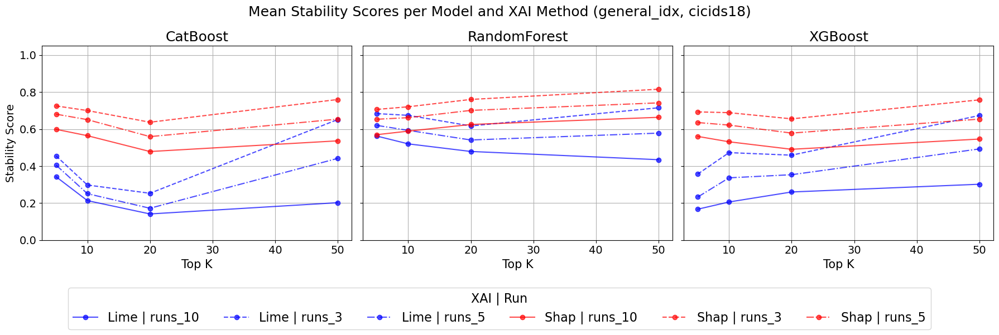


Results for dataset: cicids18, sample_set: true_idx
     dataset         model   xai sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids18      CatBoost  lime   true_idx   runs_10  0.3428  0.2172  0.14295  0.20512
1   cicids18      CatBoost  lime   true_idx    runs_3  0.4478  0.2966  0.25295  0.65272
2   cicids18      CatBoost  lime   true_idx    runs_5  0.3992  0.2509  0.17055  0.44292
3   cicids18      CatBoost  shap   true_idx   runs_10  0.6060  0.5625  0.47480  0.54316
4   cicids18      CatBoost  shap   true_idx    runs_3  0.7300  0.6962  0.63785  0.76140
5   cicids18      CatBoost  shap   true_idx    runs_5  0.6806  0.6459  0.56000  0.66190
6   cicids18  RandomForest  lime   true_idx   runs_10  0.5530  0.5072  0.46875  0.42946
7   cicids18  RandomForest  lime   true_idx    runs_3  0.6828  0.6661  0.60775  0.71242
8   cicids18  RandomForest  lime   true_idx    runs_5  0.6198  0.5804  0.52875  0.57150
9   cicids18  RandomForest  shap   true_idx   runs_10  0.6038  0.60

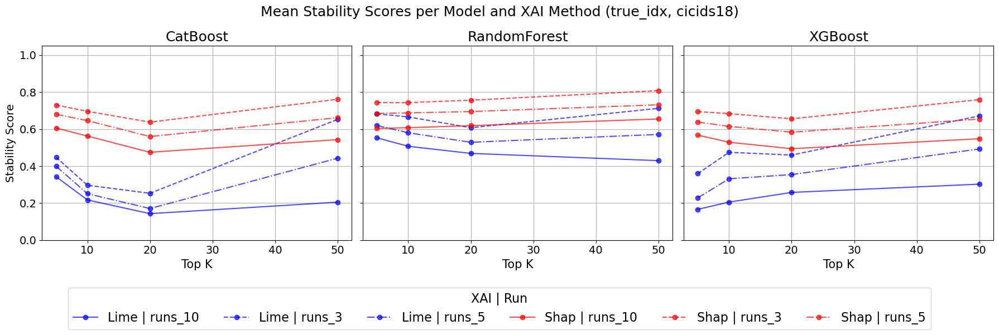


Results for dataset: cicids18, sample_set: false_idx
     dataset         model   xai sample_set runs_base   top_5  top_10   top_20   top_50
0   cicids18      CatBoost  lime  false_idx   runs_10  0.3288  0.2048  0.13320  0.19378
1   cicids18      CatBoost  lime  false_idx    runs_3  0.4370  0.2927  0.24360  0.64852
2   cicids18      CatBoost  lime  false_idx    runs_5  0.3864  0.2427  0.16125  0.43596
3   cicids18      CatBoost  shap  false_idx   runs_10  0.6572  0.5995  0.51180  0.61440
4   cicids18      CatBoost  shap  false_idx    runs_3  0.7564  0.7294  0.66010  0.79384
5   cicids18      CatBoost  shap  false_idx    runs_5  0.7162  0.6791  0.58370  0.71134
6   cicids18  RandomForest  lime  false_idx   runs_10  0.5522  0.5368  0.50245  0.44034
7   cicids18  RandomForest  lime  false_idx    runs_3  0.6784  0.6928  0.63815  0.71512
8   cicids18  RandomForest  lime  false_idx    runs_5  0.6114  0.6095  0.56150  0.57884
9   cicids18  RandomForest  shap  false_idx   runs_10  0.5426  0.5

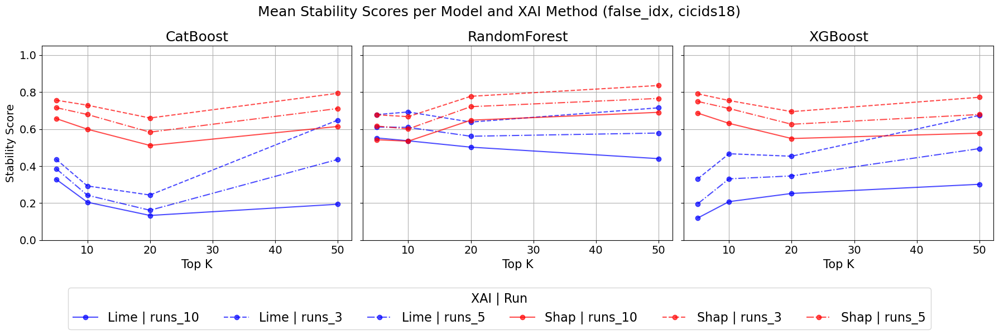

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Configuration
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/stability/stability_ttest_all_idx.parquet")
df = df.rename(columns={
    "sampleset": "sample_set",
    "k": "top_k",
    "run_base": "runs_base"
})

df_long = df.melt(
    id_vars=["dataset", "model", "sample_set", "top_k", "runs_base"],
    value_vars=["lime_mean", "shap_mean"],
    var_name="xai",
    value_name="stability_score"
)

df_long["xai"] = df_long["xai"].str.replace("_mean", "")

xai_palette = {"lime": "blue", "shap": "red"}
run_styles = ['-', '--', '-.', ':']

datasets = df_long["dataset"].unique()
sample_sets = df_long["sample_set"].unique()

os.makedirs("metrics/stability/plots", exist_ok=True)
os.makedirs("metrics/final plots", exist_ok=True)

for target_dataset in datasets:
    for sample_set in sample_sets:
        print(f"\nResults for dataset: {target_dataset}, sample_set: {sample_set}")
        
        # Filter by dataset and current sample set
        df_filtered = df_long[
            (df_long["dataset"] == target_dataset) &
            (df_long["sample_set"] == sample_set)
        ]
        
        if df_filtered.empty:
            print("No data for this sample set and dataset.")
            continue
        
        df_wide = df_filtered.pivot_table(
            index=["dataset", "model", "xai", "sample_set", "runs_base"],
            columns="top_k",
            values="stability_score"
        ).reset_index()
        
        df_wide.columns.name = None
        
        df_wide = df_wide.rename(columns=lambda c: f"top_{c}" if isinstance(c, int) else c)
        
        topk_cols = sorted(
            [col for col in df_wide.columns if col.startswith("top_")],
            key=lambda x: int(x.split("_")[1])
        )
        
        # Reorder DataFrame
        df_wide = df_wide[["dataset", "model", "xai", "sample_set", "runs_base"] + topk_cols]
        print(df_wide)

        table_filename = f"metrics/stability/plots/stability_{target_dataset}_{sample_set}_table.csv"
        df_wide.to_csv(table_filename, index=False)
        
        # Setup Plot
        models = df_wide["model"].unique()
        
        # Adjust figure size based on number of models
        fig, axs = plt.subplots(1, len(models), figsize=(6 * len(models), 5), sharey=True)
        if len(models) == 1:
            axs = [axs]
        
        for m_idx, model in enumerate(models):
            ax = axs[m_idx]
            
            # Iterate through XAI methods
            for xai in ['lime', 'shap']:
                subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
                if subset.empty:
                    continue
                
                # Optional: Sort by runs_base for consistent line styles
                subset = subset.sort_values(by="runs_base")
                
                for r_idx, (_, row) in enumerate(subset.iterrows()):
                    run = row["runs_base"]
                    label = f"{xai.capitalize()} | {run}"
                    style = run_styles[r_idx % len(run_styles)]
                    
                    ax.plot(
                        [int(col.split("_")[1]) for col in topk_cols],
                        [row[col] for col in topk_cols],
                        label=label,
                        color=xai_palette.get(xai, "black"),
                        linestyle=style,
                        marker='o',
                        markersize=6,
                        alpha=0.7
                    )
            
            ax.set_title(model, fontsize=18)
            ax.set_xlabel("Top K", fontsize=15)
            if m_idx == 0:
                ax.set_ylabel("Stability Score", fontsize=14)
            ax.set_ylim(0, 1.05)
            ax.tick_params(labelsize=14)
            ax.grid(True)
        
        handles, labels = axs[0].get_legend_handles_labels()
        
        fig.legend(
            handles, labels,
            loc='upper center',
            bbox_to_anchor=(0.5, -0.01),
            fancybox=True,
            shadow=False,
            ncol=len(labels),
            fontsize=16,
            title="XAI | Run",
            title_fontsize=16
        )
        
        plt.suptitle(f"Mean Stability Scores per Model and XAI Method ({sample_set}, {target_dataset})", fontsize=18)
        plt.tight_layout(rect=[0, 0, 1, 1])
        
        filename = f"metrics/final plots/stability_{target_dataset}_all_models_{sample_set}.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()

[ 363001  492277  433604  731863  250406  626225  662965  139051  518993
  595615 1983337 3607298 1749206 3635607 3644377  245407 1507663 2065566]

Results for dataset: cicids17, sample_set: general_idx
     dataset         model   xai   sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0   cicids17      CatBoost  lime  general_idx          3    0.4     0.6    0.30    0.56     1.0
1   cicids17      CatBoost  lime  general_idx          5    0.2     0.5    0.30    0.38     1.0
2   cicids17      CatBoost  lime  general_idx         10    0.0     0.1    0.15    0.14     1.0
3   cicids17      CatBoost  shap  general_idx          3    0.8     0.6    0.45    0.76     1.0
4   cicids17      CatBoost  shap  general_idx          5    0.8     0.6    0.35    0.58     1.0
5   cicids17      CatBoost  shap  general_idx         10    0.6     0.4    0.20    0.44     1.0
6   cicids17  RandomForest  lime  general_idx          3    0.6     0.7    0.85    0.72     1.0
7   cicids17  RandomForest  l

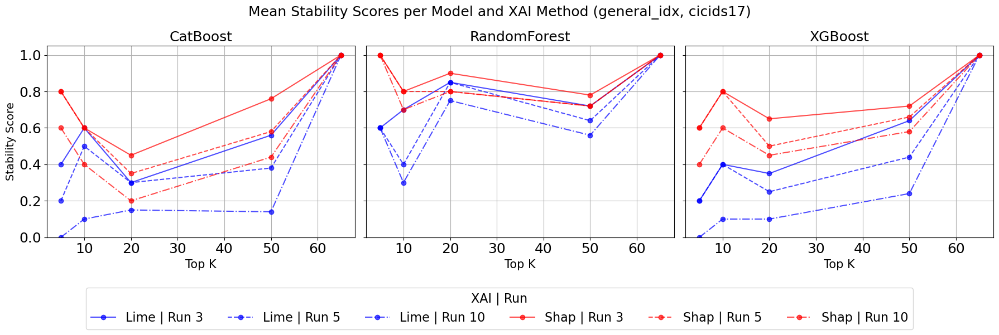


Results for dataset: cicids17, sample_set: true_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0   cicids17      CatBoost  lime   true_idx          3    0.4     0.5    0.35    0.64     1.0
1   cicids17      CatBoost  lime   true_idx          5    0.2     0.5    0.30    0.38     1.0
2   cicids17      CatBoost  lime   true_idx         10    0.2     0.3    0.30    0.20     1.0
3   cicids17      CatBoost  shap   true_idx          3    1.0     0.6    0.85    0.88     1.0
4   cicids17      CatBoost  shap   true_idx          5    1.0     0.6    0.75    0.78     1.0
5   cicids17      CatBoost  shap   true_idx         10    0.8     0.6    0.70    0.76     1.0
6   cicids17  RandomForest  lime   true_idx          3    0.8     0.7    0.75    0.76     1.0
7   cicids17  RandomForest  lime   true_idx          5    0.8     0.4    0.75    0.62     1.0
8   cicids17  RandomForest  lime   true_idx         10    0.6     0.4    0.70    0.56     1.0
9   cic

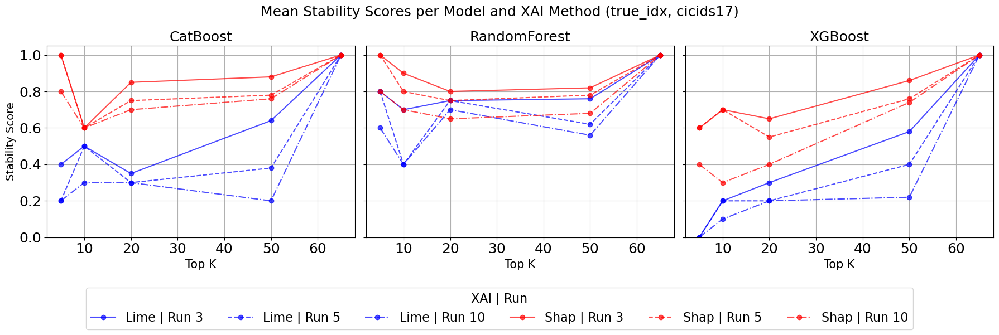


Results for dataset: cicids17, sample_set: false_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0   cicids17      CatBoost  lime  false_idx          3    0.8     0.5    0.40    0.60     1.0
1   cicids17      CatBoost  lime  false_idx          5    0.6     0.5    0.30    0.44     1.0
2   cicids17      CatBoost  lime  false_idx         10    0.4     0.4    0.20    0.24     1.0
3   cicids17      CatBoost  shap  false_idx          3    0.8     0.8    0.80    0.86     1.0
4   cicids17      CatBoost  shap  false_idx          5    0.8     0.8    0.70    0.80     1.0
5   cicids17      CatBoost  shap  false_idx         10    0.8     0.6    0.55    0.70     1.0
6   cicids17  RandomForest  lime  false_idx          3    0.6     0.5    0.85    0.78     1.0
7   cicids17  RandomForest  lime  false_idx          5    0.6     0.4    0.70    0.68     1.0
8   cicids17  RandomForest  lime  false_idx         10    0.6     0.4    0.70    0.60     1.0
9   ci

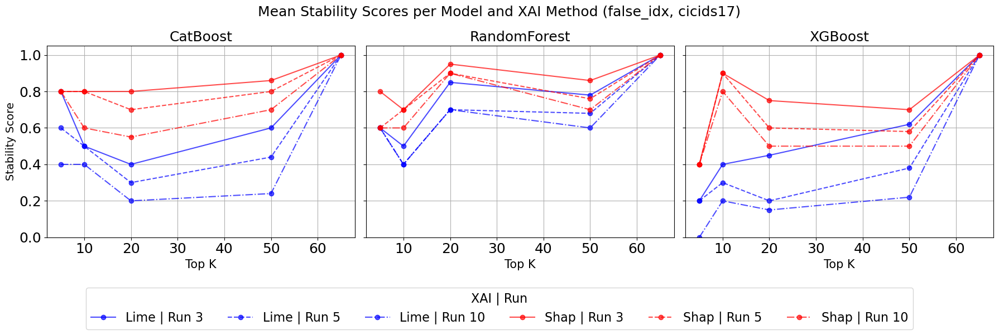


Results for dataset: cicids18, sample_set: general_idx
     dataset         model   xai   sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0   cicids18      CatBoost  lime  general_idx          3    0.6     0.4    0.35    0.68     1.0
1   cicids18      CatBoost  lime  general_idx          5    0.6     0.4    0.30    0.52     1.0
2   cicids18      CatBoost  lime  general_idx         10    0.4     0.3    0.20    0.34     1.0
3   cicids18      CatBoost  shap  general_idx          3    0.6     0.6    0.55    0.74     1.0
4   cicids18      CatBoost  shap  general_idx          5    0.6     0.6    0.55    0.60     1.0
5   cicids18      CatBoost  shap  general_idx         10    0.6     0.6    0.50    0.44     1.0
6   cicids18  RandomForest  lime  general_idx          3    1.0     0.7    0.85    0.76     1.0
7   cicids18  RandomForest  lime  general_idx          5    0.8     0.7    0.80    0.64     1.0
8   cicids18  RandomForest  lime  general_idx         10    0.8     0.6    0.65 

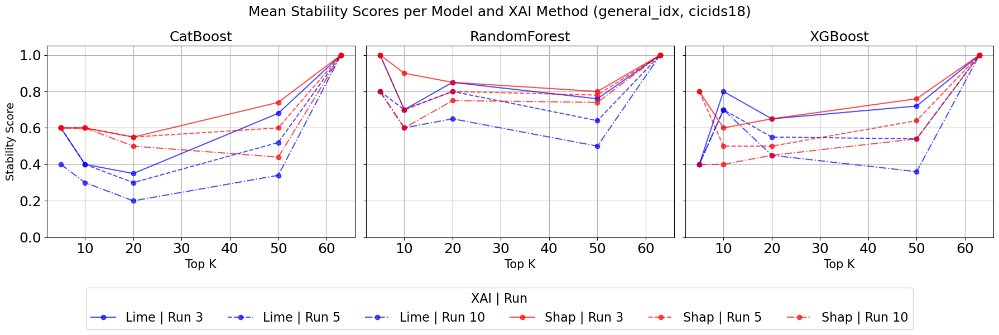


Results for dataset: cicids18, sample_set: true_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0   cicids18      CatBoost  lime   true_idx          3    0.8     0.5    0.40    0.64     1.0
1   cicids18      CatBoost  lime   true_idx          5    0.6     0.4    0.35    0.46     1.0
2   cicids18      CatBoost  lime   true_idx         10    0.4     0.3    0.20    0.30     1.0
3   cicids18      CatBoost  shap   true_idx          3    0.8     0.5    0.70    0.76     1.0
4   cicids18      CatBoost  shap   true_idx          5    0.8     0.5    0.70    0.70     1.0
5   cicids18      CatBoost  shap   true_idx         10    0.8     0.4    0.60    0.60     1.0
6   cicids18  RandomForest  lime   true_idx          3    0.8     0.7    0.85    0.82     1.0
7   cicids18  RandomForest  lime   true_idx          5    0.8     0.6    0.70    0.68     1.0
8   cicids18  RandomForest  lime   true_idx         10    0.8     0.5    0.60    0.50     1.0
9   cic

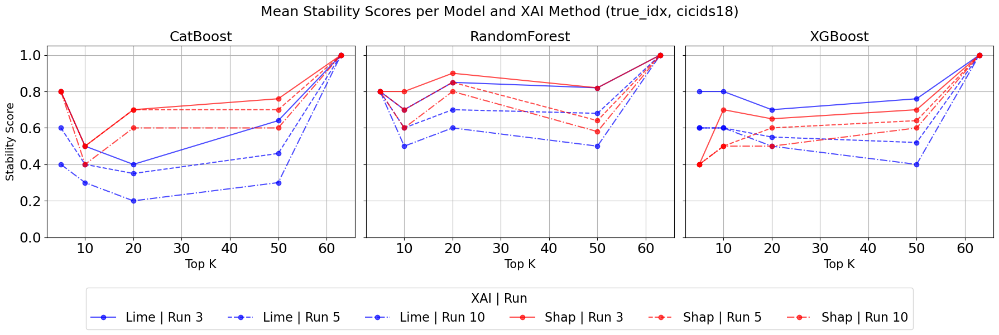


Results for dataset: cicids18, sample_set: false_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0   cicids18      CatBoost  lime  false_idx          3    0.2     0.3    0.30    0.64     1.0
1   cicids18      CatBoost  lime  false_idx          5    0.2     0.2    0.25    0.44     1.0
2   cicids18      CatBoost  lime  false_idx         10    0.2     0.2    0.15    0.24     1.0
3   cicids18      CatBoost  shap  false_idx          3    0.8     0.7    0.70    0.80     1.0
4   cicids18      CatBoost  shap  false_idx          5    0.8     0.6    0.65    0.74     1.0
5   cicids18      CatBoost  shap  false_idx         10    0.8     0.5    0.55    0.54     1.0
6   cicids18  RandomForest  lime  false_idx          3    0.8     0.7    0.80    0.72     1.0
7   cicids18  RandomForest  lime  false_idx          5    0.8     0.7    0.75    0.62     1.0
8   cicids18  RandomForest  lime  false_idx         10    0.8     0.5    0.70    0.54     1.0
9   ci

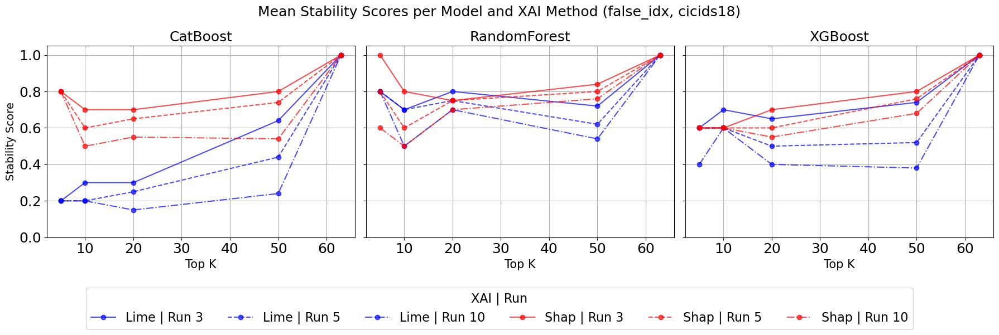

In [10]:
# Single IDX!

import pandas as pd
import matplotlib.pyplot as plt
import os

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")

print(df["idx"].unique())

global_means = (df.groupby(['dataset', 
                     'model', 
                     'xai', 
                     'sample_set', 
                     'runs_base', 
                     'top_k'], as_index=False)['stability_score'].mean())

xai_palette = {"lime": "blue", "shap": "red"}
run_styles = ['-', '--', '-.', ':']
datasets = ["cicids17", "cicids18"]
sample_sets = ["general_idx", "true_idx", "false_idx"]

for target_dataset in datasets:
    for sample_set in sample_sets:
        print(f"\nResults for dataset: {target_dataset}, sample_set: {sample_set}")
        # Filter by dataset and current sample set
        df_filtered = global_means[
            (global_means["dataset"] == target_dataset) &
            (global_means["sample_set"] == sample_set)
        ]
        if df_filtered.empty:
            print("No data for this sample set and dataset.")
            continue
        # Pivot the filtered DataFrame
        df_wide = df_filtered.pivot_table(
            index=["dataset", "model", "xai", "sample_set", "runs_base"],
            columns="top_k",
            values="stability_score"
        ).reset_index()
        df_wide.columns.name = None
        df_wide = df_wide.rename(columns=lambda c: f"top_{c}" if isinstance(c, int) else c)
        topk_cols = sorted([col for col in df_wide.columns if col.startswith("top_")],
                           key=lambda x: int(x.split("_")[1]))
        df_wide = df_wide[["dataset", "model", "xai", "sample_set", "runs_base"] + topk_cols]
        print(df_wide)

        table_filename = f"metrics/stability/plots/stability_{target_dataset}_{sample_set}_table.csv"
        df_wide.to_csv(table_filename, index=False)
        
        runs_bases = sorted(df_wide["runs_base"].unique())
        models = df_wide["model"].unique()
        fig, axs = plt.subplots(1, len(models), figsize=(18, 5), sharey=True)
        if len(models) == 1:
            axs = [axs]
        
        for m_idx, model in enumerate(models):
            ax = axs[m_idx]
            for xai in ['lime', 'shap']:
                subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
                if subset.empty:
                    continue
                for r_idx, (_, row) in enumerate(subset.iterrows()):
                    run = row["runs_base"]
                    label = f"{xai.capitalize()} | Run {run}"
                    style = run_styles[r_idx % len(run_styles)]
                    ax.plot(
                        [int(col.split("_")[1]) for col in topk_cols],
                        [row[col] for col in topk_cols],
                        label=label,
                        color=xai_palette[xai],
                        linestyle=style,
                        marker='o',
                        markersize=6,
                        alpha=0.7
                    )
            ax.set_title(model, fontsize=18)
            ax.set_xlabel("Top K", fontsize=15)
            if m_idx == 0:
                ax.set_ylabel("Stability Score", fontsize=14)
            ax.set_ylim(0, 1.05)
            # Remove per-axis legend
            ax.tick_params(labelsize=18)
            ax.grid(True)
        
        handles, labels = axs[0].get_legend_handles_labels()
        fig.legend(
            handles, labels,
            loc='upper center',
            bbox_to_anchor=(0.5, -0.01),
            fancybox=True,
            shadow=False,
            ncol=len(labels),
            fontsize=16,
            title="XAI | Run",
            title_fontsize=16
        )
        
        plt.suptitle(f"Mean Stability Scores per Model and XAI Method ({sample_set}, {target_dataset})", fontsize=18)

        plt.tight_layout(rect=[0, 0, 1, 1])
        
        filename = f"metrics/final plots/stability_{target_dataset}_all_models_{sample_set}.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()



Results for dataset: cicids17, sample_set: general_idx
     dataset         model   xai   sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0   cicids17      CatBoost  lime  general_idx          3    0.4     0.6    0.30    0.56     1.0
1   cicids17      CatBoost  lime  general_idx          5    0.2     0.5    0.30    0.38     1.0
2   cicids17      CatBoost  lime  general_idx         10    0.0     0.1    0.15    0.14     1.0
3   cicids17      CatBoost  shap  general_idx          3    0.8     0.6    0.45    0.76     1.0
4   cicids17      CatBoost  shap  general_idx          5    0.8     0.6    0.35    0.58     1.0
5   cicids17      CatBoost  shap  general_idx         10    0.6     0.4    0.20    0.44     1.0
6   cicids17  RandomForest  lime  general_idx          3    0.6     0.7    0.85    0.72     1.0
7   cicids17  RandomForest  lime  general_idx          5    0.6     0.4    0.85    0.64     1.0
8   cicids17  RandomForest  lime  general_idx         10    0.6     0.3    0.75 

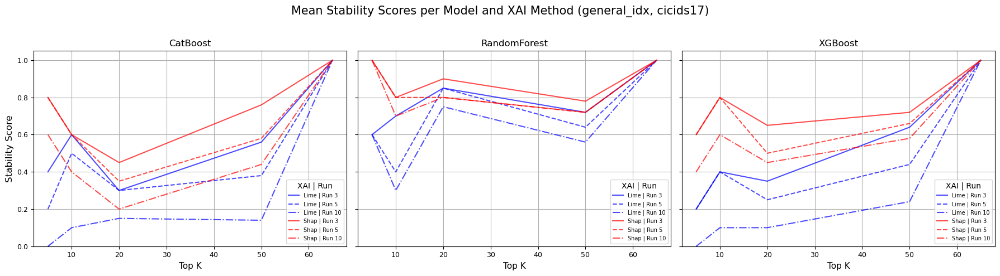


Results for dataset: cicids17, sample_set: true_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0   cicids17      CatBoost  lime   true_idx          3    0.4     0.5    0.35    0.64     1.0
1   cicids17      CatBoost  lime   true_idx          5    0.2     0.5    0.30    0.38     1.0
2   cicids17      CatBoost  lime   true_idx         10    0.2     0.3    0.30    0.20     1.0
3   cicids17      CatBoost  shap   true_idx          3    1.0     0.6    0.85    0.88     1.0
4   cicids17      CatBoost  shap   true_idx          5    1.0     0.6    0.75    0.78     1.0
5   cicids17      CatBoost  shap   true_idx         10    0.8     0.6    0.70    0.76     1.0
6   cicids17  RandomForest  lime   true_idx          3    0.8     0.7    0.75    0.76     1.0
7   cicids17  RandomForest  lime   true_idx          5    0.8     0.4    0.75    0.62     1.0
8   cicids17  RandomForest  lime   true_idx         10    0.6     0.4    0.70    0.56     1.0
9   cic

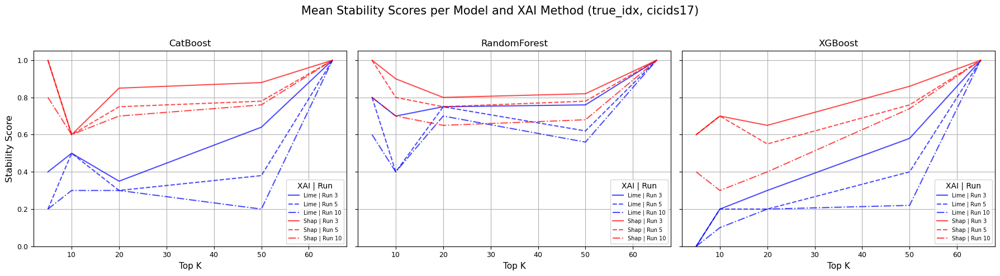


Results for dataset: cicids17, sample_set: false_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0   cicids17      CatBoost  lime  false_idx          3    0.8     0.5    0.40    0.60     1.0
1   cicids17      CatBoost  lime  false_idx          5    0.6     0.5    0.30    0.44     1.0
2   cicids17      CatBoost  lime  false_idx         10    0.4     0.4    0.20    0.24     1.0
3   cicids17      CatBoost  shap  false_idx          3    0.8     0.8    0.80    0.86     1.0
4   cicids17      CatBoost  shap  false_idx          5    0.8     0.8    0.70    0.80     1.0
5   cicids17      CatBoost  shap  false_idx         10    0.8     0.6    0.55    0.70     1.0
6   cicids17  RandomForest  lime  false_idx          3    0.6     0.5    0.85    0.78     1.0
7   cicids17  RandomForest  lime  false_idx          5    0.6     0.4    0.70    0.68     1.0
8   cicids17  RandomForest  lime  false_idx         10    0.6     0.4    0.70    0.60     1.0
9   ci

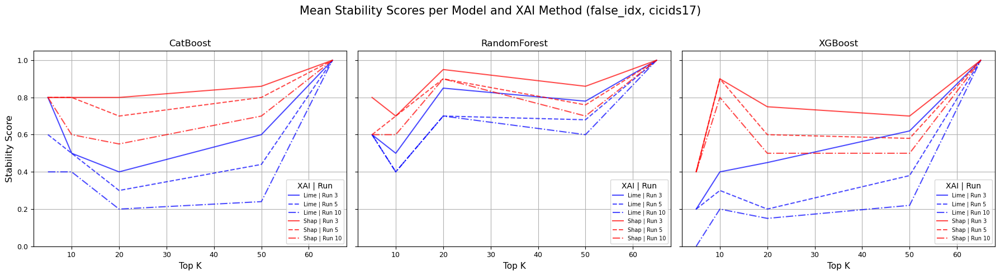


Results for dataset: cicids18, sample_set: general_idx
     dataset         model   xai   sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0   cicids18      CatBoost  lime  general_idx          3    0.6     0.4    0.35    0.68     1.0
1   cicids18      CatBoost  lime  general_idx          5    0.6     0.4    0.30    0.52     1.0
2   cicids18      CatBoost  lime  general_idx         10    0.4     0.3    0.20    0.34     1.0
3   cicids18      CatBoost  shap  general_idx          3    0.6     0.6    0.55    0.74     1.0
4   cicids18      CatBoost  shap  general_idx          5    0.6     0.6    0.55    0.60     1.0
5   cicids18      CatBoost  shap  general_idx         10    0.6     0.6    0.50    0.44     1.0
6   cicids18  RandomForest  lime  general_idx          3    1.0     0.7    0.85    0.76     1.0
7   cicids18  RandomForest  lime  general_idx          5    0.8     0.7    0.80    0.64     1.0
8   cicids18  RandomForest  lime  general_idx         10    0.8     0.6    0.65 

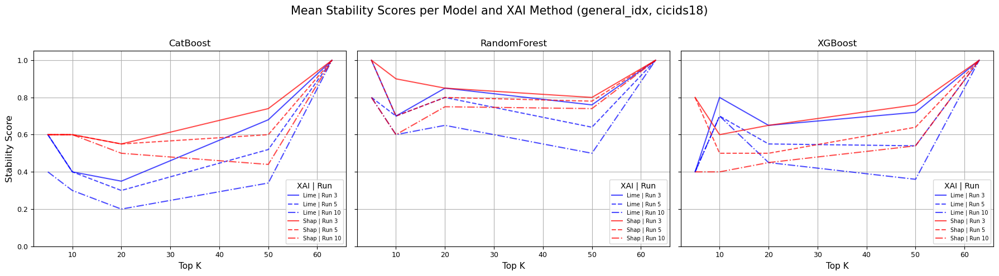


Results for dataset: cicids18, sample_set: true_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0   cicids18      CatBoost  lime   true_idx          3    0.8     0.5    0.40    0.64     1.0
1   cicids18      CatBoost  lime   true_idx          5    0.6     0.4    0.35    0.46     1.0
2   cicids18      CatBoost  lime   true_idx         10    0.4     0.3    0.20    0.30     1.0
3   cicids18      CatBoost  shap   true_idx          3    0.8     0.5    0.70    0.76     1.0
4   cicids18      CatBoost  shap   true_idx          5    0.8     0.5    0.70    0.70     1.0
5   cicids18      CatBoost  shap   true_idx         10    0.8     0.4    0.60    0.60     1.0
6   cicids18  RandomForest  lime   true_idx          3    0.8     0.7    0.85    0.82     1.0
7   cicids18  RandomForest  lime   true_idx          5    0.8     0.6    0.70    0.68     1.0
8   cicids18  RandomForest  lime   true_idx         10    0.8     0.5    0.60    0.50     1.0
9   cic

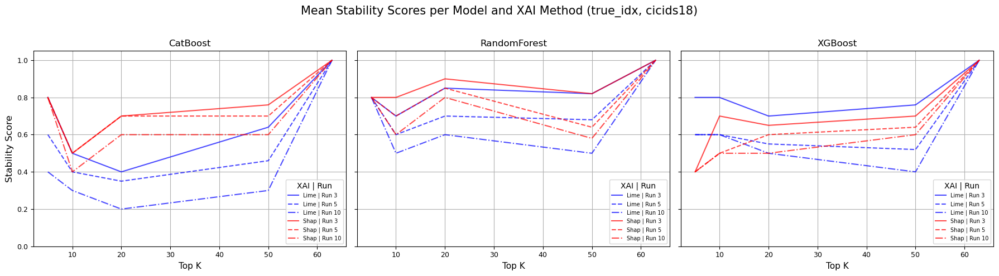


Results for dataset: cicids18, sample_set: false_idx
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0   cicids18      CatBoost  lime  false_idx          3    0.2     0.3    0.30    0.64     1.0
1   cicids18      CatBoost  lime  false_idx          5    0.2     0.2    0.25    0.44     1.0
2   cicids18      CatBoost  lime  false_idx         10    0.2     0.2    0.15    0.24     1.0
3   cicids18      CatBoost  shap  false_idx          3    0.8     0.7    0.70    0.80     1.0
4   cicids18      CatBoost  shap  false_idx          5    0.8     0.6    0.65    0.74     1.0
5   cicids18      CatBoost  shap  false_idx         10    0.8     0.5    0.55    0.54     1.0
6   cicids18  RandomForest  lime  false_idx          3    0.8     0.7    0.80    0.72     1.0
7   cicids18  RandomForest  lime  false_idx          5    0.8     0.7    0.75    0.62     1.0
8   cicids18  RandomForest  lime  false_idx         10    0.8     0.5    0.70    0.54     1.0
9   ci

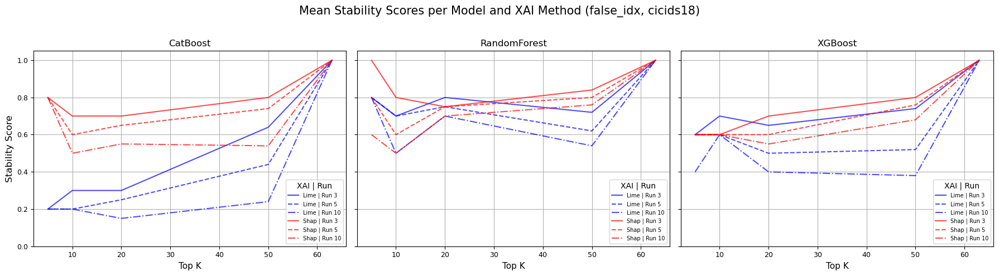

In [24]:
# Single IDX!
import pandas as pd
import matplotlib.pyplot as plt
import os

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")

global_means = (df.groupby(['dataset', 
                     'model', 
                     'xai', 
                     'sample_set', 
                     'runs_base', 
                     'top_k'], as_index=False)['stability_score'].mean())

#print(global_means.head(50))

xai_palette = {"lime": "blue", "shap": "red"}
run_styles = ['-', '--', '-.', ':']
datasets = ["cicids17", "cicids18"]
sample_sets = ["general_idx", "true_idx", "false_idx"]

for target_dataset in datasets:
    for sample_set in sample_sets:
        print(f"\nResults for dataset: {target_dataset}, sample_set: {sample_set}")
        # Filter by dataset and current sample set
        df_filtered = global_means[
            (global_means["dataset"] == target_dataset) &
            (global_means["sample_set"] == sample_set)
        ]
        if df_filtered.empty:
            print("No data for this sample set and dataset.")
            continue
        # Pivot the filtered DataFrame
        df_wide = df_filtered.pivot_table(
            index=["dataset", "model", "xai", "sample_set", "runs_base"],
            columns="top_k",
            values="stability_score"
        ).reset_index()
        df_wide.columns.name = None
        df_wide = df_wide.rename(columns=lambda c: f"top_{c}" if isinstance(c, int) else c)
        topk_cols = sorted([col for col in df_wide.columns if col.startswith("top_")],
                           key=lambda x: int(x.split("_")[1]))
        df_wide = df_wide[["dataset", "model", "xai", "sample_set", "runs_base"] + topk_cols]
        print(df_wide)

        table_filename = f"metrics/stability/plots/stability_{target_dataset}_{sample_set}_table.csv"
        df_wide.to_csv(table_filename, index=False)
        
        runs_bases = sorted(df_wide["runs_base"].unique())
        models = df_wide["model"].unique()
        fig, axs = plt.subplots(1, len(models), figsize=(18, 5), sharey=True)
        for m_idx, model in enumerate(models):
            ax = axs[m_idx]
            for xai in ['lime', 'shap']:
                subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
                if subset.empty:
                    continue
                for r_idx, (_, row) in enumerate(subset.iterrows()):
                    run = row["runs_base"]
                    label = f"{xai.capitalize()} | Run {run}"
                    style = run_styles[r_idx % len(run_styles)]
                    ax.plot(
                        [int(col.split("_")[1]) for col in topk_cols],
                        [row[col] for col in topk_cols],
                        label=label,
                        color=xai_palette[xai],
                        linestyle=style,
                        marker='o',
                        markersize=4,
                        alpha=0.7
                    )
            ax.set_title(model)
            ax.set_xlabel("Top K", fontsize=11)
            if m_idx == 0:
                ax.set_ylabel("Stability Score", fontsize=12)
            ax.set_ylim(0, 1.05)
            ax.legend(fontsize=7, title="XAI | Run", loc="lower right")
            ax.tick_params(labelsize=9)
            ax.grid(True)

        plt.suptitle(f"Mean Stability Scores per Model and XAI Method ({sample_set}, {target_dataset})", fontsize=15)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        filename = f"metrics/stability/plots/stability_{target_dataset}_all_models_{sample_set}.png"
        os.makedirs("metrics/stability/plots", exist_ok=True)
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()


#### Significance True vs False 

Examination whether there is a significant difference between true and false explanation stability (e.g.: CICIDS17, RF - LIME True vs. False)

In [6]:
import pandas as pd
from scipy.stats import ttest_ind

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")
run_bases = ["runs_3", "runs_5", "runs_10"]

#print(df.head())

results = []

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for explainer in df["explainer"].unique():
            
            for k in df['k'].unique():
                    if k == 63 or k == 65:
                        continue
                    else:
                        false_subset = df[
                            (df["dataset"] == dataset) &
                            (df["model"] == model) &
                            (df["sampleset"] == "false_idx") &
                            (df["k"] == k)
                        ]
                        true_subset = df[
                            (df["dataset"] == dataset) &
                            (df["model"] == model) &
                            (df["sampleset"] == "true_idx") &
                            (df["k"] == k)
                        ]
        
                        if false_subset.empty or true_subset.empty:
                            continue
                            
                        # remove invalid rows
                        #if (dataset == "cicids17" and k == 65) or (dataset == "cicids18" and k == 63):
                        #    continue
        
                        false_subset = false_subset.sort_values("idx")
                        true_subset = true_subset.sort_values("idx")
        
                        for run_base in run_bases:
                            false_vals = false_subset[run_base].values
                            true_vals = true_subset[run_base].values
                        
                            min_len = min(len(false_vals), len(true_vals))
                        
                            if min_len > 1:
                                false_vals = false_vals[:min_len] #first group
                                true_vals = true_vals[:min_len] #second group
                        
                                # Calculate statistics
                                false_mean = round(false_vals.mean(), 5)
                                false_std = round(false_vals.std(ddof=1), 5)
                                true_mean = round(true_vals.mean(), 5)
                                true_std = round(true_vals.std(ddof=1), 5)
                        
                                # Perform paired t-test
                                stat, p = ttest_ind(false_vals, true_vals)
                        
                                interpretation = "No significant difference" if p > 0.05 else "Significant difference"
                        
                                results.append({
                                    "dataset": dataset,
                                    "model": model,
                                    "explainer": explainer,
                                    "k": k,
                                    "run_base": run_base,
                                    "false_mean": false_mean,
                                    "false_std": false_std,
                                    "true_mean": true_mean,
                                    "true_std": true_std,
                                    "ttest_statistic": round(stat, 5),
                                    "p_value": round(p, 5),
                                    "interpretation": interpretation
                                })
                            else:
                                pass

results_df = pd.DataFrame(results)
print(results_df)

results_df.to_csv("metrics/stability/stability_ttest_ind_all_true_vs_false.csv", index=False)

      dataset         model explainer   k run_base  false_mean  false_std  true_mean  true_std  ttest_statistic  p_value             interpretation
0    cicids17      CatBoost      lime   5   runs_3     0.59958    0.25612    0.55119   0.26507          4.95725  0.00000     Significant difference
1    cicids17      CatBoost      lime   5   runs_5     0.54123    0.26490    0.47980   0.25869          6.26529  0.00000     Significant difference
2    cicids17      CatBoost      lime   5  runs_10     0.47265    0.26159    0.35428   0.21531         13.19366  0.00000     Significant difference
3    cicids17      CatBoost      lime  10   runs_3     0.53794    0.22788    0.46564   0.23613          8.31989  0.00000     Significant difference
4    cicids17      CatBoost      lime  10   runs_5     0.45954    0.22704    0.40063   0.24332          6.68405  0.00000     Significant difference
5    cicids17      CatBoost      lime  10  runs_10     0.38184    0.21648    0.30835   0.21058          9.18940 

In [8]:
import pandas as pd

df = pd.read_csv("metrics/stability/stability_ttest_ind_all_true_vs_false.csv")

count_false_greater = (df['false_mean'] >= df['true_mean']).sum()
total_entries = len(df)

ratio_false_greater = count_false_greater / total_entries
percentage_false_greater = ratio_false_greater * 100

print(f"False mean is greater than True mean in {count_false_greater} out of {total_entries} rows.")
print(f"Ratio: {ratio_false_greater:.2f} ({percentage_false_greater:.2f}%)")

False mean is greater than True mean in 132 out of 144 rows.
Ratio: 0.92 (91.67%)


In [8]:
import pandas as pd

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_csv("metrics/stability/stability_ttest_ind_all_true_vs_false.csv")

exceptions = df[df['false_mean'] < df['true_mean']]
print(f"Found {len(exceptions)} rows where False mean < True mean.")

columns_to_show = ['dataset', 'classifier', 'explainer', 'threshold', 'true_mean', 'false_mean']

if set(columns_to_show).issubset(df.columns):
    print(exceptions[columns_to_show])
else:
    print(exceptions)

Found 12 rows where False mean < True mean.
      dataset         model explainer   k run_base  false_mean  false_std  true_mean  true_std  ttest_statistic  p_value          interpretation
96   cicids18  RandomForest      lime   5   runs_3     0.67790    0.15167    0.71310   0.16722         -6.97300      0.0  Significant difference
97   cicids18  RandomForest      lime   5   runs_5     0.61390    0.15349    0.65230   0.17210         -7.44697      0.0  Significant difference
98   cicids18  RandomForest      lime   5  runs_10     0.54740    0.15075    0.57840   0.18674         -5.77674      0.0  Significant difference
99   cicids18  RandomForest      lime  10   runs_3     0.68010    0.10784    0.70460   0.12572         -6.61479      0.0  Significant difference
100  cicids18  RandomForest      lime  10   runs_5     0.60525    0.11231    0.63405   0.13287         -7.40311      0.0  Significant difference
101  cicids18  RandomForest      lime  10  runs_10     0.53580    0.11720    0.55745  

#### Visualization True vs False


Stability scores for CatBoost (cicids17), lime:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  CatBoost  lime  false_idx          3    0.8     0.5    0.40    0.60     1.0
1  cicids17  CatBoost  lime  false_idx          5    0.6     0.5    0.30    0.44     1.0
2  cicids17  CatBoost  lime  false_idx         10    0.4     0.4    0.20    0.24     1.0
3  cicids17  CatBoost  lime   true_idx          3    0.4     0.5    0.35    0.64     1.0
4  cicids17  CatBoost  lime   true_idx          5    0.2     0.5    0.30    0.38     1.0
5  cicids17  CatBoost  lime   true_idx         10    0.2     0.3    0.30    0.20     1.0

Stability scores for CatBoost (cicids17), shap:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  CatBoost  shap  false_idx          3    0.8     0.8    0.80    0.86     1.0
1  cicids17  CatBoost  shap  false_idx          5    0.8     0.8    0.70    0.80     1.0
2  cicids17 

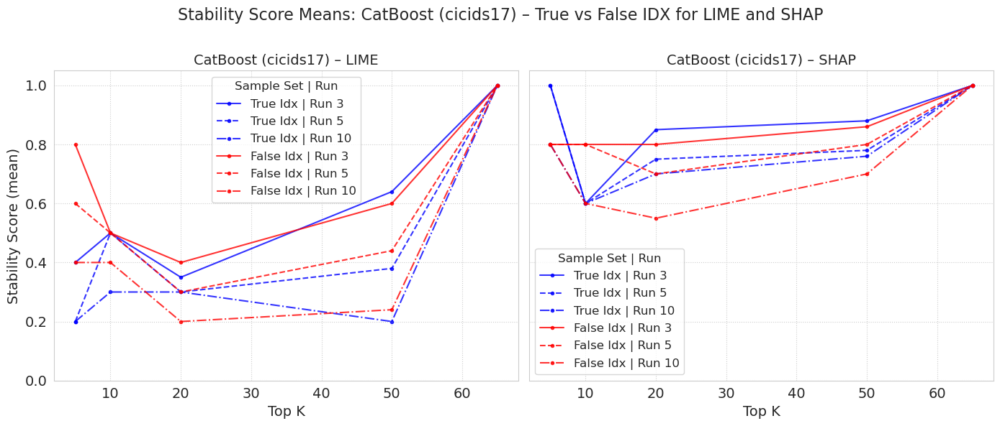


Stability scores for RandomForest (cicids17), lime:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  RandomForest  lime  false_idx          3    0.6     0.5    0.85    0.78     1.0
1  cicids17  RandomForest  lime  false_idx          5    0.6     0.4    0.70    0.68     1.0
2  cicids17  RandomForest  lime  false_idx         10    0.6     0.4    0.70    0.60     1.0
3  cicids17  RandomForest  lime   true_idx          3    0.8     0.7    0.75    0.76     1.0
4  cicids17  RandomForest  lime   true_idx          5    0.8     0.4    0.75    0.62     1.0
5  cicids17  RandomForest  lime   true_idx         10    0.6     0.4    0.70    0.56     1.0

Stability scores for RandomForest (cicids17), shap:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  RandomForest  shap  false_idx          3    0.8     0.7    0.95    0.86     1.0
1  cicids17  RandomForest  shap  false_idx          5    

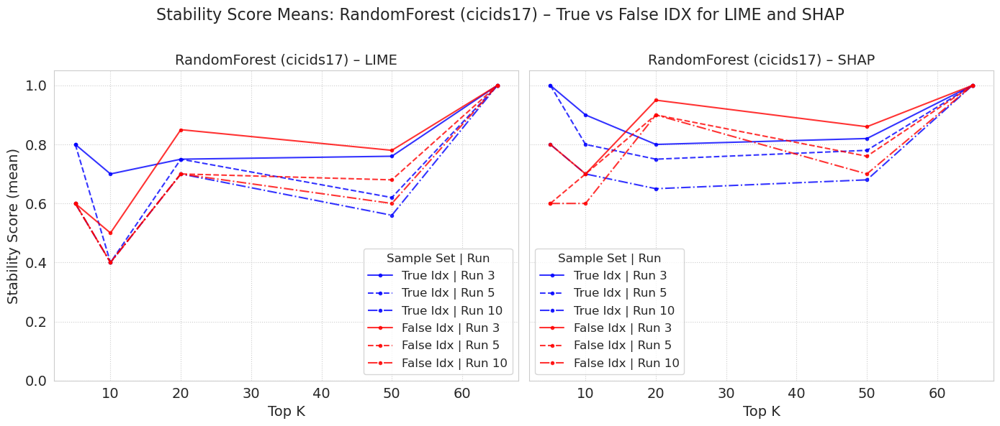


Stability scores for XGBoost (cicids17), lime:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  XGBoost  lime  false_idx          3    0.2     0.4    0.45    0.62     1.0
1  cicids17  XGBoost  lime  false_idx          5    0.2     0.3    0.20    0.38     1.0
2  cicids17  XGBoost  lime  false_idx         10    0.0     0.2    0.15    0.22     1.0
3  cicids17  XGBoost  lime   true_idx          3    0.0     0.2    0.30    0.58     1.0
4  cicids17  XGBoost  lime   true_idx          5    0.0     0.2    0.20    0.40     1.0
5  cicids17  XGBoost  lime   true_idx         10    0.0     0.1    0.20    0.22     1.0

Stability scores for XGBoost (cicids17), shap:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  XGBoost  shap  false_idx          3    0.4     0.9    0.75    0.70     1.0
1  cicids17  XGBoost  shap  false_idx          5    0.4     0.9    0.60    0.58     1.0
2  cicids17  XGBoost  sh

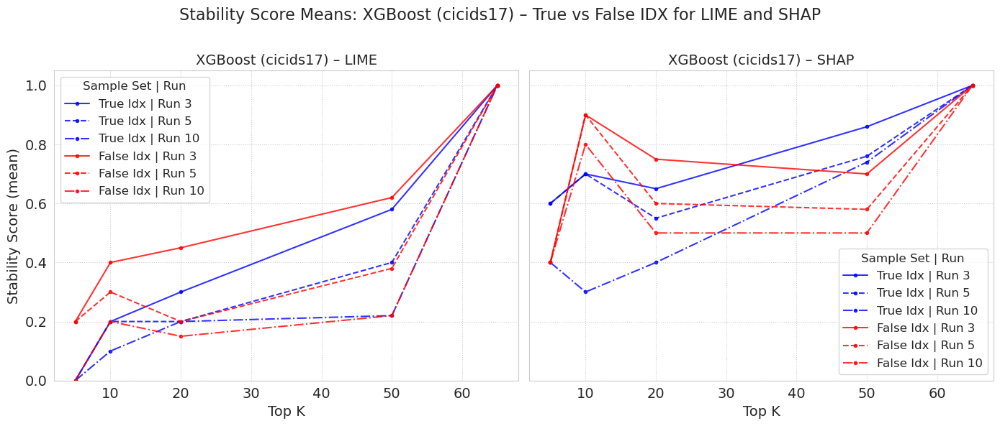


Stability scores for CatBoost (cicids18), lime:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  CatBoost  lime  false_idx          3    0.2     0.3    0.30    0.64     1.0
1  cicids18  CatBoost  lime  false_idx          5    0.2     0.2    0.25    0.44     1.0
2  cicids18  CatBoost  lime  false_idx         10    0.2     0.2    0.15    0.24     1.0
3  cicids18  CatBoost  lime   true_idx          3    0.8     0.5    0.40    0.64     1.0
4  cicids18  CatBoost  lime   true_idx          5    0.6     0.4    0.35    0.46     1.0
5  cicids18  CatBoost  lime   true_idx         10    0.4     0.3    0.20    0.30     1.0

Stability scores for CatBoost (cicids18), shap:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  CatBoost  shap  false_idx          3    0.8     0.7    0.70    0.80     1.0
1  cicids18  CatBoost  shap  false_idx          5    0.8     0.6    0.65    0.74     1.0
2  cicids18 

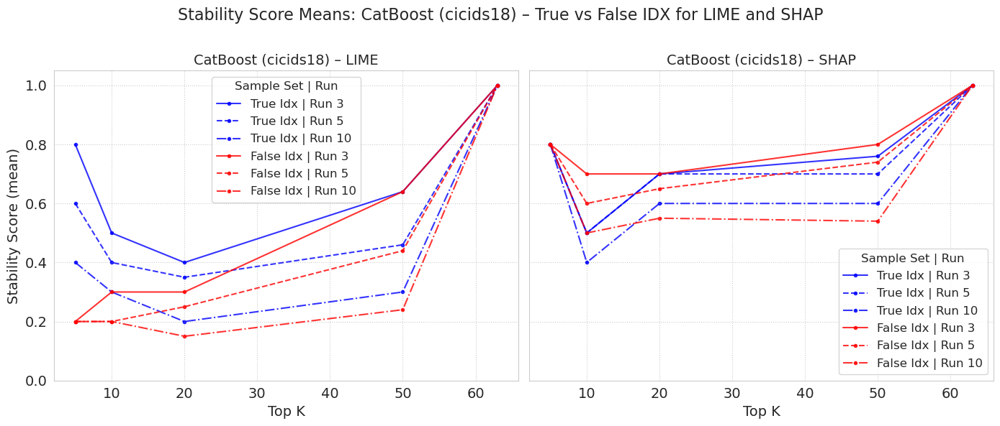


Stability scores for RandomForest (cicids18), lime:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  RandomForest  lime  false_idx          3    0.8     0.7    0.80    0.72     1.0
1  cicids18  RandomForest  lime  false_idx          5    0.8     0.7    0.75    0.62     1.0
2  cicids18  RandomForest  lime  false_idx         10    0.8     0.5    0.70    0.54     1.0
3  cicids18  RandomForest  lime   true_idx          3    0.8     0.7    0.85    0.82     1.0
4  cicids18  RandomForest  lime   true_idx          5    0.8     0.6    0.70    0.68     1.0
5  cicids18  RandomForest  lime   true_idx         10    0.8     0.5    0.60    0.50     1.0

Stability scores for RandomForest (cicids18), shap:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  RandomForest  shap  false_idx          3    1.0     0.8    0.75    0.84     1.0
1  cicids18  RandomForest  shap  false_idx          5    

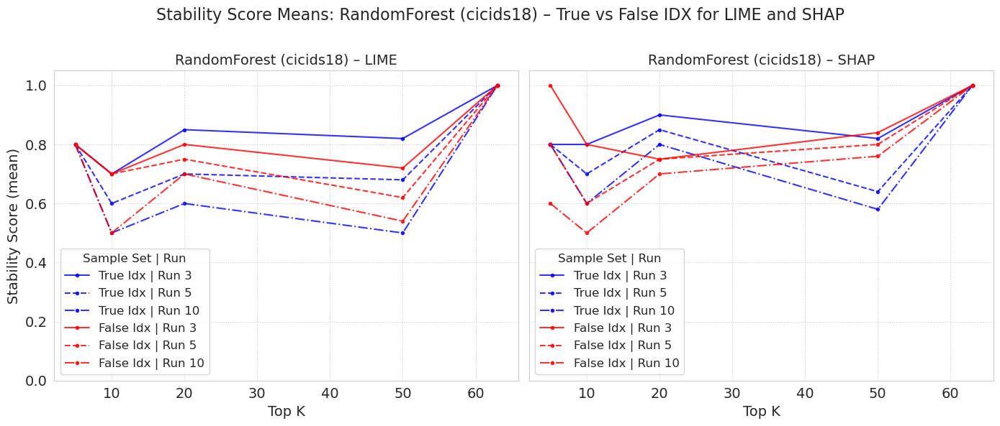


Stability scores for XGBoost (cicids18), lime:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  XGBoost  lime  false_idx          3    0.6     0.7    0.65    0.74     1.0
1  cicids18  XGBoost  lime  false_idx          5    0.6     0.6    0.50    0.52     1.0
2  cicids18  XGBoost  lime  false_idx         10    0.4     0.6    0.40    0.38     1.0
3  cicids18  XGBoost  lime   true_idx          3    0.8     0.8    0.70    0.76     1.0
4  cicids18  XGBoost  lime   true_idx          5    0.6     0.6    0.55    0.52     1.0
5  cicids18  XGBoost  lime   true_idx         10    0.6     0.6    0.50    0.40     1.0

Stability scores for XGBoost (cicids18), shap:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  XGBoost  shap  false_idx          3    0.6     0.6    0.70    0.80     1.0
1  cicids18  XGBoost  shap  false_idx          5    0.6     0.6    0.60    0.76     1.0
2  cicids18  XGBoost  sh

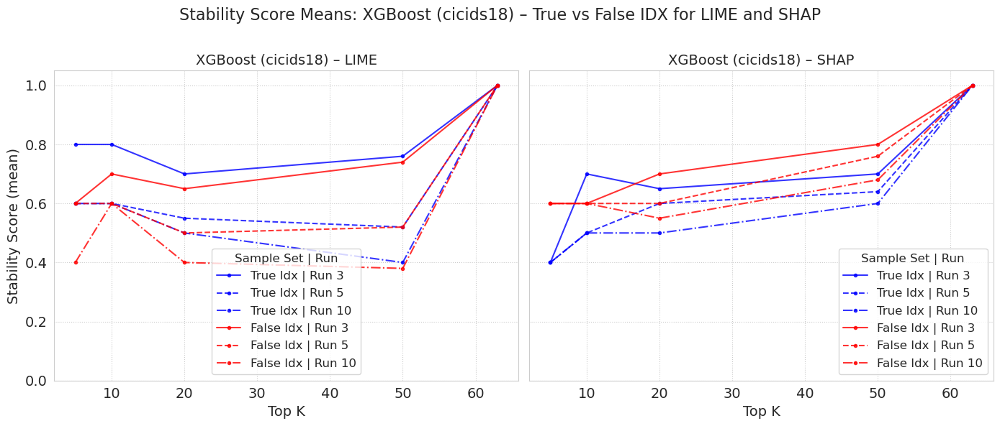

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Load and preprocess the data
df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")
df = df[df['sample_set'] != 'general_idx']
global_means = (
    df.groupby(['dataset', 'model', 'xai', 'sample_set', 'runs_base', 'top_k'], as_index=False)['stability_score'].mean()
)

plot_explainers = ['lime', 'shap']
sample_sets = ['true_idx', 'false_idx']
colors = {'true_idx': 'blue', 'false_idx': 'red'}
styles = {3: '-', 5: '--', 10: '-.'}
run_bases = [3, 5, 10]  # Modify if needed

final_df = pd.DataFrame()

os.makedirs("metrics/stability/plots", exist_ok=True)
os.makedirs("metrics/stability/tables", exist_ok=True)

for dataset in sorted(global_means['dataset'].unique()):
    for model in sorted(global_means['model'].unique()):
        fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)
        if len(axes) == 1:
            axes = [axes]
        for ax_idx, explainer in enumerate(plot_explainers):

            plot_df = global_means[
                (global_means['dataset'] == dataset) &
                (global_means['model'] == model) &
                (global_means['xai'] == explainer) &
                (global_means['sample_set'].isin(sample_sets))
            ]
            if plot_df.empty:
                axes[ax_idx].set_title(f"{model} ({dataset}) – {explainer.upper()}\nNo data", fontsize=12)
                continue

            df_wide = plot_df.pivot_table(
                index=['dataset', 'model', 'xai', 'sample_set', 'runs_base'],
                columns='top_k',
                values='stability_score'
            ).reset_index()
            df_wide.columns.name = None
            df_wide = df_wide.rename(
                columns=lambda c: f"top_{c}" if isinstance(c, int) else c
            )
            topk_cols = sorted(
                [col for col in df_wide.columns if col.startswith("top_")],
                key=lambda x: int(x.split("_")[1])
            )
            df_wide = df_wide[["dataset", "model", "xai", "sample_set", "runs_base"] + topk_cols]
            
            final_df = pd.concat([final_df, df_wide], ignore_index=True)

            print(f"\nStability scores for {model} ({dataset}), {explainer}:")
            print(df_wide)

            ax = axes[ax_idx]
            for sample_set in sample_sets:
                for run_base in run_bases:
                    sub = plot_df[
                        (plot_df['sample_set'] == sample_set) & 
                        (plot_df['runs_base'] == run_base)
                    ]
                    sub = sub.sort_values('top_k')
                    label = f"{sample_set.replace('_', ' ').title()} | Run {run_base}"
                    ax.plot(
                        sub['top_k'], sub['stability_score'],
                        label=label,
                        color=colors[sample_set],
                        linestyle=styles[run_base],
                        marker='o',
                        markersize=3,
                        alpha=0.8
                    )
            ax.set_title(f"{model} ({dataset}) – {explainer.upper()}", fontsize=14)
            ax.set_xlabel("Top K", fontsize=14)
            ax.grid(True, linestyle=":")
            ax.tick_params(labelsize=14)
            if ax_idx == 0:
                ax.set_ylabel("Stability Score (mean)", fontsize=14)
            ax.set_ylim(0, 1.05)
            ax.legend(title="Sample Set | Run", fontsize=12, title_fontsize=12)
        plt.suptitle(f"Stability Score Means: {model} ({dataset}) – True vs False IDX for LIME and SHAP", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.96])

        plt.savefig(f"metrics/final plots/stability_{dataset}_{model}_true_vs_false.png", dpi=300, bbox_inches='tight')
        plt.show()

#final_df.to_csv("metrics/stability/stability_true_vs_false_all.csv", index=False)



Stability scores for CatBoost (cicids17), lime:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  CatBoost  lime  false_idx          3    0.8     0.5    0.40    0.60     1.0
1  cicids17  CatBoost  lime  false_idx          5    0.6     0.5    0.30    0.44     1.0
2  cicids17  CatBoost  lime  false_idx         10    0.4     0.4    0.20    0.24     1.0
3  cicids17  CatBoost  lime   true_idx          3    0.4     0.5    0.35    0.64     1.0
4  cicids17  CatBoost  lime   true_idx          5    0.2     0.5    0.30    0.38     1.0
5  cicids17  CatBoost  lime   true_idx         10    0.2     0.3    0.30    0.20     1.0

Stability scores for CatBoost (cicids17), shap:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  CatBoost  shap  false_idx          3    0.8     0.8    0.80    0.86     1.0
1  cicids17  CatBoost  shap  false_idx          5    0.8     0.8    0.70    0.80     1.0
2  cicids17 

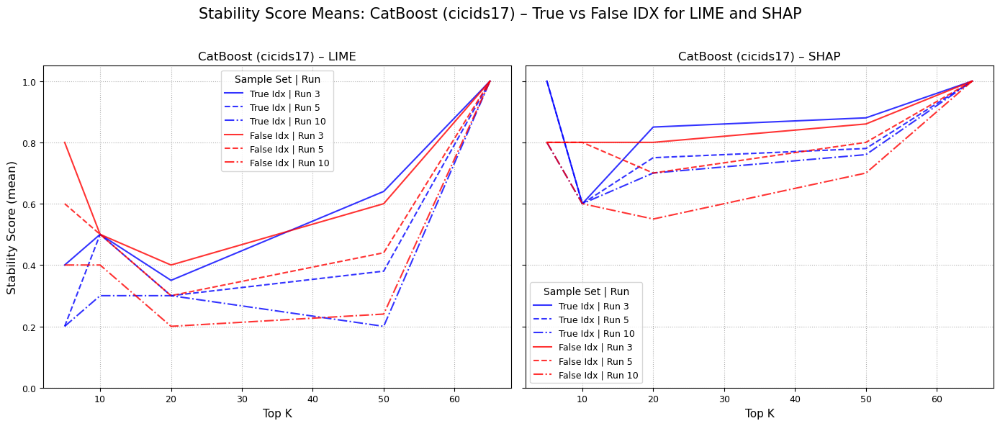


Stability scores for RandomForest (cicids17), lime:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  RandomForest  lime  false_idx          3    0.6     0.5    0.85    0.78     1.0
1  cicids17  RandomForest  lime  false_idx          5    0.6     0.4    0.70    0.68     1.0
2  cicids17  RandomForest  lime  false_idx         10    0.6     0.4    0.70    0.60     1.0
3  cicids17  RandomForest  lime   true_idx          3    0.8     0.7    0.75    0.76     1.0
4  cicids17  RandomForest  lime   true_idx          5    0.8     0.4    0.75    0.62     1.0
5  cicids17  RandomForest  lime   true_idx         10    0.6     0.4    0.70    0.56     1.0

Stability scores for RandomForest (cicids17), shap:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  RandomForest  shap  false_idx          3    0.8     0.7    0.95    0.86     1.0
1  cicids17  RandomForest  shap  false_idx          5    

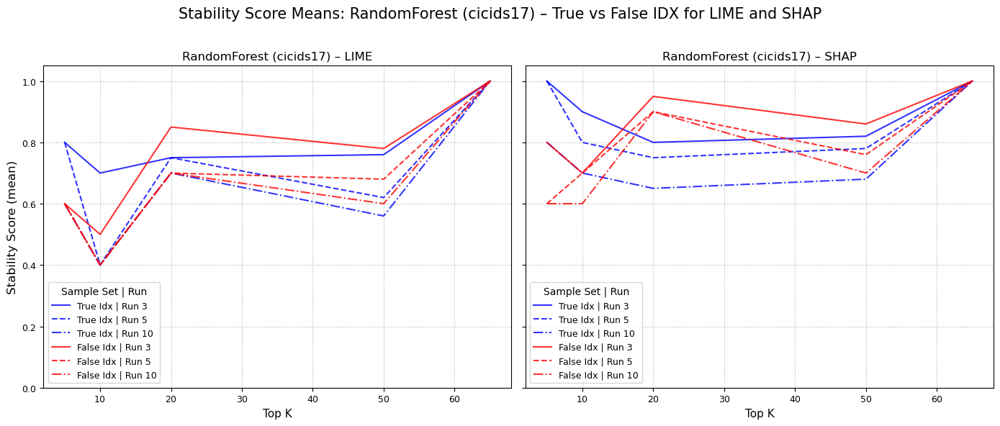


Stability scores for XGBoost (cicids17), lime:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  XGBoost  lime  false_idx          3    0.2     0.4    0.45    0.62     1.0
1  cicids17  XGBoost  lime  false_idx          5    0.2     0.3    0.20    0.38     1.0
2  cicids17  XGBoost  lime  false_idx         10    0.0     0.2    0.15    0.22     1.0
3  cicids17  XGBoost  lime   true_idx          3    0.0     0.2    0.30    0.58     1.0
4  cicids17  XGBoost  lime   true_idx          5    0.0     0.2    0.20    0.40     1.0
5  cicids17  XGBoost  lime   true_idx         10    0.0     0.1    0.20    0.22     1.0

Stability scores for XGBoost (cicids17), shap:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0  cicids17  XGBoost  shap  false_idx          3    0.4     0.9    0.75    0.70     1.0
1  cicids17  XGBoost  shap  false_idx          5    0.4     0.9    0.60    0.58     1.0
2  cicids17  XGBoost  sh

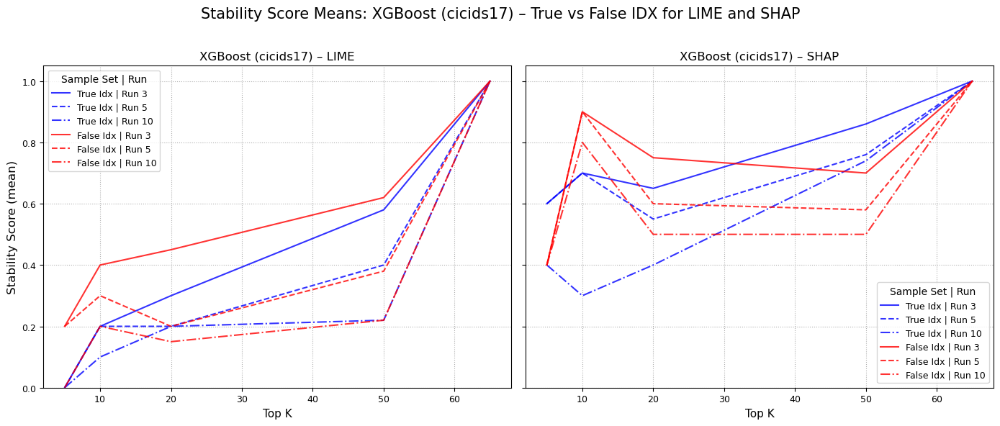


Stability scores for CatBoost (cicids18), lime:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  CatBoost  lime  false_idx          3    0.2     0.3    0.30    0.64     1.0
1  cicids18  CatBoost  lime  false_idx          5    0.2     0.2    0.25    0.44     1.0
2  cicids18  CatBoost  lime  false_idx         10    0.2     0.2    0.15    0.24     1.0
3  cicids18  CatBoost  lime   true_idx          3    0.8     0.5    0.40    0.64     1.0
4  cicids18  CatBoost  lime   true_idx          5    0.6     0.4    0.35    0.46     1.0
5  cicids18  CatBoost  lime   true_idx         10    0.4     0.3    0.20    0.30     1.0

Stability scores for CatBoost (cicids18), shap:
    dataset     model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  CatBoost  shap  false_idx          3    0.8     0.7    0.70    0.80     1.0
1  cicids18  CatBoost  shap  false_idx          5    0.8     0.6    0.65    0.74     1.0
2  cicids18 

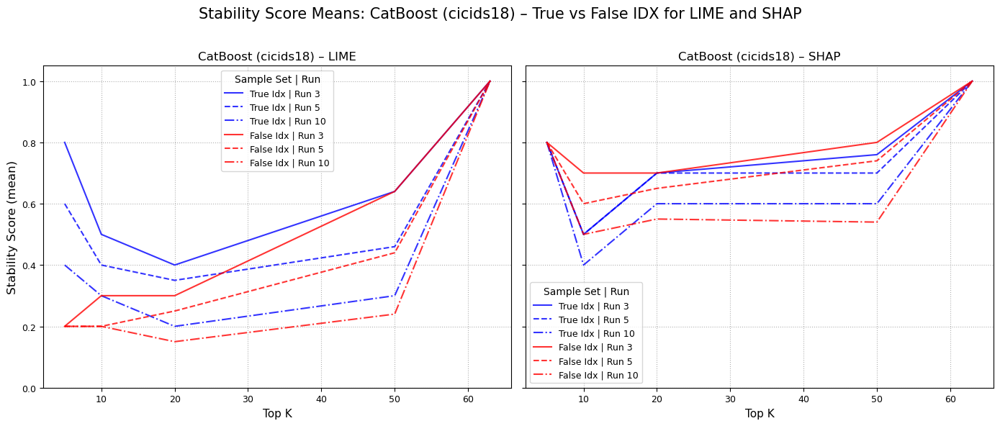


Stability scores for RandomForest (cicids18), lime:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  RandomForest  lime  false_idx          3    0.8     0.7    0.80    0.72     1.0
1  cicids18  RandomForest  lime  false_idx          5    0.8     0.7    0.75    0.62     1.0
2  cicids18  RandomForest  lime  false_idx         10    0.8     0.5    0.70    0.54     1.0
3  cicids18  RandomForest  lime   true_idx          3    0.8     0.7    0.85    0.82     1.0
4  cicids18  RandomForest  lime   true_idx          5    0.8     0.6    0.70    0.68     1.0
5  cicids18  RandomForest  lime   true_idx         10    0.8     0.5    0.60    0.50     1.0

Stability scores for RandomForest (cicids18), shap:
    dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  RandomForest  shap  false_idx          3    1.0     0.8    0.75    0.84     1.0
1  cicids18  RandomForest  shap  false_idx          5    

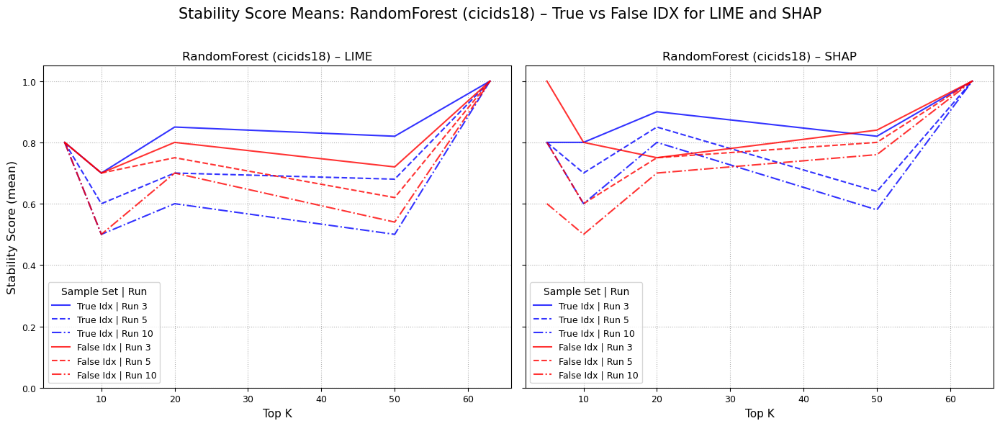


Stability scores for XGBoost (cicids18), lime:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  XGBoost  lime  false_idx          3    0.6     0.7    0.65    0.74     1.0
1  cicids18  XGBoost  lime  false_idx          5    0.6     0.6    0.50    0.52     1.0
2  cicids18  XGBoost  lime  false_idx         10    0.4     0.6    0.40    0.38     1.0
3  cicids18  XGBoost  lime   true_idx          3    0.8     0.8    0.70    0.76     1.0
4  cicids18  XGBoost  lime   true_idx          5    0.6     0.6    0.55    0.52     1.0
5  cicids18  XGBoost  lime   true_idx         10    0.6     0.6    0.50    0.40     1.0

Stability scores for XGBoost (cicids18), shap:
    dataset    model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_63
0  cicids18  XGBoost  shap  false_idx          3    0.6     0.6    0.70    0.80     1.0
1  cicids18  XGBoost  shap  false_idx          5    0.6     0.6    0.60    0.76     1.0
2  cicids18  XGBoost  sh

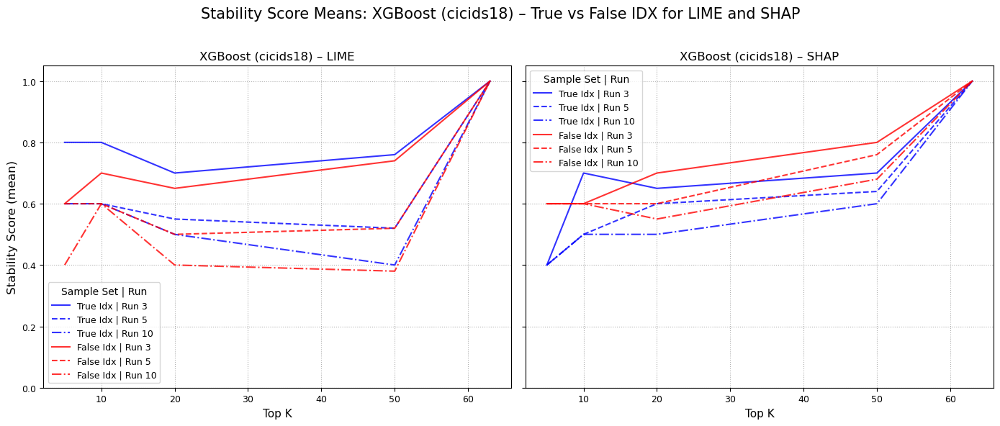

In [62]:
import pandas as pd
import matplotlib.pyplot as plt

# Load and preprocess the data
df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")
df = df[df['sample_set'] != 'general_idx']
global_means = (
    df.groupby(['dataset', 'model', 'xai', 'sample_set', 'runs_base', 'top_k'], as_index=False)['stability_score'].mean()
)

plot_explainers = ['lime', 'shap']
sample_sets = ['true_idx', 'false_idx']
colors = {'true_idx': 'blue', 'false_idx': 'red'}
styles = {3: '-', 5: '--', 10: '-.'}
run_bases = [3, 5, 10]  # Modify if needed

final_df = pd.DataFrame()

for dataset in sorted(global_means['dataset'].unique()):
    for model in sorted(global_means['model'].unique()):
        fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)
        for ax_idx, explainer in enumerate(plot_explainers):
            # Filter for current dataset/model/explainer/sample_sets
            plot_df = global_means[
                (global_means['dataset'] == dataset) &
                (global_means['model'] == model) &
                (global_means['xai'] == explainer) &
                (global_means['sample_set'].isin(sample_sets))
            ]
            if plot_df.empty:
                axes[ax_idx].set_title(f"{model} ({dataset}) – {explainer.upper()}\nNo data")
                continue

            df_wide = plot_df.pivot_table(
                index=['dataset', 'model', 'xai', 'sample_set', 'runs_base'],
                columns='top_k',
                values='stability_score'
            ).reset_index()
            df_wide.columns.name = None
            df_wide = df_wide.rename(
                columns=lambda c: f"top_{c}" if isinstance(c, int) else c
            )
            topk_cols = sorted(
                [col for col in df_wide.columns if col.startswith("top_")],
                key=lambda x: int(x.split("_")[1])
            )
            df_wide = df_wide[["dataset", "model", "xai", "sample_set", "runs_base"] + topk_cols]

            print(f"\nStability scores for {model} ({dataset}), {explainer}:")
            print(df_wide)

            ax = axes[ax_idx]
            for sample_set in sample_sets:
                for run_base in run_bases:
                    sub = plot_df[
                        (plot_df['sample_set'] == sample_set) & 
                        (plot_df['runs_base'] == run_base)
                    ]
                    sub = sub.sort_values('top_k')
                    label = f"{sample_set.replace('_', ' ').title()} | Run {run_base}"
                    ax.plot(
                        sub['top_k'], sub['stability_score'],
                        label=label,
                        color=colors[sample_set],
                        linestyle=styles[run_base],
                        marker='o',
                        markersize=6,
                        alpha=0.8
                    )
            ax.set_title(f"{model} ({dataset}) – {explainer.upper()}")
            ax.set_xlabel("Top K", fontsize=12)
            ax.grid(True, linestyle=":")
            ax.tick_params(labelsize=9)
            if ax_idx == 0:
                ax.set_ylabel("Stability Score (mean)", fontsize=12)
            ax.set_ylim(0, 1.05)
            ax.legend(title="Sample Set | Run", fontsize=9)
        plt.suptitle(f"Stability Score Means: {model} ({dataset}) – True vs False IDX for LIME and SHAP", fontsize=15)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.savefig(f"metrics/stability/plots/stability_{dataset}_{model}_true_vs_false.png", dpi=300, bbox_inches='tight')
        plt.show()

    dataset     model   xai sample_set  runs_base  top_k  stability_score
0  cicids17  CatBoost  lime  false_idx          3      5             0.80
1  cicids17  CatBoost  lime  false_idx          3     10             0.50
2  cicids17  CatBoost  lime  false_idx          3     20             0.40
3  cicids17  CatBoost  lime  false_idx          3     50             0.60
4  cicids17  CatBoost  lime  false_idx          3     65             1.00
5  cicids17  CatBoost  lime  false_idx          5      5             0.60
6  cicids17  CatBoost  lime  false_idx          5     10             0.50
7  cicids17  CatBoost  lime  false_idx          5     20             0.30
8  cicids17  CatBoost  lime  false_idx          5     50             0.44
9  cicids17  CatBoost  lime  false_idx          5     65             1.00
     dataset     model   xai sample_set  runs_base  top_k  stability_score
30  cicids17  CatBoost  shap  false_idx          3      5             0.80
31  cicids17  CatBoost  shap  false_

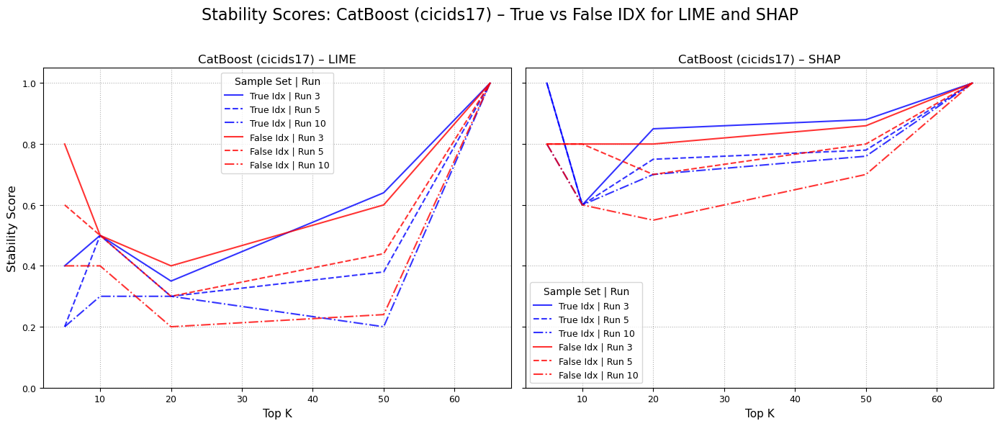

In [57]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")
df = df[df['sample_set'] != 'general_idx']

global_means = (
    df.groupby(['dataset', 'model', 'xai', 'sample_set', 'runs_base', 'top_k'], as_index=False)['stability_score'].mean()
)

# Configuration
plot_explainers = ['lime', 'shap']
sample_sets = ['true_idx', 'false_idx']
colors = {'true_idx': 'blue', 'false_idx': 'red'}
styles = {3: '-', 5: '--', 10: '-.'}
run_bases = [3, 5, 10]  # or extract from data

fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)
for ax_idx, explainer in enumerate(plot_explainers):
    ax = axes[ax_idx]
    plot_df = global_means[
        (global_means['dataset'] == 'cicids17') &
        (global_means['model'] == 'CatBoost') &
        (global_means['xai'] == explainer) &
        (global_means['sample_set'].isin(sample_sets))
    ]
    print(plot_df.head(10))
    topks = sorted(plot_df['top_k'].unique())
    for sample_set in sample_sets:
        for run_base in run_bases:
            sub = plot_df[
                (plot_df['sample_set'] == sample_set) & 
                (plot_df['runs_base'] == run_base)
            ]
            sub = sub.sort_values('top_k')
            label = f"{sample_set.replace('_', ' ').title()} | Run {run_base}"
            ax.plot(sub['top_k'], sub['stability_score'],
                    label=label,
                    color=colors[sample_set],
                    linestyle=styles[run_base],
                    #marker='o', 
                    alpha=0.8)
    ax.set_title(f"CatBoost (cicids17) – {explainer.upper()}")
    ax.set_xlabel("Top K", fontsize=11)
    ax.grid(True, linestyle=":")
    ax.tick_params(labelsize=9)
    if ax_idx == 0:
        ax.set_ylabel("Stability Score (mean)", fontsize=12)
    ax.set_ylim(0, 1.05)
    ax.legend(title="Sample Set | Run", fontsize=9)

plt.suptitle("Stability Score Means: CatBoost (cicids17) – True vs False IDX for LIME and SHAP", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [50]:
import pandas as pd
import matplotlib.pyplot as plt
import os

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")
df = df[df['sample_set'] != 'general_idx']

global_means = (df.groupby(['dataset', 
                     'model', 
                     'xai', 
                     'sample_set', 
                     'runs_base', 
                     'top_k'], as_index=False)['stability_score'].mean())

#print(global_means.head(50))

xai_palette = {"lime": "blue", "shap": "red"}
run_styles = ['-', '--', '-.', ':']
datasets = ["cicids17", "cicids18"]
sample_sets = ["true_idx", "false_idx"]

for target_dataset in datasets:
    for explainer in global_means["xai"].unique():
        print(f"\nResults for dataset: {target_dataset}, explainer: {explainer}")
        # Filter by dataset and current sample set
        df_filtered = global_means[
            (global_means["dataset"] == target_dataset) &
            (global_means["xai"] == explainer)
        ]
        if df_filtered.empty:
            print("No data for this sample set and dataset.")
            continue
        # Pivot the filtered DataFrame
        df_wide = df_filtered.pivot_table(
            index=["dataset", "model", "xai", "sample_set", "runs_base"],
            columns="top_k",
            values="stability_score"
        ).reset_index()
        df_wide.columns.name = None
        df_wide = df_wide.rename(columns=lambda c: f"top_{c}" if isinstance(c, int) else c)
        topk_cols = sorted([col for col in df_wide.columns if col.startswith("top_")],
                           key=lambda x: int(x.split("_")[1]))
        df_wide = df_wide[["dataset", "model", "xai", "sample_set", "runs_base"] + topk_cols]
        # Show table
        print(df_wide)
        


Results for dataset: cicids17, explainer: lime
     dataset         model   xai sample_set  runs_base  top_5  top_10  top_20  top_50  top_65
0   cicids17      CatBoost  lime  false_idx          3    0.8     0.5    0.40    0.60     1.0
1   cicids17      CatBoost  lime  false_idx          5    0.6     0.5    0.30    0.44     1.0
2   cicids17      CatBoost  lime  false_idx         10    0.4     0.4    0.20    0.24     1.0
3   cicids17      CatBoost  lime   true_idx          3    0.4     0.5    0.35    0.64     1.0
4   cicids17      CatBoost  lime   true_idx          5    0.2     0.5    0.30    0.38     1.0
5   cicids17      CatBoost  lime   true_idx         10    0.2     0.3    0.30    0.20     1.0
6   cicids17  RandomForest  lime  false_idx          3    0.6     0.5    0.85    0.78     1.0
7   cicids17  RandomForest  lime  false_idx          5    0.6     0.4    0.70    0.68     1.0
8   cicids17  RandomForest  lime  false_idx         10    0.6     0.4    0.70    0.60     1.0
9   cicids17

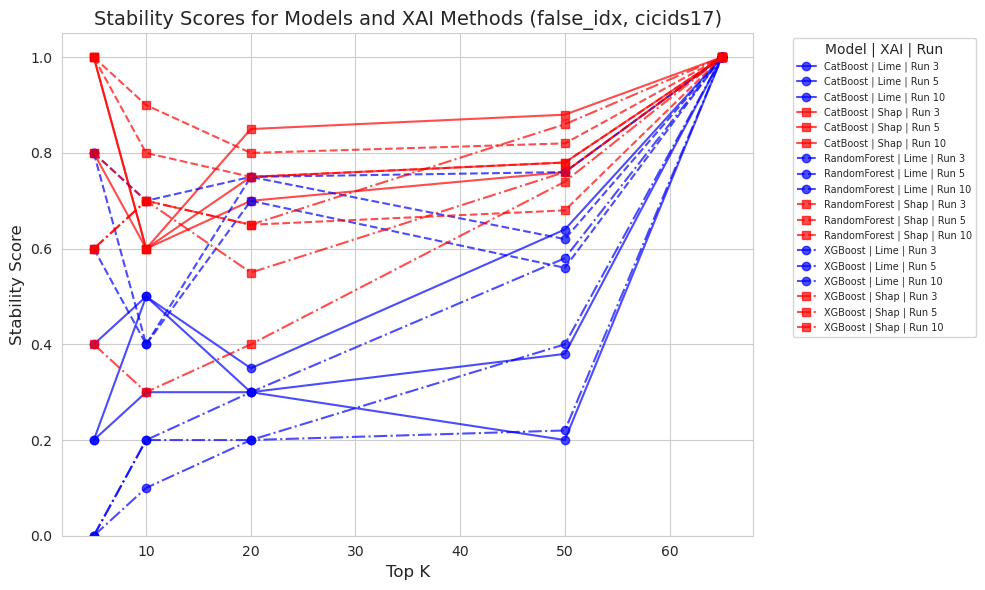

In [52]:
import matplotlib.pyplot as plt
import os

xai_palette = {"lime": "blue", "shap": "red"}
models = df_wide["model"].unique()
runs_bases = sorted(df_wide["runs_base"].unique())
topk_cols = sorted([col for col in df_wide.columns if col.startswith("top_")], key=lambda x: int(x.split("_")[1]))
model_styles = ['-', '--', '-.', ':']  # Extend if you have more models

plt.figure(figsize=(10, 6))

for m_idx, model in enumerate(models):
    style = model_styles[m_idx % len(model_styles)]
    for xai in ['lime', 'shap']:
        subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
        if subset.empty:
            continue
        for _, row in subset.iterrows():
            run = row["runs_base"]
            label = f"{model} | {xai.capitalize()} | Run {run}"
            plt.plot(
                [int(col.split("_")[1]) for col in topk_cols],
                [row[col] for col in topk_cols],
                label=label,
                color=xai_palette[xai],
                linestyle=style,
                marker='o' if xai == 'lime' else 's',
                alpha=0.7
            )

plt.title("Stability Scores for Models and XAI Methods (false_idx, cicids17)", fontsize=14)
plt.xlabel("Top K", fontsize=12)
plt.ylabel("Stability Score", fontsize=12)
plt.ylim(0, 1.05)
plt.legend(fontsize=7, title="Model | XAI | Run", bbox_to_anchor=(1.05, 1), loc="upper left")  # <-- Typo fixed!
plt.tight_layout()

filename = f"metrics/stability/plots/{dataset}_all_models_false_stability.png"
os.makedirs("metrics/stability/plots", exist_ok=True)
plt.savefig(filename, dpi=300, bbox_inches='tight')

plt.show()


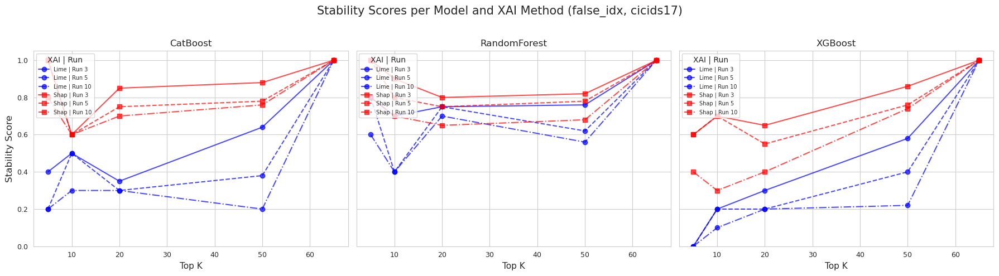

In [53]:
import matplotlib.pyplot as plt

xai_palette = {"lime": "blue", "shap": "red"}
runs_bases = sorted(df_wide["runs_base"].unique())
topk_cols = sorted([col for col in df_wide.columns if col.startswith("top_")], key=lambda x: int(x.split("_")[1]))
run_styles = ['-', '--', '-.', ':']  # Extend for more runs
models = df_wide["model"].unique()

fig, axs = plt.subplots(1, len(models), figsize=(18, 5), sharey=True)

for m_idx, model in enumerate(models):
    ax = axs[m_idx]
    for xai in ['lime', 'shap']:
        subset = df_wide[(df_wide["model"] == model) & (df_wide["xai"] == xai)]
        if subset.empty:
            continue
        for r_idx, (_, row) in enumerate(subset.iterrows()):
            run = row["runs_base"]
            label = f"{xai.capitalize()} | Run {run}"
            style = run_styles[r_idx % len(run_styles)]
            ax.plot(
                [int(col.split("_")[1]) for col in topk_cols],
                [row[col] for col in topk_cols],
                label=label,
                color=xai_palette[xai],
                linestyle=style,
                marker='o' if xai == 'lime' else 's',
                alpha=0.7
            )
    ax.set_title(model)
    ax.set_xlabel("Top K", fontsize=11)
    if m_idx == 0:
        ax.set_ylabel("Stability Score", fontsize=12)
    ax.set_ylim(0, 1.05)
    ax.legend(fontsize=7, title="XAI | Run", loc="upper left")
    ax.tick_params(labelsize=9)

plt.suptitle("Stability Scores per Model and XAI Method (false_idx, cicids17)", fontsize=15)
plt.tight_layout(rect=[0, 0, 1, 0.96])
filename = f"metrics/stability/plots/{dataset}_all_models_false_divided_stability.png"
os.makedirs("metrics/stability/plots", exist_ok=True)
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()


### Visualization

#### Mean Values of Samplesets - Dataset | Model | Runs | Lime vs Shap

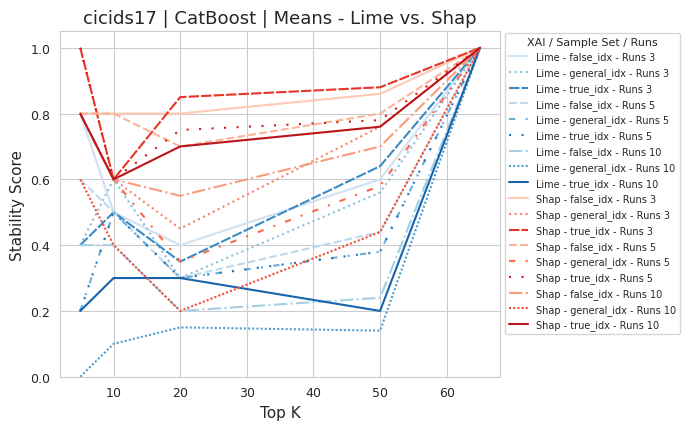

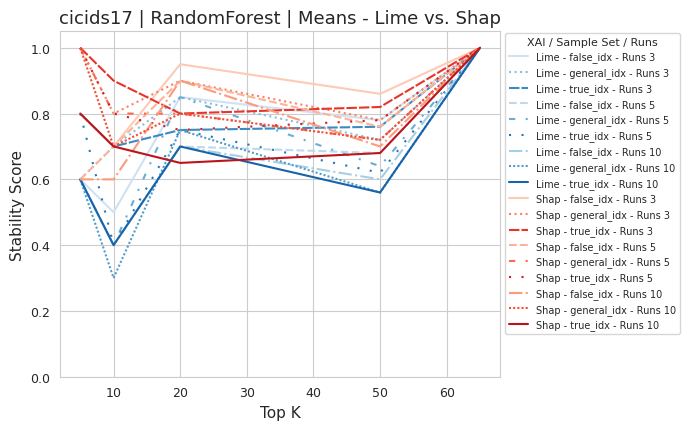

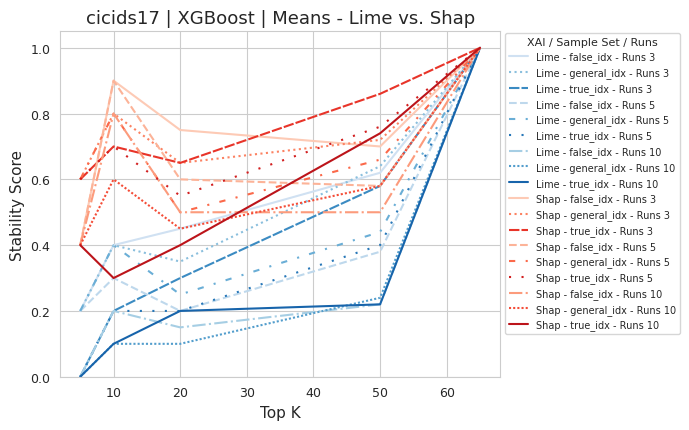

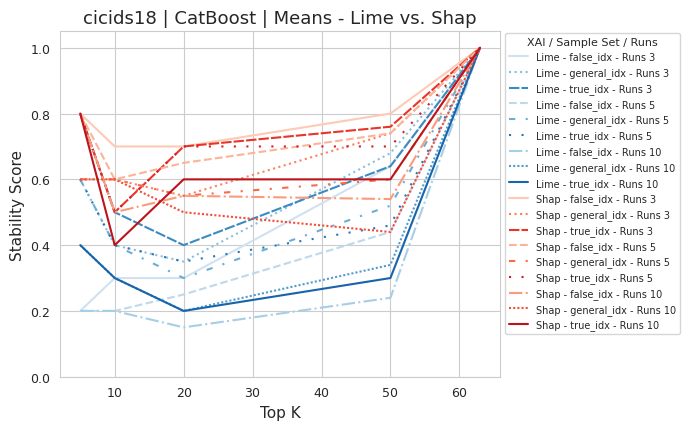

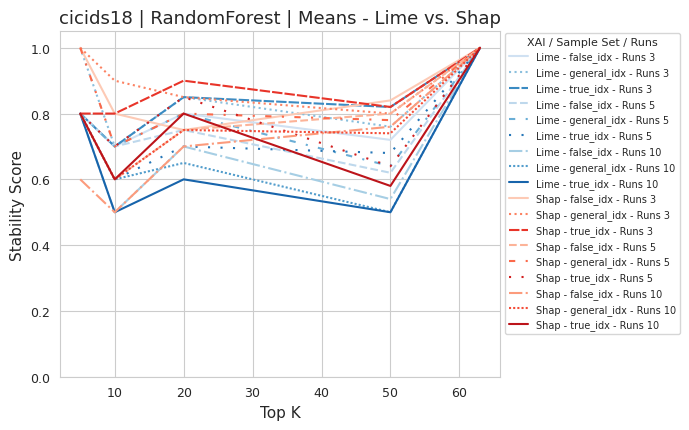

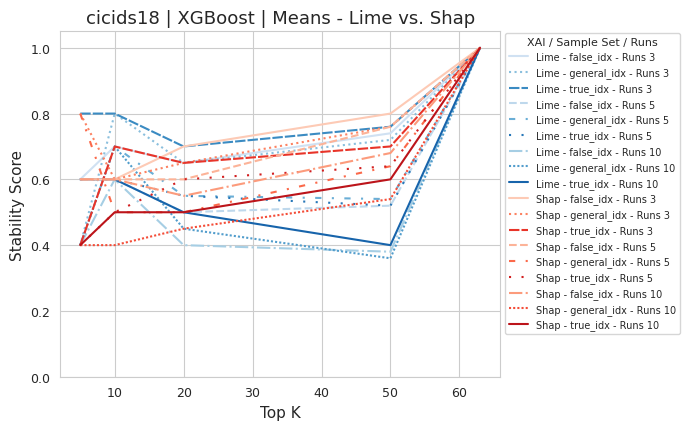

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib
import os
from matplotlib.colors import to_hex

sns.set_style("whitegrid")

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")

global_means = (df.groupby(['dataset', 
                     'model', 
                     'xai', 
                     'sample_set', 
                     'runs_base', 
                     'top_k'], as_index=False)['stability_score'].mean())

global_means.columns = global_means.columns.str.strip()
global_means['xai'] = global_means['xai'].str.capitalize()

sample_sets = global_means['sample_set'].unique()
runs_bases = sorted(global_means['runs_base'].unique())
xai_methods = ['Lime', 'Shap']

# Define robust line styles
line_styles = ['-', '--', '-.', ':', (0, (3, 5, 1, 5)), (0, (1, 1)), (0, (5, 1)), (0, (1, 5))]
marker_shapes = ['o', 's', '^', 'D', 'v', '*']

# Prepare colormaps with the recommended API—no number of colors in get_cmap
lime_cmap = matplotlib.colormaps.get_cmap('Blues')
shap_cmap = matplotlib.colormaps.get_cmap('Reds')

def get_style_maps(cmap, combos):
    n = len(combos)
    # Spaces indices in [0.2, 0.8] for better midrange visibility
    idxs = np.linspace(0.2, 0.8, n)
    color_map = {comb: to_hex(cmap(idx)) for comb, idx in zip(combos, idxs)}
    style_map = {comb: line_styles[i % len(line_styles)] for i, comb in enumerate(combos)}
    return color_map, style_map

combos_lime = [(s, r) for s in sample_sets for r in runs_bases]
combos_shap = [(s, r) for s in sample_sets for r in runs_bases]

color_map_lime, style_map_lime = get_style_maps(lime_cmap, combos_lime)
color_map_shap, style_map_shap = get_style_maps(shap_cmap, combos_shap)

datasets = global_means['dataset'].unique()
models = global_means['model'].unique()

for dataset in datasets:
    for model in models:
        fig, ax = plt.subplots(figsize=(7, 4.5))
        plotted = False

        for xi, xai in enumerate(xai_methods):
            method_df = global_means[
                (global_means['dataset'] == dataset) &
                (global_means['model'] == model) &
                (global_means['xai'] == xai)
            ]
            if method_df.empty:
                continue

            for runs_base in runs_bases:
                for s, sample_set in enumerate(sample_sets):
                    subdf = method_df[
                        (method_df['runs_base'] == runs_base) &
                        (method_df['sample_set'] == sample_set)
                    ]
                    if subdf.empty:
                        continue
                    subdf_sorted = subdf.sort_values('top_k')
                    key = (sample_set, runs_base)

                    if xai == 'Lime':
                        color = color_map_lime.get(key, '#4472c4')
                        linestyle = style_map_lime.get(key, '-')
                    else:
                        color = color_map_shap.get(key, '#ed7d31')
                        linestyle = style_map_shap.get(key, '-')

                    ax.plot(
                        subdf_sorted['top_k'],
                        subdf_sorted['stability_score'],
                        label=f"{xai} - {sample_set} - Runs {runs_base}",
                        color=color,
                        linestyle=linestyle,
                        marker=marker_shapes[s % len(marker_shapes)],
                        markersize=0
                    )
                    plotted = True

        if not plotted:
            plt.close(fig)
            continue

        ax.set_xlabel("Top K", fontsize=11)
        ax.set_ylabel("Stability Score", fontsize=11)
        ax.set_title(f"{dataset} | {model} | Means - Lime vs. Shap", fontsize=13)
        ax.legend(title="XAI / Sample Set / Runs", fontsize=7, title_fontsize=8, loc='upper left', bbox_to_anchor=(1, 1.01))
        ax.tick_params(labelsize=9)
        y_data_max = global_means[
            (global_means['dataset'] == dataset) & (global_means['model'] == model)
        ]['stability_score'].max()
        if y_data_max >= 1.0:
            ax.set_ylim(0, 1.05)
        else:
            ax.set_ylim(0, min(1.0, y_data_max + 0.05))
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        filename = f"metrics/stability/plots/{dataset}_{model}_stability.png"
        os.makedirs("metrics/stability/plots", exist_ok=True)
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        
        plt.show()


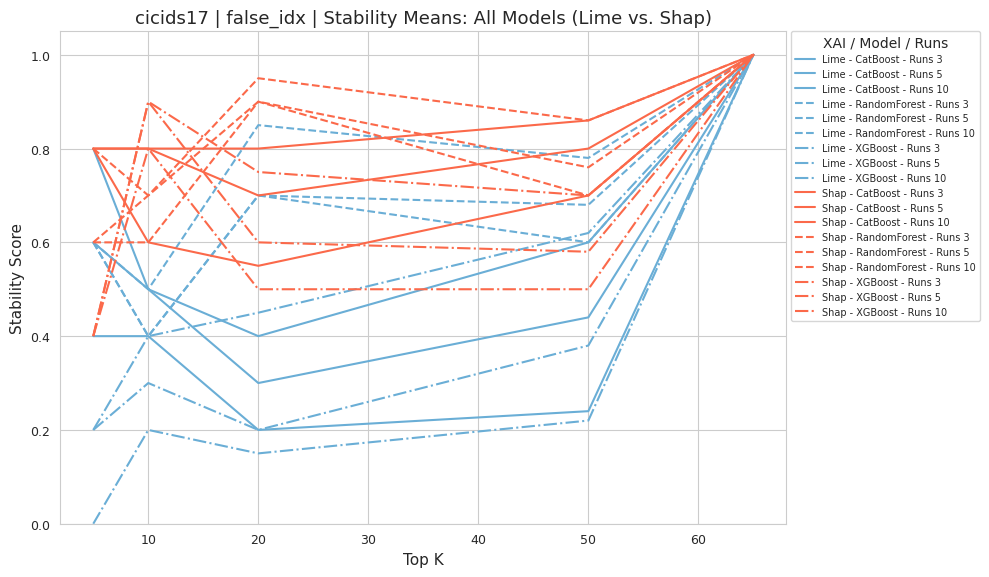

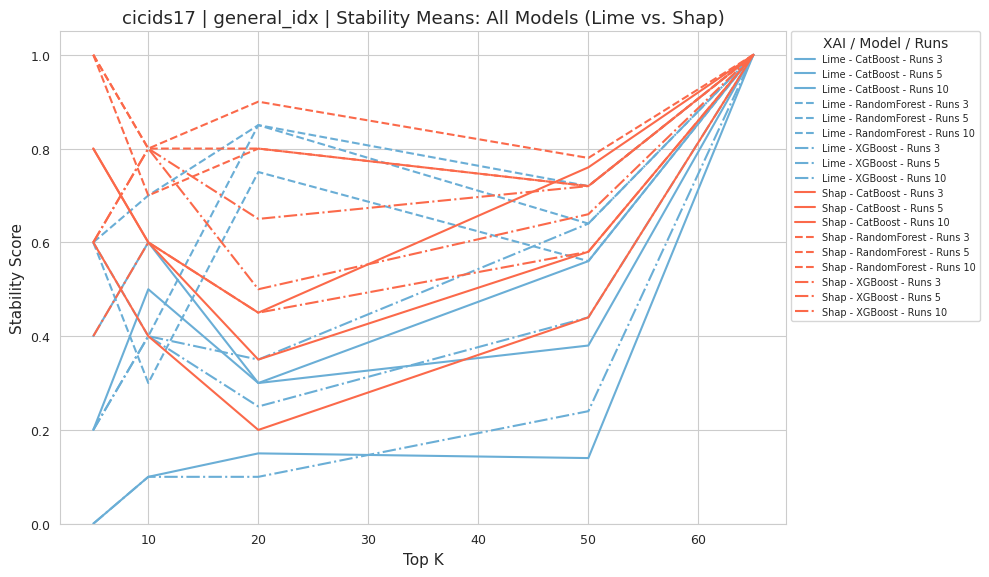

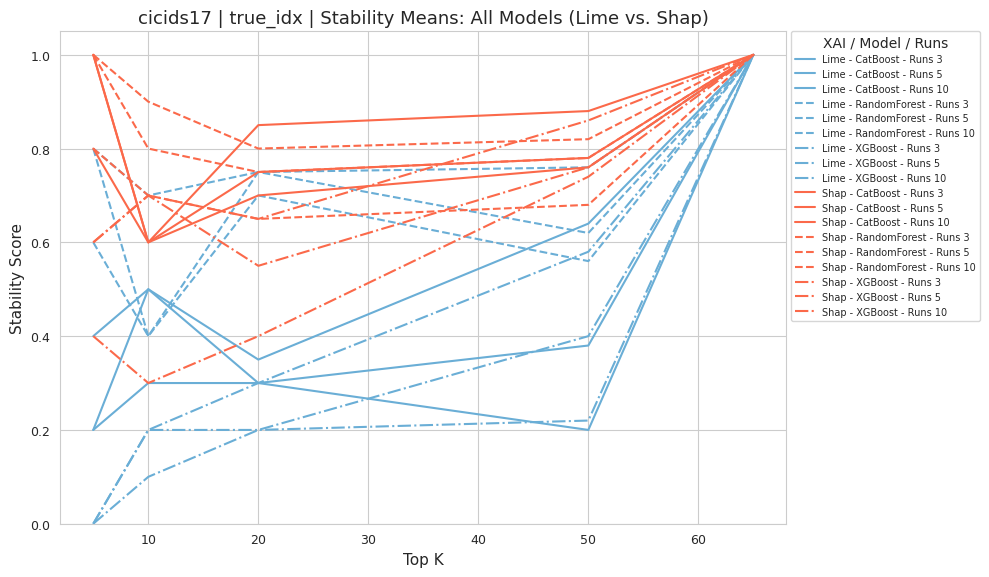

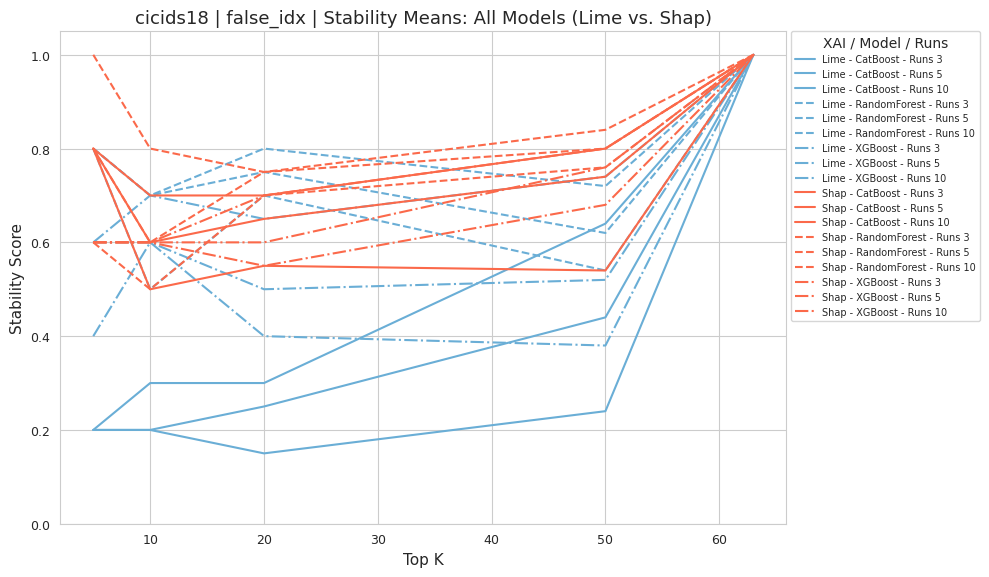

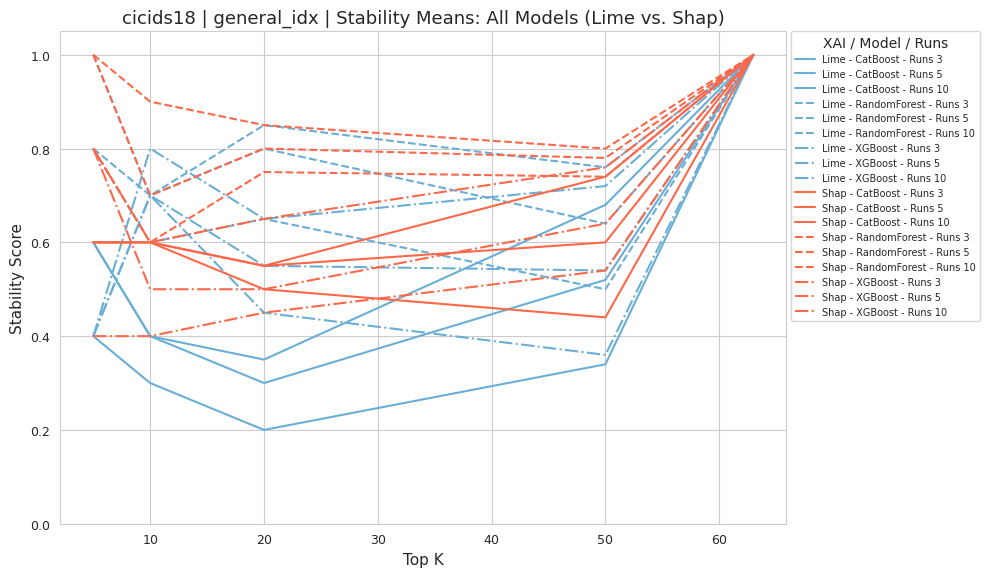

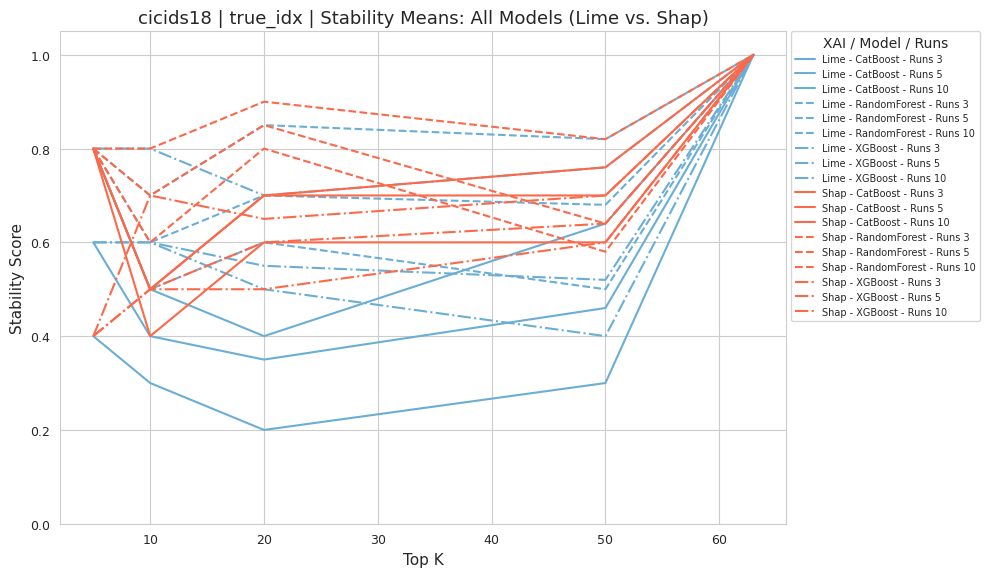

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib
import os
from matplotlib.colors import to_hex
sns.set_style("whitegrid")
df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")

global_means = (df.groupby(['dataset', 
                           'model', 
                           'xai', 
                           'sample_set', 
                           'runs_base', 
                           'top_k'], as_index=False)['stability_score'].mean())
global_means.columns = global_means.columns.str.strip()
global_means['xai'] = global_means['xai'].str.capitalize()

sample_sets = global_means['sample_set'].unique()
runs_bases = sorted(global_means['runs_base'].unique())
xai_methods = ['Lime', 'Shap']
line_styles = ['-', '--', '-.', ':', (0, (3, 5, 1, 5)), (0, (1, 1)), (0, (5, 1)), (0, (1, 5))]
marker_shapes = ['o', 's', '^', 'D', 'v', '*']

lime_cmap = matplotlib.colormaps.get_cmap('Blues')
shap_cmap = matplotlib.colormaps.get_cmap('Reds')

datasets = global_means['dataset'].unique()
models = global_means['model'].unique()

for dataset in datasets:
    for sample_set in sample_sets:
        fig, ax = plt.subplots(figsize=(10, 6))
        plotted = False
        for xi, xai in enumerate(xai_methods):
            method_df = global_means[
                (global_means['dataset'] == dataset) &
                (global_means['xai'] == xai) &
                (global_means['sample_set'] == sample_set)
            ]
            if method_df.empty:
                continue
            for m, model in enumerate(models):
                for runs_base in runs_bases:
                    subdf = method_df[
                        (method_df['model'] == model) &
                        (method_df['runs_base'] == runs_base)
                    ]
                    if subdf.empty:
                        continue
                    subdf_sorted = subdf.sort_values('top_k')
                    color = lime_cmap(0.5) if xai == 'Lime' else shap_cmap(0.5)
                    linestyle = line_styles[m % len(line_styles)]
                    ax.plot(
                        subdf_sorted['top_k'],
                        subdf_sorted['stability_score'],
                        label=f"{xai} - {model} - Runs {runs_base}",
                        color=to_hex(color),
                        linestyle=linestyle,
                        marker=marker_shapes[m % len(marker_shapes)],
                        markersize=0
                    )
                    plotted = True
        if not plotted:
            plt.close(fig)
            continue
        ax.set_xlabel("Top K", fontsize=11)
        ax.set_ylabel("Stability Score", fontsize=11)
        ax.set_title(f"{dataset} | {sample_set} | Stability Means: All Models (Lime vs. Shap)", fontsize=13)
        ax.legend(fontsize=7, loc='upper left', bbox_to_anchor=(1, 1.01), title="XAI / Model / Runs")
        ax.tick_params(labelsize=9)
        y_data_max = global_means[
            (global_means['dataset'] == dataset) & (global_means['sample_set'] == sample_set)
        ]['stability_score'].max()
        ax.set_ylim(0, max(1.0, y_data_max + 0.05))
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        os.makedirs("metrics/stability/plots", exist_ok=True)
        filename = f"metrics/stability/plots/{dataset}_{sample_set}_all_models_stability.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()


#### Mean Values of Samplesets - Dataset | Model | Lime vs Shap

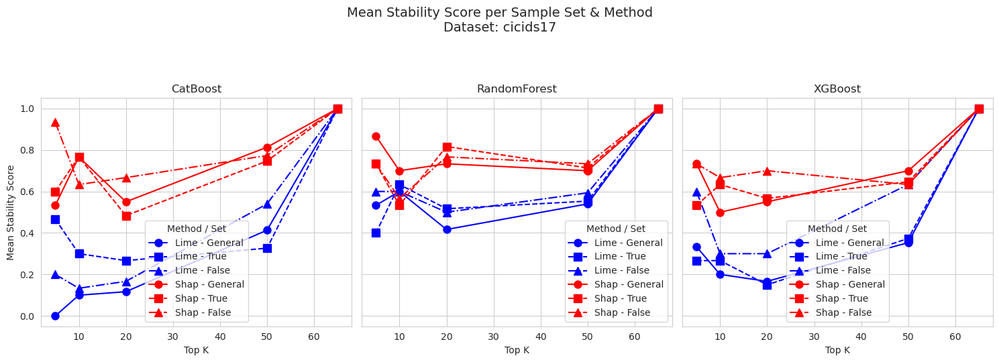

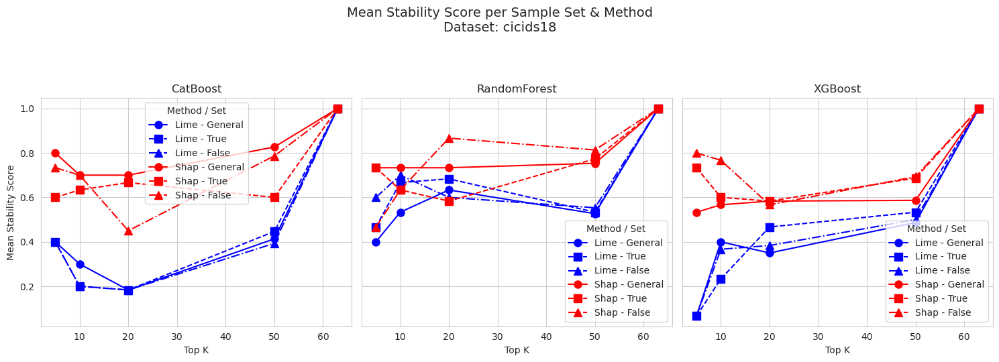

In [43]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

df = pd.read_parquet('metrics/stability/all_datasets_models_xai_stability.parquet')

df.columns = df.columns.str.strip()
agg_metric = 'stability_score'

cat_order = ['general_idx', 'true_idx', 'false_idx']

# mean per group
mean_df = (
    df.groupby(['dataset', 'model', 'xai', 'sample_set', 'top_k'])[agg_metric]
      .mean()
      .reset_index()
)

#print(mean_df)

sns.set_style("whitegrid")
line_styles = ['-', '--', '-.']
marker_shapes = ['o', 's', '^']
color_palette = {
    'lime': 'blue',
    'shap': 'red'
}

for dataset in mean_df['dataset'].unique():
    ds_df = mean_df[mean_df['dataset'] == dataset]
    models = ds_df['model'].unique()
    n_models = len(models)

    fig, axes = plt.subplots(
        nrows=1,
        ncols=n_models,
        figsize=(5 * n_models, 5),
        sharey=True
    )
    if n_models == 1:
        axes = [axes]

    for col, model in enumerate(models):
        ax = axes[col]
        for xi, xai_method in enumerate(['lime', 'shap']):
            for si, sample_set in enumerate(cat_order):
                subdf = ds_df[
                    (ds_df['model'] == model) &
                    (ds_df['xai'] == xai_method) &
                    (ds_df['sample_set'] == sample_set)
                ]
                if not subdf.empty:
                    label = f"{xai_method.capitalize()} - {sample_set.replace('_idx','').capitalize()}"
                    ax.plot(
                        subdf['top_k'],
                        subdf[agg_metric],
                        label=label,
                        color=color_palette[xai_method],
                        linestyle=line_styles[si % len(line_styles)],
                        marker=marker_shapes[si % len(marker_shapes)],
                        markersize=8
                    )
        ax.set_title(f"{model}")
        ax.set_xlabel('Top K')
        if col == 0:
            ax.set_ylabel(f"Mean {agg_metric.replace('_', ' ').title()}")
        else:
            ax.set_ylabel('')
        ax.legend(title='Method / Set')

    plt.suptitle(f"Mean {agg_metric.replace('_', ' ').title()} per Sample Set & Method\nDataset: {dataset}", fontsize=14, y=1.07)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


#### Mean Values of Samplesets - Dataset | Model | Single Explainer

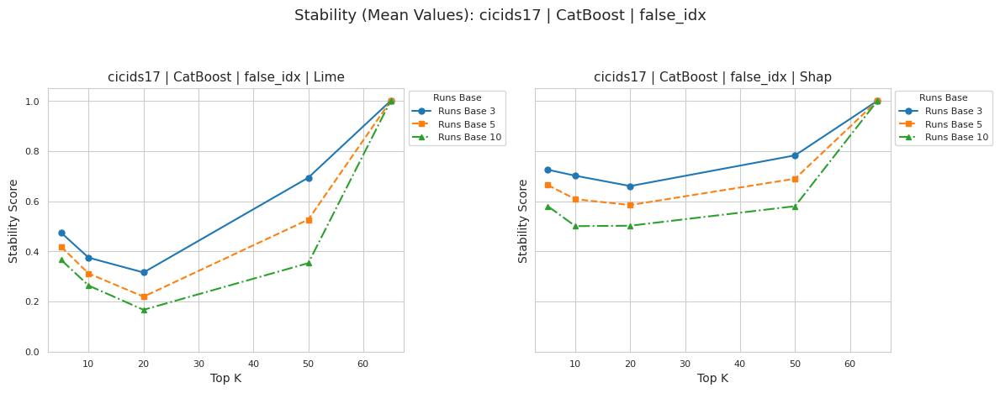

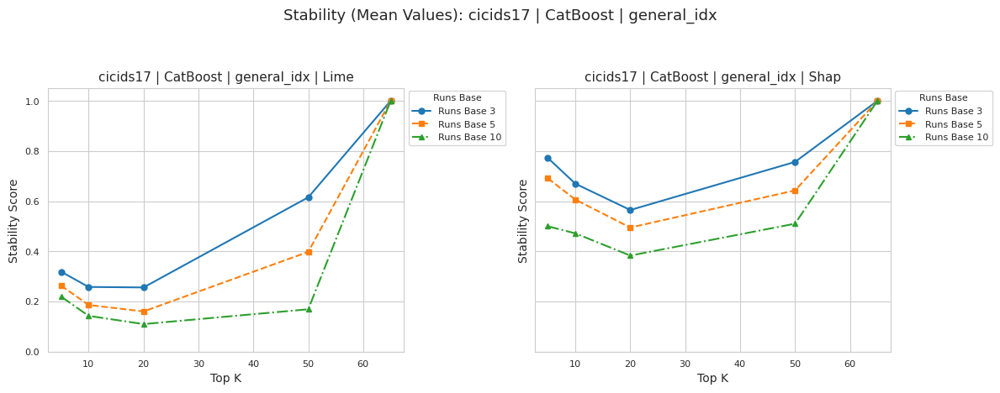

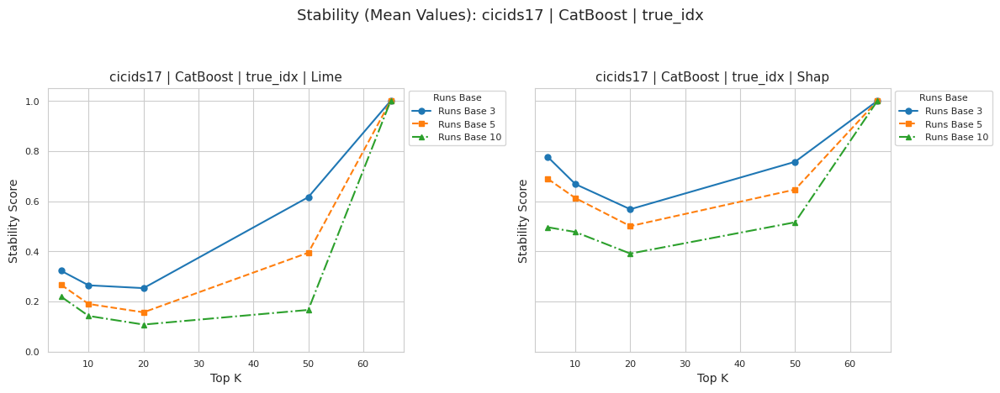

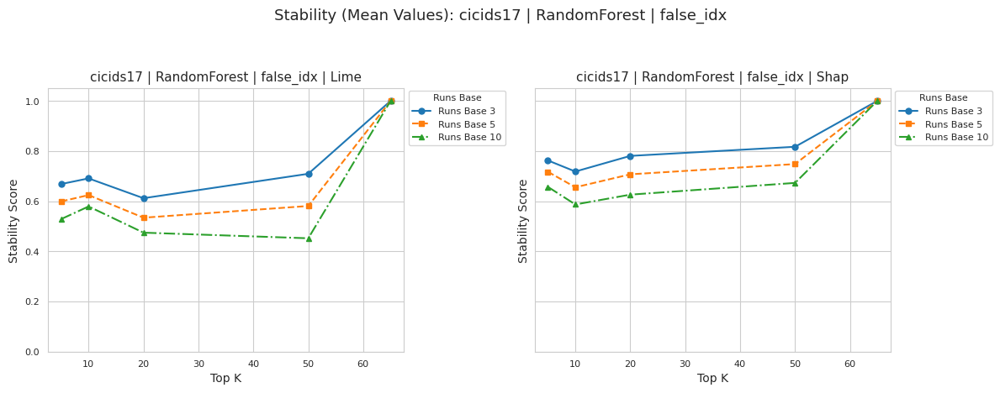

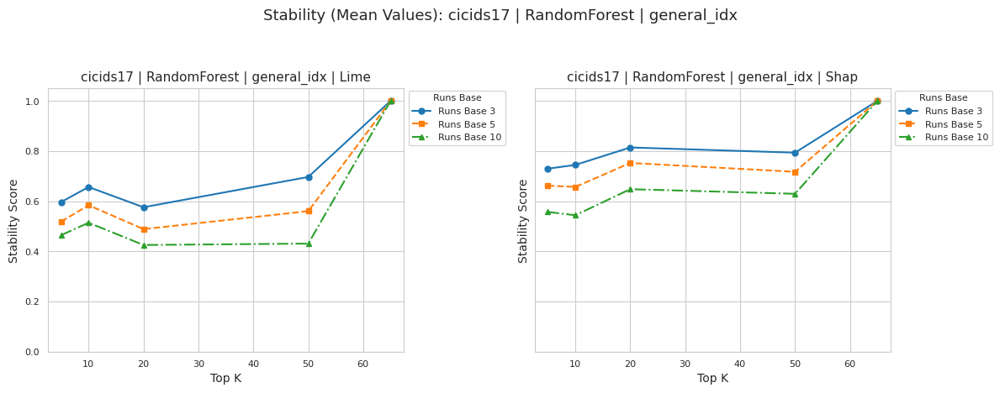

...

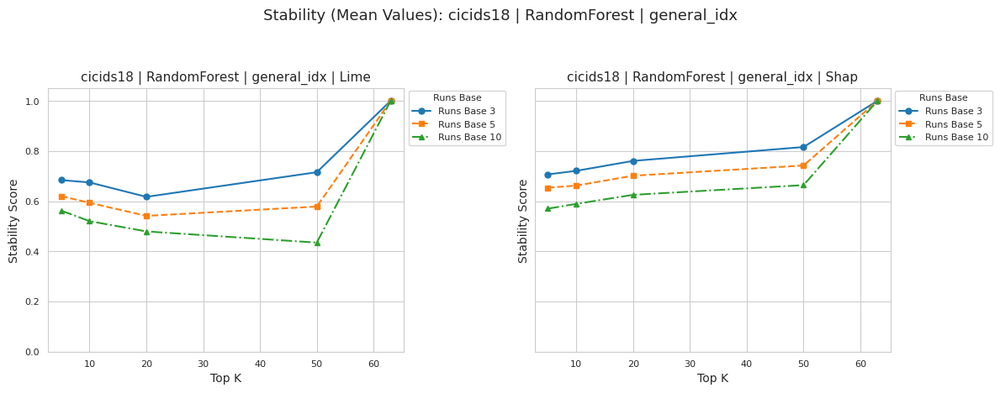

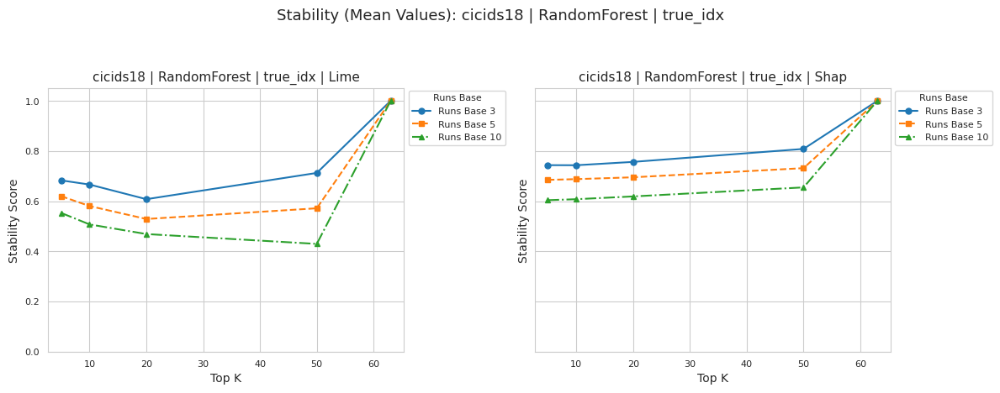

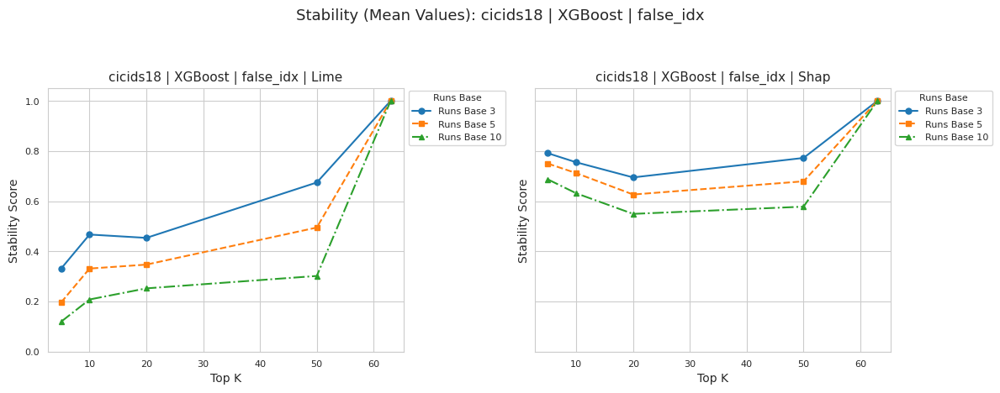

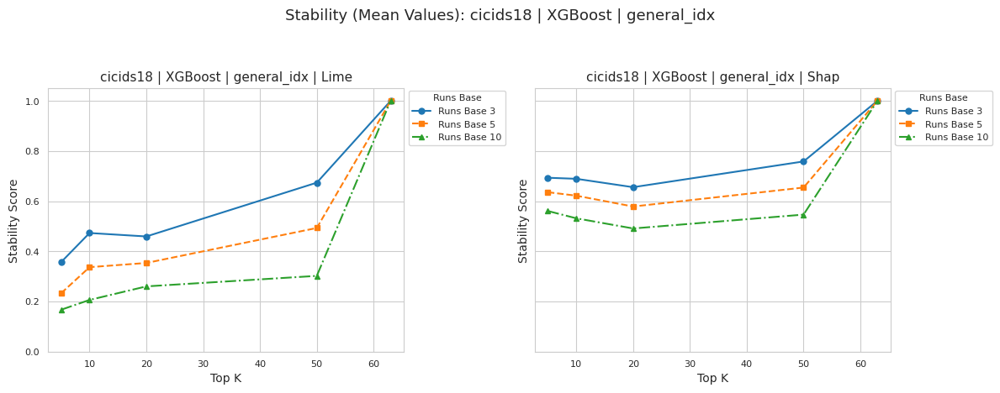

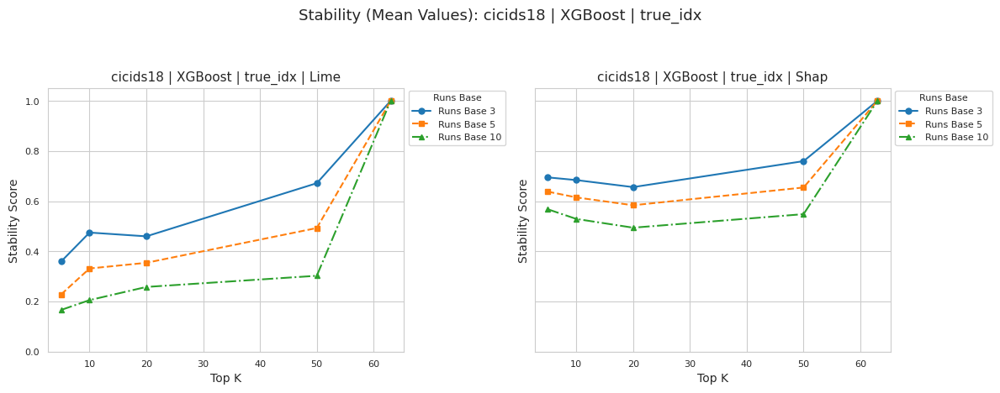

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

sns.set_style("whitegrid")

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")

global_means = (df.groupby(['dataset', 
                     'model', 
                     'xai', 
                     'sample_set', 
                     'runs_base', 
                     'top_k'], as_index=False)['stability_score'].mean())

global_means.columns = global_means.columns.str.strip()
global_means['xai'] = global_means['xai'].str.capitalize()

datasets = global_means['dataset'].unique()
models = global_means['model'].unique()
sample_sets = global_means['sample_set'].unique()
xai_methods = global_means['xai'].unique()
line_styles = ['-', '--', '-.', ':', (0, (3, 5, 1, 5)), (0, (1, 1))]
marker_shapes = ['o', 's', '^', 'D', 'v', '*', 'x', 'P', 'h', '+']

for dataset in datasets:
    for model in models:
        for sample_set in sample_sets:
            temp_df = global_means[
                (global_means['dataset'] == dataset) &
                (global_means['model'] == model) &
                (global_means['sample_set'] == sample_set)
            ]
            if temp_df.empty:
                continue

            n_methods = len(xai_methods)
            ncols = 2  # Lime and Shap
            nrows = int(np.ceil(n_methods / ncols))
            fig, axes = plt.subplots(
                nrows=nrows, ncols=ncols, figsize=(6 * ncols, 4.5 * nrows),
                sharey=True
            )
            axes = axes.flatten() if n_methods > 1 else [axes]

            for i, xai in enumerate(xai_methods):
                panel_df = temp_df[temp_df['xai'] == xai]
                ax = axes[i]

                if panel_df.empty:
                    ax.set_visible(False)
                    continue

                x_vals = panel_df['top_k'].values
                y_vals = panel_df['stability_score'].values
                if x_vals.size == 0 or y_vals.size == 0:
                    ax.set_visible(False)
                    continue

                xmin, xmax = np.min(x_vals), np.max(x_vals)
                x_margin = (xmax - xmin) * 0.04 if xmax > xmin else 1
                y_data_max = np.max(y_vals)
                y_data_min = np.min(y_vals)
                y_range = y_data_max - y_data_min
                y_margin = y_range * 0.05 if y_range > 0 else 0.01

                for j, runs_base in enumerate(sorted(panel_df['runs_base'].unique())):
                    subdf = panel_df[panel_df['runs_base'] == runs_base]
                    ax.plot(
                        subdf['top_k'],
                        subdf['stability_score'],
                        label=f"Runs Base {runs_base}",
                        linestyle=line_styles[j % len(line_styles)],
                        marker=marker_shapes[j % len(marker_shapes)],
                        markersize=5,
                    )
                # Set x and y limits with margin
                ax.set_xlim(xmin - x_margin, xmax + x_margin)
                if y_data_max >= 1.0:
                    ax.set_ylim(0, 1.05)
                else:
                    ax.set_ylim(0, min(1.0, y_data_max + y_margin))
                ax.set_title(
                    f"{dataset} | {model} | {sample_set} | {xai}", fontsize=11
                )
                ax.set_xlabel("Top K", fontsize=10)
                ax.set_ylabel("Stability Score", fontsize=10)
                ax.legend(
                    title="Runs Base",
                    fontsize=8,
                    title_fontsize=8,
                    loc='upper left',
                    bbox_to_anchor=(1, 1.01),
                )
                ax.tick_params(labelsize=8)

            for k in range(i + 1, len(axes)):
                axes[k].set_visible(False)

            plt.suptitle(
                f"Stability (Mean Values): {dataset} | {model} | {sample_set}",
                fontsize=13, y=1.03
            )
            plt.tight_layout(rect=[0, 0, 1, 0.97])
            plt.show()


In [10]:
filtered = global_means[
    (global_means['runs_base'] == 3) &
    (global_means['sample_set'] == 'general_idx') &
    (global_means['xai'] == 'lime')
]

print(len(filtered))
print(filtered)

0
Empty DataFrame
Columns: [dataset, model, xai, sample_set, runs_base, top_k, stability_score]
Index: []


#### Mean Values of Single Samples - Multiple Random IDX

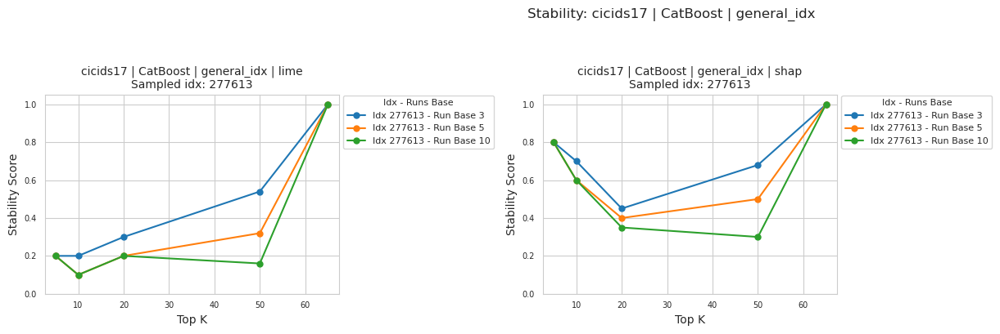

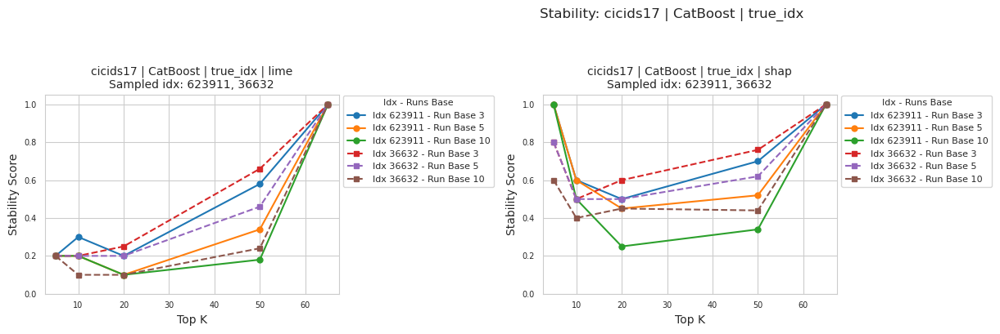

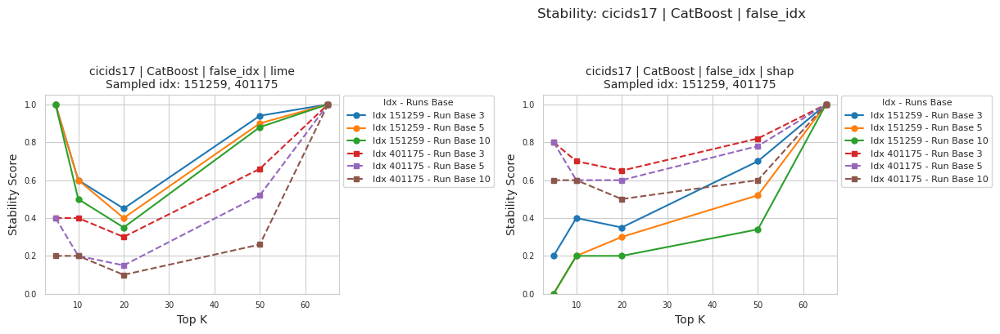

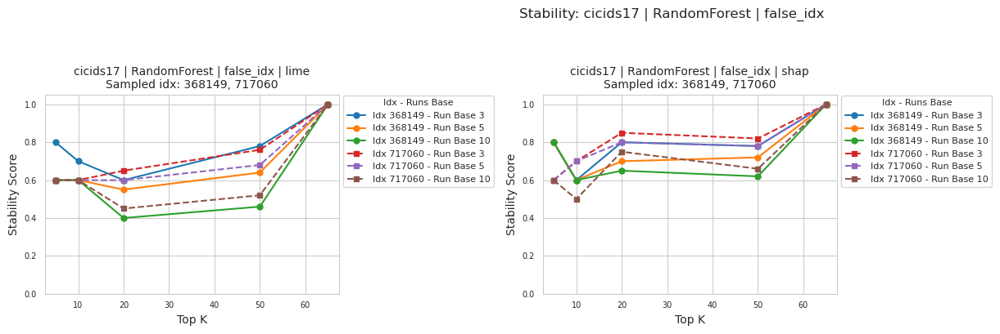

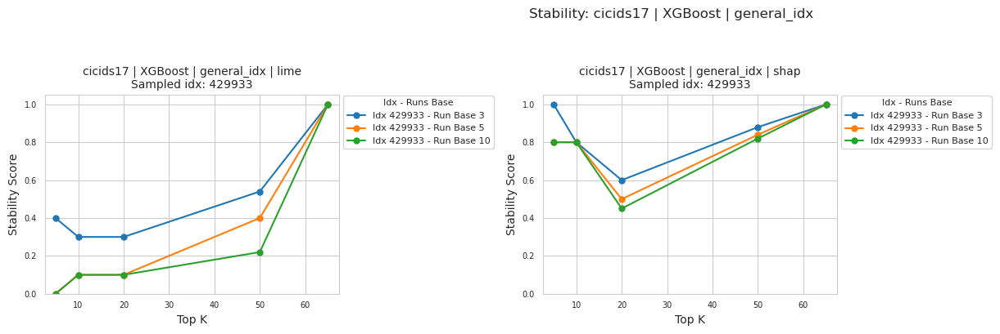

...

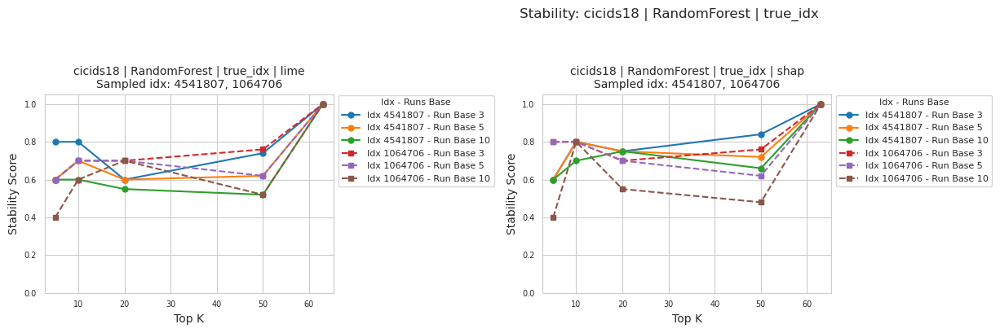

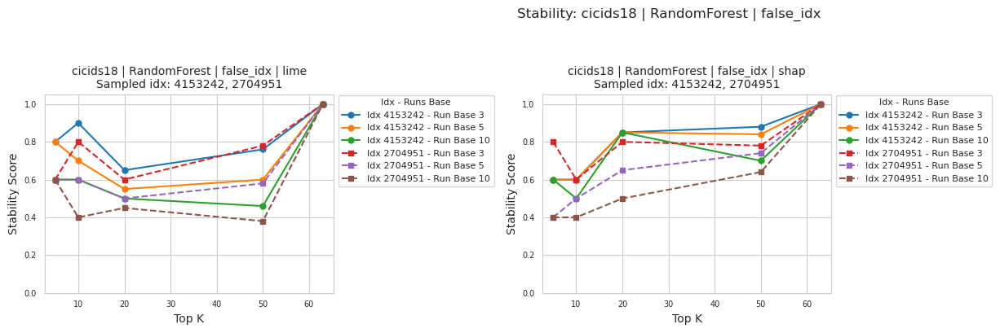

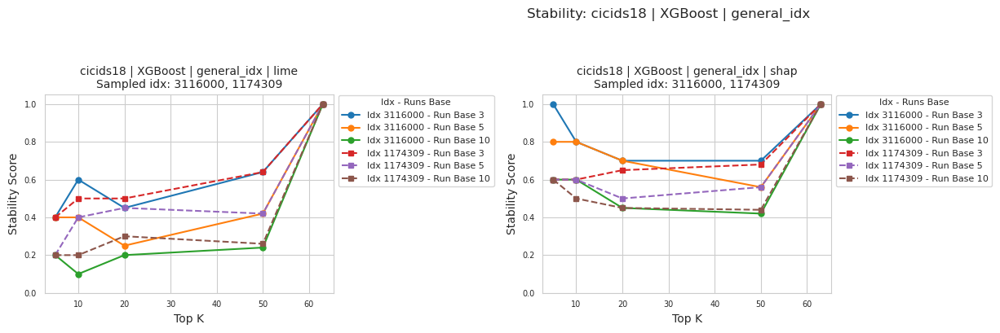

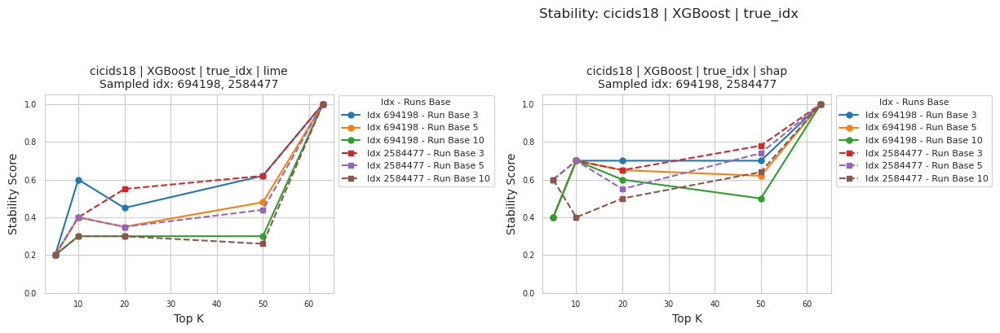

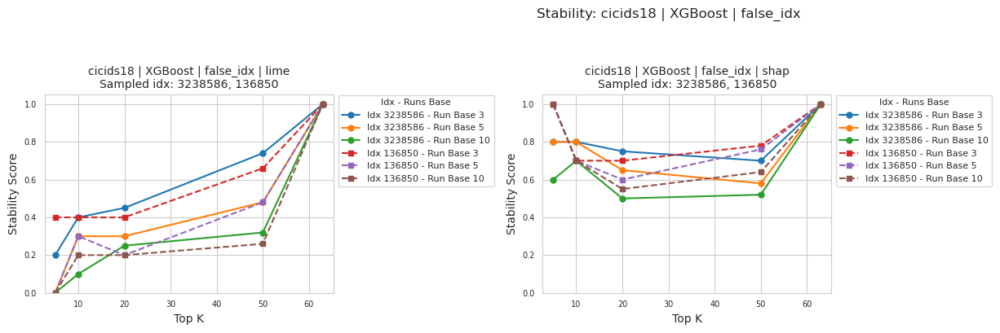

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

pd.set_option('display.max_columns', 20)
pd.set_option('display.width', 200)

sns.set_style("whitegrid")
np.random.seed(42)

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")
df.columns = df.columns.str.strip()

datasets = df['dataset'].unique()
models = df['model'].unique()
sample_sets = df['sample_set'].unique()
xai_methods = df['xai'].unique()
line_styles = ['-', '--', '-.', ':', (0, (3, 5, 1, 5)), (0, (1, 1))]
marker_shapes = ['o', 's', '^', 'D', 'v', '*', 'x', 'P', 'h', '+']
sample_size = 2  # Show 2 idx per plot

for dataset in datasets:
    for model in models:
        for sample_set in sample_sets:
            temp_df = df[
                (df['dataset'] == dataset) &
                (df['model'] == model) &
                (df['sample_set'] == sample_set)
            ]
            idx_counts = temp_df.groupby('idx')['xai'].nunique()
            valid_idx = idx_counts[idx_counts == len(xai_methods)].index.tolist()
            if not valid_idx:
                continue  # Skip combos with no shared idx
            selected_idx = np.random.choice(
                valid_idx, size=min(sample_size, len(valid_idx)), replace=False
            )

            n_methods = len(xai_methods)
            ncols = 3
            nrows = int(np.ceil(n_methods / ncols))
            fig, axes = plt.subplots(
                nrows=nrows, ncols=ncols, figsize=(5.5 * ncols, 4 * nrows)
            )
            axes = axes.flatten() if n_methods > 1 else [axes]

            for i, xai in enumerate(xai_methods):
                panel_df = temp_df[
                    (temp_df['xai'] == xai) & (temp_df['idx'].isin(selected_idx))
                ]
                ax = axes[i]

                x_vals = panel_df['top_k'].values
                y_vals = panel_df['stability_score'].values
                if x_vals.size == 0 or y_vals.size == 0:
                    ax.set_visible(False)
                    continue

                xmin, xmax = np.min(x_vals), np.max(x_vals)
                x_margin = (xmax - xmin) * 0.04 if xmax > xmin else 1
                y_data_max = np.max(y_vals)
                y_data_min = np.min(y_vals)
                y_range = y_data_max - y_data_min
                y_margin = y_range * 0.05 if y_range > 0 else 0.01

                for j, idx in enumerate(selected_idx):
                    run_df = panel_df[panel_df['idx'] == idx]
                    if run_df.empty:
                        continue
                    for runs_base, subdf in run_df.groupby('runs_base'):
                        ax.plot(
                            subdf['top_k'],
                            subdf['stability_score'],
                            label=f"Idx {idx} - Run Base {runs_base}",
                            linestyle=line_styles[j % len(line_styles)],
                            marker=marker_shapes[j % len(marker_shapes)],
                            markersize=5,
                        )

                # Set x and y limits with margin
                ax.set_xlim(xmin - x_margin, xmax + x_margin)
                if y_data_max >= 1.0:
                    ax.set_ylim(0, 1.05)
                else:
                    ax.set_ylim(0, min(1.0, y_data_max + y_margin))
                ax.set_title(
                    f"{dataset} | {model} | {sample_set} | {xai}\nSampled idx: {', '.join(str(idx) for idx in selected_idx)}",
                    fontsize=10
                )
                ax.set_xlabel("Top K", fontsize=10)
                ax.set_ylabel("Stability Score", fontsize=10)
                ax.legend(title="Idx - Runs Base", fontsize=8, title_fontsize=8, loc='upper left', bbox_to_anchor=(1, 1.02))
                ax.tick_params(labelsize=7)

            for k in range(i + 1, len(axes)):
                axes[k].set_visible(False)

            plt.suptitle(f"Stability: {dataset} | {model} | {sample_set}", fontsize=12, y=1.01)
            plt.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()


#### Mean Values of Single Samples - Single Random IDX

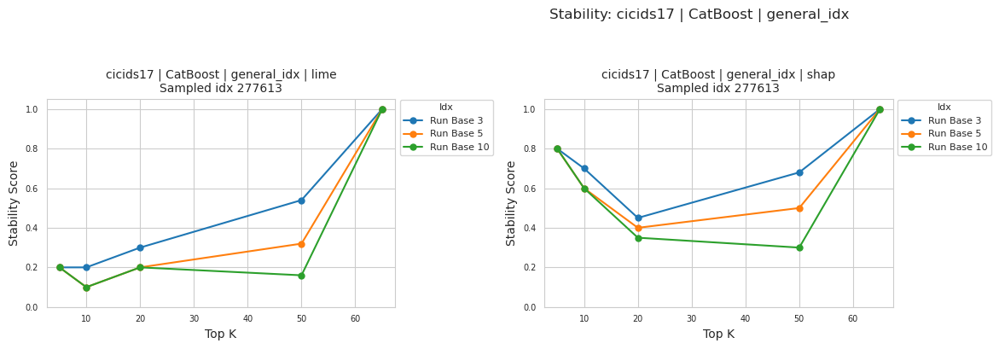

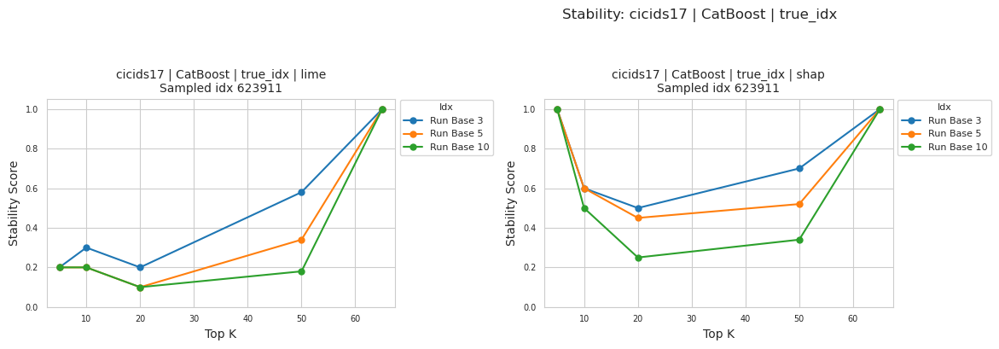

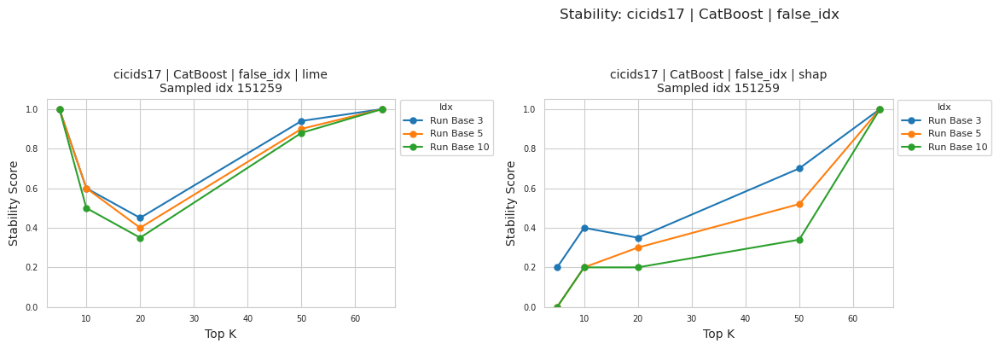

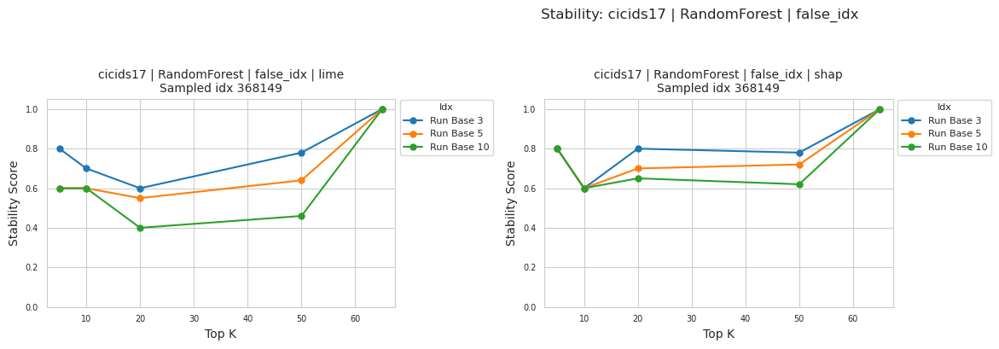

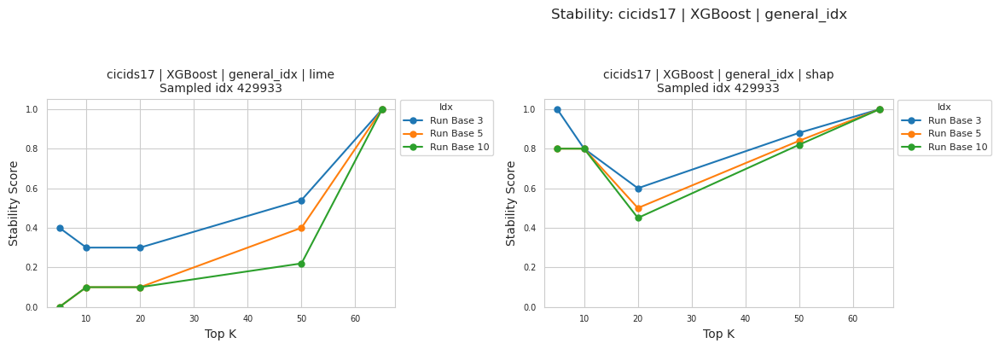

...

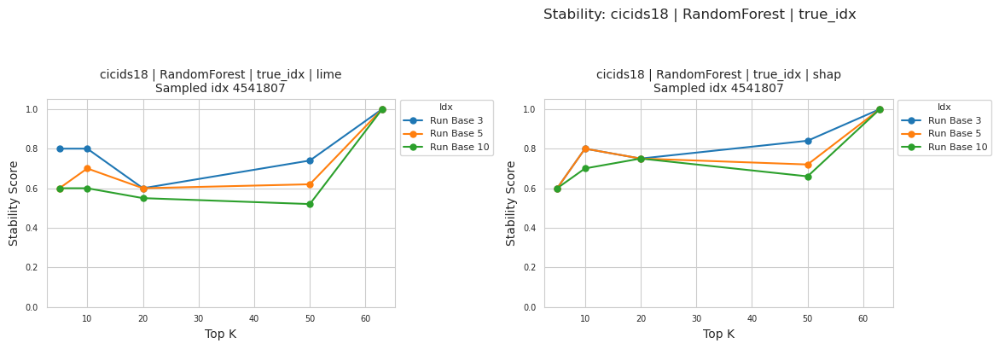

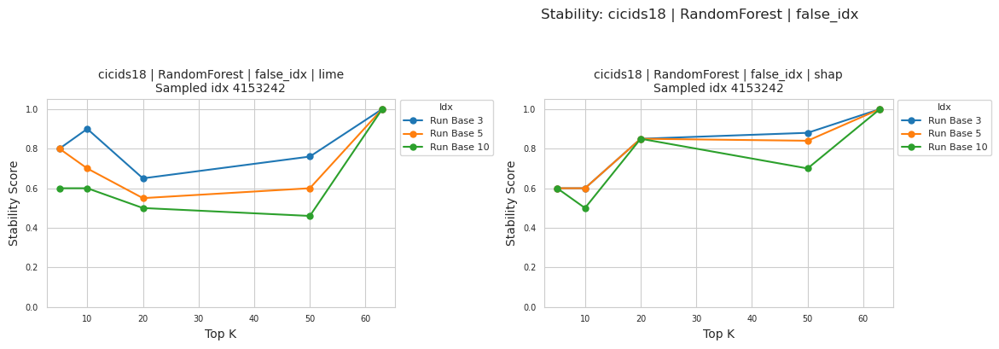

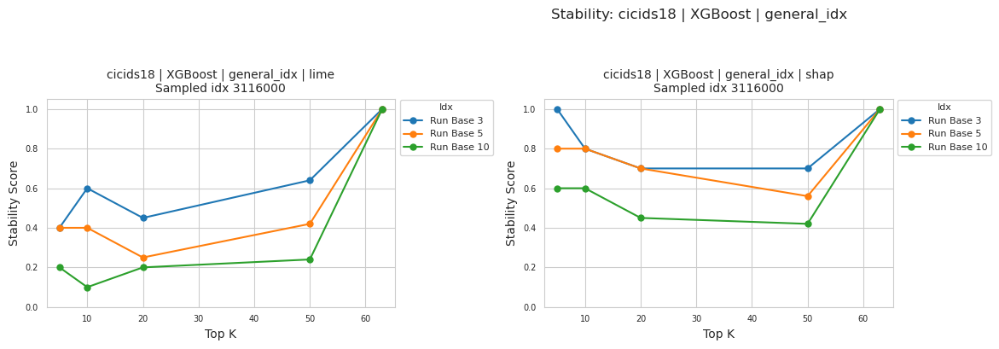

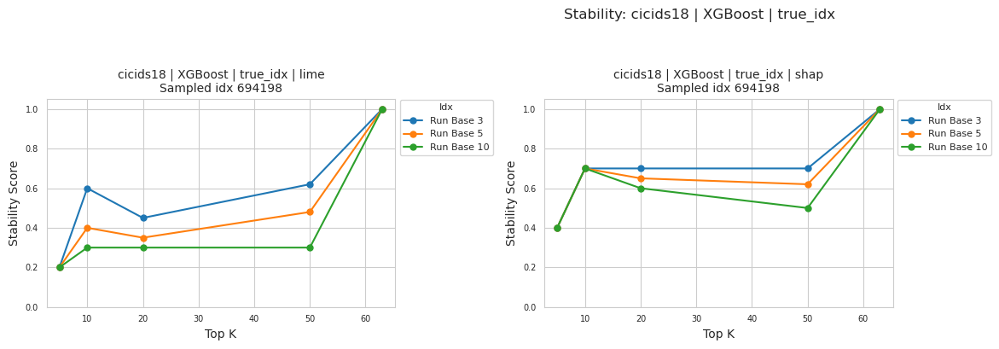

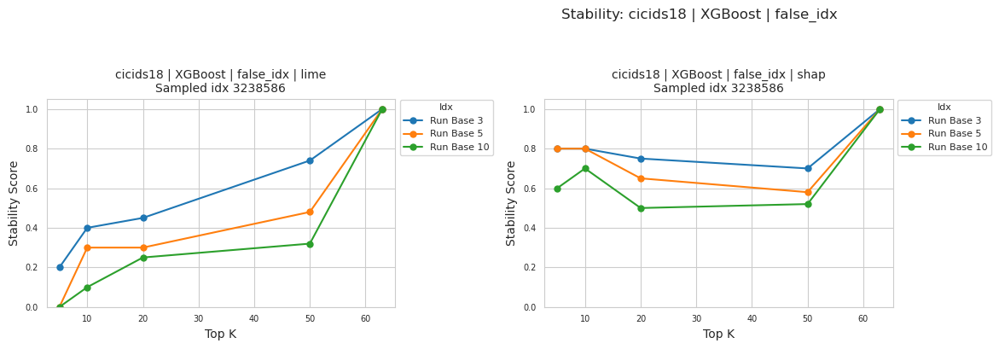

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os

pd.set_option('display.max_columns', 20)
pd.set_option('display.width', 200)

sns.set_style("whitegrid")
np.random.seed(42)

df = pd.read_parquet("metrics/stability/all_datasets_models_xai_stability.parquet")

df.columns = df.columns.str.strip()

datasets = df['dataset'].unique()
models = df['model'].unique()
sample_sets = df['sample_set'].unique()
xai_methods = df['xai'].unique()
line_styles = ['-', '--', '-.', ':', (0, (3, 5, 1, 5)), (0, (1, 1))]
marker_shapes = ['o', 's', '^', 'D', 'v', '*', 'x', 'P', 'h', '+']
sample_size=1

for dataset in datasets:
    for model in models:
        for sample_set in sample_sets:
            temp_df = df[(df['dataset'] == dataset) &
                         (df['model'] == model) &
                         (df['sample_set'] == sample_set)]
            idx_counts = temp_df.groupby('idx')['xai'].nunique()
            valid_idx = idx_counts[idx_counts == len(xai_methods)].index.tolist()
            if not valid_idx:
                continue  # Skip combos with no shared idx
            selected_idx = np.random.choice(valid_idx, size=min(sample_size, len(valid_idx)), replace=False)

            n_methods = len(xai_methods)
            ncols = 3
            nrows = int(np.ceil(n_methods / ncols))
            
            fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5.5 * ncols, 4 * nrows))
            axes = axes.flatten() if n_methods > 1 else [axes]
            
            for i, xai in enumerate(xai_methods):
                panel_df = temp_df[(temp_df['xai'] == xai) & (temp_df['idx'].isin(selected_idx))]
                #print(panel_df)
                ax = axes[i]

                x_vals = panel_df['top_k'].values
                y_vals = panel_df['stability_score'].values
                if x_vals.size == 0 or y_vals.size == 0:
                    ax.set_visible(False)
                    continue

                xmin, xmax = np.min(x_vals), np.max(x_vals)
                x_margin = (xmax - xmin) * 0.04 if xmax > xmin else 1
                y_data_max = np.max(y_vals)
                y_data_min = np.min(y_vals)
                y_range = y_data_max - y_data_min
                y_margin = y_range * 0.05 if y_range > 0 else 0.01

                for j, idx in enumerate(selected_idx):
                    run_df = panel_df[panel_df['idx'] == idx]
                    if run_df.empty:
                        continue
                    for runs_base, subdf in run_df.groupby('runs_base'):
                        ax.plot(
                            subdf['top_k'],
                            subdf['stability_score'],
                            label=f"Run Base {runs_base}",
                            linestyle=line_styles[j % len(line_styles)],
                            marker=marker_shapes[j % len(marker_shapes)],
                            markersize=5,
                        )

                # Set x and y limits with margin
                ax.set_xlim(xmin - x_margin, xmax + x_margin)
                if y_data_max >= 1.0:
                    ax.set_ylim(0, 1.05)
                else:
                    ax.set_ylim(0, min(1.0, y_data_max + y_margin))
                ax.set_title(f"{dataset} | {model} | {sample_set} | {xai}\nSampled idx {idx}", fontsize=10)
                ax.set_xlabel("Top K", fontsize=10)
                ax.set_ylabel("Stability Score", fontsize=10)
                ax.legend(title="Idx", fontsize=8, title_fontsize=8, loc='upper left', bbox_to_anchor=(1, 1.02))
                ax.tick_params(labelsize=7)

            for k in range(i+1, len(axes)):
                axes[k].set_visible(False)

            plt.suptitle(f"Stability: {dataset} | {model} | {sample_set}", fontsize=12, y=1.01)
            plt.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()


## Stability (local)

For the calculation of individual stability scores, the explanation files are required, since they contain the whole extracted data. 

In this section examine individual samples OR
generate and examine individual samples over a high number of runs (1000)

for ~ 1000 combinations i need at least 15 observations 

### Stability Table

In [44]:
import pandas as pd
from collections import defaultdict
from ast import literal_eval
import json
import os

pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000)

random_state = 42
directory = 'explanation_data/final_1_processed/'
all_files = os.listdir(directory)

explanations = sorted([f for f in all_files if os.path.isfile(os.path.join(directory, f))])

samplesets = ["general_idx", "true_idx", "false_idx"]

def parse_dataset(f):
    f = f.lower()
    if "cicids17" in f:
        return "cicids17"
    elif "cicids18" in f:
        return "cicids18"
    return None

def parse_model(f):
    f = f.lower()
    if "randomforest" in f or "rf" in f:
        return "RandomForest"
    elif "catboost" in f:
        return "CatBoost"
    elif "xgboost" in f or "xgb" in f:
        return "XGBoost"
    return None

def parse_explainer(f):
    f = f.lower()
    if "_lime_" in f:
        return "lime"
    elif "_shap_" in f:
        return "shap"
    return None

def compute_stability(feature_sets, k):
    if not feature_sets:
        return 0.0
    intersection = set.intersection(*feature_sets)
    return round(len(intersection) / k, 4)

results = []

for file in explanations:

    dataset = parse_dataset(file)
    explainer = parse_explainer(file)
    model = parse_model(file)
    
    print(f"Reading file {file}")
    df = pd.read_csv(os.path.join(directory, file), index_col=0)
    #print(df.columns)
    
    first_features = literal_eval(df["feature_value_pairs"].iloc[0])
    k_values = [5, 10, 20, 50, len(first_features)]
    
    for sampleset in samplesets:
        df_set = df[df["sample_set"] == sampleset] 
        
        # set number of samples
        #samples = df_set["idx"].sample(n=10, random_state=random_state)
        samples = df_set["idx"].unique()
        
        for n in samples:
            df_idx = df_set[df_set["idx"] == n]
            
            for k in k_values:
                top_k_feature_sets = []
                stability_scores = []
                
                for run_nr in sorted(df_idx["run_nr"].unique()):
                    features = literal_eval(df_idx[df_idx["run_nr"] == run_nr]['feature_value_pairs'].iloc[0])
                    sorted_features = sorted(features, key=lambda x: abs(x[1]), reverse=True)
                    
                    top_k_list = [f for f, _ in sorted_features[:k]]
                    top_k_feature_sets.append(set(top_k_list))
                    
                    score = compute_stability(top_k_feature_sets, k)
                    stability_scores.append(score)

                #for s in top_k_feature_sets:
                #    print(s)
                #print("")
                #print(stability_scores)
                
                row = {
                    "dataset" : dataset,
                    "model": model,
                    "explainer": explainer,
                    "sampleset": sampleset,
                    "idx": n,
                    "k": k
                }
    
                for i, score in enumerate(stability_scores, start=1):
                    row[f"runs_{i}"] = score
                
                results.append(row)
    
stability_df = pd.DataFrame(results)
#stability_df.drop(columns=["runs_1","runs_2","runs_4","runs_6","runs_7","runs_8","runs_9"], inplace=True)
stability_df.to_parquet("metrics/stability/stability.parquet", index=False)
print("\n Stability DF saved to: metrics/stability/stability_reduced.parquet\n")
stability_df.head(30)

Reading file cicids17_CatBoost_lime_explanations.csv
Reading file cicids17_CatBoost_shap_kernel_smoothed_explanations.csv
Reading file cicids17_RandomForest_lime_explanations.csv
Reading file cicids17_RandomForest_shap_kernel_smoothed_explanations.csv
Reading file cicids17_XGBoost_lime_explanations.csv
Reading file cicids17_XGBoost_shap_kernel_smoothed_explanations.csv
Reading file cicids18_CatBoost_lime_explanations.csv
Reading file cicids18_CatBoost_shap_kernel_smoothed_explanations.csv
Reading file cicids18_RandomForest_lime_explanations.csv
Reading file cicids18_RandomForest_shap_kernel_smoothed_explanations.csv
Reading file cicids18_XGBoost_lime_explanations.csv
Reading file cicids18_XGBoost_shap_kernel_smoothed_explanations.csv

 Stability DF saved to: metrics/stability/stability_reduced.parquet



,dataset,model,explainer,sampleset,idx,k,runs_1,runs_2,runs_3,runs_4,runs_5,runs_6,runs_7,runs_8,runs_9,runs_10
0,cicids17,CatBoost,lime,general_idx,648804,5,1.0,0.40,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,cicids17,CatBoost,lime,general_idx,648804,10,1.0,0.50,0.10,0.10,0.10,0.10,0.10,0.10,0.10,0.10
2,cicids17,CatBoost,lime,general_idx,648804,20,1.0,0.45,0.15,0.10,0.10,0.10,0.10,0.10,0.10,0.10
3,cicids17,CatBoost,lime,general_idx,648804,50,1.0,0.74,0.56,0.52,0.48,0.42,0.36,0.28,0.22,0.20
4,cicids17,CatBoost,lime,general_idx,648804,65,1.0,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
5,cicids17,CatBoost,lime,general_idx,223051,5,1.0,0.40,0.20,0.20,0.20,0.20,0.20,0.20,0.20,0.20
6,cicids17,CatBoost,lime,general_idx,223051,10,1.0,0.60,0.30,0.20,0.20,0.20,0.20,0.20,0.20,0.20
7,cicids17,CatBoost,lime,general_idx,223051,20,1.0,0.45,0.25,0.15,0.15,0.15,0.15,0.15,0.15,0.15
8,cicids17,CatBoost,lime,general_idx,223051,50,1.0,0.78,0.62,0.56,0.50,0.46,0.30,0.30,0.22,0.22
9,cicids17,CatBoost,lime,general_idx,223051,65,1.0,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


In [45]:
print(len(stability_df[
    (stability_df['dataset'] == 'cicids17') &
    (stability_df['model'] == 'CatBoost') &
    (stability_df['explainer'] == 'lime') &
    (stability_df['sampleset'] == 'general_idx') &
    (stability_df['k'] == 5)
]["idx"].unique()))

print(stability_df[
    (stability_df['dataset'] == 'cicids17') &
    (stability_df['model'] == 'CatBoost') &
    (stability_df['explainer'] == 'lime') &
    (stability_df['sampleset'] == 'general_idx') &
    (stability_df['k'] == 5)
][:20])

print(stability_df[
    (stability_df['dataset'] == 'cicids17') &
    (stability_df['model'] == 'CatBoost') &
    (stability_df['explainer'] == 'shap') &
    (stability_df['sampleset'] == 'general_idx') &
    (stability_df['k'] == 5)
][:20])

1000
     dataset     model explainer    sampleset     idx  k  runs_1  runs_2  runs_3  runs_4  runs_5  runs_6  runs_7  runs_8  runs_9  runs_10
0   cicids17  CatBoost      lime  general_idx  648804  5     1.0     0.4     0.0     0.0     0.0     0.0     0.0     0.0     0.0      0.0
5   cicids17  CatBoost      lime  general_idx  223051  5     1.0     0.4     0.2     0.2     0.2     0.2     0.2     0.2     0.2      0.2
10  cicids17  CatBoost      lime  general_idx  113289  5     1.0     0.6     0.4     0.4     0.4     0.2     0.2     0.2     0.2      0.2
15  cicids17  CatBoost      lime  general_idx  324725  5     1.0     0.6     0.4     0.4     0.4     0.4     0.4     0.4     0.4      0.4
20  cicids17  CatBoost      lime  general_idx  494217  5     1.0     0.6     0.2     0.2     0.2     0.2     0.2     0.2     0.2      0.2
25  cicids17  CatBoost      lime  general_idx  274963  5     1.0     0.6     0.4     0.4     0.4     0.4     0.4     0.4     0.4      0.4
30  cicids17  CatBoost      l

### Statistical Analysis

#### Normality Test (Shapiro-Wilk)

In [75]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000)

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")

print(df.head())

print(df[
    (df['dataset'] == 'cicids17') &
    (df['model'] == 'CatBoost') &
    (df['explainer'] == 'lime') &
    (df['sampleset'] == 'false_idx') &
      (df['k'] == 5)
].head())

    dataset     model explainer    sampleset     idx   k  runs_3  runs_5  runs_10
0  cicids17  CatBoost      lime  general_idx  648804   5    0.00    0.00      0.0
1  cicids17  CatBoost      lime  general_idx  648804  10    0.10    0.10      0.1
2  cicids17  CatBoost      lime  general_idx  648804  20    0.15    0.10      0.1
3  cicids17  CatBoost      lime  general_idx  648804  50    0.56    0.48      0.2
4  cicids17  CatBoost      lime  general_idx  648804  65    1.00    1.00      1.0
        dataset     model explainer  sampleset     idx  k  runs_3  runs_5  runs_10
10000  cicids17  CatBoost      lime  false_idx  520022  5     0.2     0.2      0.2
10005  cicids17  CatBoost      lime  false_idx  301028  5     0.8     0.8      0.6
10010  cicids17  CatBoost      lime  false_idx  723688  5     0.2     0.2      0.2
10015  cicids17  CatBoost      lime  false_idx  250954  5     0.4     0.4      0.4
10020  cicids17  CatBoost      lime  false_idx  655130  5     0.2     0.2      0.2


In [74]:
import numpy as np
import pandas as pd
from scipy.stats import shapiro

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")
run_columns = ["runs_3","runs_5","runs_10"]
group_cols = ["dataset", "model", "explainer", "sampleset", "k"]

results = []

for dataset in df["dataset"].unique():
    for model in df["model"].unique():
        for explainer in df["explainer"].unique():
            for sampleset in df["sampleset"].unique():
                for k in df["k"].unique():
                    
                    # remove invalid rows due to known issues (1.0 values for shapiro)
                    if (dataset == "cicids17" and k == 65) or (dataset == "cicids18" and k == 63):
                        continue
                    
                    subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["explainer"] == explainer) &
                        (df["sampleset"] == sampleset) &
                        (df["k"] == k)
                    ]

                    if subset.empty:
                        continue

                    result_row = {
                        "dataset": dataset,
                        "model": model,
                        "explainer": explainer,
                        "sampleset": sampleset,
                        "k": k,
                    }

                    for col in run_columns:
                        values = subset[col].dropna().values

                        stat, p = shapiro(values)
                        if p > 0.05:
                            interpretation = "normal"
                        else:
                            interpretation = "not normal"

                        result_row[f"{col}_interpretation"] = interpretation

                    results.append(result_row)

results_df = pd.DataFrame(results)

for col in run_columns:
    new_col = f"{col}_interpretation"
    results_df.rename(columns={new_col: col}, inplace=True)

stats_list = []

for explainer in df['explainer'].unique():
    df_exp = df[df['explainer'].str.lower() == explainer.lower()]
    for col in run_columns:
        stats_list.append({
            "explainer": explainer,
            "column": col,
            "mean": round(df_exp[col].mean(), 4),
            "median": round(df_exp[col].median(), 4),
            "std_dev": round(df_exp[col].std(), 4),
            "min": round(df_exp[col].min(), 4),
            "max": round(df_exp[col].max(), 4)
        })
stats_df = pd.DataFrame(stats_list)
print(stats_df)
print("")

display_cols = group_cols + run_columns
print(results_df[display_cols][:12])

summary_counts = {}

#for col in run_columns:
#    counts = results_df[col].value_counts()
#    normal_count = counts.get("normal", 0)
#    not_normal_count = counts.get("not normal", 0)
#    summary_counts[col] = {"normal": normal_count, "not normal": not_normal_count}
#    print(f"\nSummary for {col}:")
#    print(f"  normal: {normal_count}")
#    print(f"  not normal: {not_normal_count}")


#total_normal = sum(c["normal"] for c in summary_counts.values())
#total_not_normal = sum(c["not normal"] for c in summary_counts.values())
print("\nOverall summary across all tested columns:")
print(f"  Total normal: {total_normal}")
print(f"  Total not normal: {total_not_normal}")


  explainer   column    mean  median  std_dev  min  max
0      lime   runs_3  0.6042    0.60   0.2638  0.0  1.0
1      lime   runs_5  0.5203    0.46   0.2895  0.0  1.0
2      lime  runs_10  0.4463    0.40   0.3189  0.0  1.0
3      shap   runs_3  0.7862    0.80   0.1569  0.0  1.0
4      shap   runs_5  0.7312    0.70   0.1828  0.0  1.0
5      shap  runs_10  0.6548    0.60   0.2218  0.0  1.0

     dataset     model explainer    sampleset   k      runs_3      runs_5     runs_10
0   cicids17  CatBoost      lime  general_idx   5  not normal  not normal  not normal
1   cicids17  CatBoost      lime  general_idx  10  not normal  not normal  not normal
2   cicids17  CatBoost      lime  general_idx  20  not normal  not normal  not normal
3   cicids17  CatBoost      lime  general_idx  50  not normal  not normal  not normal
4   cicids17  CatBoost      lime     true_idx   5  not normal  not normal  not normal
5   cicids17  CatBoost      lime     true_idx  10  not normal  not normal  not normal
6   c

In [77]:
from scipy.stats import shapiro

# List the columns you want to test for normality
run_columns = ["runs_3","runs_5","runs_10"]

# Group the dataframe
group_cols = ["dataset", "model", "explainer", "sampleset", "k"]

results = []

for name, group in df.groupby(group_cols):
    result_row = dict(zip(group_cols, name))
    # (If there is more than one row with the same group, this will test all of them together,
    # adjust if you want to test each 'idx' separately! You can add 'idx' to group_cols if needed)
    for col in run_columns[:1]:
        values = group[col].dropna().values
        #print(values)
        if len(values) >= 3:  # Shapiro requires at least 3 data points
            stat, p = shapiro(values)
            result_row[f"{col}_W"] = stat
            result_row[f"{col}_p"] = p
        else:
            result_row[f"{col}_W"] = None
            result_row[f"{col}_p"] = None
    results.append(result_row)

results_df = pd.DataFrame(results)

#print(results_df)

# Print summary
for col in run_columns[:1]:
    print(f"--- Results for {col} ---")
    for idx, row in results_df.iterrows():
        W = row[f"{col}_W"]
        p = row[f"{col}_p"]
        if W is None:
            interp = "Not enough data"
        elif p > 0.05:
            interp = "Data likely normal"
        else:
            interp = "Data NOT normal"
        print(f"For {', '.join([str(row[g]) for g in group_cols])}: W={W}, p={p} --> {interp}")


/home/maui/miniconda3/envs/ai_env/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:586: UserWarning: scipy.stats.shapiro: Input data has range zero. The results may not be accurate.
  res = hypotest_fun_out(*samples, **kwds)


--- Results for runs_3 ---
For cicids17, CatBoost, lime, false_idx, 5: W=0.8803063376924083, p=5.2780096284460944e-23 --> Data NOT normal
For cicids17, CatBoost, lime, false_idx, 10: W=0.9078742403527027, p=2.4242417406402243e-20 --> Data NOT normal
For cicids17, CatBoost, lime, false_idx, 20: W=0.9636540429852511, p=2.6657631646609903e-12 --> Data NOT normal
For cicids17, CatBoost, lime, false_idx, 50: W=0.7879154311441209, p=1.9656155730320513e-29 --> Data NOT normal
For cicids17, CatBoost, lime, false_idx, 65: W=1.0, p=1.0 --> Data likely normal
For cicids17, CatBoost, lime, general_idx, 5: W=0.8218523266228958, p=6.934099444365637e-32 --> Data NOT normal
For cicids17, CatBoost, lime, general_idx, 10: W=0.9139106335877658, p=2.2565542448569028e-23 --> Data NOT normal
For cicids17, CatBoost, lime, general_idx, 20: W=0.9579546671464381, p=2.384903443920885e-16 --> Data NOT normal
For cicids17, CatBoost, lime, general_idx, 50: W=0.9801812185414428, p=1.991899644670998e-10 --> Data NOT 

#### T-Test

In [94]:
import pandas as pd
from scipy.stats import ttest_rel

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")
run_bases = ["runs_3", "runs_5", "runs_10"]

results = []

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for sample_set in df['sampleset'].unique():
            for k in df['k'].unique():
                if k == 63 or k == 65:
                    continue
                else:
                    lime_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sampleset"] == sample_set) &
                        (df["k"] == k) &
                        (df["explainer"].str.lower() == "lime")
                    ]
    
                    shap_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sampleset"] == sample_set) &
                        (df["k"] == k) &
                        (df["explainer"].str.lower() == "shap")
                    ]
    
                    if lime_subset.empty or shap_subset.empty:
                        continue
                        
                    # remove invalid rows
                    #if (dataset == "cicids17" and k == 65) or (dataset == "cicids18" and k == 63):
                    #    continue
    
                    lime_subset = lime_subset.sort_values("idx")
                    shap_subset = shap_subset.sort_values("idx")
    
                    for run_base in run_bases:
                        lime_vals = lime_subset[run_base].dropna().values
                        shap_vals = shap_subset[run_base].dropna().values
    
                        min_len = min(len(lime_vals), len(shap_vals))
    
                        if min_len > 1:
                            lime_vals = lime_vals[:min_len] #first group
                            shap_vals = shap_vals[:min_len] #second group
    
                            # Perform paired t-test
                            stat, p = ttest_rel(lime_vals, shap_vals)
    
                            interpretation = "No significant difference" if p > 0.05 else "Significant difference"
    
                            results.append({
                                "dataset": dataset,
                                "model": model,
                                "sampleset": sample_set,
                                "k": k,
                                "run_base": run_base,
                                "ttest_statistic": round(stat, 5),
                                "p_value": round(p, 5),
                                "interpretation": interpretation
                            })
                        else:
                            pass
                    lime_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sampleset"] == sample_set) &
                        (df["k"] == k) &
                        (df["explainer"].str.lower() == "lime")
                    ]
    
                    shap_subset = df[
                        (df["dataset"] == dataset) &
                        (df["model"] == model) &
                        (df["sampleset"] == sample_set) &
                        (df["k"] == k) &
                        (df["explainer"].str.lower() == "shap")
                    ]
    
                    if lime_subset.empty or shap_subset.empty:
                        continue
                        
                    # remove invalid rows
                    #if (dataset == "cicids17" and k == 65) or (dataset == "cicids18" and k == 63):
                    #    continue
    
                    lime_subset = lime_subset.sort_values("idx")
                    shap_subset = shap_subset.sort_values("idx")
    
                    for run_base in run_bases:
                        lime_vals = lime_subset[run_base].dropna().values
                        shap_vals = shap_subset[run_base].dropna().values
    
                        min_len = min(len(lime_vals), len(shap_vals))
    
                        if min_len > 1:
                            lime_vals = lime_vals[:min_len] #first group
                            shap_vals = shap_vals[:min_len] #second group
    
                            # Perform paired t-test
                            stat, p = ttest_rel(lime_vals, shap_vals)
    
                            interpretation = "No significant difference" if p > 0.05 else "Significant difference"
    
                            results.append({
                                "dataset": dataset,
                                "model": model,
                                "sampleset": sample_set,
                                "k": k,
                                "run_base": run_base,
                                "ttest_statistic": round(stat, 5),
                                "p_value": round(p, 5),
                                "interpretation": interpretation
                            })
                        else:
                            pass

results_df = pd.DataFrame(results)

# Display the results as a table
print("Paired T-Test Results Comparing Lime and Shap Stability:\n")
print(results_df.to_string(index=False))
results_df.to_csv("metrics/stability/stability_ttest.csv", index=False)


Paired T-Test Results Comparing Lime and Shap Stability:

 dataset        model   sampleset  k run_base  ttest_statistic  p_value            interpretation
cicids17     CatBoost general_idx  5   runs_3        -72.17046  0.00000    Significant difference
cicids17     CatBoost general_idx  5   runs_5        -68.10359  0.00000    Significant difference
cicids17     CatBoost general_idx  5  runs_10        -36.51896  0.00000    Significant difference
cicids17     CatBoost general_idx  5   runs_3        -72.17046  0.00000    Significant difference
cicids17     CatBoost general_idx  5   runs_5        -68.10359  0.00000    Significant difference
cicids17     CatBoost general_idx  5  runs_10        -36.51896  0.00000    Significant difference
cicids17     CatBoost general_idx 10   runs_3        -77.93368  0.00000    Significant difference
cicids17     CatBoost general_idx 10   runs_5        -84.09265  0.00000    Significant difference
cicids17     CatBoost general_idx 10  runs_10        -61.998

#### Wilcoxon Signed-Rank Test

In [78]:
import pandas as pd
from scipy.stats import wilcoxon

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")
run_bases = ["runs_3", "runs_5", "runs_10"]

results = []

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for sample_set in df['sampleset'].unique():
            for k in df['k'].unique():
                lime_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sampleset"] == sample_set) &
                    (df["k"] == k) &
                    (df["explainer"].str.lower() == "lime")
                ]

                shap_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sampleset"] == sample_set) &
                    (df["k"] == k) &
                    (df["explainer"].str.lower() == "shap")
                ]

                if lime_subset.empty or shap_subset.empty:
                    continue

                lime_subset = lime_subset.sort_values("idx")
                shap_subset = shap_subset.sort_values("idx")

                for run_base in run_bases:
                    lime_vals = lime_subset[run_base].dropna().values
                    shap_vals = shap_subset[run_base].dropna().values

                    min_len = min(len(lime_vals), len(shap_vals))

                    if min_len > 1:
                        lime_vals = lime_vals[:min_len]
                        shap_vals = shap_vals[:min_len]

                        stat, p = wilcoxon(lime_vals, shap_vals)

                        interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                        results.append({
                            "dataset": dataset,
                            "model": model,
                            "sampleset": sample_set,
                            "k": k,
                            "run_base": run_base,
                            "wilcoxon_statistic": round(stat, 4),
                            "p_value": round(p, 4),
                            "interpretation": interpretation
                        })
                    else:
                        pass

# Create DataFrame from results list
results_df = pd.DataFrame(results)

# Display the results as a table
print("Wilcoxon Signed-Rank Test Results Comparing Lime and Shap Stability:\n")
print(results_df.to_string(index=False))


/home/maui/miniconda3/envs/ai_env/lib/python3.10/site-packages/scipy/stats/_wilcoxon.py:172: RuntimeWarning: invalid value encountered in scalar divide
  z = (r_plus - mn) / se


Wilcoxon Signed-Rank Test Results Comparing Lime and Shap Stability:

 dataset        model   sampleset  k run_base  wilcoxon_statistic  p_value            interpretation
cicids17     CatBoost general_idx  5   runs_3               541.0   0.0000    Significant difference
cicids17     CatBoost general_idx  5   runs_5               822.0   0.0000    Significant difference
cicids17     CatBoost general_idx  5  runs_10              8541.0   0.0000    Significant difference
cicids17     CatBoost general_idx 10   runs_3                29.0   0.0000    Significant difference
cicids17     CatBoost general_idx 10   runs_5                 0.0   0.0000    Significant difference
cicids17     CatBoost general_idx 10  runs_10                32.5   0.0000    Significant difference
cicids17     CatBoost general_idx 20   runs_3                59.0   0.0000    Significant difference
cicids17     CatBoost general_idx 20   runs_5                 4.0   0.0000    Significant difference
cicids17     CatBoost

In [74]:
import pandas as pd
from scipy.stats import wilcoxon

df = pd.read_parquet("metrics/stability/stability_reduced.parquet")
run_bases = ["run_base_3", "run_base_5", "run_base_10"]

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for sample_set in df['sampleset'].unique():
            for k in df['k'].unique():
                lime_subset = df[
                    (df["dataset"] == dataset) &                 # Filter dataset
                    (df["model"] == model) &                   # Filter model (watch case sensitivity!)
                    (df["sampleset"] == sample_set) &            # Filter sample_set
                    (df["k"] == k) &
                    (df["explainer"].str.lower() == "lime")         # Filter explainer == lime
                ]
                shap_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sampleset"] == sample_set) &
                    (df["k"] == k) &
                    (df["explainer"].str.lower() == "shap")         # Filter explainer == shap
                ]
                
                # remove 1.0 stability for cicicds17 with k = 63 and cicids18 with k=65
                if lime_subset.empty or shap_subset.empty:
                    continue
                
                lime_subset = lime_subset.sort_values("idx")
                shap_subset = shap_subset.sort_values("idx")
                
                for run_base in run_bases:
                    lime_vals = lime_subset[run_base].dropna().values
                    shap_vals = shap_subset[run_base].dropna().values

                    min_len = min(len(lime_vals), len(shap_vals))

                    if min_len > 1:
                        lime_vals = lime_vals[:min_len]
                        shap_vals = shap_vals[:min_len]

                        stat, p = wilcoxon(lime_vals, shap_vals)

                        interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                        print(f" {dataset} | {model} | {sample_set} | k={k} | {run_base} | Wilcoxon statistic: {stat:.5f} | p-value: {p:.5f} | {interpretation}")
                    else:
                        print(f"k={k} | {run_base} | Not enough paired samples for Wilcoxon test")


 cicids17 | CatBoost | general_idx | k=5 | run_base_3 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Significant difference
 cicids17 | CatBoost | general_idx | k=5 | run_base_5 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Significant difference
 cicids17 | CatBoost | general_idx | k=5 | run_base_10 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Significant difference
 cicids17 | CatBoost | general_idx | k=10 | run_base_3 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Significant difference
 cicids17 | CatBoost | general_idx | k=10 | run_base_5 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Significant difference
 cicids17 | CatBoost | general_idx | k=10 | run_base_10 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Significant difference
 cicids17 | CatBoost | general_idx | k=20 | run_base_3 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Significant difference
 cicids17 | CatBoost | general_idx | k=20 | run_base_5 | Wilcoxon statistic: 0.0000 | p-value: 0.0020 | Signific

In [56]:
import numpy as np
import pandas as pd
from scipy.stats import wilcoxon

# Load data
df = pd.read_parquet("metrics/stability/stability_reduced.parquet")

stability_columns = ["run_base_3", "run_base_5", "run_base_10"]
group_cols = ["dataset", "model", "sampleset", "k"]

results = []

# Iterate through grouped values
for dataset in df["dataset"].unique():
    for model in df["model"].unique():
        for sampleset in df["sampleset"].unique():
            for k in df["k"].unique():

                # Skip known invalid conditions if any
                if (dataset == "cicids17" and k == 65) or (dataset == "cicids18" and k == 63):
                    continue

                # Filter Lime and Shap separately for the current group
                lime_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sampleset"] == sampleset) &
                    (df["k"] == k) &
                    (df["explainer"] == "Lime")
                ]

                shap_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sampleset"] == sampleset) &
                    (df["k"] == k) &
                    (df["explainer"] == "Shap")
                ]

                # If no data for either explainer, skip
                if lime_subset.empty or shap_subset.empty:
                    continue

                # For Wilcoxon, we need paired samples; merge on an index to align rows
                # Assume df.index is unique per run. If not, use a different key to align.
                merged = pd.merge(
                    lime_subset[group_cols + ["explainer"] + stability_columns].reset_index(),
                    shap_subset[group_cols + ["explainer"] + stability_columns].reset_index(),
                    on=group_cols + ["index"],  # Make sure 'index' or some unique row identifier is aligned
                    suffixes=("_lime", "_shap"),
                )

                if merged.empty:
                    # Perhaps indexes don't align, fallback to a different strategy
                    # Here we try merge without 'index', i.e., all rows paired by position only
                    min_len = min(len(lime_subset), len(shap_subset))
                    if min_len <= 1:
                        # Not enough paired samples for Wilcoxon
                        print(f"Not enough paired samples for group {dataset}, {model}, {sampleset}, k={k}")
                        continue

                    for run_col in stability_columns:
                        lime_vals = lime_subset[run_col].dropna().values[:min_len]
                        shap_vals = shap_subset[run_col].dropna().values[:min_len]

                        # Only run test if equal length and > 1 sample
                        if len(lime_vals) == len(shap_vals) and len(lime_vals) > 1:

                            stat, p = wilcoxon(lime_vals, shap_vals)

                            interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                            results.append({
                                "dataset": dataset,
                                "model": model,
                                "sampleset": sampleset,
                                "k": k,
                                "run_base": run_col,
                                "wilcoxon_statistic": round(stat, 4),
                                "p_value": round(p, 4),
                                "interpretation": interpretation
                            })
                        else:
                            print(f"Skipping Wilcoxon for {dataset}, {model}, {sampleset}, k={k}, run {run_col} due to unequal or insufficient samples")

                    continue

                # When merged dataframe exists meaning pairs matched:
                for run_col in stability_columns:
                    lime_vals = merged[f"{run_col}_lime"].values
                    shap_vals = merged[f"{run_col}_shap"].values

                    # Drop pairs where either is NaN
                    valid_mask = (~pd.isna(lime_vals)) & (~pd.isna(shap_vals))
                    lime_vals = lime_vals[valid_mask]
                    shap_vals = shap_vals[valid_mask]

                    if len(lime_vals) > 1 and len(shap_vals) > 1 and len(lime_vals) == len(shap_vals):
                        stat, p = wilcoxon(lime_vals, shap_vals)
                        interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                        results.append({
                            "dataset": dataset,
                            "model": model,
                            "sampleset": sampleset,
                            "k": k,
                            "run_base": run_col,
                            "wilcoxon_statistic": round(stat, 4),
                            "p_value": round(p, 4),
                            "interpretation": interpretation
                        })
                    else:
                        print(f"Skipping Wilcoxon for {dataset}, {model}, {sampleset}, k={k}, run {run_col} due to invalid or unequal samples")

# Convert results to DataFrame and print
results_df = pd.DataFrame(results)

print("Wilcoxon Signed-Rank Test Results Comparing Lime and Shap Stability:")
print(results_df.to_string(index=False))


Wilcoxon Signed-Rank Test Results Comparing Lime and Shap Stability:
Empty DataFrame
Columns: []
Index: []


### Visualization

#### Single IDX - Lime vs Shap - Dataset | Model | Sampleset

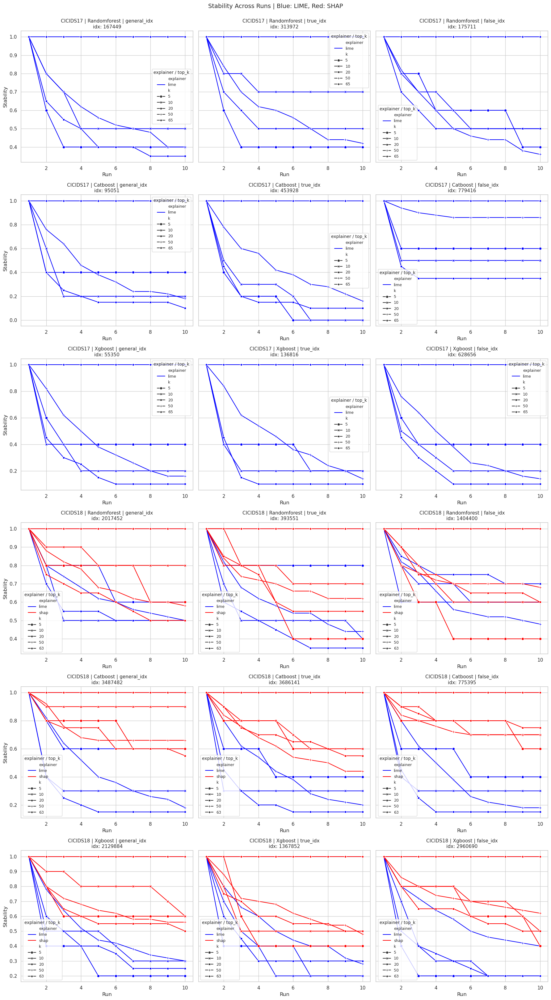

In [103]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Make sure string columns are lowercase for consistency
for col in ["explainer", "sampleset", "model", "dataset"]:
    stability_df[col] = stability_df[col].str.lower()

datasets = ['cicids17', 'cicids18']
models = ['randomforest', 'catboost', 'xgboost']
samplesets = ['general_idx', 'true_idx', 'false_idx']

nrows = len(datasets) * len(models)
ncols = len(samplesets)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(18, 5.5*nrows), sharey='row')
explainer_palette = {'lime': 'blue', 'shap': 'red'}
run_cols = [f"Run {i}" for i in range(1, 11)]

for d_idx, dataset in enumerate(datasets):
    for m_idx, model in enumerate(models):
        row = d_idx * len(models) + m_idx
        for col, sampleset in enumerate(samplesets):
            ax = axes[row, col]
            group = stability_df[
                (stability_df['dataset'] == dataset) &
                (stability_df['model'] == model) &
                (stability_df['sampleset'] == sampleset)
            ]
            idxs = group["idx"].unique()
            if len(idxs) == 0:
                ax.axis("off")
                continue
            idx = idxs[0]
            sub = group[group["idx"] == idx].copy()
            sub["k"] = sub["k"].astype(int)
            df_long = pd.melt(
                sub, id_vars=['explainer', 'k'],
                value_vars=run_cols,
                var_name="Run", value_name="Stability"
            )
            df_long["Run"] = df_long["Run"].str.extract(r"(\d+)").astype(int)
            df_long["k"] = df_long["k"].astype(int)
            sns.lineplot(
                data=df_long,
                x="Run",
                y="Stability",
                hue="explainer",
                style="k",
                markers=True,
                dashes=False,
                palette=explainer_palette,
                ax=ax,
                legend=True,  # Enable legend IN each plot
            )
            ax.set_title(f"{dataset.upper()} | {model.capitalize()} | {sampleset}\nidx: {idx}", fontsize=11)
            ax.set_xlabel("Run")
            if col == 0:
                ax.set_ylabel("Stability")
            else:
                ax.set_ylabel("")

            # Clean up legend for each individual plot for clarity
            handles, labels = ax.get_legend_handles_labels()
            if handles:
                ax.legend(loc='best', fontsize=9, title="explainer / top_k", title_fontsize=10)
            else:
                ax.legend_.remove()  # Remove if nothing to display

plt.tight_layout(rect=[0, 0, 1, 0.97])
fig.suptitle(
    "Stability Across Runs | Blue: LIME, Red: SHAP",
    fontsize=14
)
plt.show()


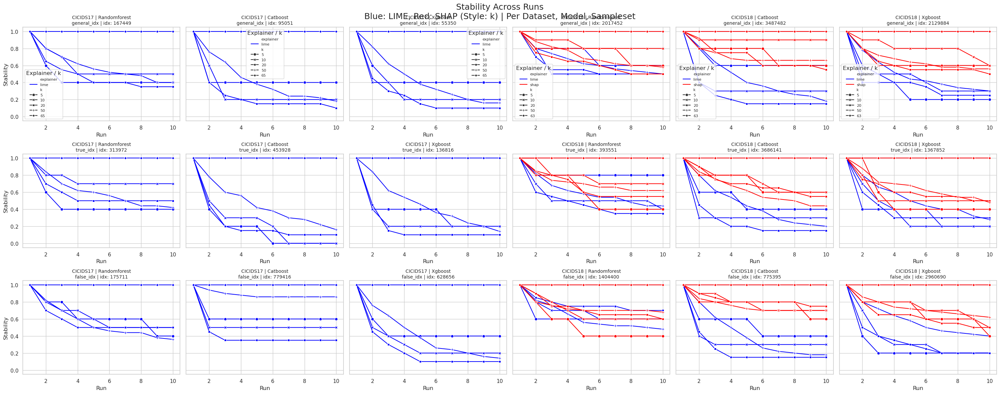

In [84]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Make sure stability_df is already loaded and all string columns are in lowercase for consistency
stability_df["explainer"] = stability_df["explainer"].str.lower()
stability_df["sampleset"] = stability_df["sampleset"].str.lower()
stability_df["model"] = stability_df["model"].str.lower()
stability_df["dataset"] = stability_df["dataset"].str.lower()

datasets = ['cicids17', 'cicids18']
models = ['randomforest', 'catboost', 'xgboost']
samplesets = ['general_idx', 'true_idx', 'false_idx']

fig, axes = plt.subplots(nrows=3, ncols=6, figsize=(30, 12), sharey=True)
explainer_palette = {'lime': 'blue', 'shap': 'red'}
run_cols = [f"Run {i}" for i in range(1, 11)]

# For readability, map col_idx: 0-2 for cicids17, 3-5 for cicids18
for col, dataset in enumerate(datasets):
    for midx, model in enumerate(models):
        ax_idx = col * 3 + midx  # 0-2: cicids17, 3-5: cicids18
        for row, sampleset in enumerate(samplesets):
            ax = axes[row, ax_idx]
            # Find first available idx for this config
            group = stability_df[
                (stability_df['dataset'] == dataset) &
                (stability_df['model'] == model) &
                (stability_df['sampleset'] == sampleset)
            ]
            idxs = group["idx"].unique()
            if len(idxs) == 0:
                ax.axis("off")
                continue
            idx = idxs[0]  # Take the first
            sub = group[group["idx"] == idx].copy()
            sub["k"] = sub["k"].astype(int)
            df_long = pd.melt(
                sub, id_vars=['explainer', 'k'],
                value_vars=run_cols,
                var_name="Run", value_name="Stability"
            )
            df_long["Run"] = df_long["Run"].str.extract(r"(\d+)").astype(int)
            df_long["k"] = df_long["k"].astype(int)
            sns.lineplot(
                data=df_long,
                x="Run",
                y="Stability",
                hue="explainer",
                style="k",
                markers=True,
                dashes=False,
                palette=explainer_palette,
                ax=ax,
            )
            ax.set_title(f"{dataset.upper()} | {model.capitalize()}\n{sampleset} | idx: {idx}", fontsize=10)
            ax.set_xlabel("Run")
            if midx == 0 and col == 0:
                ax.set_ylabel("Stability")
            else:
                ax.set_ylabel("")
            if row != 0:
                ax.get_legend().remove()
            else:
                ax.legend(title="Explainer / k", fontsize=8)

plt.tight_layout()
plt.subplots_adjust(top=0.92)
fig.suptitle("Stability Across Runs\nBlue: LIME, Red: SHAP (Style: k) | Per Dataset, Model, Sampleset", fontsize=18)
plt.show()


#### Single IDX - Lime vs Shap

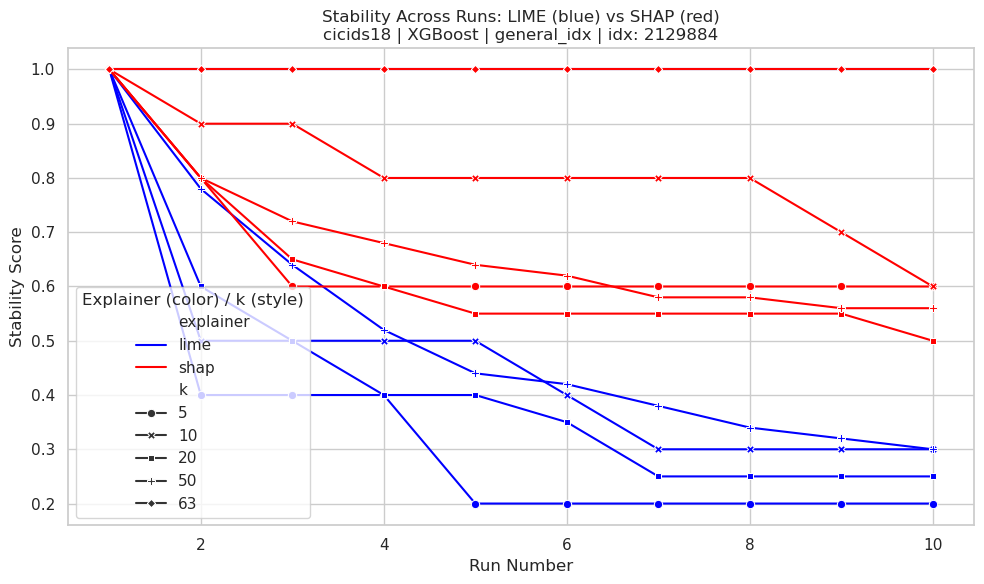

In [74]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd


idx_of_interest = 2129884

df_plot = stability_df[
    (stability_df['dataset'] == 'cicids18') &
    (stability_df['model'] == 'XGBoost') &
    (stability_df['sampleset'] == 'general_idx') &
    (stability_df['idx'] == idx_of_interest)
].copy()


df_plot['k'] = df_plot['k'].astype(int)
run_cols = [f"Run {i}" for i in range(1, 11)]
df_long = pd.melt(
    df_plot,
    id_vars=['explainer', 'k'],
    value_vars=run_cols,
    var_name="Run",
    value_name="Stability"
)
df_long["Run"] = df_long["Run"].str.extract(r"(\d+)").astype(int)
df_long["k"] = df_long["k"].astype(int)

# Explicit color palette: blue for lime, red for shap
explainer_palette = {'lime': 'blue', 'shap': 'red'}

plt.figure(figsize=(10, 6))
sns.lineplot(
    data=df_long,
    x="Run",
    y="Stability",
    hue="explainer",
    style="k",
    markers=True,
    dashes=False,
    palette=explainer_palette
)
plt.title(f"Stability Across Runs: LIME (blue) vs SHAP (red)\ncicids18 | XGBoost | general_idx | idx: {idx_of_interest}")
plt.xlabel("Run Number")
plt.ylabel("Stability Score")
plt.legend(title="Explainer (color) / k (style)")
plt.tight_layout()
plt.show()


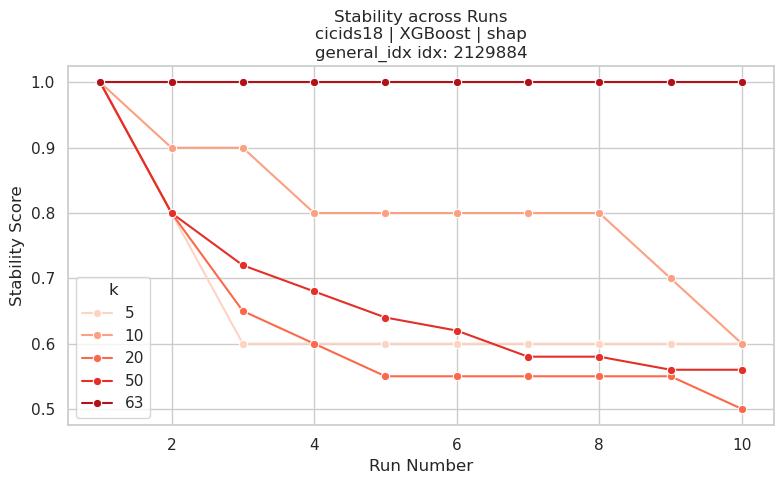

In [62]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

palette = sns.color_palette("Reds", n_colors=5)

first_row = stability_df.iloc[0]
mask = (
    (stability_df['dataset'] == first_row['dataset']) &
    (stability_df['model'] == first_row['model']) &
    (stability_df['explainer'] == first_row['explainer']) &
    (stability_df['sampleset'] == first_row['sampleset']) &
    (stability_df['idx'] == first_row['idx'])
)
df_first = stability_df[mask]

# Melt to long format for plotting runs (optional: filter out Run 1 by changing value_vars)
value_vars = [f"Run {i}" for i in range(1, 11)]
df_long = pd.melt(
    df_first,
    id_vars=['k'],
    value_vars=value_vars,
    var_name='Run',
    value_name='Stability'
)
#print(df_long)
df_long['Run'] = df_long['Run'].str.extract(r"(\d+)").astype(int)
df_long['k'] = df_long['k'].astype(int)

plt.figure(figsize=(8, 5))
sns.lineplot(
    data=df_long, 
    x="Run", 
    y="Stability", 
    hue="k", 
    marker="o",
    palette=palette
)
plt.title(f"Stability across Runs\n{first_row['dataset']} | {first_row['model']} | {first_row['explainer']}\n{first_row['sampleset']} idx: {first_row['idx']}")
plt.xlabel("Run Number")
plt.ylabel("Stability Score")
plt.legend(title="k")
plt.tight_layout()
plt.show()


# (4) Runtime

Since Lime is a local method, a comparison between global explanations does not fit, as a corresponding numbe rof local explanations must be made. Therefore only the local explanations will be tested.

In [ ]:
import os
import time
import pandas as pd
import numpy as np
from ast import literal_eval
import gc
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import matplotlib as plt
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    balanced_accuracy_score)
from collections import defaultdict
import json
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
import time
from lime.lime_tabular import LimeTabularExplainer
import shap


random_state = 42
path = "explanation_data/test/"
#samplesets = ["general_idx", "true_idx", "false_idx"]


df = pd.read_parquet("datasets/cicids17/cicids17-pre-processed.parquet")
print(df.shape)

y = df.pop("Label") # Features
X = df
print(X.shape)

le = LabelEncoder()
y = le.fit_transform(y)

print(np.unique(y))

X_trainval, X_test, y_trainval, y_test = train_test_split(
    X,
    y,
    test_size=0.3,  # 30% for test
    random_state=random_state,
    stratify=y
)

X_train, X_val, y_train, y_val = train_test_split(
    X_trainval,
    y_trainval,
    test_size=0.2857,  # 20% of total = 0.2857 * 70% ≈ 20%
    random_state=random_state,
    stratify=y_trainval
)

print(f"Train: {X_train.shape}, Val: {X_val.shape}, Test: {X_test.shape}")
print(f"Train: {y_train.shape}, Val: {y_val.shape}, Test: {y_test.shape}")

models = []
print("Train RF")
model_name = "RandomForest"
clf = RandomForestClassifier(
    n_estimators=50,
    #min_samples_split=10,
    max_depth=5,
    class_weight='balanced',
    random_state=random_state,
    n_jobs=-1,
    verbose=0
    )
rf = clf.fit(X_train, y_train)

model_dict = {
    "name": model_name,
    "model": rf
}
models.append(model_dict)

print("Train XGB")
model_name = "XGBoost"
num_class = len(np.unique(y))
clf = XGBClassifier(
    device='cpu',
    objective='multi:softprob',
    num_class=num_class,
    booster='gbtree',
    random_state=random_state,
    max_depth=3,
    learning_rate=0.1,
    n_estimators=50,
    n_jobs=-1
    )
xgb = clf.fit(X_train, y_train)
model_dict = {
    "name": model_name,
    "model": xgb
}
models.append(model_dict)

print("Train Cat")
model_name = "Catboost"
clf = catboost = CatBoostClassifier(
    loss_function='MultiClass',
    bootstrap_type='Bayesian',
    random_seed=random_state,
    verbose=False,
    depth=3,
    iterations=50,
    learning_rate=0.1
    )
cat = clf.fit(X_train, y_train)
model_dict = {
    "name": model_name,
    "model": cat
}
models.append(model_dict)

In [ ]:
for val in sorted(np.unique(y)):
    print(f"{val}: {le.inverse_transform([val])[0]}")

In [ ]:
del X, y, X_val, y_val, X_trainval, y_trainval

samples = np.random.choice(X_test.index, size=2500, replace=False)
#samples = X_test.sample(n=100, random_state=random_state)
print("Number of samples:", len(samples))
print(samples[:10])


## Full Run - All Datasets, All Models, Smoothed

In [1]:
import os

path = 'models/'
all_models = os.listdir(path)
model_path = sorted([f for f in all_models if os.path.isfile(os.path.join(path, f))])
#del model_path[1]
for f in model_path:
    print(path + f)


models/CatBoost_gridsearch_cicids17.joblib
models/CatBoost_gridsearch_cicids18.joblib
models/RF_gridsearch_cicids17.joblib
models/RF_gridsearch_cicids18.joblib
models/XGB_gridsearch_cicids17.joblib
models/XGB_gridsearch_cicids18.joblib


In [ ]:
import pandas as pd
import numpy as np
import joblib
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
import time
from datetime import datetime
from lime.lime_tabular import LimeTabularExplainer
import shap
import os
from xgboost import XGBClassifier


random_state = 42

runs = range(10)
#runs=[1]
measurements = [10, 50, 100, 250, 500, 1000] #, 2500]
sample_size = 1000

#runs = range(3)
#measurements = [2, 5, 10]
#sample_size = 10

sample_sets = ["general_idx", "true_idx", "false_idx"]

datasets = [
    'datasets/cicids17/cicids17-pre-processed.parquet',
    'datasets/cicids18/cicids18-pre-processed.parquet',
    #'datasets/cicids17/cicids17-sample.parquet',
    #'datasets/cicids18/cicids18-sample.parquet'
    ]

path = 'models/'
all_models = os.listdir(path)
model_path = sorted([path + f for f in all_models if os.path.isfile(os.path.join(path, f))])

xai_methods = ["Lime", "Shap"]

epsilon=1e-16

# necessary helper function to circumvent zero division due to 0.0 predict_proba in random forest
def smoothing_func(X_input):
    # handle feature issues in random forest
    if isinstance(X_input, np.ndarray):
        X_input = pd.DataFrame(X_input, columns=X_train.columns)

    probs = model.predict_proba(X_input)
    probs = np.clip(probs, epsilon, 1 - epsilon)
    probs /= probs.sum(axis=1, keepdims=True)
    return probs

models = []

# load models
for model in model_path:
    if "cicids17" in model.lower():
        dataset = "cicids17"
    if "cicids18" in model.lower():
        dataset = "cicids18"
    if "rf" in model.lower() or "randomforest" in model.lower():
        name = "RandomForest"
    if "catboost" in model.lower():
        name = "CatBoost"
    if "xgb" in model.lower() or "xgboost" in model.lower():
        name = "XGB"

    if name == "XGB" and dataset == "cicids17":
        model = XGBClassifier()
        model.load_model("models/cicids17_XGBoost.json")
    elif name == "XGB" and dataset == "cicids18":
        model = XGBClassifier()
        model.load_model("models/cicids17_XGBoost.json")
    else:        
        model = joblib.load(model)
        #model = grid_searchRF.best_estimator_

    model_dict = {
        "name": name,
        "model": model,
        "dataset": dataset,
    }
    print(f'Loaded {name} for {dataset}')
    models.append(model_dict)

# Output file paths for saving incremental results
output_dir = "metrics/runtime/"
os.makedirs(output_dir, exist_ok=True)
output_path = os.path.join(output_dir, "XAI_all_models_runtime_results.csv")

timing_results = []

for file in datasets:

    if "cicids17" in file:
        dataset_name = "cicids17"
    elif "cicids18" in file:
        dataset_name = "cicids18"

    print(f"\n[{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}] Loading dataset: ", file)
    df = pd.read_parquet(file)

    y = df.pop("Label")
    X = df

    le = LabelEncoder()
    y = le.fit_transform(y)

    X_trainval, X_test, y_trainval, y_test = train_test_split(
        X,
        y,
        test_size=0.3,
        random_state=random_state,
        stratify=y
    )

    X_train, X_val, y_train, y_val = train_test_split(
        X_trainval,
        y_trainval,
        test_size=0.2857,
        random_state=random_state,
        stratify=y_trainval
    )

    print(f"\nTrain: {X_train.shape}, Val: {X_val.shape}, Test: {X_test.shape}")
    print(f"Train: {y_train.shape}, Val: {y_val.shape}, Test: {y_test.shape}")

    del X, y, X_val, y_val, X_trainval, y_trainval

    print("Collecting samples")
    rng = np.random.default_rng(random_state)

    for model in models:
        if model["dataset"] == dataset_name:
            model_name = model["name"]
            y_pred = model["model"].predict(X_test)

            y_true = np.array(y_test)
            y_pred = np.array(y_pred)

            if y_true.ndim > 1:
                y_true = y_true.ravel()
            if y_pred.ndim > 1:
                y_pred = y_pred.ravel()

            false_pred_idx = np.where(y_true != y_pred)[0]
            true_pred_idx = np.where(y_true == y_pred)[0]
            all_idx = np.arange(len(y_true))

            selected_false_idx = rng.choice(false_pred_idx, size=min(sample_size, len(false_pred_idx)), replace=False)
            selected_true_idx = rng.choice(true_pred_idx, size=min(sample_size, len(true_pred_idx)), replace=False)
            selected_general_idx = rng.choice(all_idx, size=min(sample_size, len(all_idx)), replace=False)

            model['general_idx'] = selected_general_idx
            model['true_idx'] = selected_true_idx
            model['false_idx'] = selected_false_idx

            print(f"\nClassifier: {model_name}")
            print(f"General samples available: {len(y_true)}, Selected: {len(selected_general_idx)}")
            print(f"True predictions available: {len(true_pred_idx)}, Selected: {len(selected_true_idx)}")
            print(f"False predictions available: {len(false_pred_idx)}, Selected: {len(selected_false_idx)}")

    print("\nChecking Min/Max values in predictions made by models:")
    for j in range(len(models)):
        if models[j]["dataset"] == dataset_name:
            model = models[j]["model"]
            model_name = models[j]["name"]

            print(f"\nModel: {model_name}, Dataset: {models[j]['dataset']}")
            raw_probs = model.predict_proba(X_test)
            print(f"Min/Max Probs (raw): {raw_probs.min()}, {raw_probs.max()}")

            smoothed_probs = smoothing_func(X_test)
            print(f"Min/Max Probs (with smoothing): {smoothed_probs.min()}, {smoothed_probs.max()}")

    print("Any NaN in X_test?", X_test.isna().any().any())

    # Explainer Runtime Logic
    for xai in xai_methods:
        if xai == "Lime":
            print(f"\nTesting runtime for XAI method {xai} on dataset {dataset_name}")
            limeExplainer = LimeTabularExplainer(
                training_data=X_train.to_numpy(),
                feature_names=X_train.columns,
                class_names=le.classes_,
                discretize_continuous=False,
                kernel_width=None,
                verbose=False,
                mode='classification',
                random_state=random_state
            )

            for m in models:
                if m["dataset"] == dataset_name:
                    model_name = m["name"]
                    model = m["model"]
                    print("Model: ", model_name)

                    for sample_set in sample_sets:
                        for run in runs:
                            start_time = time.perf_counter()
                            for i in range(len(m[sample_set])):
                                instance = X_test.iloc[i].values
                                exp = limeExplainer.explain_instance(
                                    data_row=instance,
                                    predict_fn=lambda x: model.predict_proba(pd.DataFrame(x, columns=X_test.columns)),
                                    num_features=len(X_test.columns),
                                    num_samples=5000
                                )

                                if i + 1 in measurements:
                                    end_time = time.perf_counter()
                                    elapsed = end_time - start_time
                                    print(f"Model: {model_name}, Sampleset: {sample_set}, Run: {run+1}/{len(runs)}, Number of Samples: {i+1}, Time: {elapsed}")
                                    timing_results.append({
                                        "xai_method": xai,
                                        "sample_set": sample_set,
                                        "sample_size": i + 1,
                                        "run": run + 1,
                                        "elapsed_time": elapsed,
                                        "dataset": dataset_name,
                                        "model": model_name
                                    })

                    if timing_results:
                        results_df = pd.DataFrame(timing_results)
                        if os.path.exists(output_path):
                            continue
                            #results_df.to_csv(output_path, mode="a", header=False, index=False)
                        else:
                            continue
                            #results_df.to_csv(output_path, index=False)
                        print(f"Intermediate runtime results appended for model {model_name} to {output_path}")
                        timing_results.clear()

        elif xai == "Shap":
            print(f"\nTesting runtime for XAI method {xai} on dataset {dataset_name}")
            background = shap.sample(X_train, 100, random_state=random_state)

            for m in models:
                if m["dataset"] == dataset_name:
                    model_name = m["name"]
                    model = m["model"]
                    print(f"Model: {model_name}")

                    explainer = shap.KernelExplainer(smoothing_func, background)

                    for sample_set in sample_sets:
                        for run in runs:
                            start_time = time.perf_counter()
                            for i in range(len(m[sample_set])):
                                instance = X_test.iloc[[i]]
                                explanation = explainer(instance, silent=True)

                                if i + 1 in measurements:
                                    end_time = time.perf_counter()
                                    elapsed = end_time - start_time
                                    print(f"[{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}] Model: {model_name}, Sampleset: {sample_set}, Run: {run+1}/{len(runs)}, Number of Samples: {i+1}, Time: {elapsed}")
                                    timing_results.append({
                                        "xai_method": xai,
                                        "sample_set": sample_set,
                                        "sample_size": i + 1,
                                        "run": run + 1,
                                        "elapsed_time": elapsed,
                                        "dataset": dataset_name,
                                        "model": model_name
                                    })

                    if timing_results:
                        results_df = pd.DataFrame(timing_results)
                        if os.path.exists(output_path):
                            continue
                            #results_df.to_csv(output_path, mode="a", header=False, index=False)
                        else:
                            continue
                            #results_df.to_csv(output_path, index=False)
                        print(f"Intermediate runtime results appended for model {model_name} to {output_path}")
                        timing_results.clear()

print(f"[{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}] All results saved to {output_path}")


## Statistical Analysis

In [7]:
import pandas as pd

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)
results = []

datasets = df['dataset'].unique()
models = df['model'].unique()
sample_sets = df['sample_set'].unique()

for dataset in datasets:
    for model in models:
        for sample_set in sample_sets:
            lime_rows = df[
                (df['dataset'] == dataset) &
                (df['model'] == model) &
                (df['sample_set'] == sample_set) &
                (df['xai_method'] == 'Lime')
            ]
            shap_rows = df[
                (df['dataset'] == dataset) &
                (df['model'] == model) &
                (df['sample_set'] == sample_set) &
                (df['xai_method'] == 'Shap')
            ]

            if lime_rows.empty and shap_rows.empty:
                continue  # skip if both are empty

            # Pivot Lime
            lime_pivot = pd.DataFrame()
            if not lime_rows.empty:
                lime_pivot = lime_rows.pivot(index=['dataset', 'model', 'sample_set', 'run'],
                                            columns='sample_size',
                                            values='elapsed_time').reset_index()
                lime_pivot = lime_pivot.rename(columns=lambda x: f"samples_{x}" if isinstance(x, int) else x)
                lime_pivot['xai_method'] = 'Lime'

            # Pivot SHAP
            shap_pivot = pd.DataFrame()
            if not shap_rows.empty:
                shap_pivot = shap_rows.pivot(index=['dataset', 'model', 'sample_set', 'run'],
                                            columns='sample_size',
                                            values='elapsed_time').reset_index()
                shap_pivot = shap_pivot.rename(columns=lambda x: f"samples_{x}" if isinstance(x, int) else x)
                shap_pivot['xai_method'] = 'Shap'

            # Append to results list
            results.append(lime_pivot)
            results.append(shap_pivot)

# Concatenate all results
merged_df = pd.concat(results, ignore_index=True)
#merged_df.to_csv("metrics/runtime/runtime_all_results")

print(merged_df[merged_df["sample_set"] == "general_idx"])


sample_size   dataset         model   sample_set  run  samples_10  samples_50  samples_100  samples_250  samples_500  samples_1000 xai_method
0            cicids17      CatBoost  general_idx    1    0.330473    1.549969     3.079158     7.585323    14.881540     29.908042       Lime
1            cicids17      CatBoost  general_idx    2    0.283721    1.438905     2.890844     7.295719    14.717976     31.400174       Lime
2            cicids17      CatBoost  general_idx    3    0.287933    1.471093     2.941433     8.146916    16.311998     32.249642       Lime
3            cicids17      CatBoost  general_idx    4    0.283610    1.438331     2.866587     7.307509    14.813797     29.268697       Lime
4            cicids17      CatBoost  general_idx    5    0.297661    1.460516     2.914892     7.440366    14.725040     29.418641       Lime
5            cicids17      CatBoost  general_idx    6    0.302735    1.513185     2.971107     7.361482    14.615836     30.034754       Lime
6     

In [131]:
# Pivot the DataFrame so each sample_size becomes multiple columns for lime and shap

# First, melt lime and shap runtimes with sample_size as column
# But since lime and shap runtimes are already separate columns, we will create two pivot tables and merge them

# Pivot for lime runtimes
lime_sizes = merged_df.pivot_table(
    index=['dataset', 'model', 'sample_set', 'run'],
    columns='sample_size',
    values='lime_runtime'
).rename(columns=lambda x: f"lime_{x}")

# Pivot for shap runtimes
shap_sizes = merged_df.pivot_table(
    index=['dataset', 'model', 'sample_set', 'run'],
    columns='sample_size',
    values='shap_runtime'
).rename(columns=lambda x: f"shap_{x}")

# Combine lime and shap pivot tables side by side
final_df = pd.concat([lime_sizes, shap_sizes], axis=1).reset_index()

print(final_df.head(20))


sample_size   dataset     model   sample_set  run   lime_10   lime_50  lime_100  lime_250   lime_500  lime_1000   shap_10    shap_50   shap_100    shap_250    shap_500   shap_1000
0            cicids17  CatBoost    false_idx    1  0.286403  1.455165  2.983093  7.395122  14.803668        NaN  8.514129  42.646435  85.374107  212.467550  425.011024         NaN
1            cicids17  CatBoost    false_idx    2  0.291837  1.474844  2.904059  7.282979  14.598040        NaN  8.523613  42.697180  85.153745  213.113678  426.968551         NaN
2            cicids17  CatBoost    false_idx    3  0.288928  1.429934  2.909985  7.269602  14.526033        NaN  8.492302  42.540780  85.065979  213.373999  426.230285         NaN
3            cicids17  CatBoost    false_idx    4  0.290636  1.472685  2.915240  7.223658  14.488846        NaN  8.477191  42.365675  85.068950  213.916922  426.821817         NaN
4            cicids17  CatBoost    false_idx    5  0.282685  1.490958  2.933197  7.347898  14.705016

### Normality Test (Shapiro-Wilk Test)

checks runtimes for each sampleset over 10 runs whether they are normally distributed or not. 


Shapiro, S. S., & Wilk, M. B. (1965). "An analysis of variance test for normality (complete samples)." Biometrika, 52(3/4), 591-611.

In [120]:
import pandas as pd
from scipy.stats import shapiro

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv")

grouped = df.groupby(['dataset', 'model', 'xai_method', 'sample_set', 'sample_size'])

results = []

# Counters
normal_count = 0
not_normal_count = 0

for name, group in grouped:
    elapsed_times = group['elapsed_time']
    
    stat, p_value = shapiro(elapsed_times)
                # The closer the statistic is to 1, the more the data resembles a normal distribution can be considered normal
                # If the p-value ≤ 0.05, null hypothesis is rejected, data likely not normally distributed, if p-value > 0.05
                # The W statistic measures how close the sample distribution is to a normal distribution, 
                # but the p-value determines if the observed value of W is statistically significant.
    if p_value > 0.05:
        interpretation = "normally distributed"
        normal_count += 1
    else:
        interpretation = "not normally distributed"
        not_normal_count += 1
    
    results.append({
        'dataset': name[0],
        'model': name[1],
        'xai_method': name[2],
        'sample_set': name[3],
        'sample_size': name[4],
        'W statistic': stat,
        'p_value': p_value,
        'n_samples': len(elapsed_times),
        'result': interpretation
    })

shapiro_results_df = pd.DataFrame(results)
print(shapiro_results_df)

print(f"\nNumber of groups normally distributed: {normal_count}")
print(f"Number of groups NOT normally distributed: {not_normal_count}")


      dataset         model xai_method   sample_set  sample_size  W statistic       p_value  n_samples                    result
0    cicids17      CatBoost       Lime    false_idx           10     0.624826  1.094825e-04         10  not normally distributed
1    cicids17      CatBoost       Lime    false_idx           50     0.746154  3.203921e-03         10  not normally distributed
2    cicids17      CatBoost       Lime    false_idx          100     0.591309  4.357488e-05         10  not normally distributed
3    cicids17      CatBoost       Lime    false_idx          250     0.615096  8.374319e-05         10  not normally distributed
4    cicids17      CatBoost       Lime    false_idx          500     0.770922  6.417658e-03         10  not normally distributed
5    cicids17      CatBoost       Lime  general_idx           10     0.780958  8.504179e-03         10  not normally distributed
6    cicids17      CatBoost       Lime  general_idx           50     0.924500  3.960180e-01      

### Significance Test (Lime vs Shap [general_idx])

paired samples, small sample size, normal / not normal data

In [5]:
import pandas as pd
from scipy.stats import shapiro, wilcoxon, ttest_rel

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)

results = []

def is_normal(data):
    if len(data) < 3:
        # Shapiro requires at least 3 samples
        return False
    if data.max() == data.min():
        # check variance of data
        return True
    stat, p_value = shapiro(data)
    return p_value > 0.05

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for sample_set in df['sample_set'].unique()[:1]:
            for sample_size in df[df['dataset'] == dataset]['sample_size'].unique():

                if sample_size == 0:
                    continue

                lime_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sample_set"] == sample_set) &
                    (df["xai_method"].str.lower() == "lime") &
                    (df["sample_size"] == sample_size)
                ]

                shap_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sample_set"] == sample_set) &
                    (df["xai_method"].str.lower() == "shap") &
                    (df["sample_size"] == sample_size)
                ]

                if lime_subset.empty or shap_subset.empty:
                    continue

                lime_vals = lime_subset["elapsed_time"].values
                shap_vals = shap_subset["elapsed_time"].values

                min_len = min(len(lime_vals), len(shap_vals))
                lime_vals = lime_vals[:min_len]
                shap_vals = shap_vals[:min_len]

                lime_mean = round(lime_vals.mean(), 5)
                lime_std = round(lime_vals.std(ddof=1), 5)
                lime_var = round(lime_vals.var(ddof=1), 5)
                
                shap_mean = round(shap_vals.mean(), 5)
                shap_std = round(shap_vals.std(ddof=1), 5)
                shap_var = round(shap_vals.var(ddof=1), 5)

                normality_lime = is_normal(lime_vals)
                normality_shap = is_normal(shap_vals)

                if normality_lime and normality_shap:
                    stat, p = ttest_rel(lime_vals, shap_vals)
                    norm = True
                else:
                    stat, p = wilcoxon(lime_vals, shap_vals)
                    norm = False

                interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                results.append({
                    "dataset": dataset,
                    "model": model,
                    "sample_set": sample_set,
                    "sample_size": sample_size,
                    "n_samples": min_len,
                    "lime_mean": lime_mean,
                    "lime_std": lime_std,
                    "lime_var": lime_var,
                    "shap_mean": shap_mean,
                    "shap_std": shap_std,
                    "shap_var": shap_var,
                    "normality": norm,
                    "ttest/W_stat": round(stat, 5),
                    "p_value": round(p, 5),
                    "interpretation": interpretation
                })

results_df = pd.DataFrame(results)
print(results_df)

results_df.to_csv("metrics/runtime/runtime_significance_lime_vs_shap.csv", index=False)


     dataset         model   sample_set  sample_size  n_samples  lime_mean  lime_std  lime_var   shap_mean  shap_std  shap_var  normality  ttest/W_stat  p_value          interpretation
0   cicids17      CatBoost  general_idx           10         10    0.29980   0.02788   0.00078     8.42564   0.16645   0.02770      False       0.00000  0.00195  Significant difference
1   cicids17      CatBoost  general_idx           50         10    1.50376   0.09253   0.00856    42.12876   1.26678   1.60474      False       0.00000  0.00195  Significant difference
2   cicids17      CatBoost  general_idx          100         10    2.98481   0.16869   0.02845    83.94007   1.52669   2.33080      False       0.00000  0.00195  Significant difference
3   cicids17      CatBoost  general_idx          250         10    7.56320   0.28774   0.08279   209.45333   2.29754   5.27867      False       0.00000  0.00195  Significant difference
4   cicids17      CatBoost  general_idx          500         10   15.00844 

### Visualization

#### Lime vs Shap General Mean

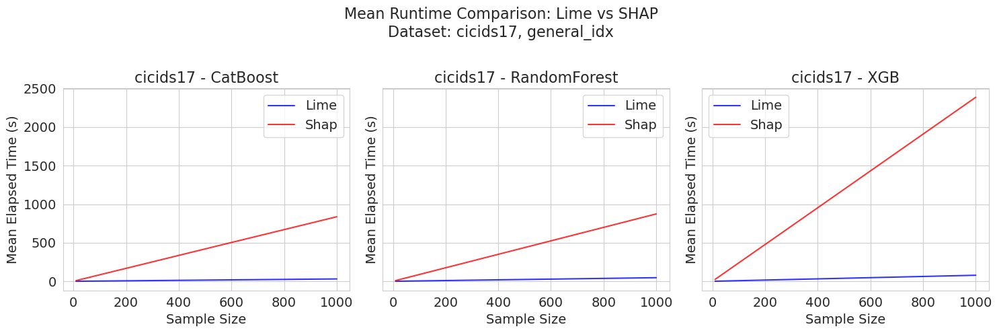

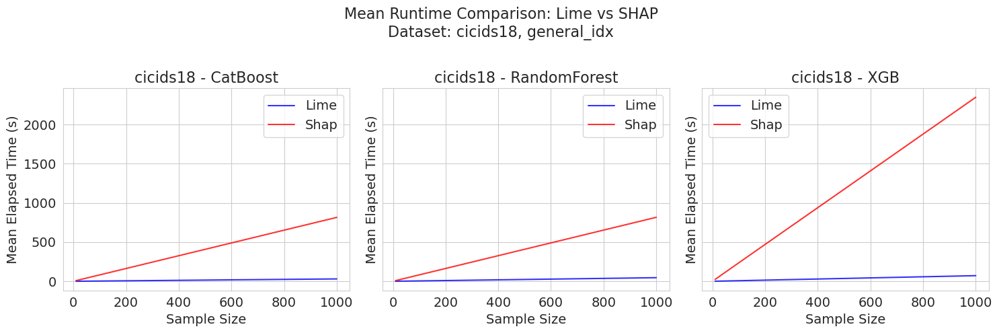

In [39]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv")

df.columns = df.columns.str.strip()

# Filter for general_idx sample set
df_gen = df[df['sample_set'] == 'general_idx']

# Calculate mean elapsed_time grouped by dataset, model, xai_method, sample_set, sample_size
mean_df = df_gen.groupby(['dataset', 'model', 'xai_method', 'sample_set', 'sample_size'], as_index=False)['elapsed_time'].mean()

color_palette = {'Lime': 'blue', 'Shap': 'red'}
line_styles = {'Lime': '-', 'Shap': '-'}

sns.set_style("whitegrid")
datasets = mean_df['dataset'].unique()

for dataset in datasets:
    df_dataset = mean_df[mean_df['dataset'] == dataset]
    models = df_dataset['model'].unique()
    
    n_models = len(models)
    
    fig, axes = plt.subplots(1, n_models, figsize=(5 * n_models, 5), sharey=True)
    if n_models == 1:
        axes = [axes]
        
    for ax, model in zip(axes, models):
        df_model = df_dataset[df_dataset['model'] == model]
        
        for xai_method in ['Lime', 'Shap']:
            df_xai = df_model[df_model['xai_method'] == xai_method].sort_values('sample_size')
            
            ax.plot(
                df_xai['sample_size'],
                df_xai['elapsed_time'],
                label=xai_method,
                color=color_palette[xai_method],
                linestyle=line_styles[xai_method],
                alpha=0.8
            )
        
        ax.set_title(f"{dataset} - {model}", fontsize=16)
        ax.set_xlabel("Sample Size", fontsize=14)
        ax.set_ylabel("Mean Elapsed Time (s)", fontsize=14)
        ax.legend(fontsize=14, loc='best')
        ax.tick_params(labelsize=14)
    
    plt.suptitle(f"Mean Runtime Comparison: Lime vs SHAP\nDataset: {dataset}, general_idx", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    plot_filename = f"metrics/runtime/plots/runtime_{dataset}_means.png"
    plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
    plt.show()


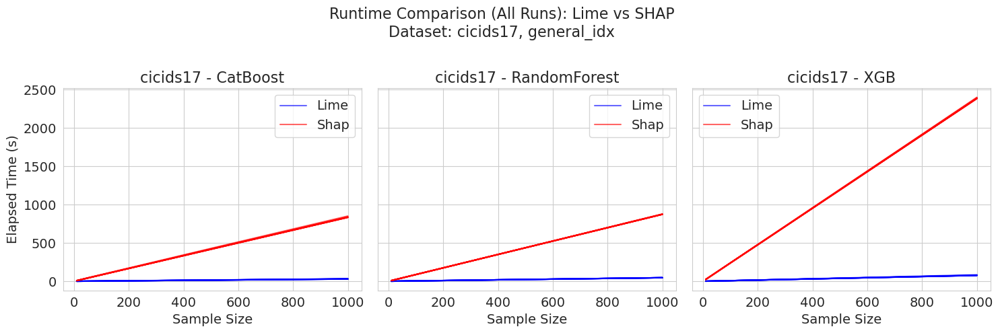

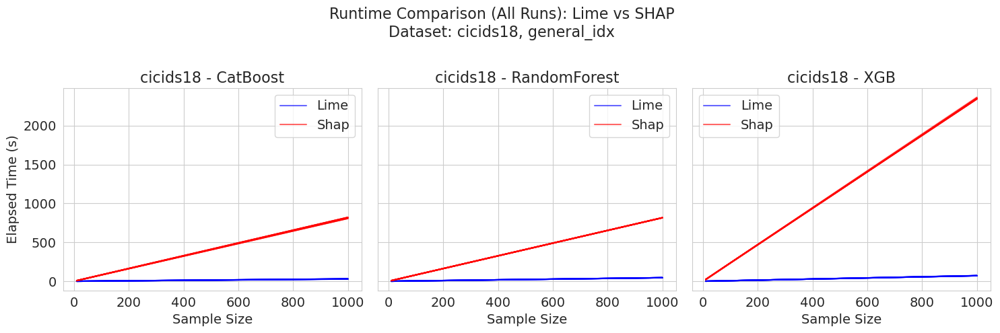

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv")
df.columns = df.columns.str.strip()
df_gen = df[df['sample_set'] == 'general_idx']

color_palette = {'Lime': 'blue', 'Shap': 'red'}
line_styles = {'Lime': '-', 'Shap': '-'}

sns.set_style("whitegrid")
datasets = df_gen['dataset'].unique()

for dataset in datasets:
    # Filter for current dataset
    df_dataset = df_gen[df_gen['dataset'] == dataset]
    models = df_dataset['model'].unique()
    
    n_models = len(models)
    
    # Create subplots
    fig, axes = plt.subplots(1, n_models, figsize=(5 * n_models, 5), sharey=True)
    if n_models == 1:
        axes = [axes]
        
    for ax, model in zip(axes, models):
        df_model = df_dataset[df_dataset['model'] == model]
        
        for xai_method in ['Lime', 'Shap']:

            df_xai = df_model[df_model['xai_method'] == xai_method]
            unique_runs = df_xai['run'].unique()
            
            for i, run_nr in enumerate(unique_runs):

                run_data = df_xai[df_xai['run'] == run_nr].sort_values('sample_size')                
                label = xai_method if i == 0 else None
                
                ax.plot(
                    run_data['sample_size'],
                    run_data['elapsed_time'],
                    label=label, 
                    color=color_palette[xai_method],
                    linestyle=line_styles[xai_method],
                    alpha=0.6, # Transparency helps visualize density of runs
                    linewidth=1.5
                )
        
        # Formatting
        ax.set_title(f"{dataset} - {model}", fontsize=16)
        ax.set_xlabel("Sample Size", fontsize=14)
        if ax == axes[0]:
            ax.set_ylabel("Elapsed Time (s)", fontsize=14)
            
        ax.legend(fontsize=14, loc='best')
        ax.tick_params(labelsize=14)
    
    plt.suptitle(f"Runtime Comparison (All Runs): Lime vs SHAP\nDataset: {dataset}, general_idx", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    # Changed filename to indicate this contains all runs
    plot_filename = f"metrics/runtime/plots/runtime_{dataset}_all_runs.png"
    # plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
    plt.show()

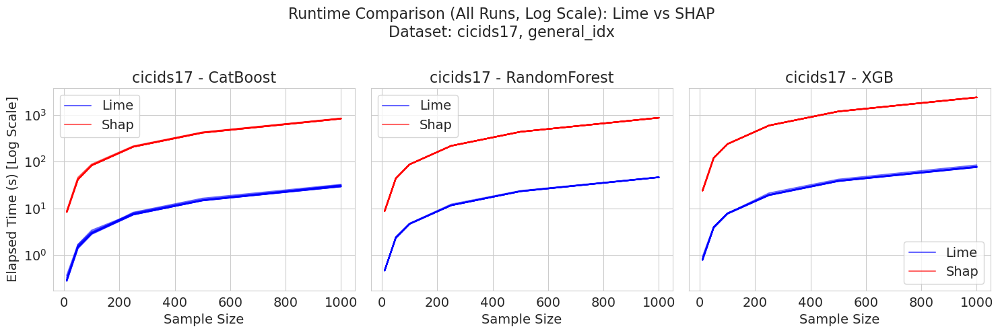

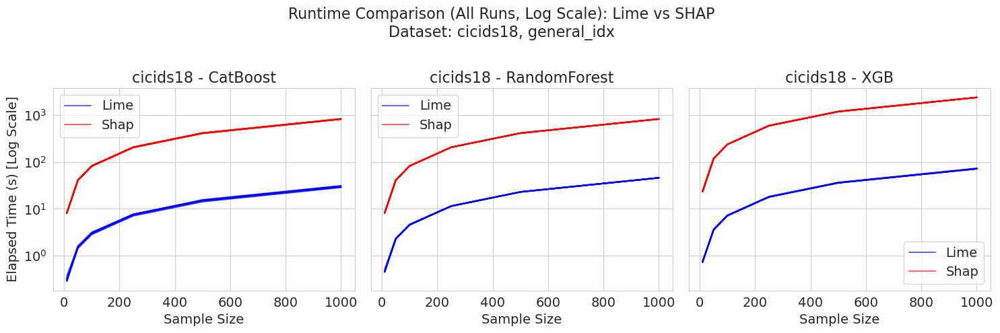

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load Data
df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv")

# Clean column names
df.columns = df.columns.str.strip()

# Filter for general_idx sample set
df_gen = df[df['sample_set'] == 'general_idx']

color_palette = {'Lime': 'blue', 'Shap': 'red'}
line_styles = {'Lime': '-', 'Shap': '-'}

sns.set_style("whitegrid")
datasets = df_gen['dataset'].unique()

for dataset in datasets:
    # Filter for current dataset
    df_dataset = df_gen[df_gen['dataset'] == dataset]
    models = df_dataset['model'].unique()
    
    n_models = len(models)
    
    # Create subplots
    fig, axes = plt.subplots(1, n_models, figsize=(5 * n_models, 5), sharey=True)
    if n_models == 1:
        axes = [axes]
        
    for ax, model in zip(axes, models):
        df_model = df_dataset[df_dataset['model'] == model]
        
        for xai_method in ['Lime', 'Shap']:
            # Filter for specific XAI method
            df_xai = df_model[df_model['xai_method'] == xai_method]
            
            # Loop through each run explicitly
            unique_runs = df_xai['run'].unique()
            
            for i, run_nr in enumerate(unique_runs):
                # Get data for this specific run
                run_data = df_xai[df_xai['run'] == run_nr].sort_values('sample_size')
                
                # Label only the first run to avoid duplicate legend entries
                label = xai_method if i == 0 else None
                
                ax.plot(
                    run_data['sample_size'],
                    run_data['elapsed_time'],
                    label=label, 
                    color=color_palette[xai_method],
                    linestyle=line_styles[xai_method],
                    alpha=0.6, 
                    linewidth=1.5
                )
        
        # --- LOG SCALE SETTING ---
        ax.set_yscale('log')
        
        # Formatting
        ax.set_title(f"{dataset} - {model}", fontsize=16)
        ax.set_xlabel("Sample Size", fontsize=14)
        if ax == axes[0]:
            ax.set_ylabel("Elapsed Time (s) [Log Scale]", fontsize=14)
            
        ax.legend(fontsize=14, loc='best')
        ax.tick_params(labelsize=14, which='both') # 'both' applies to minor ticks too (helpful for log)
    
    plt.suptitle(f"Runtime Comparison (All Runs, Log Scale): Lime vs SHAP\nDataset: {dataset}, general_idx", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    plot_filename = f"metrics/runtime/plots/runtime_{dataset}_all_runs_log.png"
    # plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
    plt.show()

#### All Runs Per Sampleset

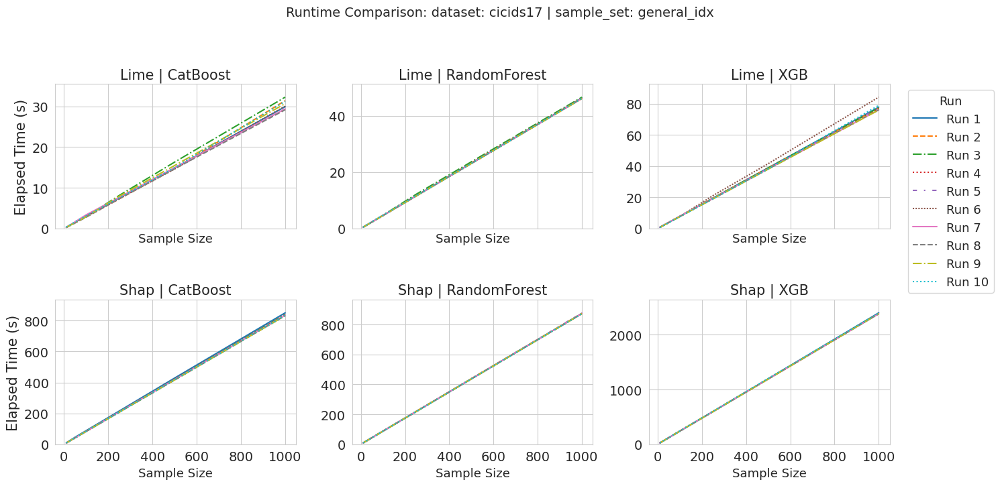

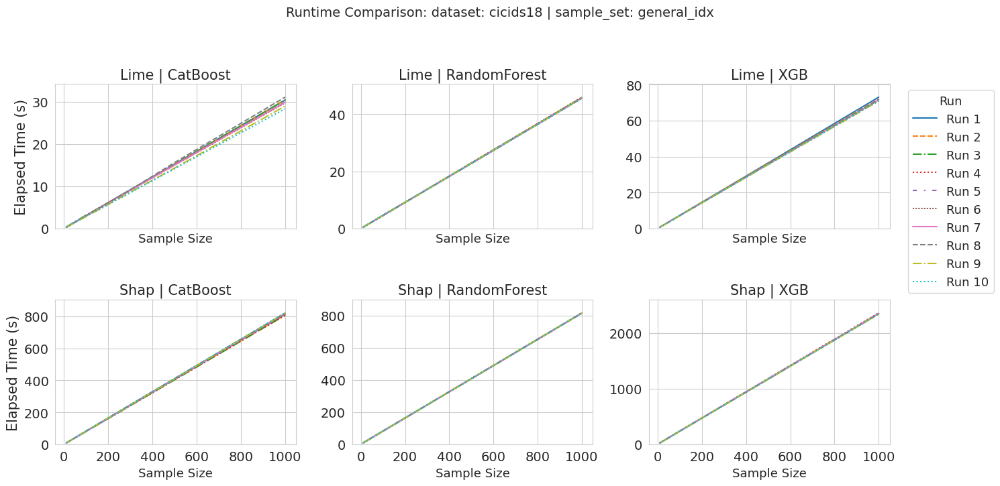

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)

df.columns = df.columns.str.strip()

sns.set_style("whitegrid")
datasets = df['dataset'].unique()
line_styles = ['-', '--', '-.', ':', (0, (3, 5, 1, 5)), (0, (1, 1))]
marker_shapes = ['o', 's', '^', 'D', 'v', '*', 'x', 'P', 'h', '+']

os.makedirs("metrics/runtime/plots", exist_ok=True)

for sample_set in df['sample_set'].dropna().unique()[:1]:
    temp_set_df = df[df['sample_set'] == sample_set]

    for dataset in datasets:
        temp_df = temp_set_df[temp_set_df['dataset'] == dataset]
        models = temp_df['model'].unique()
        xai_methods = temp_df['xai_method'].unique()

        fig, axes = plt.subplots(
            nrows=len(xai_methods),
            ncols=len(models),
            figsize=(5 * len(models), 3.5 * len(xai_methods)),
            sharex=True, sharey=False
        )

        if len(xai_methods) == 1:
            axes = np.expand_dims(axes, 0)
        if len(models) == 1:
            axes = np.expand_dims(axes, 1)

        for row, method in enumerate(xai_methods):
            for col, model in enumerate(models):
                ax = axes[row, col]
                panel_df = temp_df[(temp_df['model'] == model) & (temp_df['xai_method'] == method)]
                if panel_df.empty:
                    ax.set_visible(False)
                    continue

                runs = sorted(panel_df['run'].unique())
                for i, run in enumerate(runs):
                    run_df = panel_df[panel_df['run'] == run]
                    ax.plot(
                        run_df['sample_size'],
                        run_df['elapsed_time'],
                        label=f"Run {run}",
                        linestyle=line_styles[i % len(line_styles)]
                        # marker=marker_shapes[i % len(marker_shapes)],
                        # markersize=8
                    )

                ymax = panel_df['elapsed_time'].max()
                ax.set_ylim(0, ymax * 1.10)

                ax.set_title(f"{method} | {model}", fontsize=15)
                ax.set_xlabel("Sample Size", fontsize=13)
                if col == 0:
                    ax.set_ylabel("Elapsed Time (s)", fontsize=15)
                else:
                    ax.set_ylabel("")

                ax.tick_params(labelsize=14)

                if row == 0 and col == len(models) - 1:
                    ax.legend(title="Run", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=13, title_fontsize=13)

        plt.suptitle(
            f"Runtime Comparison: dataset: {dataset} | sample_set: {sample_set}",
            fontsize=14, y=1.03
        )
        plt.tight_layout(rect=[0, 0, 1, 0.97])

        plot_filename = f"metrics/runtime/plots/runtime_comparison_{dataset}_{sample_set}.png"
        plt.savefig(plot_filename, dpi=300, bbox_inches='tight')

        plt.show()


## Significance True vs False Runtime 

In [9]:
import pandas as pd
from scipy.stats import shapiro, mannwhitneyu, ttest_ind

pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)

results = []

def is_normal(data):
    if len(data) < 3:
        # Shapiro requires at least 3 samples
        return False
    if data.max() == data.min():
        # check variance of data
        return True
    stat, p_value = shapiro(data)
    return p_value > 0.05

for dataset in df['dataset'].unique():
    for model in df['model'].unique():
        for xai_method in df['xai_method'].unique():  # Keep explainer fixed per loop
            for sample_size in df[df['dataset'] == dataset]['sample_size'].unique():

                if sample_size == 0:
                    continue

                true_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sample_set"] == "true_idx") &
                    (df["xai_method"].str.lower() == xai_method.lower()) &
                    (df["sample_size"] == sample_size)
                ]

                false_subset = df[
                    (df["dataset"] == dataset) &
                    (df["model"] == model) &
                    (df["sample_set"] == "false_idx") &
                    (df["xai_method"].str.lower() == xai_method.lower()) &
                    (df["sample_size"] == sample_size)
                ]

                if true_subset.empty or false_subset.empty:
                    continue

                true_vals = true_subset["elapsed_time"].values
                false_vals = false_subset["elapsed_time"].values

                min_len = min(len(true_vals), len(false_vals))
                true_vals = true_vals[:min_len]
                false_vals = false_vals[:min_len]

                true_mean = round(true_vals.mean(), 5)
                true_std = round(true_vals.std(ddof=1), 5)
                false_mean = round(false_vals.mean(), 5)
                false_std = round(false_vals.std(ddof=1), 5)

                normality_true = is_normal(true_vals)
                normality_false = is_normal(false_vals)

                if normality_true and normality_false:
                    stat, p = ttest_ind(true_vals, false_vals)
                    norm = True
                else:
                    stat, p = mannwhitneyu(true_vals, false_vals, alternative='two-sided')
                    norm = False

                interpretation = "No significant difference" if p > 0.05 else "Significant difference"

                results.append({
                    "dataset": dataset,
                    "model": model,
                    "xai_method": xai_method,
                    "sample_size": sample_size,
                    "n_samples": min_len,
                    "true_mean": true_mean,
                    "true_std": true_std,
                    "false_mean": false_mean,
                    "false_std": false_std,
                    "normality": norm,
                    "ttest/statistic": round(stat, 5),
                    "p_value": round(p, 5),
                    "interpretation": interpretation
                })

results_df = pd.DataFrame(results)
print(results_df)
results_df.to_csv("metrics/runtime/runtime_significance_true_vs_false_all.csv", index=False)



     dataset         model xai_method  sample_size  n_samples   true_mean  true_std  false_mean  false_std  normality  ttest/statistic  p_value             interpretation
0   cicids17      CatBoost       Lime           10         10     0.33000   0.05133     0.30175    0.02883      False         69.00000  0.16197  No significant difference
1   cicids17      CatBoost       Lime           50         10     1.59969   0.12323     1.50287    0.08438      False         77.00000  0.04515     Significant difference
2   cicids17      CatBoost       Lime          100         10     3.23015   0.22916     2.99425    0.17704      False         82.00000  0.01726     Significant difference
3   cicids17      CatBoost       Lime          250         10     8.00022   0.50879     7.57914    0.61315      False         77.00000  0.04515     Significant difference
4   cicids17      CatBoost       Lime          500         10    16.06307   0.83010    15.22264    0.93519      False         79.00000  0.03121  

In [16]:
import pandas as pd
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

df = pd.read_csv("metrics/runtime/runtime_significance_true_vs_false_all.csv")

selected = df[
    (df["xai_method"].str.lower() == "lime")
]
print(selected)

     dataset         model xai_method  sample_size  n_samples  true_mean  true_std  false_mean  false_std  normality  ttest/statistic  p_value             interpretation
0   cicids17      CatBoost       Lime           10         10    0.33000   0.05133     0.30175    0.02883      False         69.00000  0.16197  No significant difference
1   cicids17      CatBoost       Lime           50         10    1.59969   0.12323     1.50287    0.08438      False         77.00000  0.04515     Significant difference
2   cicids17      CatBoost       Lime          100         10    3.23015   0.22916     2.99425    0.17704      False         82.00000  0.01726     Significant difference
3   cicids17      CatBoost       Lime          250         10    8.00022   0.50879     7.57914    0.61315      False         77.00000  0.04515     Significant difference
4   cicids17      CatBoost       Lime          500         10   16.06307   0.83010    15.22264    0.93519      False         79.00000  0.03121     Sig

### Visualization

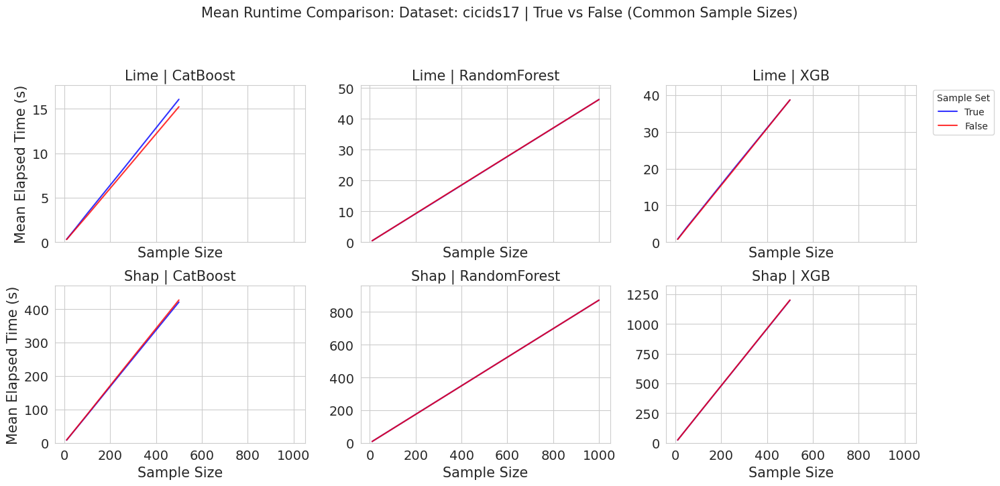

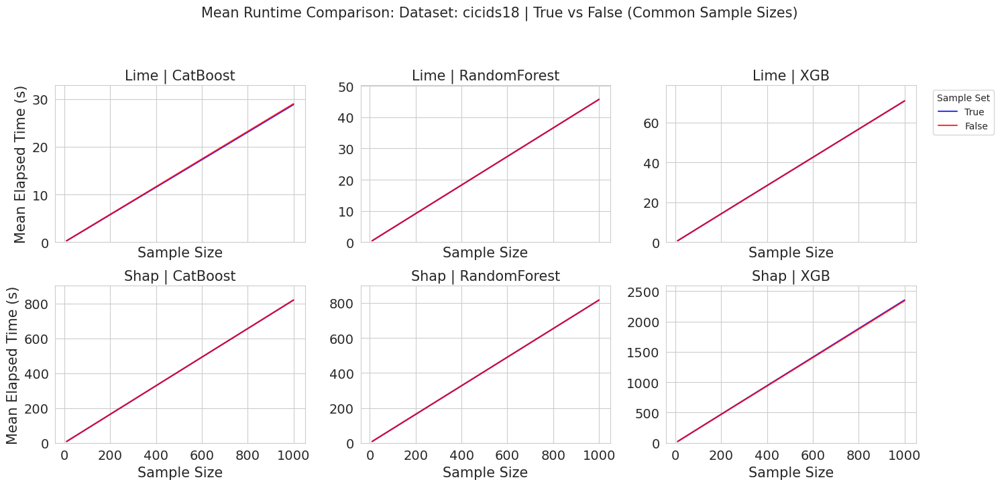

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)

df.columns = df.columns.str.strip()

sns.set_style("whitegrid")
datasets = df['dataset'].unique()
line_style = '-'
sample_set_colors = {'true_idx': 'blue', 'false_idx': 'red'}

for dataset in datasets:
    df_dataset = df[df['dataset'] == dataset]
    models = df_dataset['model'].unique()
    xai_methods = df_dataset['xai_method'].unique()

    fig, axes = plt.subplots(
        nrows=len(xai_methods),
        ncols=len(models),
        figsize=(5 * len(models), 3.5 * len(xai_methods)),
        sharex=True, sharey=False
    )

    if len(xai_methods) == 1:
        axes = np.expand_dims(axes, 0)
    if len(models) == 1:
        axes = np.expand_dims(axes, 1)

    for row, method in enumerate(xai_methods):
        for col, model in enumerate(models):
            ax = axes[row, col]
            panel_df = df_dataset[(df_dataset['model'] == model) & (df_dataset['xai_method'] == method)]

            if panel_df.empty:
                ax.set_visible(False)
                continue

            true_sizes = set(panel_df[panel_df['sample_set'] == 'true_idx']['sample_size'].unique())
            false_sizes = set(panel_df[panel_df['sample_set'] == 'false_idx']['sample_size'].unique())
            common_sizes = sorted(true_sizes.intersection(false_sizes))

            if not common_sizes:
                ax.set_visible(False)
                continue

            panel_df = panel_df[panel_df['sample_size'].isin(common_sizes)]

            mean_df = panel_df.groupby(['sample_set', 'sample_size'])['elapsed_time'].mean().reset_index()

            for sample_set in ['true_idx', 'false_idx']:
                df_ss = mean_df[mean_df['sample_set'] == sample_set]
                if df_ss.empty:
                    continue

                df_ss = df_ss.sort_values('sample_size')
                ax.plot(
                    df_ss['sample_size'],
                    df_ss['elapsed_time'],
                    label=sample_set.replace('_idx', '').capitalize(),
                    color=sample_set_colors[sample_set],
                    linestyle=line_style,
                    alpha=0.8
                )

            ymax = mean_df['elapsed_time'].max()
            ax.set_ylim(0, ymax * 1.10)

            ax.set_title(f"{method} | {model}", fontsize=15)
            ax.set_xlabel("Sample Size", fontsize=15)
            if col == 0:
                ax.set_ylabel("Mean Elapsed Time (s)", fontsize=15)
            else:
                ax.set_ylabel("")

            if row == 0 and col == len(models) - 1:
                ax.legend(title="Sample Set", bbox_to_anchor=(1.05, 1), loc='upper left')

            ax.tick_params(labelsize=14)

    plt.suptitle(
        f"Mean Runtime Comparison: Dataset: {dataset} | True vs False (Common Sample Sizes)",
        fontsize=15, y=1.03
    )
    plt.tight_layout(rect=[0, 0, 1, 0.97])

    # Save plot to disk
    plot_path = f"metrics/runtime/plots/runtime_{dataset}_comparison_true_vs_false.png"
    plt.savefig(plot_path, dpi=300, bbox_inches='tight')

    plt.show()

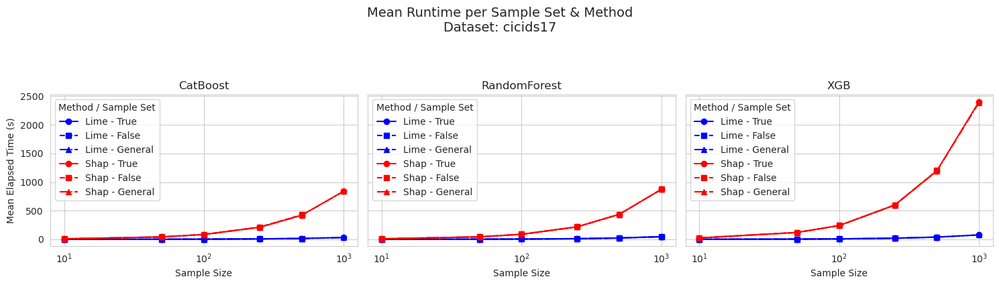

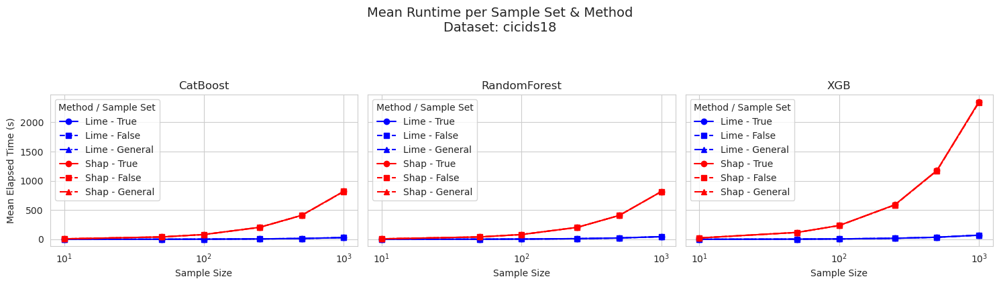

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the data
df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)

# Calculate mean elapsed_time per group
mean_df = (
    df.groupby(['dataset', 'model', 'xai_method', 'sample_set', 'sample_size'])['elapsed_time']
      .mean()
      .reset_index()
)

# Define order and styles for plotting
cat_order = ['true_idx', 'false_idx', 'general_idx']
line_styles = ['-', '--', '-.']
marker_shapes = ['o', 's', '^']
color_palette = {
    'Lime': 'blue',
    'Shap': 'red'
}

sns.set_style("whitegrid")

for dataset in mean_df['dataset'].unique():
    ds_df = mean_df[mean_df['dataset'] == dataset]
    models = ds_df['model'].unique()
    n_models = len(models)
    
    fig, axes = plt.subplots(
        nrows=1,
        ncols=n_models,
        figsize=(5 * n_models, 4),
        sharey=True
    )
    
    if n_models == 1:
        axes = [axes]

    for col, model in enumerate(models):
        ax = axes[col]
        
        for xi, xai_method in enumerate(['Lime', 'Shap']):
            for si, sample_set in enumerate(cat_order):
                subdf = ds_df[
                    (ds_df['model'] == model) &
                    (ds_df['xai_method'] == xai_method) &
                    (ds_df['sample_set'] == sample_set)
                ]
                if not subdf.empty:
                    label = f"{xai_method} - {sample_set.replace('_idx','').capitalize()}"
                    ax.plot(
                        subdf['sample_size'],
                        subdf['elapsed_time'],
                        label=label,
                        color=color_palette[xai_method],
                        linestyle=line_styles[si % len(line_styles)],
                        marker=marker_shapes[si % len(marker_shapes)],
                        markersize=6
                    )
        
        ax.set_title(model)
        ax.set_xscale('log')
        ax.set_xlabel('Sample Size')
        if col == 0:
            ax.set_ylabel('Mean Elapsed Time (s)')
        else:
            ax.set_ylabel('')
        ax.legend(title='Method / Sample Set')
    
    plt.suptitle(f"Mean Runtime per Sample Set & Method\nDataset: {dataset}", fontsize=14, y=1.05)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


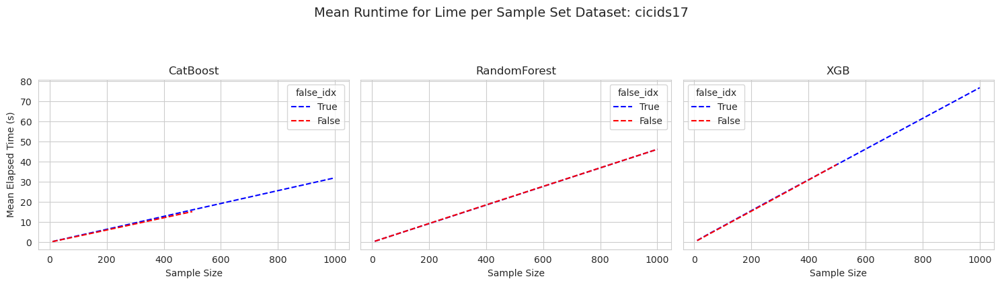

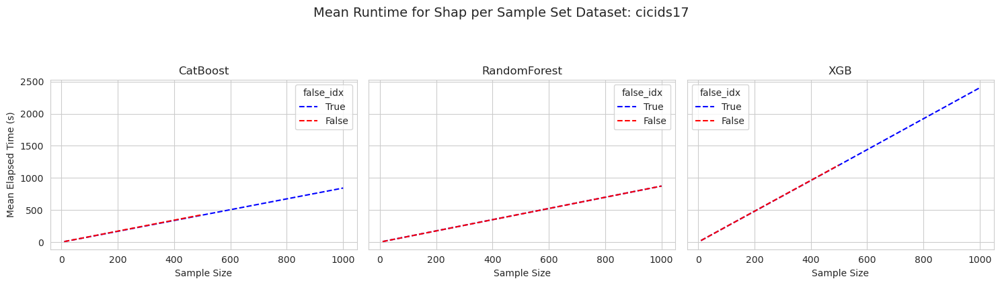

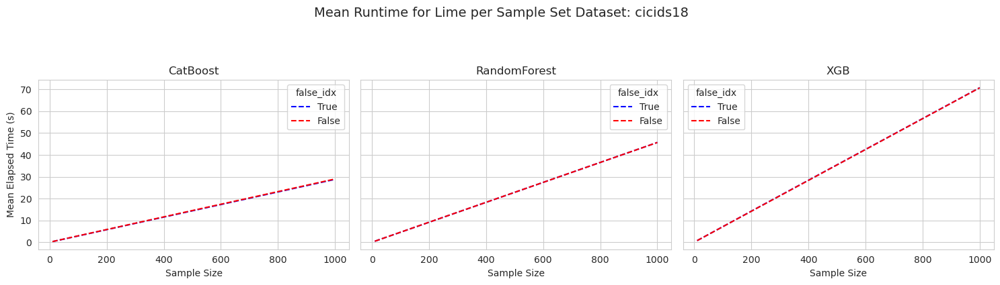

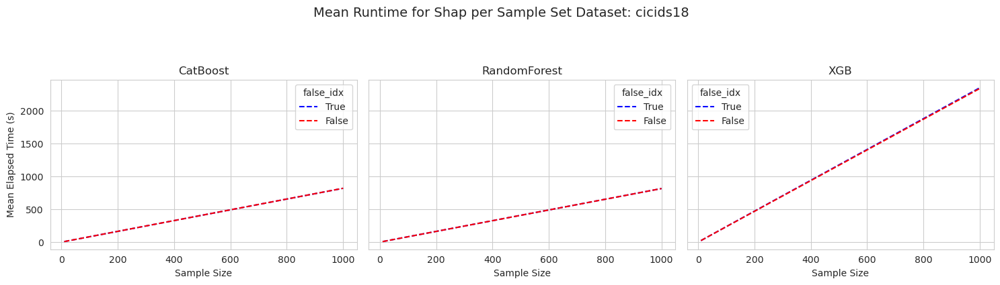

In [55]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)

mean_df = (
    df.groupby(['dataset', 'model', 'xai_method', 'sample_set', 'sample_size'])['elapsed_time']
      .mean()
      .reset_index()
)

cat_order = ['true_idx', 'false_idx']  # sample sets order

# Use colors by sample_set now
sample_set_colors = {
    'true_idx': 'blue',
    'false_idx': 'red'
}

line_style = '--' 

sns.set_style("whitegrid")

for dataset in mean_df['dataset'].unique():
    ds_df = mean_df[mean_df['dataset'] == dataset]
    models = ds_df['model'].unique()
    n_models = len(models)

    for xai_method in ['Lime', 'Shap']:
        fig, axes = plt.subplots(
            nrows=1,
            ncols=n_models,
            figsize=(5 * n_models, 4),
            sharey=True
        )
        if n_models == 1:
            axes = [axes]

        for col, model in enumerate(models):
            ax = axes[col]

            for sample_set in cat_order:
                subdf = ds_df[
                    (ds_df['model'] == model) &
                    (ds_df['xai_method'] == xai_method) &
                    (ds_df['sample_set'] == sample_set)
                ]
                if not subdf.empty:
                    label = f"{sample_set.replace('_idx', '').capitalize()}"
                    ax.plot(
                        subdf['sample_size'],
                        subdf['elapsed_time'],
                        label=label,
                        color=sample_set_colors[sample_set],
                        linestyle=line_style,
                        #marker='o',
                        #markersize=6,
                    )

            ax.set_title(model)
            ax.set_xlabel('Sample Size')
            if col == 0:
                ax.set_ylabel('Mean Elapsed Time (s)')
            else:
                ax.set_ylabel('')
            ax.legend(title=f'{sample_set}')

        plt.suptitle(f"Mean Runtime for {xai_method} per Sample Set Dataset: {dataset}", fontsize=14, y=1.05)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()


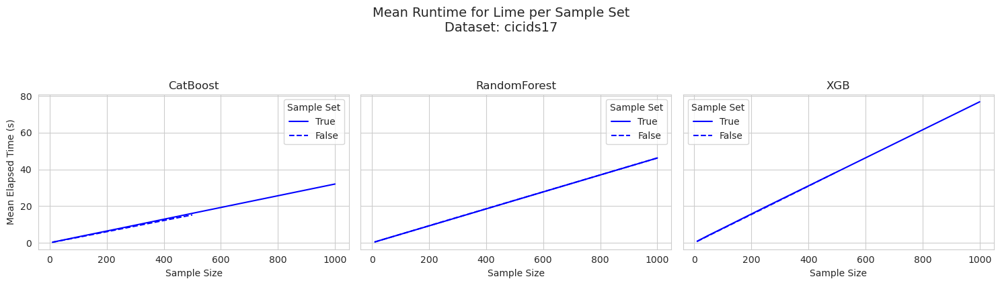

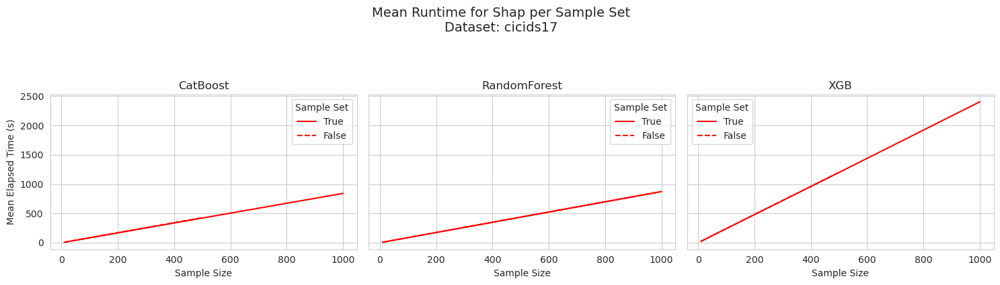

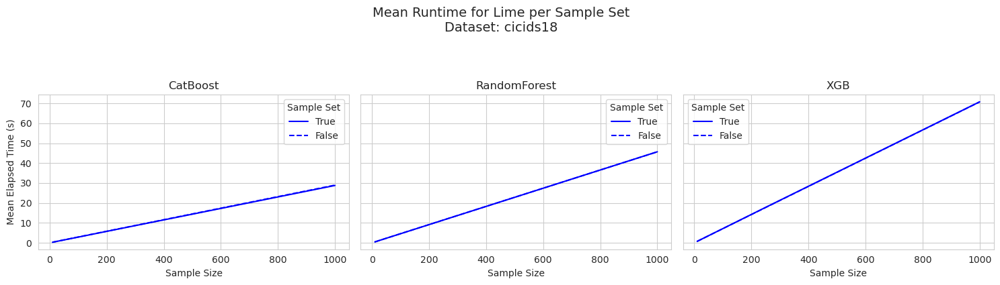

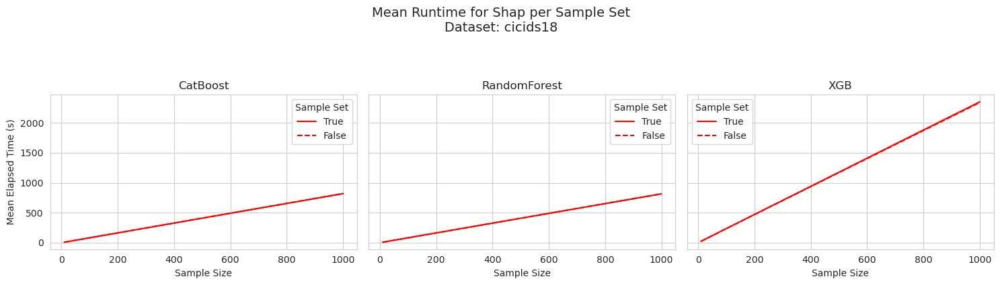

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv("metrics/runtime/XAI_all_models_runtime_results.csv", index_col=0)

mean_df = (
    df.groupby(['dataset', 'model', 'xai_method', 'sample_set', 'sample_size'])['elapsed_time']
      .mean()
      .reset_index()
)

cat_order = ['true_idx', 'false_idx'] #, 'general_idx'] 
line_styles = ['-', '--', '-.']
marker_shapes = ['o', 's', '^']
color_palette = {
    'Lime': 'blue',
    'Shap': 'red'
}

sns.set_style("whitegrid")

for dataset in mean_df['dataset'].unique():
    ds_df = mean_df[mean_df['dataset'] == dataset]
    models = ds_df['model'].unique()
    n_models = len(models)

    for xai_method in ['Lime', 'Shap']:
        fig, axes = plt.subplots(
            nrows=1,
            ncols=n_models,
            figsize=(5 * n_models, 4),
            sharey=True
        )
        if n_models == 1:
            axes = [axes]

        for col, model in enumerate(models):
            ax = axes[col]

            for si, sample_set in enumerate(cat_order):
                subdf = ds_df[
                    (ds_df['model'] == model) &
                    (ds_df['xai_method'] == xai_method) &
                    (ds_df['sample_set'] == sample_set)
                ]
                if not subdf.empty:
                    label = f"{sample_set.replace('_idx','').capitalize()}"
                    ax.plot(
                        subdf['sample_size'],
                        subdf['elapsed_time'],
                        label=label,
                        color=color_palette[xai_method],
                        linestyle=line_styles[si % len(line_styles)],
                        #marker=marker_shapes[si % len(marker_shapes)],
                        #markersize=6
                    )

            ax.set_title(model)
            #ax.set_xscale('log')
            ax.set_xlabel('Sample Size')
            if col == 0:
                ax.set_ylabel('Mean Elapsed Time (s)')
            else:
                ax.set_ylabel('')
            ax.legend(title='Sample Set')

        plt.suptitle(f"Mean Runtime for {xai_method} per Sample Set\nDataset: {dataset}", fontsize=14, y=1.05)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()
